# <center>Домашняя работа по занятию 26 
# <center>"Доменная адаптация и условная генерация"
# <center>Условная генерация
- Обучить две версии CAAE — "честную" и "нечестную", 
- преобразовать с их помощью исходные данные в латентное представление
- обучить **3** классификатора — один на **исходных данных** и два на кодах, полученных из **"честного"** и **"нечестного"** CAAE. 
- Сравнить качество классификации.   
### Необязательная часть:   
Сделать перенос стиля с одной цифры на другие с помощью "честного" CAAE

In [1]:
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir('drive/My Drive/Colab Notebooks/neural_OTUS')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms

from utils import mnist, plot_graphs, plot_mnist, to_onehot
import numpy as np
import os 

%matplotlib inline

In [3]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [4]:
root_folder = 'FC_AAE_C_results_500epoch/'
fixed_folder = root_folder + 'Fixed_results/'
recon_folder = root_folder + 'Recon_results/'

if os.path.isdir(root_folder):
    !rm -r $root_folder
os.mkdir(root_folder)
os.mkdir(fixed_folder)
os.mkdir(recon_folder)

In [5]:
mnist_tanh = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize((0.5,), (0.5,)),
                lambda x: x.to(device)
           ])

In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

lr = 0.0001
prior_size = 10
train_epoch = 500
batch_size = 250

cuda:0


In [7]:
train_loader, valid_loader, test_loader = mnist(batch_size=batch_size, valid=10000, 
                                                transform=mnist_tanh, path='./../MNIST_data')

In [8]:
fixed_z = torch.randn((10, prior_size)).repeat((1,10)).view(-1, prior_size).to(device)
fixed_z_label = to_onehot(torch.tensor(list(range(10))).repeat((10)), 10).to(device)
fixed_data, fixed_label = next(iter(test_loader))
fixed_data = fixed_data[:100].to(device)
fixed_label = to_onehot(fixed_label[:100], 10).to(device)

In [9]:
data, label = next(iter(train_loader))

In [10]:
freq = 5

In [11]:
class FullyConnected(nn.Module):
    def __init__(self, sizes, dropout=False, activation_fn=nn.Tanh(), flatten=False, 
                 last_fn=None, first_fn=None, device='cpu'):
        super(FullyConnected, self).__init__()
        layers = []
        self.flatten = flatten
        if first_fn is not None:
            layers.append(first_fn)
        for i in range(len(sizes) - 2):
            layers.append(nn.Linear(sizes[i], sizes[i+1]))
            if dropout:
                layers.append(nn.Dropout(dropout))
            layers.append(activation_fn) # нам не нужен дропаут и фнкция активации в последнем слое
        else: 
            layers.append(nn.Linear(sizes[-2], sizes[-1]))
        if last_fn is not None:
            layers.append(last_fn)
        self.model = nn.Sequential(*layers)
        self.to(device)
        
    def forward(self, x, y=None):
        if self.flatten:
            x = x.view(x.shape[0], -1)
        if y is not None:
            x = torch.cat([x, y], dim=1)
        return self.model(x)

# <center>Основное задание

In [12]:
logs = {}
coders = {}

## <center>1) "Нечестный" вариант (unfair)

In [ ]:
variant = "unfair"

In [ ]:
coders[variant] = {}

In [ ]:
coders[variant]["Enc"] = FullyConnected([28*28, 1024, 1024, prior_size], activation_fn=nn.LeakyReLU(0.2), flatten=True, device=device)
coders[variant]["Dec"] = FullyConnected([prior_size+10, 1024, 1024, 28*28], activation_fn=nn.LeakyReLU(0.2), last_fn=nn.Tanh(), device=device)
coders[variant]["Disc"] = FullyConnected([prior_size, 1024, 1024, 1], dropout=0.3, activation_fn=nn.LeakyReLU(0.2), device=device)

Enc_optimizer = optim.Adam(coders[variant]["Enc"].parameters(), lr=lr)
Dec_optimizer = optim.Adam(coders[variant]["Dec"].parameters(), lr=lr)
Disc_optimizer = optim.Adam(coders[variant]["Disc"].parameters(), lr=lr)

In [ ]:
logs[variant] = {}
logs[variant]["train"] = {'E': [],'AE': [], 'D': []}
logs[variant]["test"] = {'E': [],'AE': [], 'D': []}

In [ ]:
batch_zeros = torch.zeros((batch_size, 1)).to(device)
batch_ones = torch.ones((batch_size, 1)).to(device)

#### тренировочные функции

In [ ]:
def train(epoch, Enc, Dec, Disc, freq=1, log=None):
    train_size = len(train_loader.sampler)
    for batch_idx, (data, label) in enumerate(train_loader):
        label = to_onehot(label, 10, device)
        # train D
        Enc.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size)).to(device)
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)

        fake_pred = Disc(Enc(data))
        true_pred = Disc(z)

        
        fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros)
        true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones)
        
        Disc_loss = 0.5*(fake_loss + true_loss)
        
        Disc_loss.backward()
        Disc_optimizer.step()
        
        # train AE
        Enc.zero_grad()
        Dec.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size))
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10)
        
        latent = Enc(data)
        reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
        fake_pred = Disc(latent)
        
        Enc_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_ones)
        AE_loss = F.mse_loss(reconstructed, data)
        G_loss = AE_loss + Enc_loss
        
        G_loss.backward()
        Dec_optimizer.step()
        Enc_optimizer.step()
            
        if epoch % freq == 0 or epoch == 1:
            if batch_idx % 100 == 0:
                line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                    epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
                losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
                print(line + losses)
            
    else:
        if epoch % freq == 0 or epoch == 1:
            batch_idx += 1
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
            losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
            print(line + losses)
        if log is not None:
            log['E'].append(Enc_loss.item())
            log['AE'].append(AE_loss.item())
            log['D'].append(Disc_loss.item())

In [ ]:
def test(Enc, Dec, Disc, loader, epoch, freq=1, file_prefix='', log=None):
    test_size = len(loader)
    E_loss = 0.
    AE_loss = 0.
    D_loss = 0.
    test_loss = {'E': 0., 'AE': 0., 'D': 0.}
    with torch.no_grad():
        for data, label in loader:
            label = to_onehot(label, 10, device)
            z = torch.randn((batch_size, prior_size)).to(device)
            z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)
            latent = Enc(data)
            reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
            fake_pred = Disc(latent)
            true_pred = Disc(z)
        
            fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros).item()
            true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones).item()
            
            D_loss += 0.5*(fake_loss + true_loss)
            E_loss += F.binary_cross_entropy_with_logits(fake_pred, batch_ones).item()
            AE_loss += F.mse_loss(reconstructed, data)
            
        E_loss /= test_size
        D_loss /= test_size
        AE_loss /= test_size

        if epoch % freq == 0 or epoch == 1:
            fixed_gen = Dec(fixed_z, fixed_z_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\tgeneration")
            plot_mnist(fixed_gen, (10, 10), True, fixed_folder + file_prefix + '%03d.png' % epoch)
            fixed_reconstruction = Dec(Enc(fixed_data), fixed_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\treconstruction")
            plot_mnist(fixed_reconstruction, (10, 10), True, 
                    recon_folder + file_prefix + '%03d.png' % epoch)
            
            report = 'Test losses. E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(E_loss, AE_loss, D_loss)
            print(report)

        if log is not None:
            log['E'].append(E_loss)
            log['AE'].append(AE_loss)
            log['D'].append(D_loss)

Train Epoch: 1 [0/50000 (0%)]	Losses E: 0.6890, AE: 0.9257, D: 0.6814
Train Epoch: 1 [25000/50000 (50%)]	Losses E: 0.5460, AE: 0.2866, D: 6.2549
Train Epoch: 1 [50000/50000 (100%)]	Losses E: 0.8828, AE: 0.2731, D: 1.6461
	generation


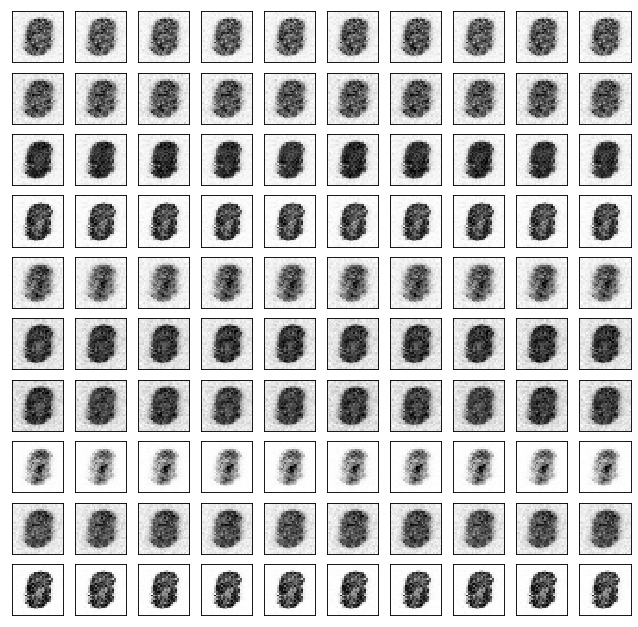

	reconstruction


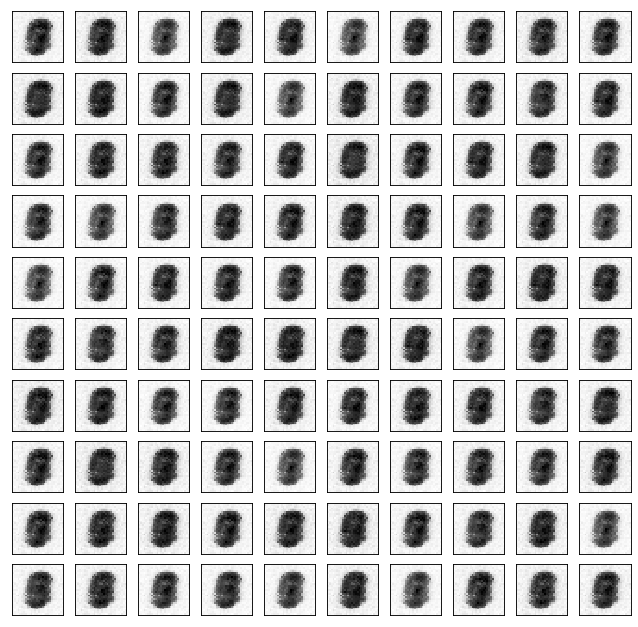

Test losses. E: 0.8750, AE: 0.2696, D: 1.6412
Train Epoch: 5 [0/50000 (0%)]	Losses E: 0.6128, AE: 0.2176, D: 0.8737
Train Epoch: 5 [25000/50000 (50%)]	Losses E: 0.5546, AE: 0.2074, D: 0.7418
Train Epoch: 5 [50000/50000 (100%)]	Losses E: 0.5310, AE: 0.2033, D: 0.7912
	generation


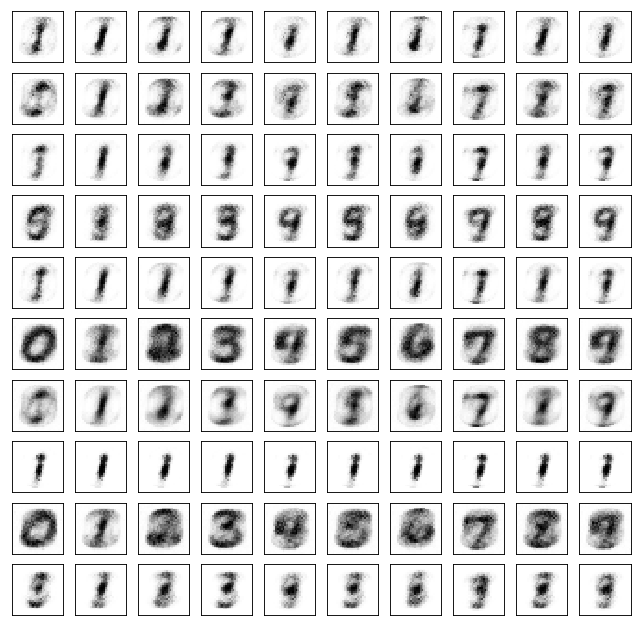

	reconstruction


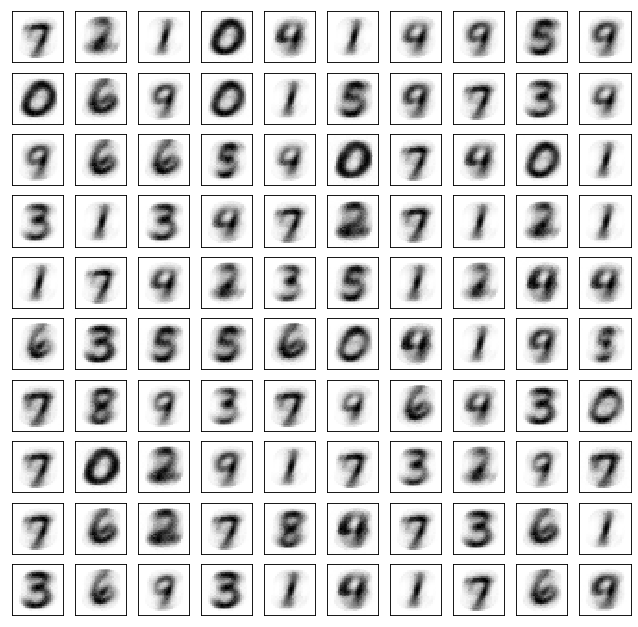

Test losses. E: 0.5095, AE: 0.2059, D: 0.7846
Train Epoch: 10 [0/50000 (0%)]	Losses E: 0.6990, AE: 0.1816, D: 0.7892
Train Epoch: 10 [25000/50000 (50%)]	Losses E: 0.6275, AE: 0.1719, D: 0.7174
Train Epoch: 10 [50000/50000 (100%)]	Losses E: 0.5605, AE: 0.1738, D: 0.7320
	generation


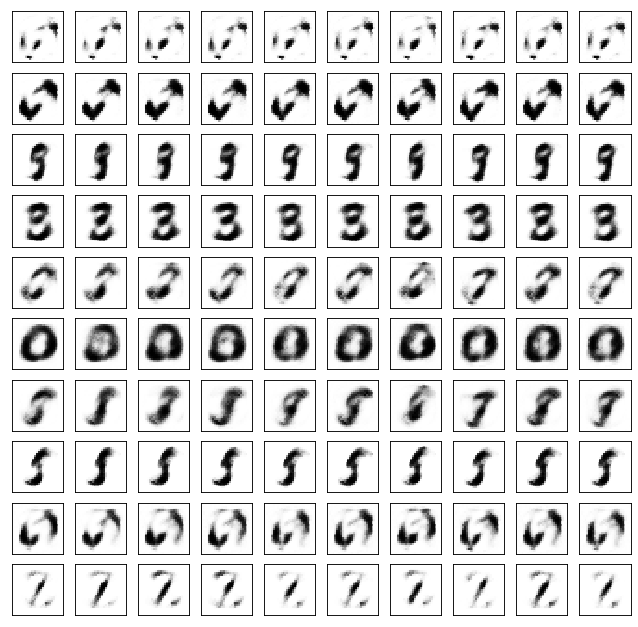

	reconstruction


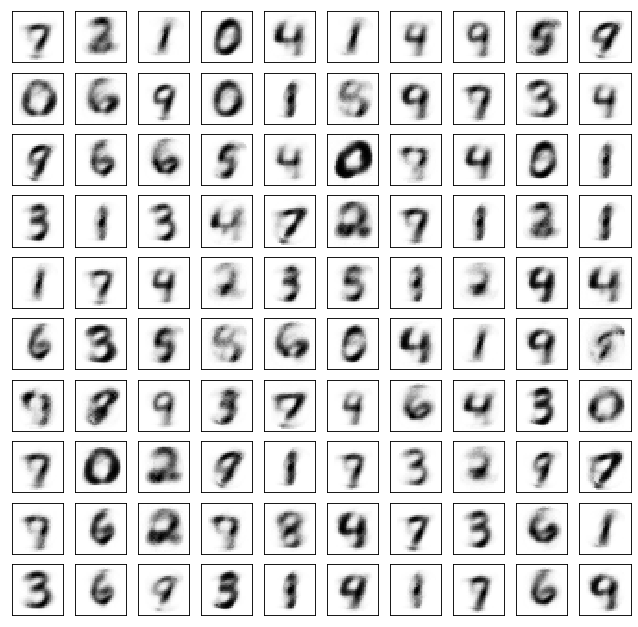

Test losses. E: 0.5590, AE: 0.1693, D: 0.7329
Train Epoch: 15 [0/50000 (0%)]	Losses E: 0.6891, AE: 0.1487, D: 0.7370
Train Epoch: 15 [25000/50000 (50%)]	Losses E: 0.6324, AE: 0.1456, D: 0.6877
Train Epoch: 15 [50000/50000 (100%)]	Losses E: 0.5137, AE: 0.1657, D: 0.7826
	generation


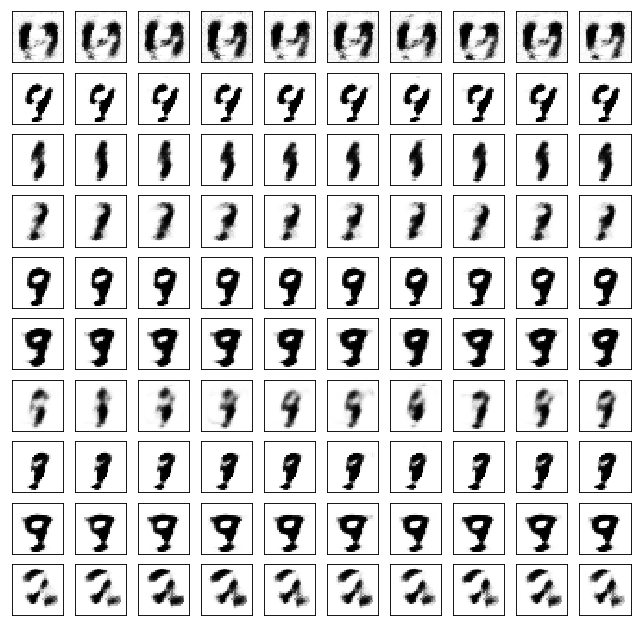

	reconstruction


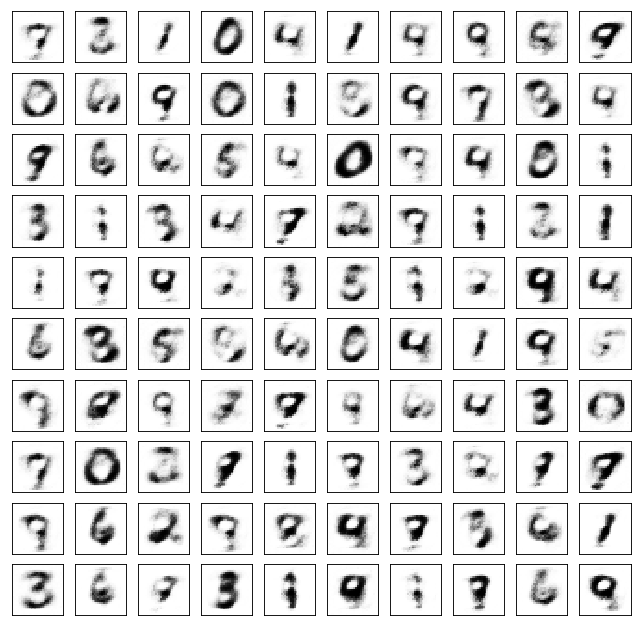

Test losses. E: 0.4765, AE: 0.1664, D: 0.7937
Train Epoch: 20 [0/50000 (0%)]	Losses E: 0.6732, AE: 0.1550, D: 0.6870
Train Epoch: 20 [25000/50000 (50%)]	Losses E: 0.7070, AE: 0.1412, D: 0.7818
Train Epoch: 20 [50000/50000 (100%)]	Losses E: 0.6332, AE: 0.1279, D: 0.6880
	generation


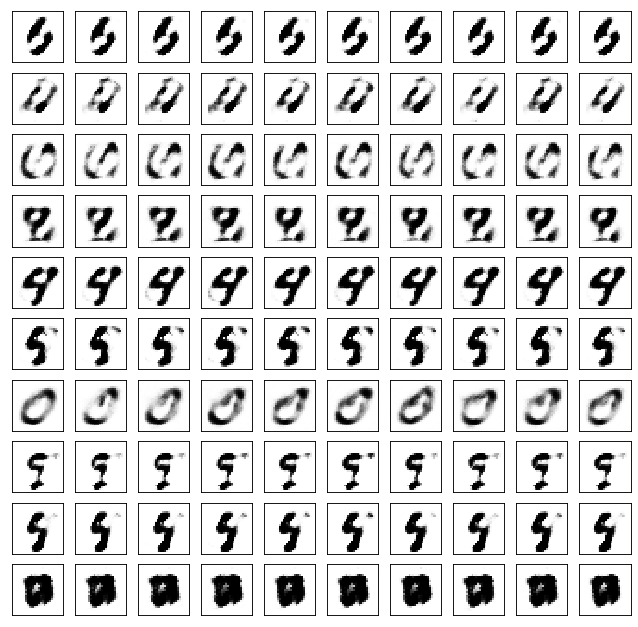

	reconstruction


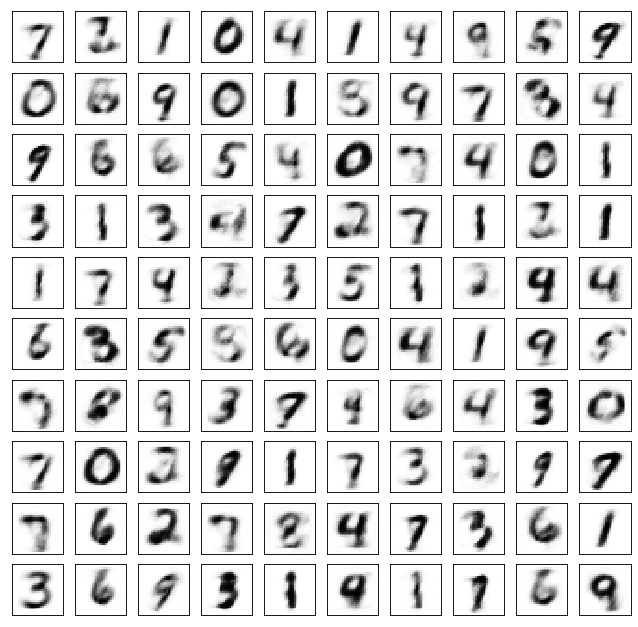

Test losses. E: 0.6322, AE: 0.1294, D: 0.6876
Train Epoch: 25 [0/50000 (0%)]	Losses E: 0.6269, AE: 0.1394, D: 0.7395
Train Epoch: 25 [25000/50000 (50%)]	Losses E: 0.7651, AE: 0.1263, D: 0.6759
Train Epoch: 25 [50000/50000 (100%)]	Losses E: 0.6616, AE: 0.1358, D: 0.7020
	generation


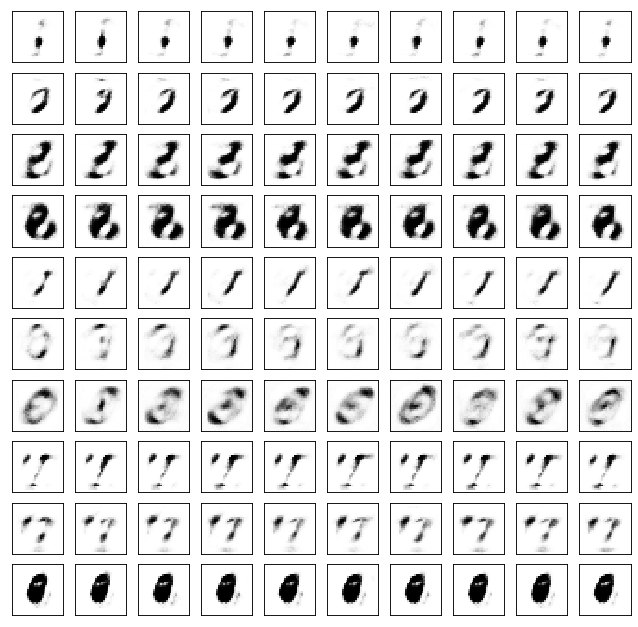

	reconstruction


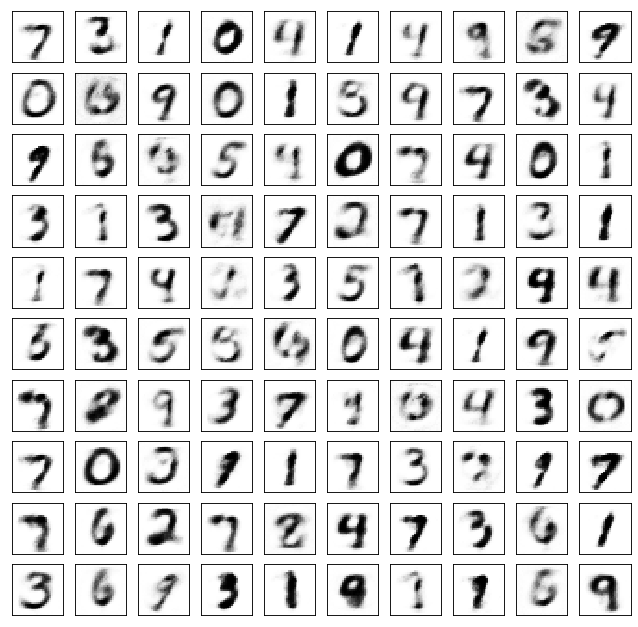

Test losses. E: 0.6576, AE: 0.1337, D: 0.7029
Train Epoch: 30 [0/50000 (0%)]	Losses E: 0.6995, AE: 0.1127, D: 0.6941
Train Epoch: 30 [25000/50000 (50%)]	Losses E: 0.8042, AE: 0.1175, D: 0.6889
Train Epoch: 30 [50000/50000 (100%)]	Losses E: 0.6538, AE: 0.1001, D: 0.6923
	generation


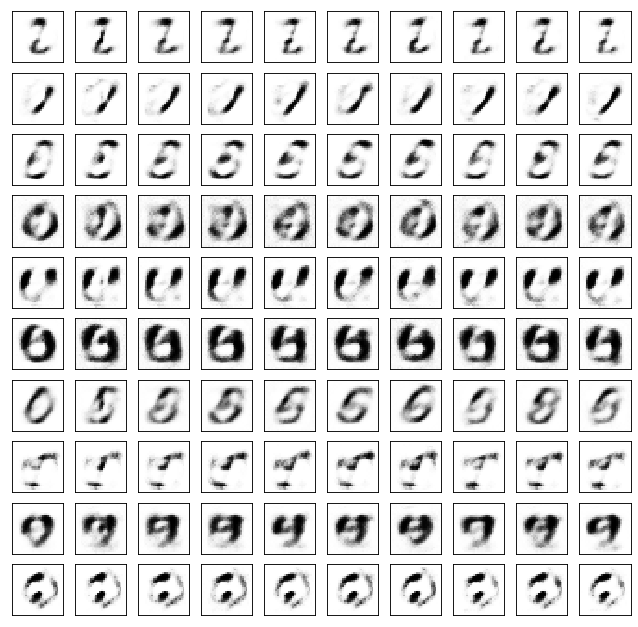

	reconstruction


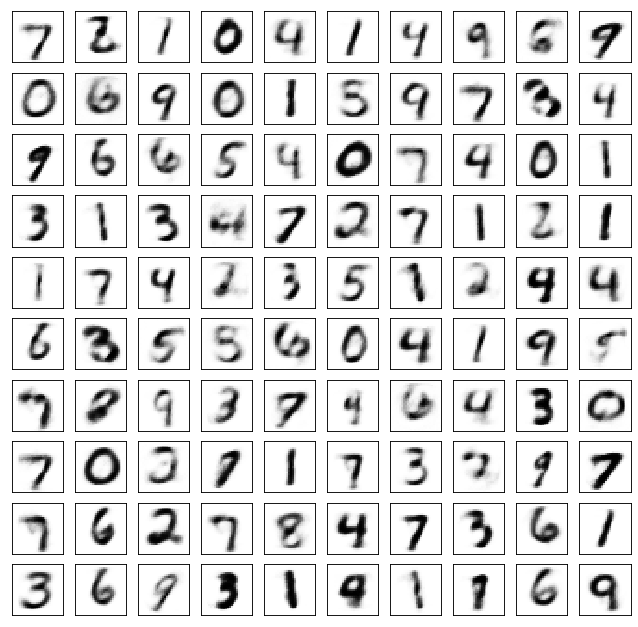

Test losses. E: 0.6535, AE: 0.1018, D: 0.6927
Train Epoch: 35 [0/50000 (0%)]	Losses E: 0.6547, AE: 0.0972, D: 0.6918
Train Epoch: 35 [25000/50000 (50%)]	Losses E: 0.7486, AE: 0.1072, D: 0.7020
Train Epoch: 35 [50000/50000 (100%)]	Losses E: 0.6424, AE: 0.0959, D: 0.7040
	generation


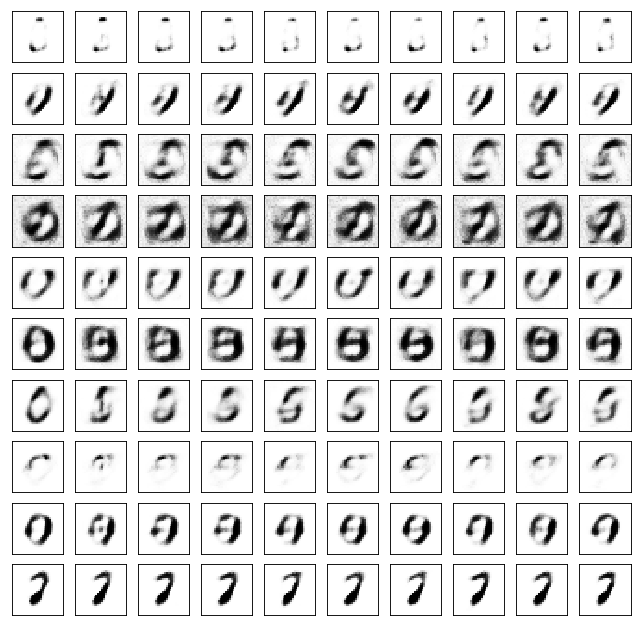

	reconstruction


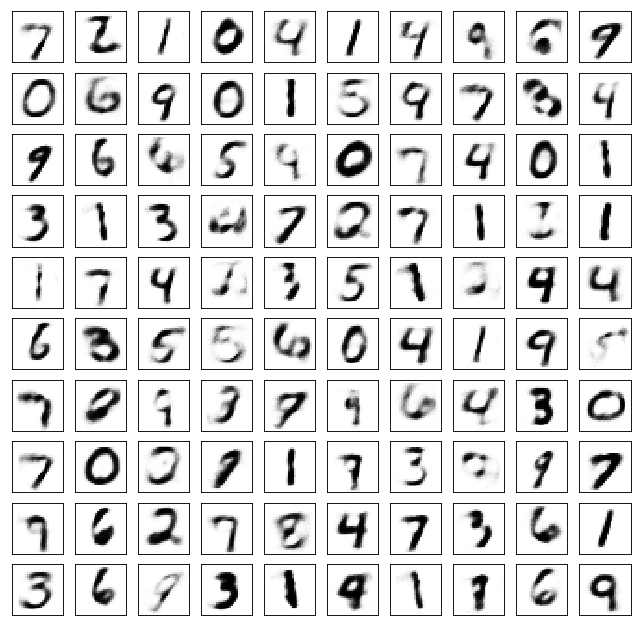

Test losses. E: 0.6379, AE: 0.1029, D: 0.7040
Train Epoch: 40 [0/50000 (0%)]	Losses E: 0.6800, AE: 0.1024, D: 0.7028
Train Epoch: 40 [25000/50000 (50%)]	Losses E: 0.6574, AE: 0.1207, D: 0.7237
Train Epoch: 40 [50000/50000 (100%)]	Losses E: 0.6691, AE: 0.1062, D: 0.7004
	generation


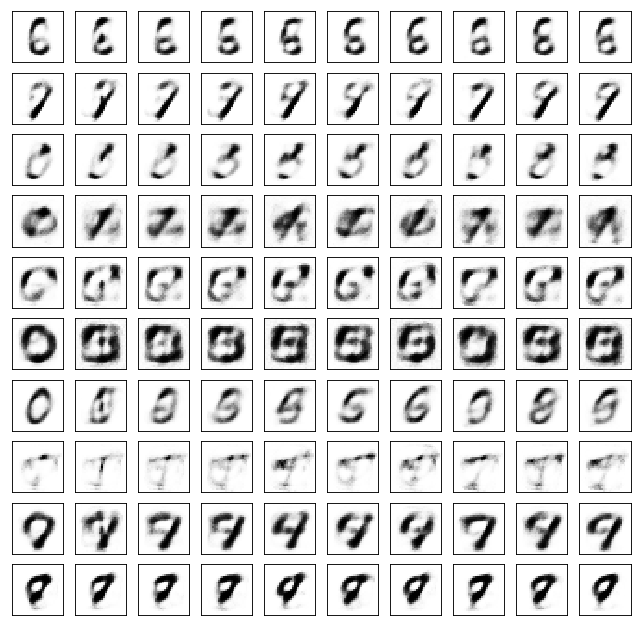

	reconstruction


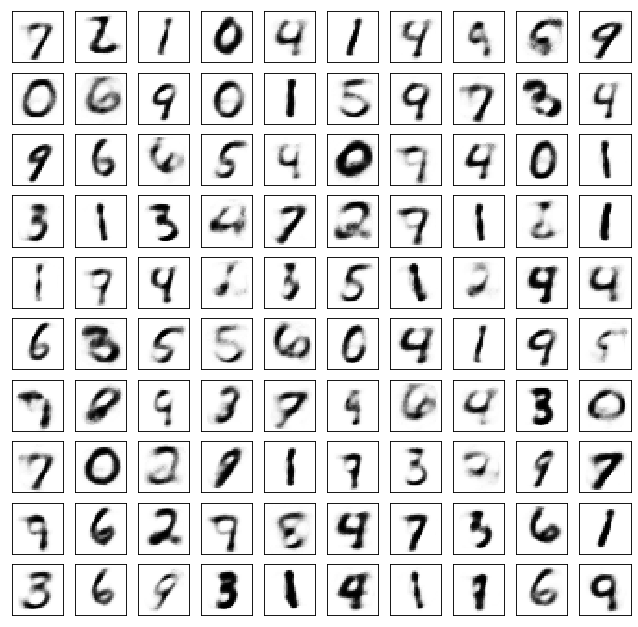

Test losses. E: 0.6628, AE: 0.1098, D: 0.6993
Train Epoch: 45 [0/50000 (0%)]	Losses E: 0.6874, AE: 0.1021, D: 0.7093
Train Epoch: 45 [25000/50000 (50%)]	Losses E: 0.6537, AE: 0.0896, D: 0.6961
Train Epoch: 45 [50000/50000 (100%)]	Losses E: 0.6937, AE: 0.0887, D: 0.7008
	generation


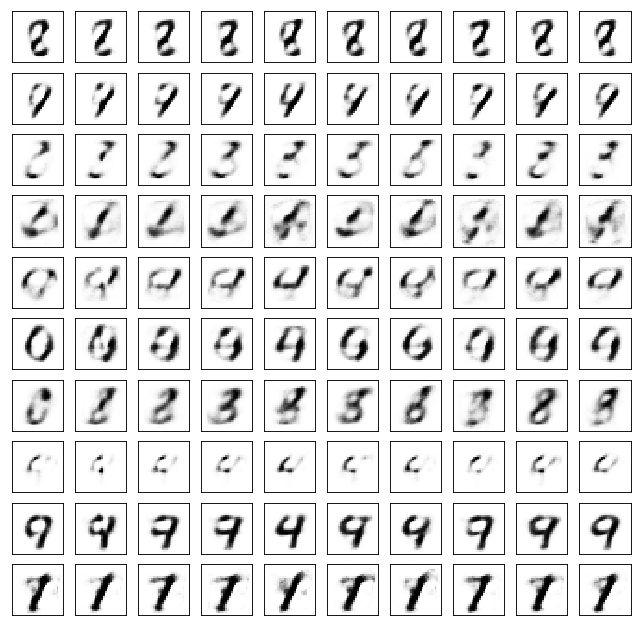

	reconstruction


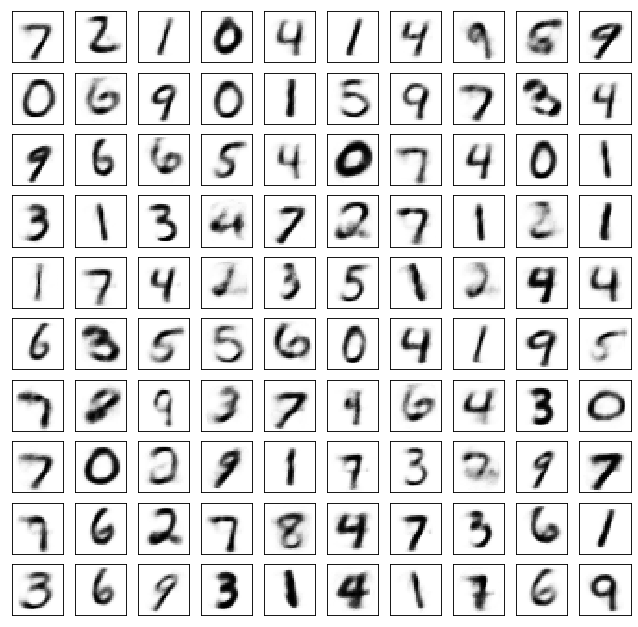

Test losses. E: 0.6941, AE: 0.0894, D: 0.6987
Train Epoch: 50 [0/50000 (0%)]	Losses E: 0.6435, AE: 0.0990, D: 0.7039
Train Epoch: 50 [25000/50000 (50%)]	Losses E: 0.8059, AE: 0.1109, D: 0.7148
Train Epoch: 50 [50000/50000 (100%)]	Losses E: 0.7423, AE: 0.0971, D: 0.7108
	generation


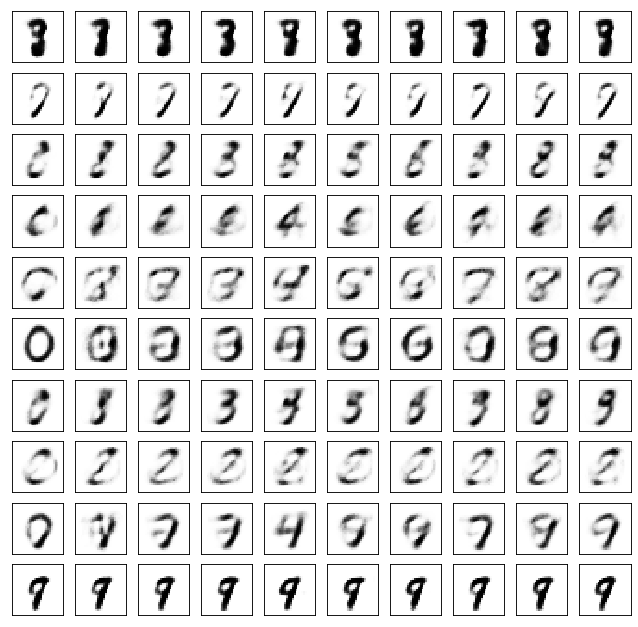

	reconstruction


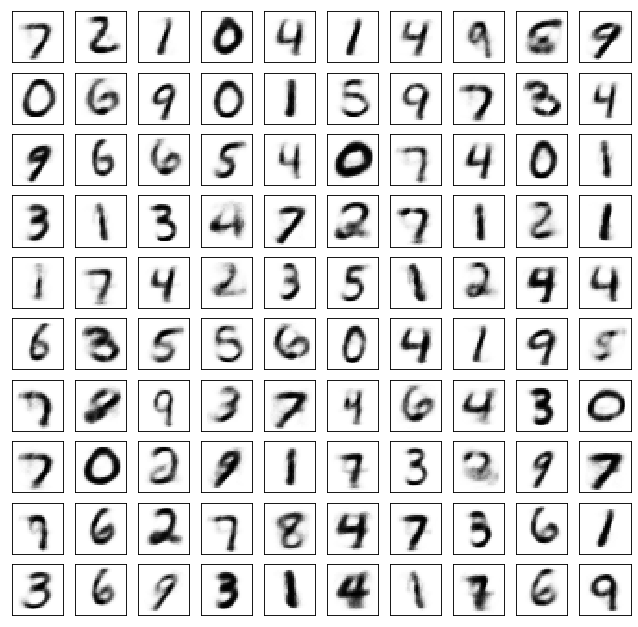

Test losses. E: 0.7417, AE: 0.0974, D: 0.7099
Train Epoch: 55 [0/50000 (0%)]	Losses E: 0.6682, AE: 0.0840, D: 0.7058
Train Epoch: 55 [25000/50000 (50%)]	Losses E: 0.6165, AE: 0.1000, D: 0.7200
Train Epoch: 55 [50000/50000 (100%)]	Losses E: 0.6610, AE: 0.0816, D: 0.7031
	generation


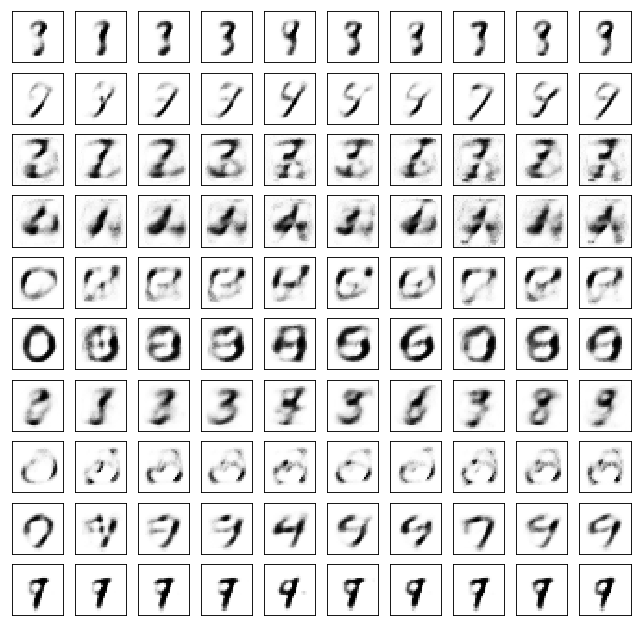

	reconstruction


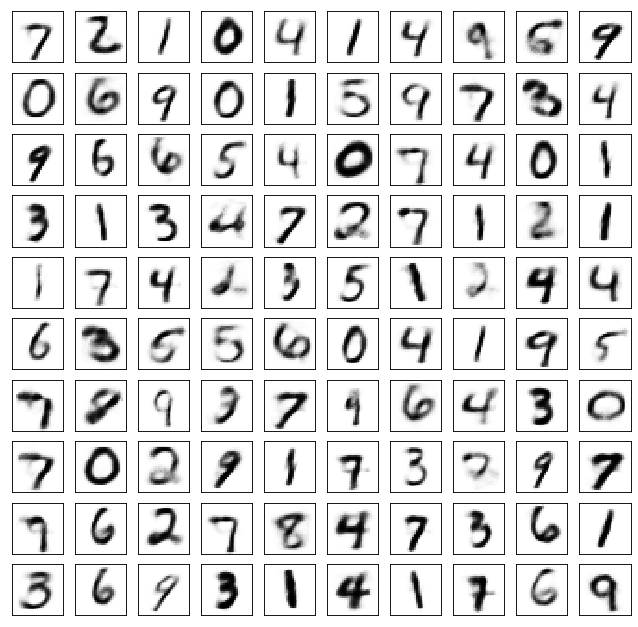

Test losses. E: 0.6591, AE: 0.0891, D: 0.7041
Train Epoch: 60 [0/50000 (0%)]	Losses E: 0.6131, AE: 0.0867, D: 0.7276
Train Epoch: 60 [25000/50000 (50%)]	Losses E: 0.6754, AE: 0.0876, D: 0.6884
Train Epoch: 60 [50000/50000 (100%)]	Losses E: 0.6305, AE: 0.0928, D: 0.7077
	generation


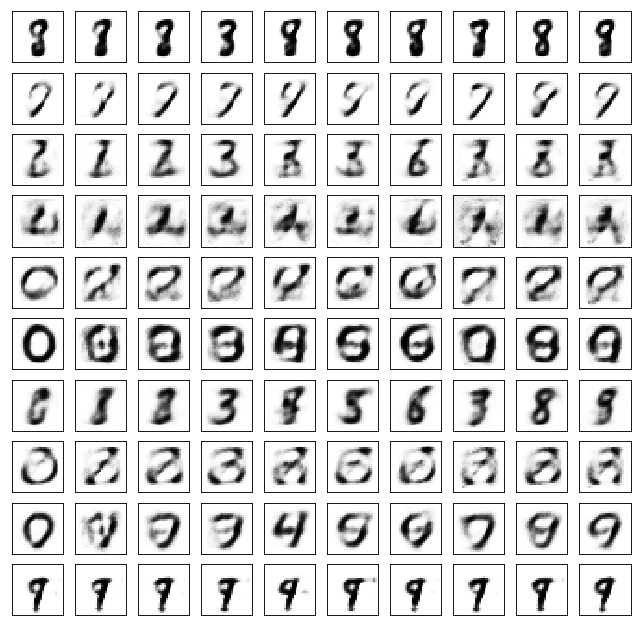

	reconstruction


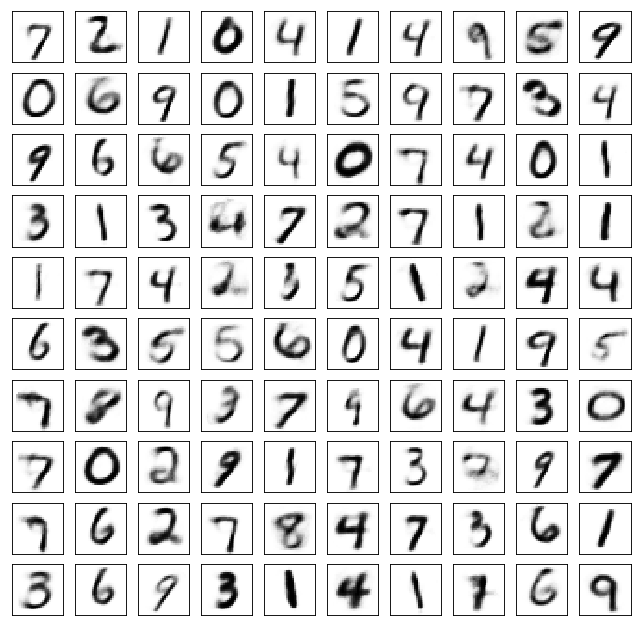

Test losses. E: 0.6269, AE: 0.0947, D: 0.7077
Train Epoch: 65 [0/50000 (0%)]	Losses E: 0.7596, AE: 0.1129, D: 0.7204
Train Epoch: 65 [25000/50000 (50%)]	Losses E: 0.7004, AE: 0.0911, D: 0.7092
Train Epoch: 65 [50000/50000 (100%)]	Losses E: 0.6510, AE: 0.0970, D: 0.6991
	generation


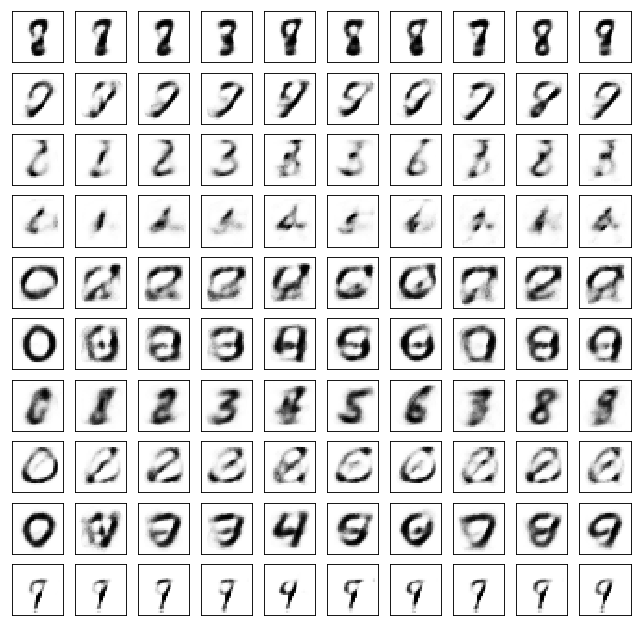

	reconstruction


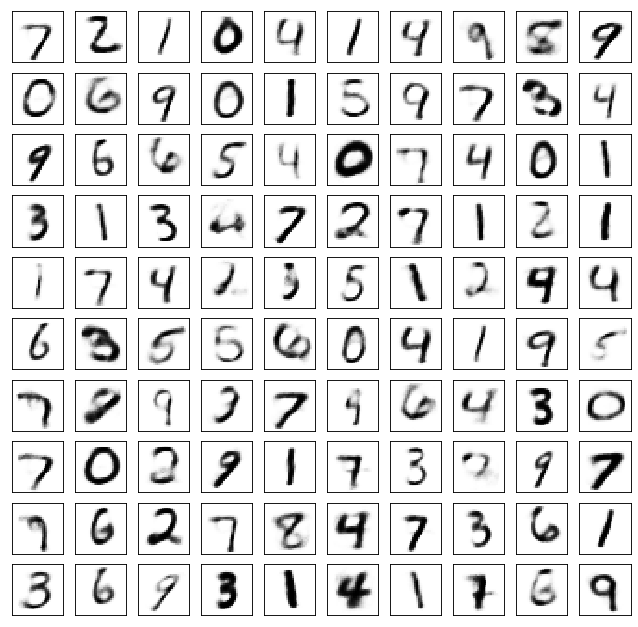

Test losses. E: 0.6422, AE: 0.0977, D: 0.6972
Train Epoch: 70 [0/50000 (0%)]	Losses E: 0.7579, AE: 0.0895, D: 0.6982
Train Epoch: 70 [25000/50000 (50%)]	Losses E: 0.6401, AE: 0.0893, D: 0.7261
Train Epoch: 70 [50000/50000 (100%)]	Losses E: 0.6671, AE: 0.0831, D: 0.6925
	generation


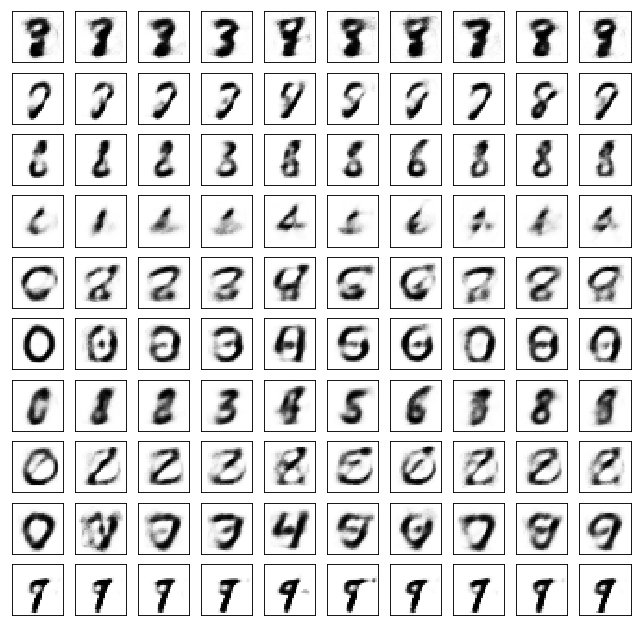

	reconstruction


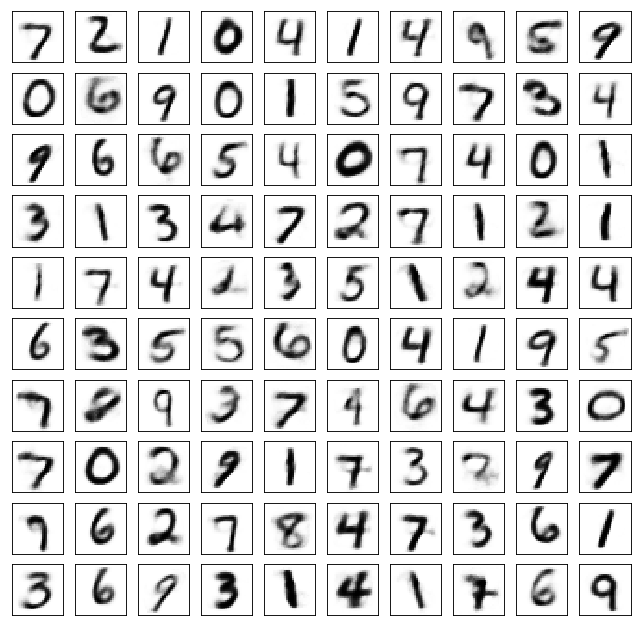

Test losses. E: 0.6606, AE: 0.0856, D: 0.6950
Train Epoch: 75 [0/50000 (0%)]	Losses E: 0.7764, AE: 0.0778, D: 0.6907
Train Epoch: 75 [25000/50000 (50%)]	Losses E: 0.6019, AE: 0.0869, D: 0.7408
Train Epoch: 75 [50000/50000 (100%)]	Losses E: 0.6631, AE: 0.0893, D: 0.7034
	generation


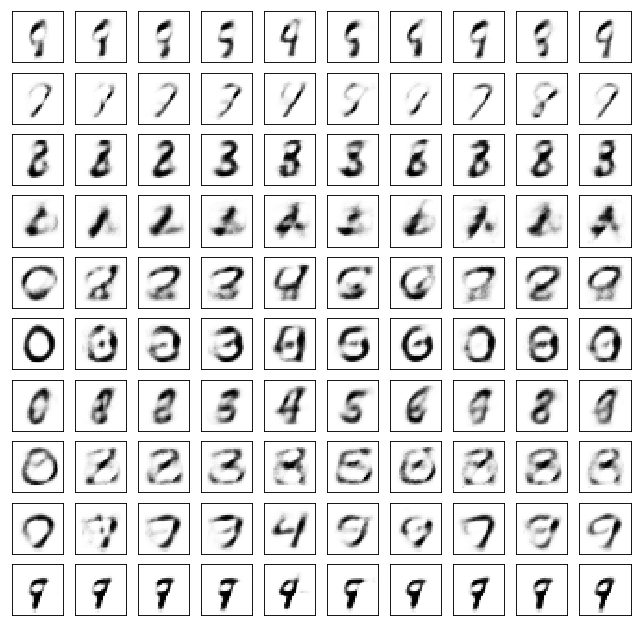

	reconstruction


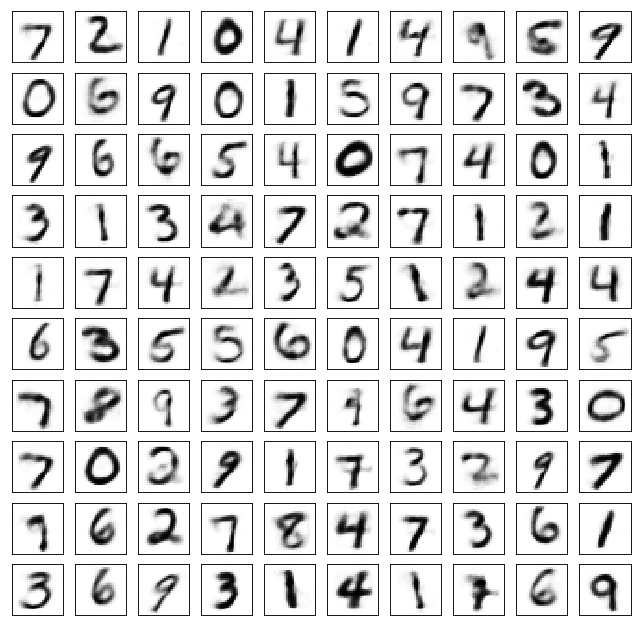

Test losses. E: 0.6561, AE: 0.0873, D: 0.7052
Train Epoch: 80 [0/50000 (0%)]	Losses E: 0.7063, AE: 0.0753, D: 0.6956
Train Epoch: 80 [25000/50000 (50%)]	Losses E: 0.6896, AE: 0.0769, D: 0.6979
Train Epoch: 80 [50000/50000 (100%)]	Losses E: 0.6677, AE: 0.0759, D: 0.6948
	generation


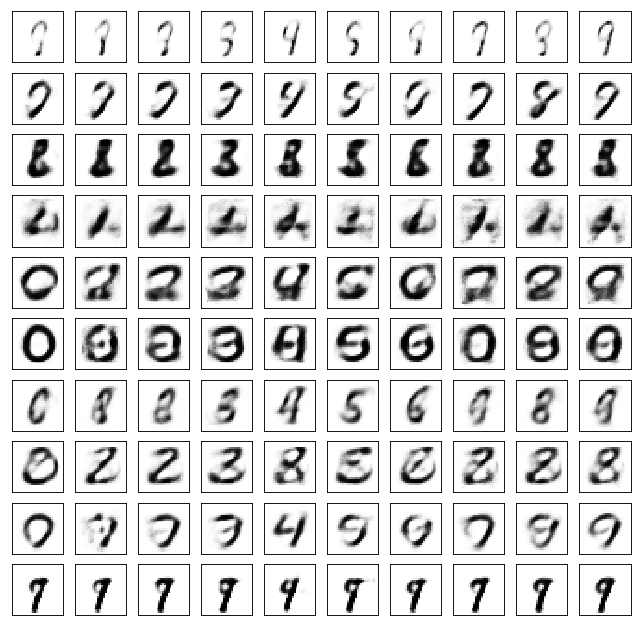

	reconstruction


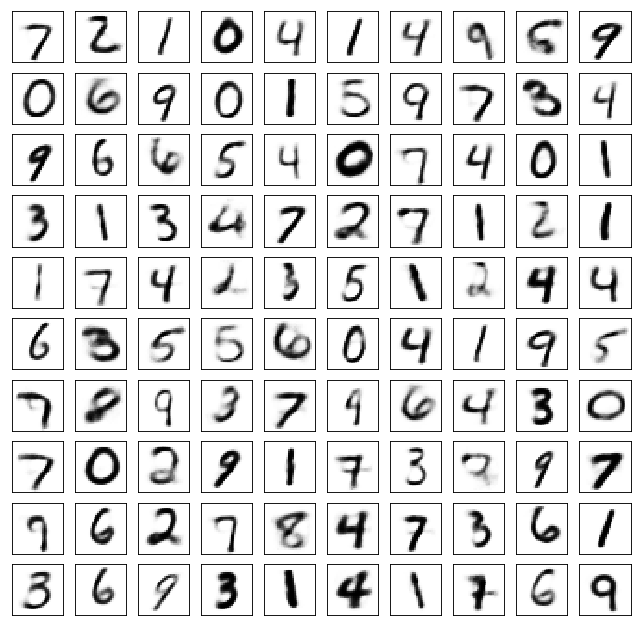

Test losses. E: 0.6657, AE: 0.0771, D: 0.6943
Train Epoch: 85 [0/50000 (0%)]	Losses E: 0.6434, AE: 0.0957, D: 0.7163
Train Epoch: 85 [25000/50000 (50%)]	Losses E: 0.6886, AE: 0.0705, D: 0.6926
Train Epoch: 85 [50000/50000 (100%)]	Losses E: 0.7209, AE: 0.0696, D: 0.6951
	generation


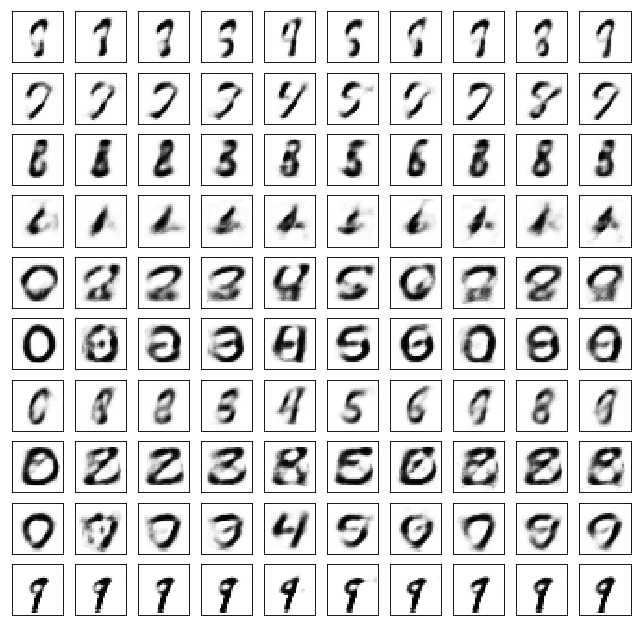

	reconstruction


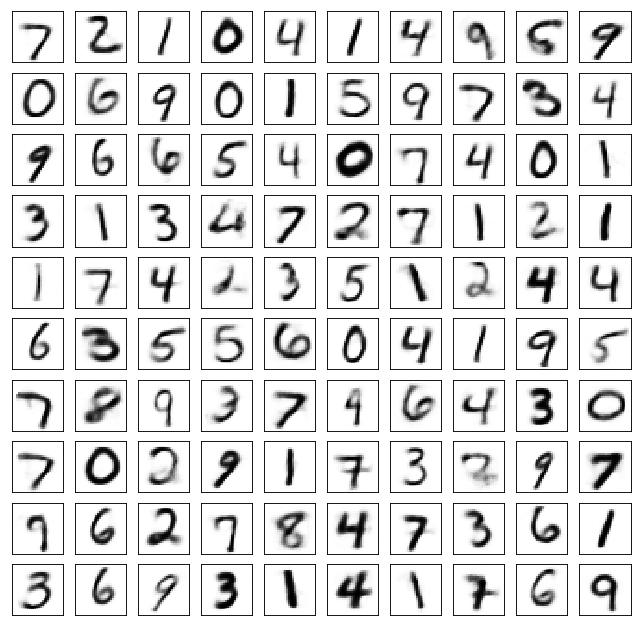

Test losses. E: 0.7184, AE: 0.0724, D: 0.6970
Train Epoch: 90 [0/50000 (0%)]	Losses E: 0.7027, AE: 0.0651, D: 0.6952
Train Epoch: 90 [25000/50000 (50%)]	Losses E: 0.6695, AE: 0.0727, D: 0.7044
Train Epoch: 90 [50000/50000 (100%)]	Losses E: 0.6770, AE: 0.0730, D: 0.7001
	generation


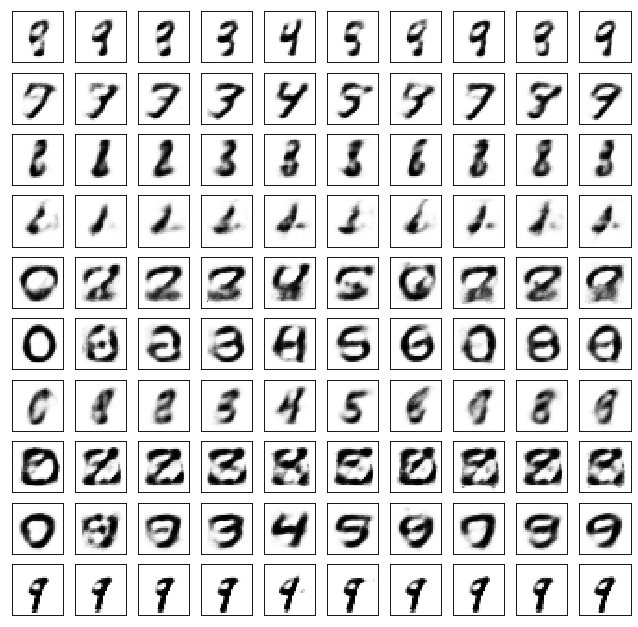

	reconstruction


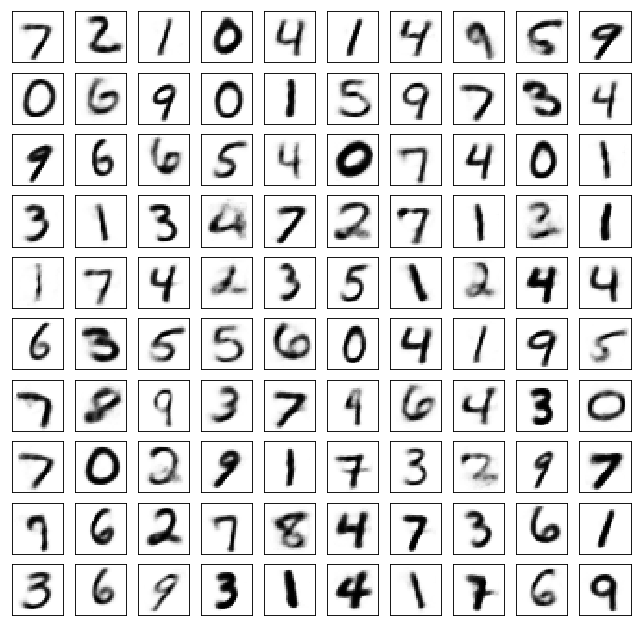

Test losses. E: 0.6762, AE: 0.0720, D: 0.6991
Train Epoch: 95 [0/50000 (0%)]	Losses E: 0.8085, AE: 0.0955, D: 0.6672
Train Epoch: 95 [25000/50000 (50%)]	Losses E: 0.6870, AE: 0.0728, D: 0.7015
Train Epoch: 95 [50000/50000 (100%)]	Losses E: 0.7031, AE: 0.0665, D: 0.6977
	generation


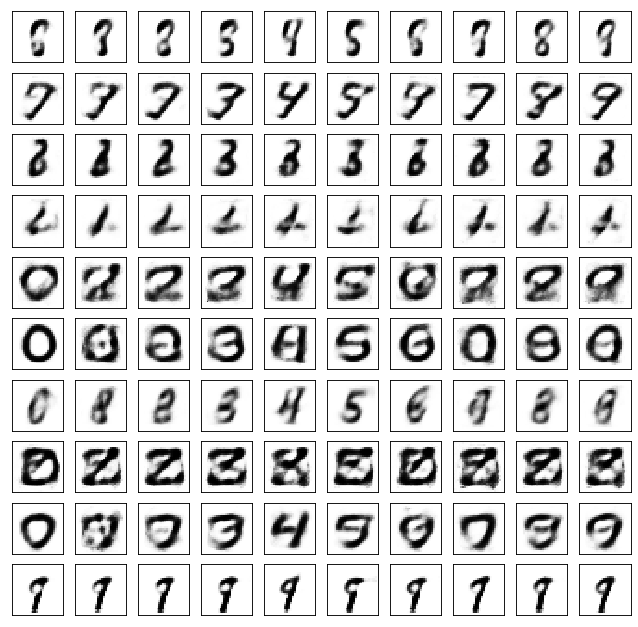

	reconstruction


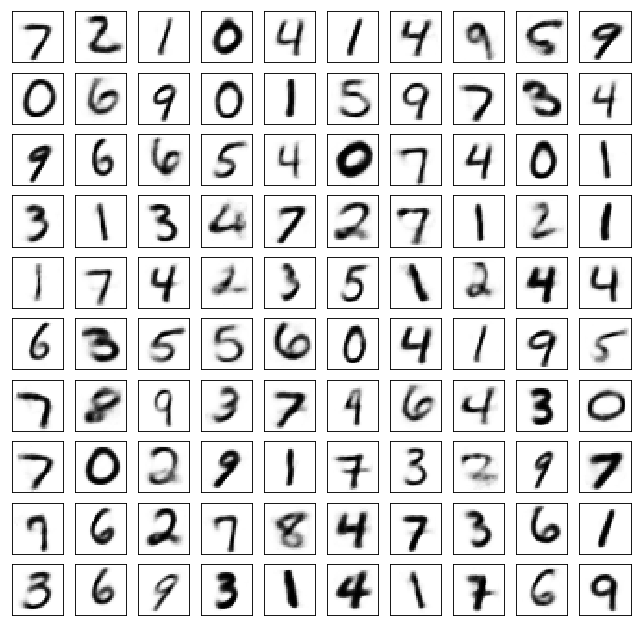

Test losses. E: 0.7029, AE: 0.0685, D: 0.6980
Train Epoch: 100 [0/50000 (0%)]	Losses E: 0.7275, AE: 0.0709, D: 0.6975
Train Epoch: 100 [25000/50000 (50%)]	Losses E: 0.7027, AE: 0.0801, D: 0.7002
Train Epoch: 100 [50000/50000 (100%)]	Losses E: 0.6849, AE: 0.0677, D: 0.6942
	generation


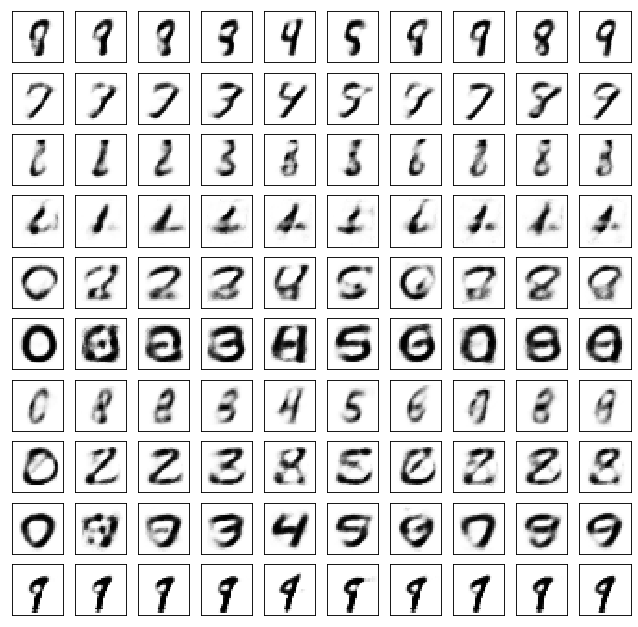

	reconstruction


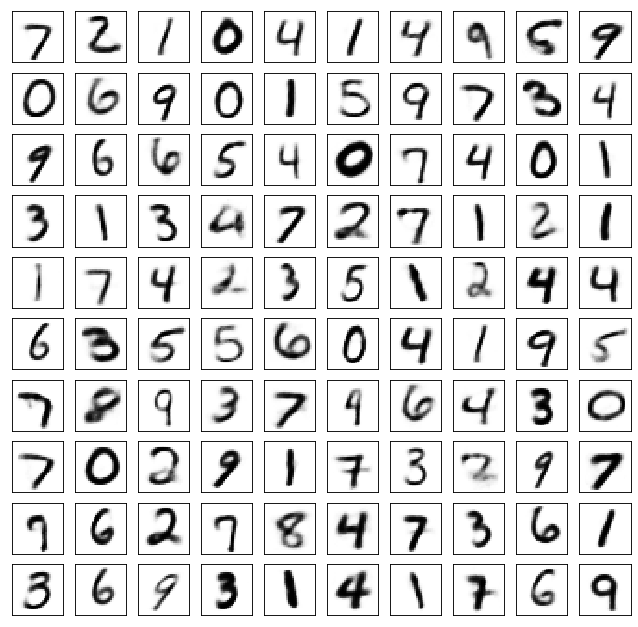

Test losses. E: 0.6858, AE: 0.0680, D: 0.6935
Train Epoch: 105 [0/50000 (0%)]	Losses E: 0.7232, AE: 0.0596, D: 0.6972
Train Epoch: 105 [25000/50000 (50%)]	Losses E: 0.7063, AE: 0.0618, D: 0.6943
Train Epoch: 105 [50000/50000 (100%)]	Losses E: 0.7052, AE: 0.0651, D: 0.6936
	generation


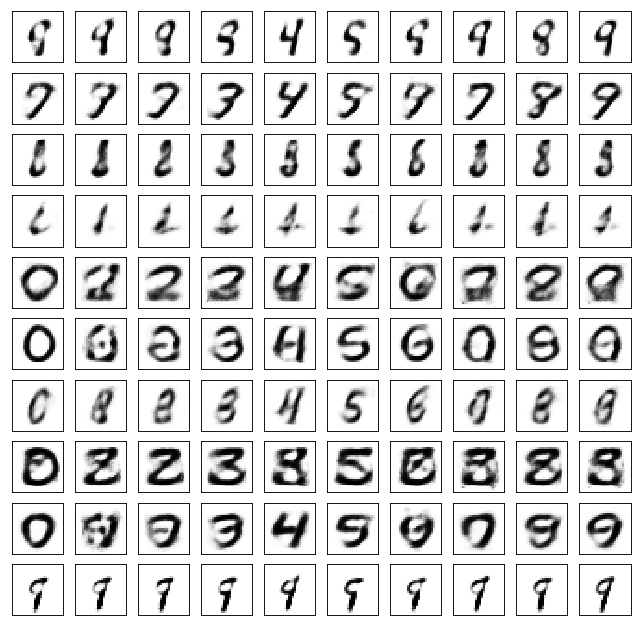

	reconstruction


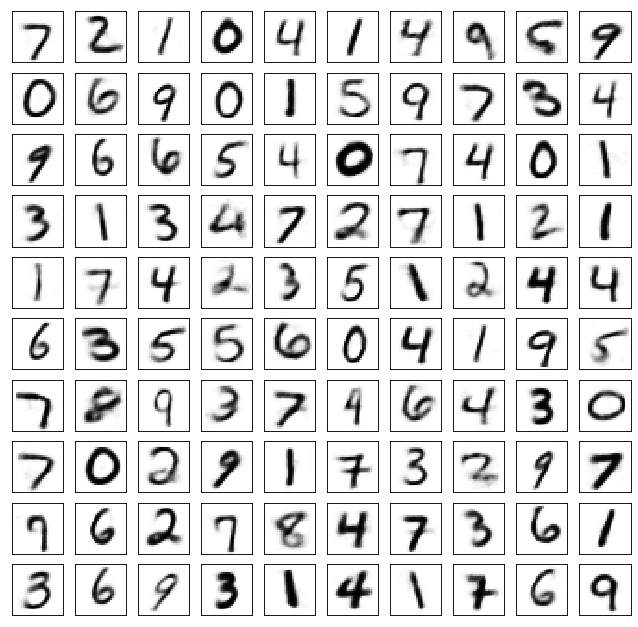

Test losses. E: 0.7040, AE: 0.0660, D: 0.6934
Train Epoch: 110 [0/50000 (0%)]	Losses E: 0.7107, AE: 0.0642, D: 0.6940
Train Epoch: 110 [25000/50000 (50%)]	Losses E: 0.6694, AE: 0.0618, D: 0.6921
Train Epoch: 110 [50000/50000 (100%)]	Losses E: 0.6274, AE: 0.0768, D: 0.7199
	generation


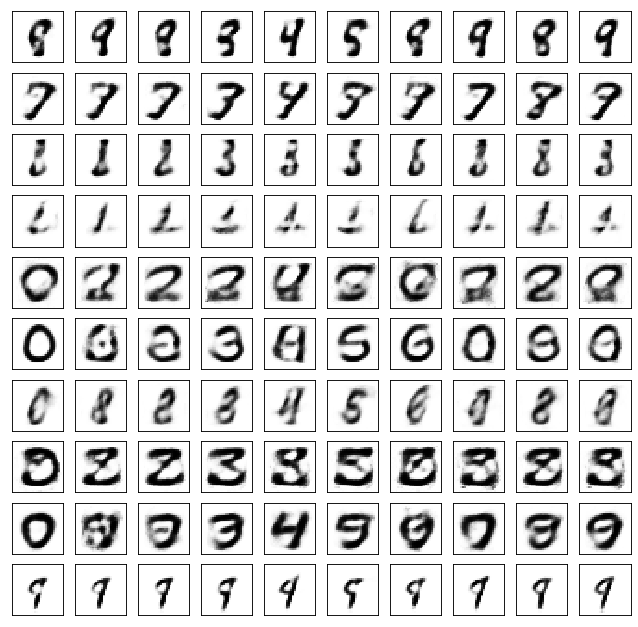

	reconstruction


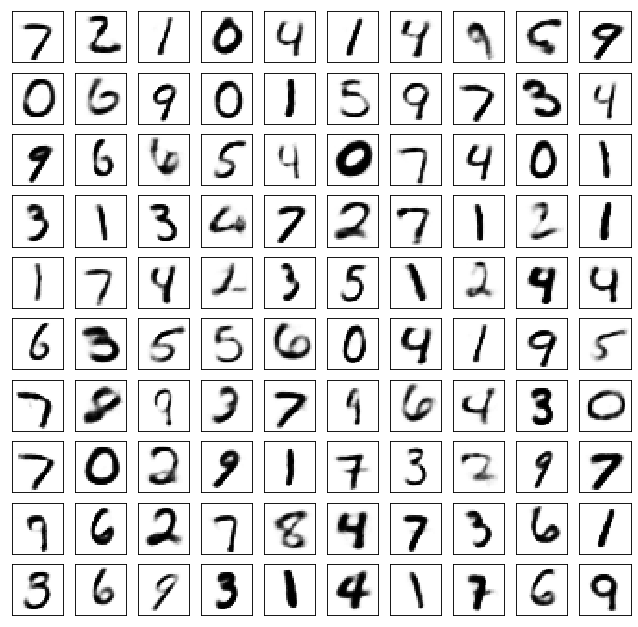

Test losses. E: 0.6184, AE: 0.0821, D: 0.7241
Train Epoch: 115 [0/50000 (0%)]	Losses E: 0.6813, AE: 0.0619, D: 0.6980
Train Epoch: 115 [25000/50000 (50%)]	Losses E: 0.6834, AE: 0.0669, D: 0.6945
Train Epoch: 115 [50000/50000 (100%)]	Losses E: 0.6503, AE: 0.0777, D: 0.7183
	generation


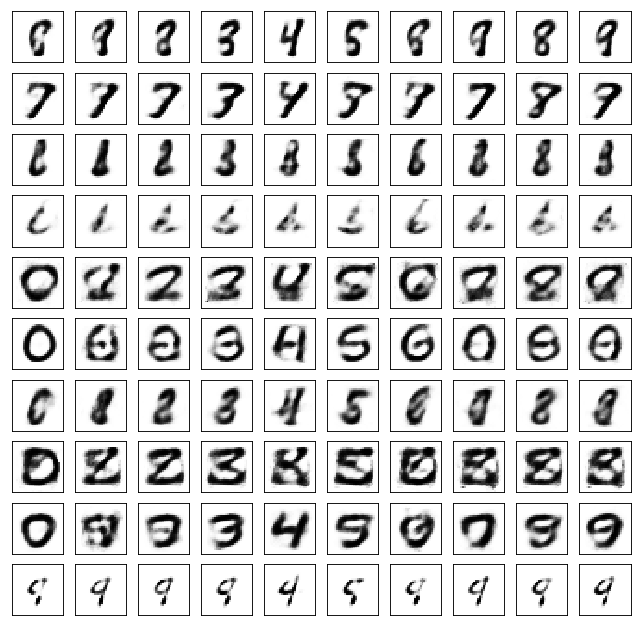

	reconstruction


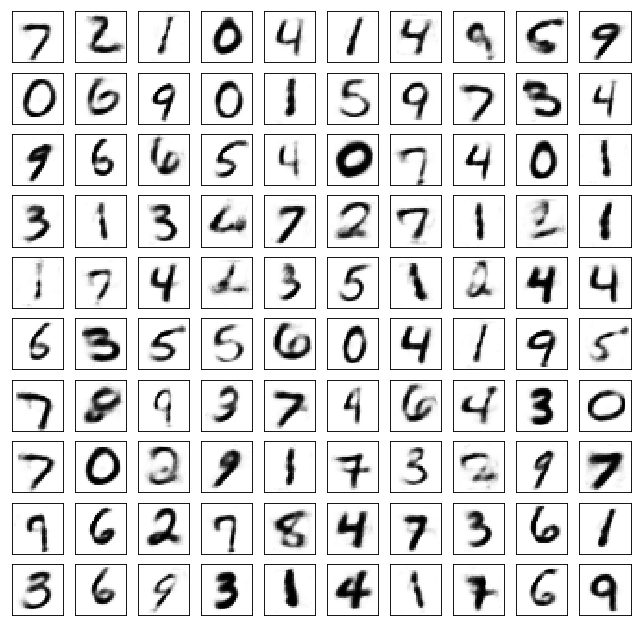

Test losses. E: 0.6411, AE: 0.0795, D: 0.7175
Train Epoch: 120 [0/50000 (0%)]	Losses E: 0.6688, AE: 0.0743, D: 0.7078
Train Epoch: 120 [25000/50000 (50%)]	Losses E: 0.6321, AE: 0.0931, D: 0.7227
Train Epoch: 120 [50000/50000 (100%)]	Losses E: 0.6808, AE: 0.0684, D: 0.6968
	generation


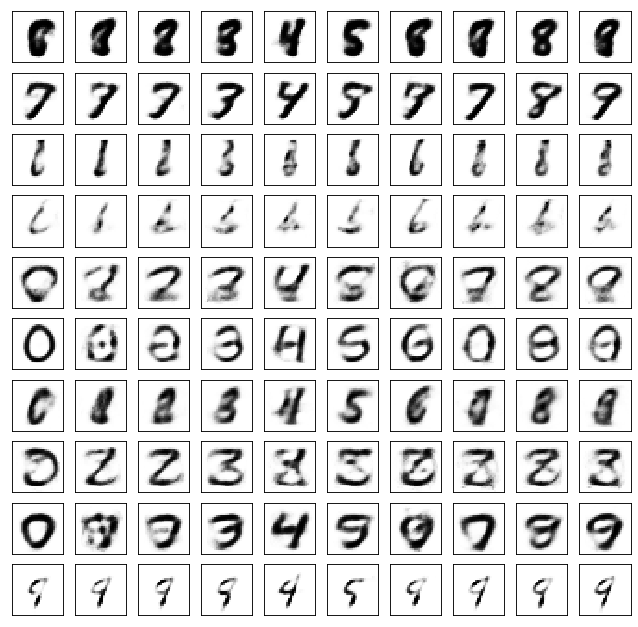

	reconstruction


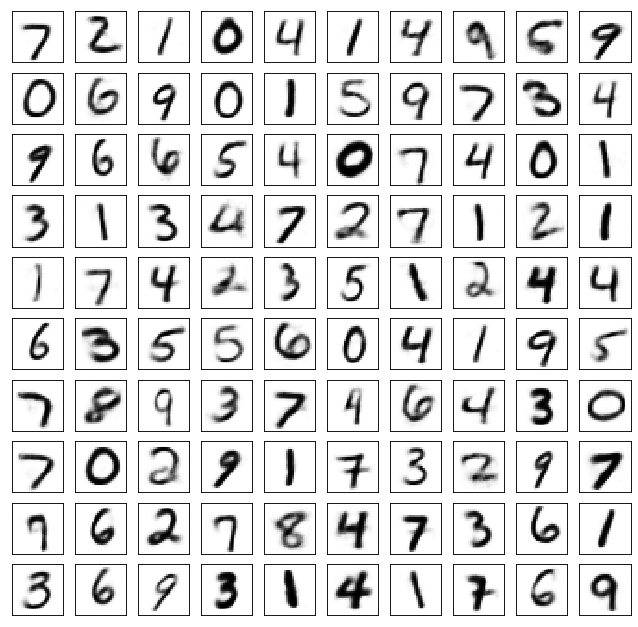

Test losses. E: 0.6808, AE: 0.0668, D: 0.6968
Train Epoch: 125 [0/50000 (0%)]	Losses E: 0.6555, AE: 0.0599, D: 0.6986
Train Epoch: 125 [25000/50000 (50%)]	Losses E: 0.6622, AE: 0.0617, D: 0.6948
Train Epoch: 125 [50000/50000 (100%)]	Losses E: 0.7100, AE: 0.0636, D: 0.6956
	generation


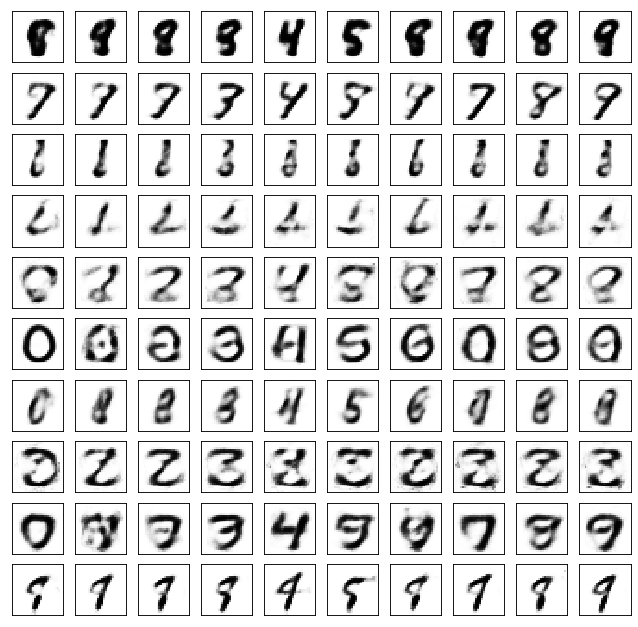

	reconstruction


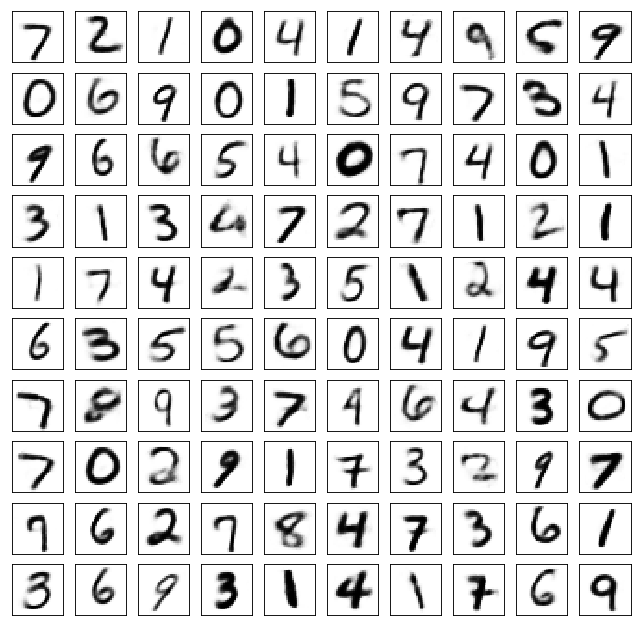

Test losses. E: 0.7102, AE: 0.0604, D: 0.6961
Train Epoch: 130 [0/50000 (0%)]	Losses E: 0.6813, AE: 0.0589, D: 0.6966
Train Epoch: 130 [25000/50000 (50%)]	Losses E: 0.7011, AE: 0.0527, D: 0.6925
Train Epoch: 130 [50000/50000 (100%)]	Losses E: 0.6827, AE: 0.0541, D: 0.6942
	generation


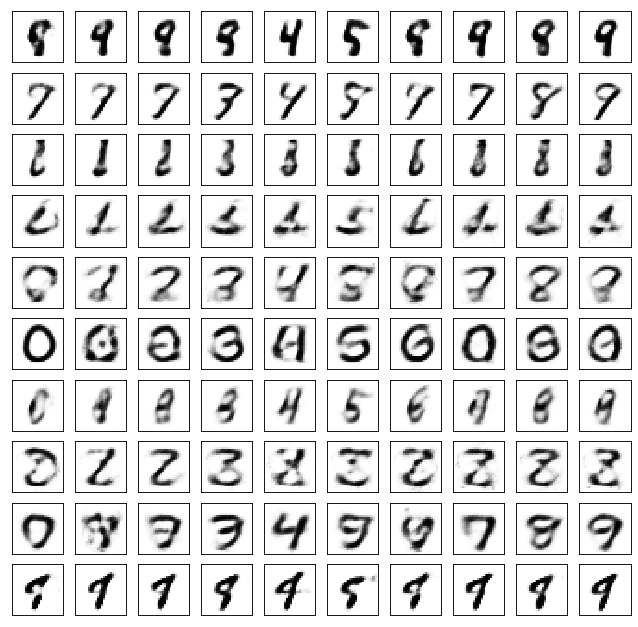

	reconstruction


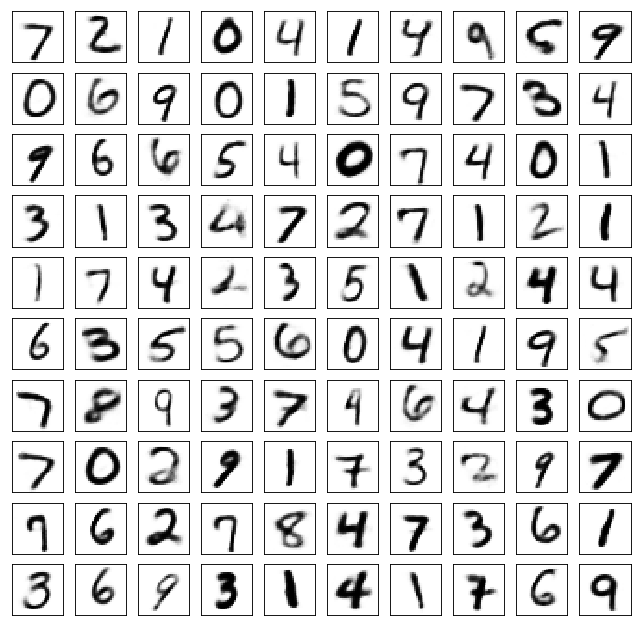

Test losses. E: 0.6829, AE: 0.0562, D: 0.6942
Train Epoch: 135 [0/50000 (0%)]	Losses E: 0.6893, AE: 0.0558, D: 0.6937
Train Epoch: 135 [25000/50000 (50%)]	Losses E: 0.6939, AE: 0.0551, D: 0.6944
Train Epoch: 135 [50000/50000 (100%)]	Losses E: 0.7015, AE: 0.0530, D: 0.6947
	generation


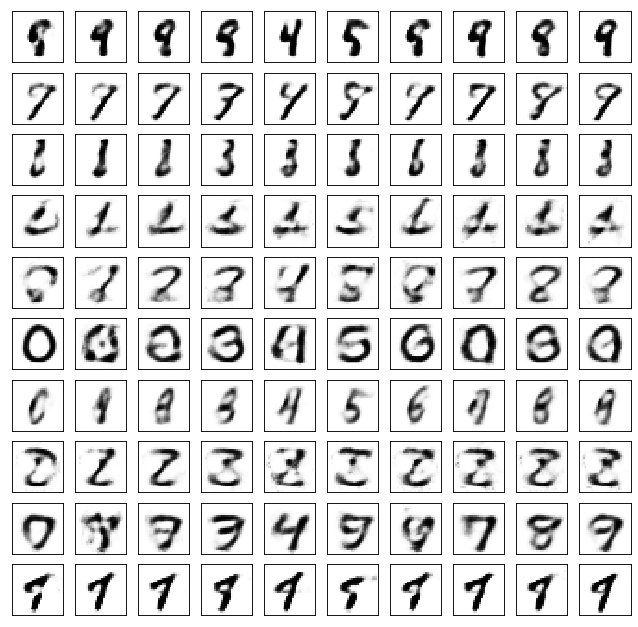

	reconstruction


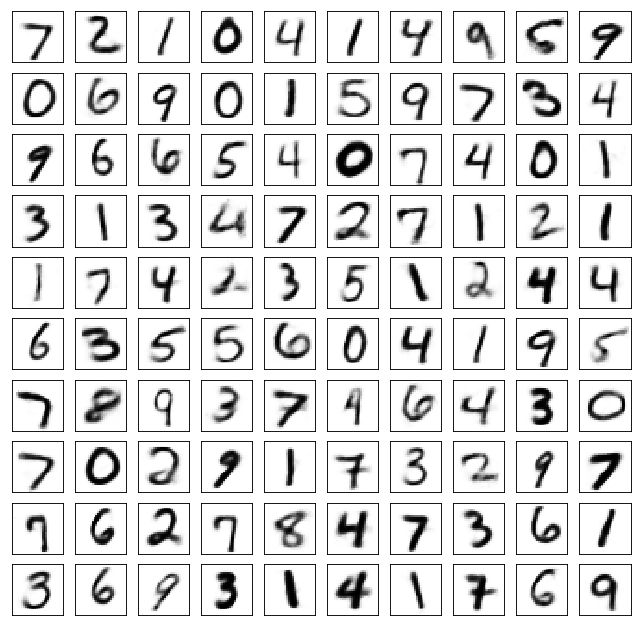

Test losses. E: 0.7005, AE: 0.0548, D: 0.6944
Train Epoch: 140 [0/50000 (0%)]	Losses E: 0.6841, AE: 0.0525, D: 0.6955
Train Epoch: 140 [25000/50000 (50%)]	Losses E: 0.7016, AE: 0.0518, D: 0.6949
Train Epoch: 140 [50000/50000 (100%)]	Losses E: 0.6962, AE: 0.0520, D: 0.6932
	generation


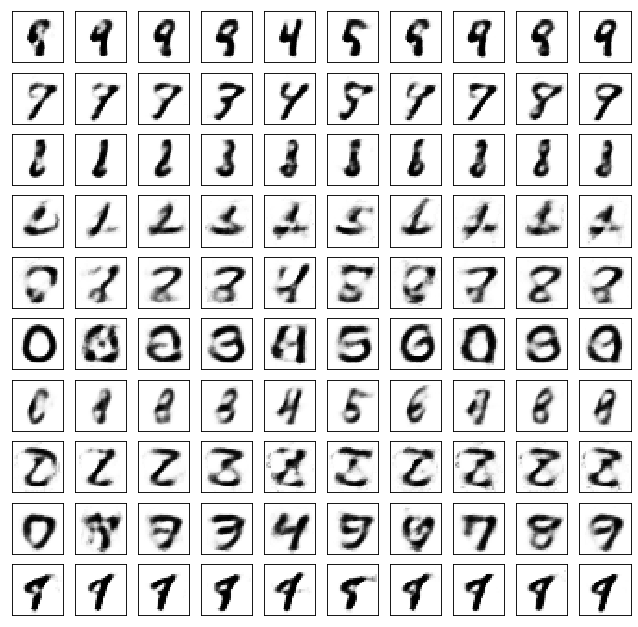

	reconstruction


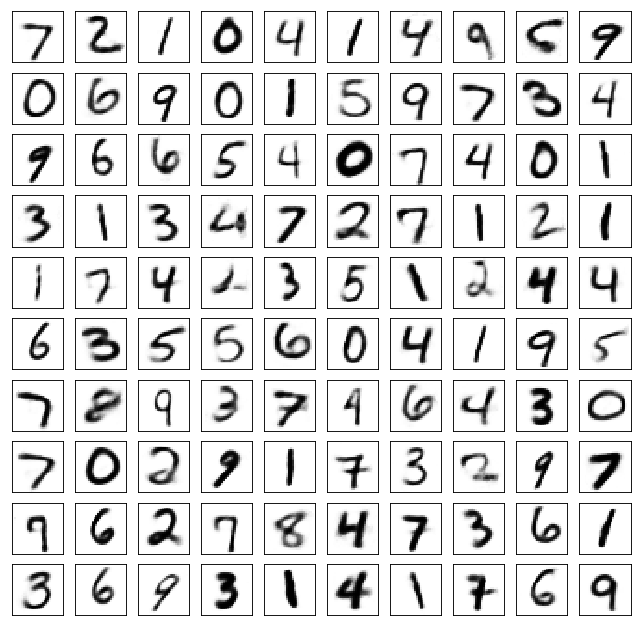

Test losses. E: 0.6963, AE: 0.0534, D: 0.6929
Train Epoch: 145 [0/50000 (0%)]	Losses E: 0.6976, AE: 0.0452, D: 0.6960
Train Epoch: 145 [25000/50000 (50%)]	Losses E: 0.6884, AE: 0.0497, D: 0.6936
Train Epoch: 145 [50000/50000 (100%)]	Losses E: 0.7069, AE: 0.0476, D: 0.6926
	generation


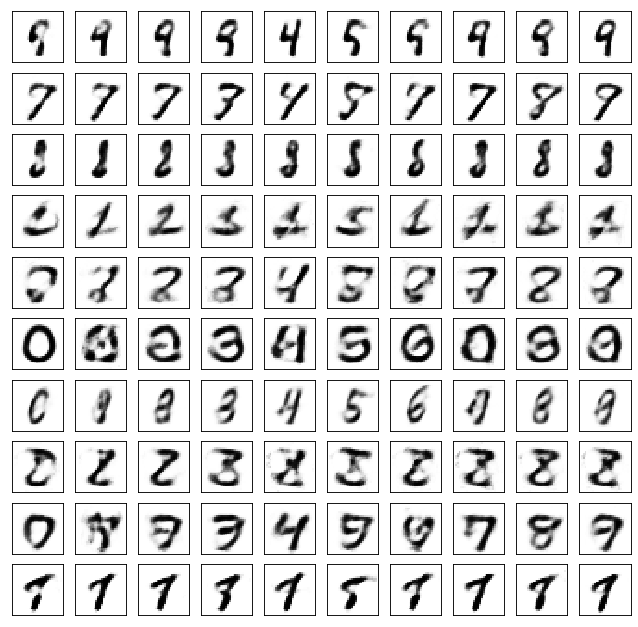

	reconstruction


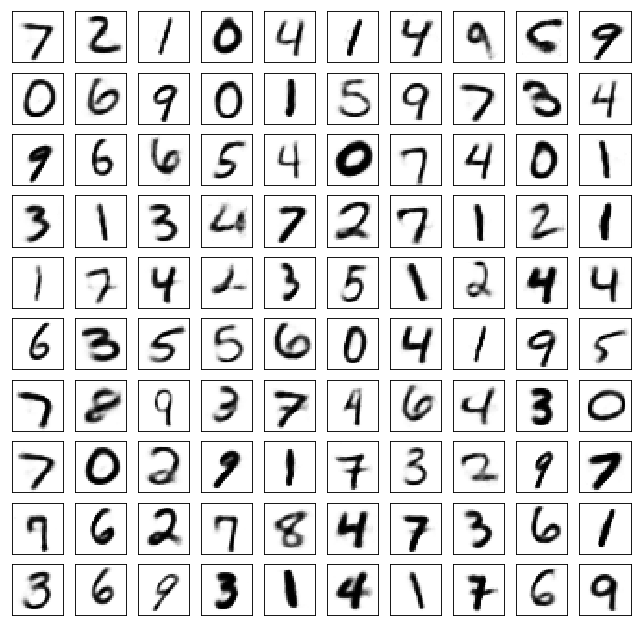

Test losses. E: 0.7057, AE: 0.0521, D: 0.6930
Train Epoch: 150 [0/50000 (0%)]	Losses E: 0.6928, AE: 0.0487, D: 0.6939
Train Epoch: 150 [25000/50000 (50%)]	Losses E: 0.6978, AE: 0.0464, D: 0.6952
Train Epoch: 150 [50000/50000 (100%)]	Losses E: 0.6926, AE: 0.0474, D: 0.6929
	generation


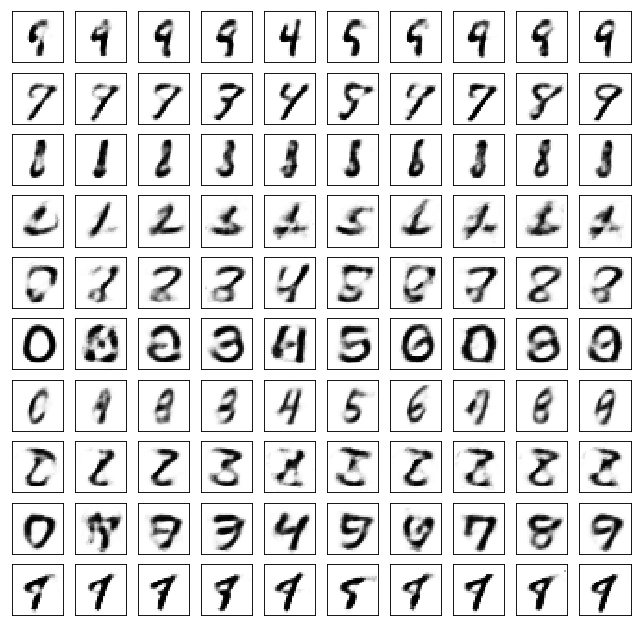

	reconstruction


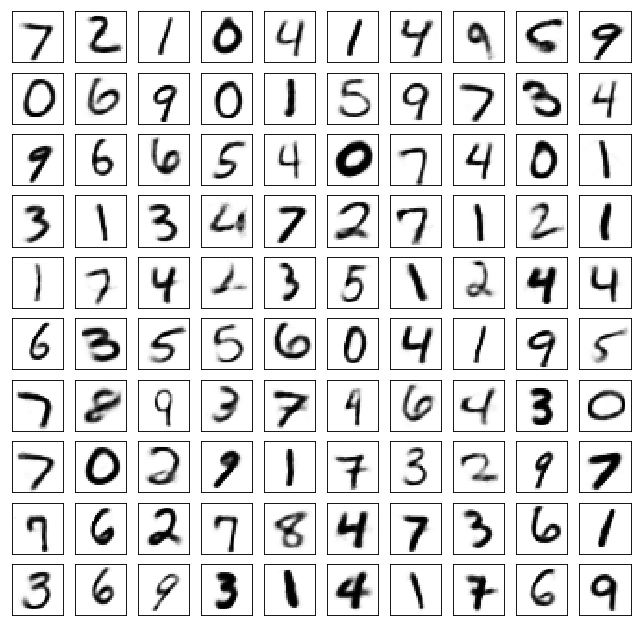

Test losses. E: 0.6925, AE: 0.0490, D: 0.6924
Train Epoch: 155 [0/50000 (0%)]	Losses E: 0.7021, AE: 0.0459, D: 0.6943
Train Epoch: 155 [25000/50000 (50%)]	Losses E: 0.7015, AE: 0.0431, D: 0.6926
Train Epoch: 155 [50000/50000 (100%)]	Losses E: 0.7020, AE: 0.0452, D: 0.6931
	generation


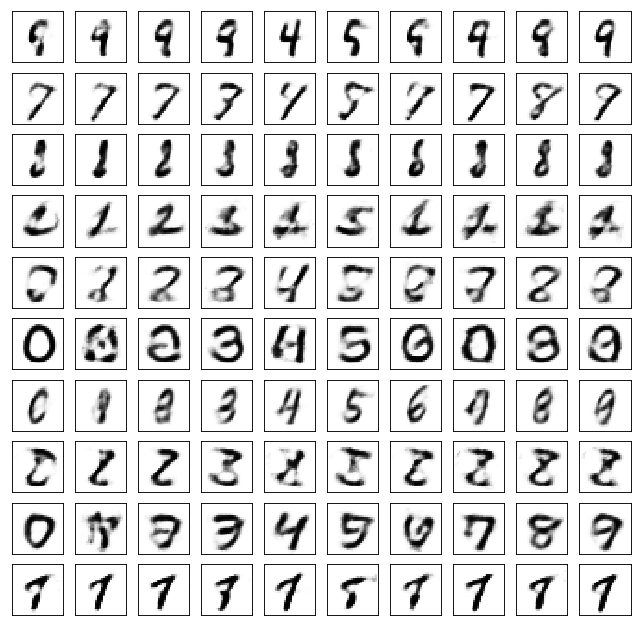

	reconstruction


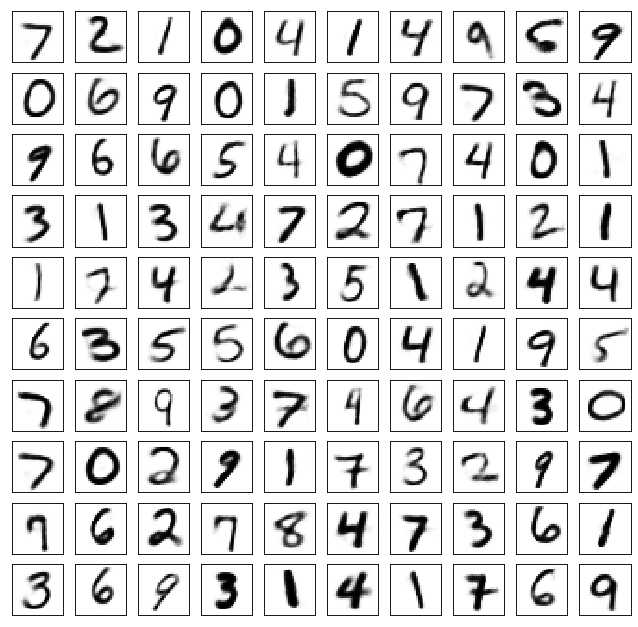

Test losses. E: 0.7003, AE: 0.0496, D: 0.6939
Train Epoch: 160 [0/50000 (0%)]	Losses E: 0.6871, AE: 0.0440, D: 0.6941
Train Epoch: 160 [25000/50000 (50%)]	Losses E: 0.6909, AE: 0.0458, D: 0.6933
Train Epoch: 160 [50000/50000 (100%)]	Losses E: 0.6974, AE: 0.0460, D: 0.6929
	generation


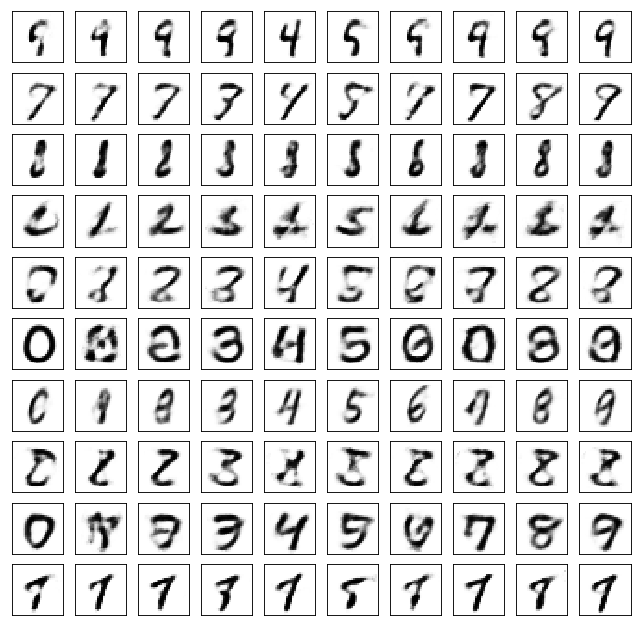

	reconstruction


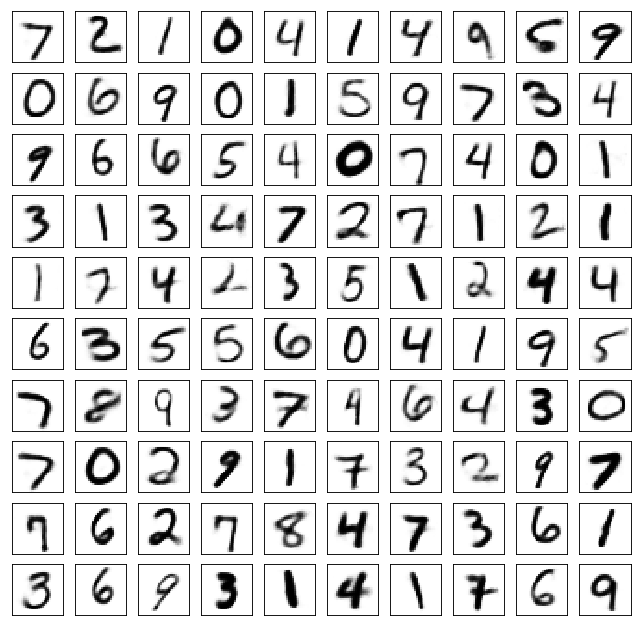

Test losses. E: 0.6974, AE: 0.0475, D: 0.6926
Train Epoch: 165 [0/50000 (0%)]	Losses E: 0.6889, AE: 0.0442, D: 0.6934
Train Epoch: 165 [25000/50000 (50%)]	Losses E: 0.6873, AE: 0.0416, D: 0.6927
Train Epoch: 165 [50000/50000 (100%)]	Losses E: 0.7018, AE: 0.0443, D: 0.6930
	generation


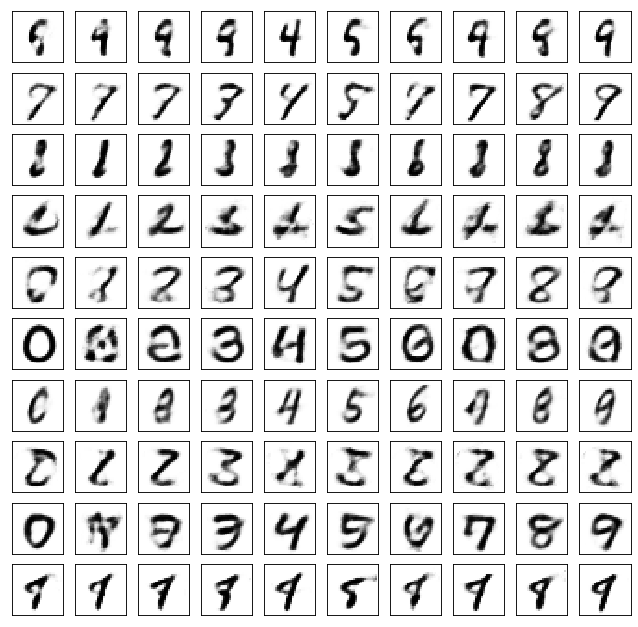

	reconstruction


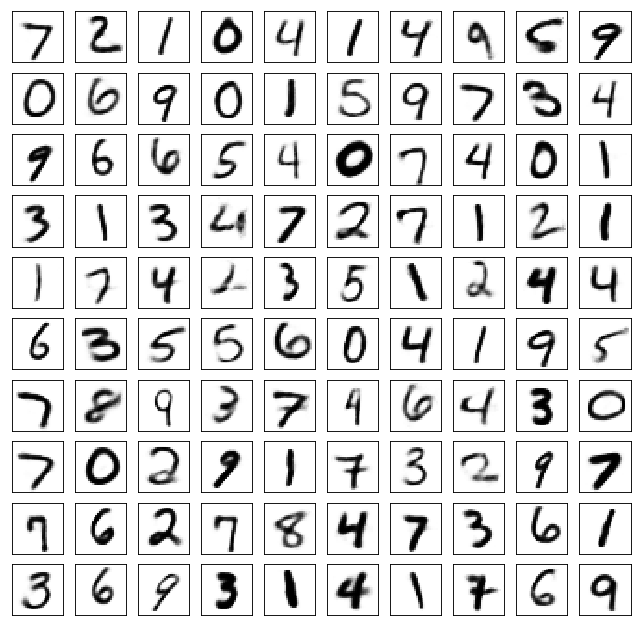

Test losses. E: 0.7005, AE: 0.0468, D: 0.6931
Train Epoch: 170 [0/50000 (0%)]	Losses E: 0.6859, AE: 0.0417, D: 0.6941
Train Epoch: 170 [25000/50000 (50%)]	Losses E: 0.6808, AE: 0.0430, D: 0.6933
Train Epoch: 170 [50000/50000 (100%)]	Losses E: 0.6904, AE: 0.0422, D: 0.6934
	generation


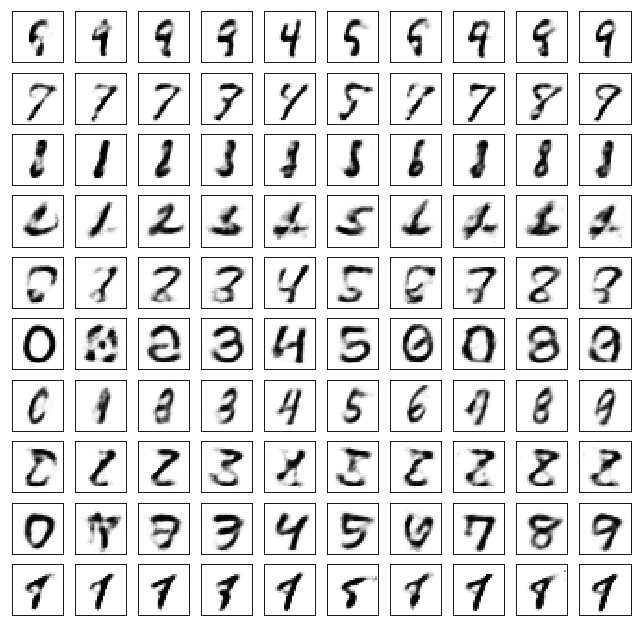

	reconstruction


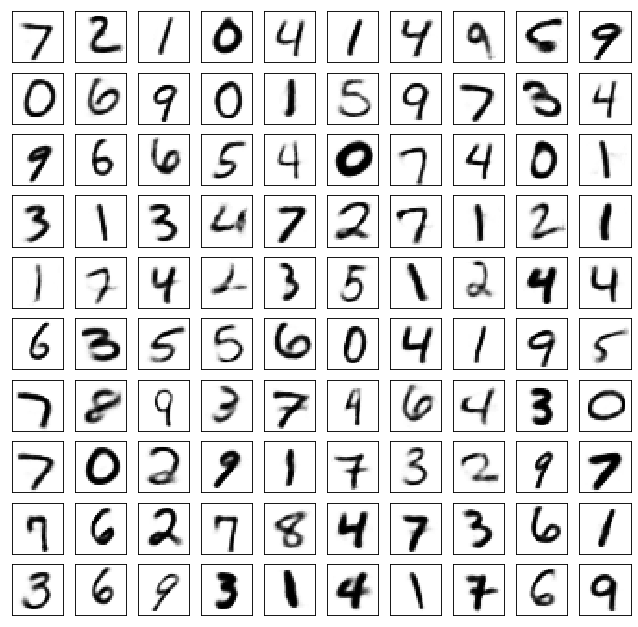

Test losses. E: 0.6896, AE: 0.0463, D: 0.6931
Train Epoch: 175 [0/50000 (0%)]	Losses E: 0.6969, AE: 0.0393, D: 0.6918
Train Epoch: 175 [25000/50000 (50%)]	Losses E: 0.6821, AE: 0.0419, D: 0.6933
Train Epoch: 175 [50000/50000 (100%)]	Losses E: 0.6912, AE: 0.0417, D: 0.6934
	generation


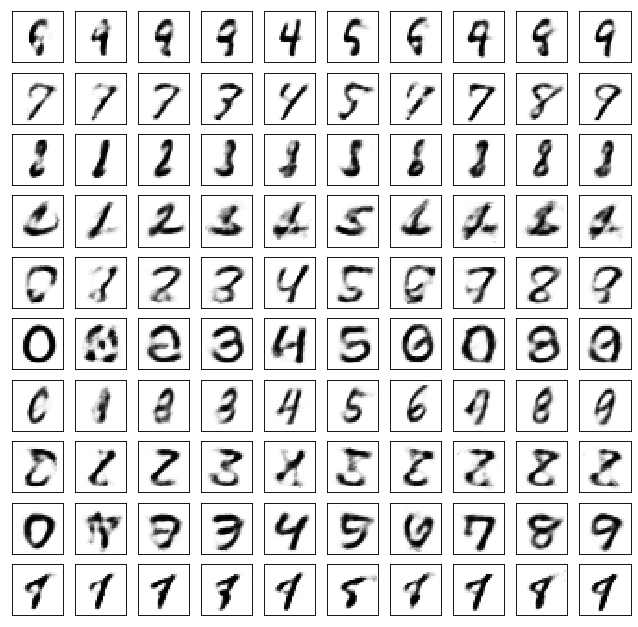

	reconstruction


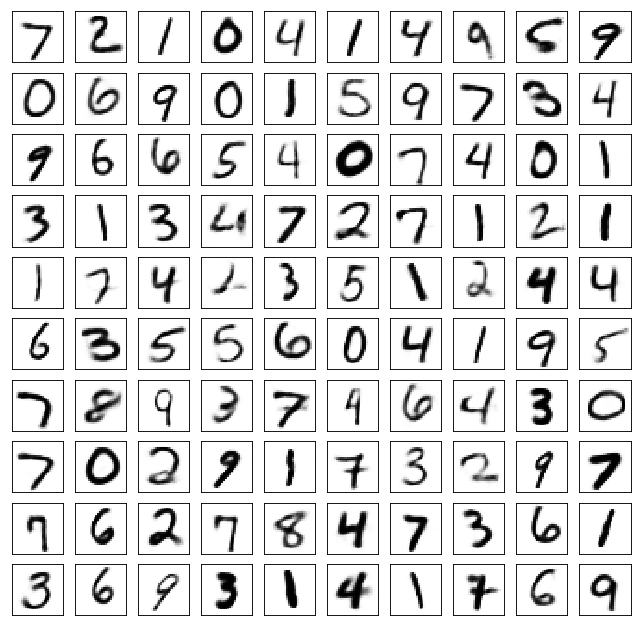

Test losses. E: 0.6895, AE: 0.0459, D: 0.6933
Train Epoch: 180 [0/50000 (0%)]	Losses E: 0.6994, AE: 0.0381, D: 0.6933
Train Epoch: 180 [25000/50000 (50%)]	Losses E: 0.6931, AE: 0.0385, D: 0.6933
Train Epoch: 180 [50000/50000 (100%)]	Losses E: 0.7048, AE: 0.0383, D: 0.6937
	generation


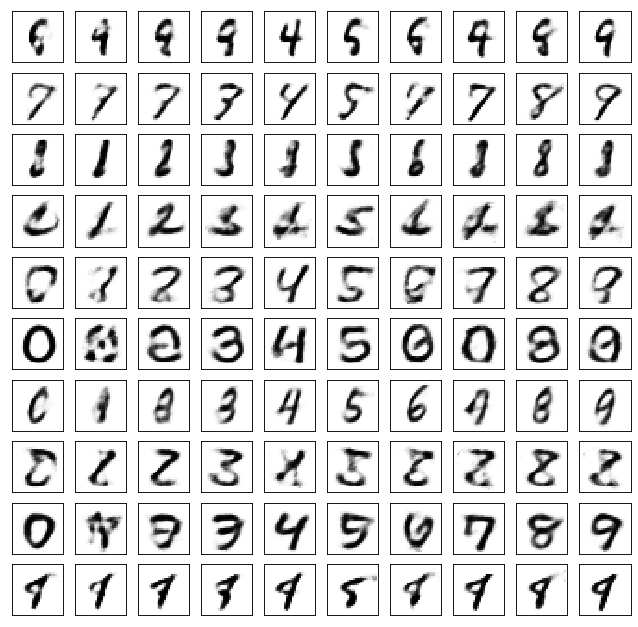

	reconstruction


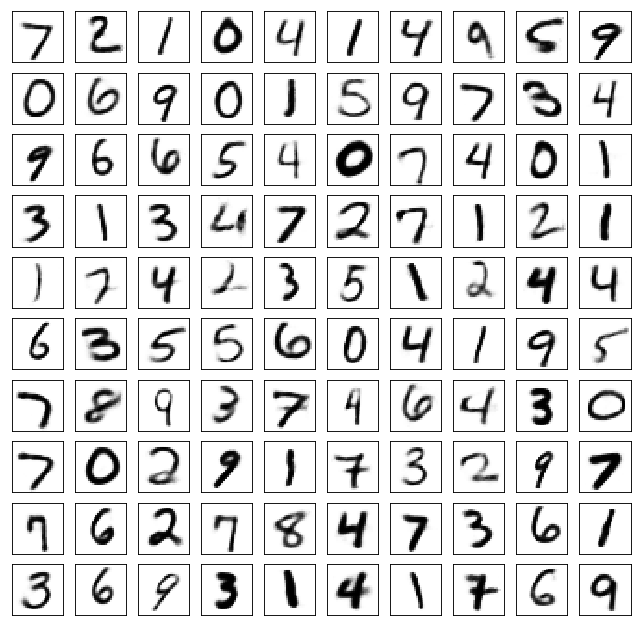

Test losses. E: 0.7048, AE: 0.0455, D: 0.6934
Train Epoch: 185 [0/50000 (0%)]	Losses E: 0.6980, AE: 0.0384, D: 0.6933
Train Epoch: 185 [25000/50000 (50%)]	Losses E: 0.6918, AE: 0.0416, D: 0.6928
Train Epoch: 185 [50000/50000 (100%)]	Losses E: 0.6856, AE: 0.0397, D: 0.6934
	generation


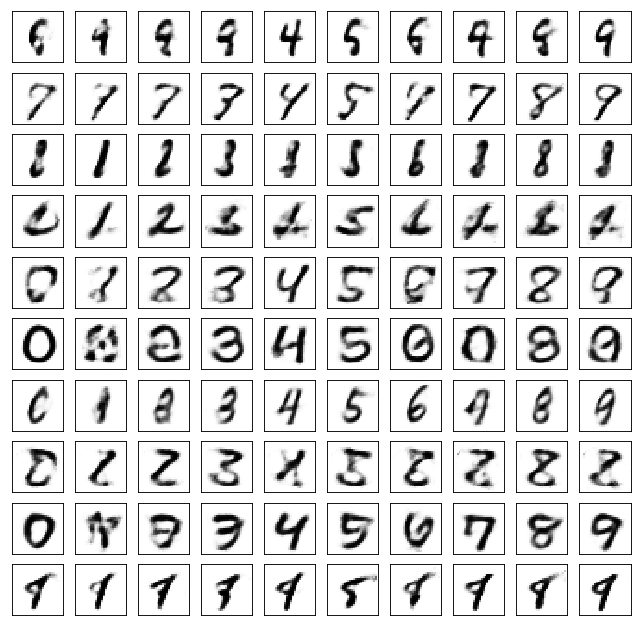

	reconstruction


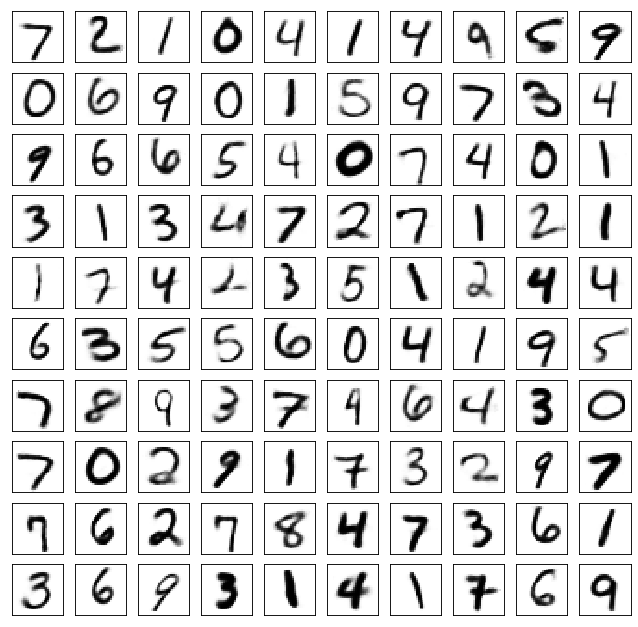

Test losses. E: 0.6858, AE: 0.0452, D: 0.6936
Train Epoch: 190 [0/50000 (0%)]	Losses E: 0.6957, AE: 0.0376, D: 0.6937
Train Epoch: 190 [25000/50000 (50%)]	Losses E: 0.6806, AE: 0.0383, D: 0.6936
Train Epoch: 190 [50000/50000 (100%)]	Losses E: 0.6916, AE: 0.0403, D: 0.6935
	generation


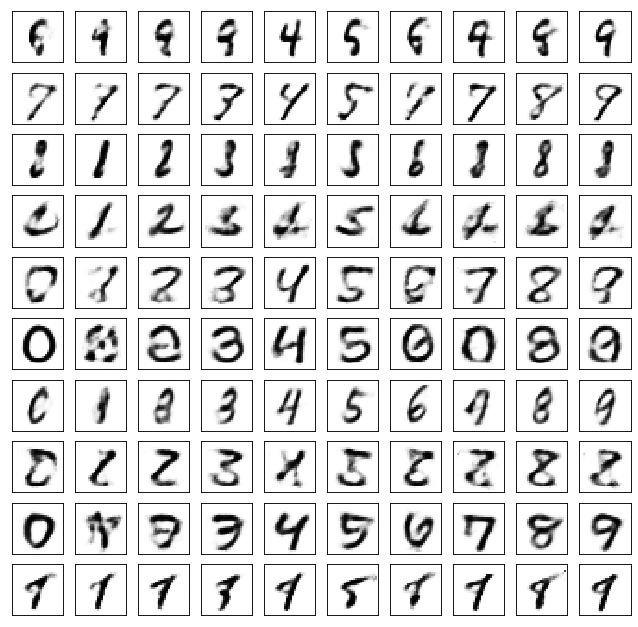

	reconstruction


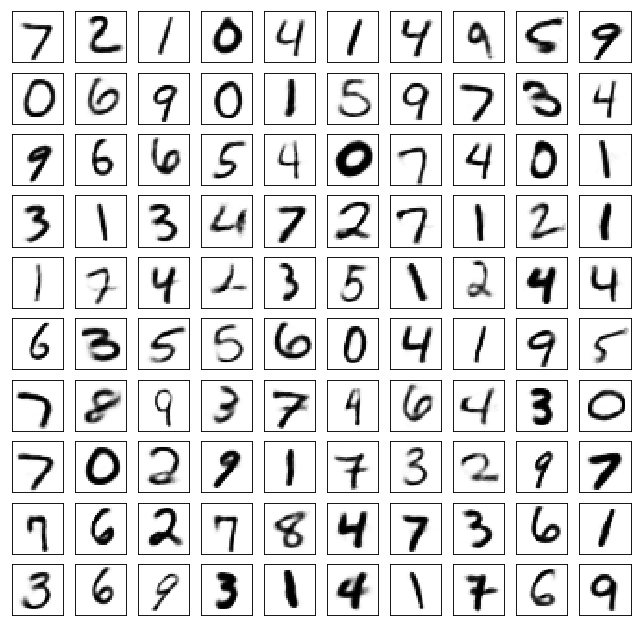

Test losses. E: 0.6905, AE: 0.0443, D: 0.6932
Train Epoch: 195 [0/50000 (0%)]	Losses E: 0.6878, AE: 0.0361, D: 0.6925
Train Epoch: 195 [25000/50000 (50%)]	Losses E: 0.6970, AE: 0.0379, D: 0.6933
Train Epoch: 195 [50000/50000 (100%)]	Losses E: 0.6814, AE: 0.0371, D: 0.6932
	generation


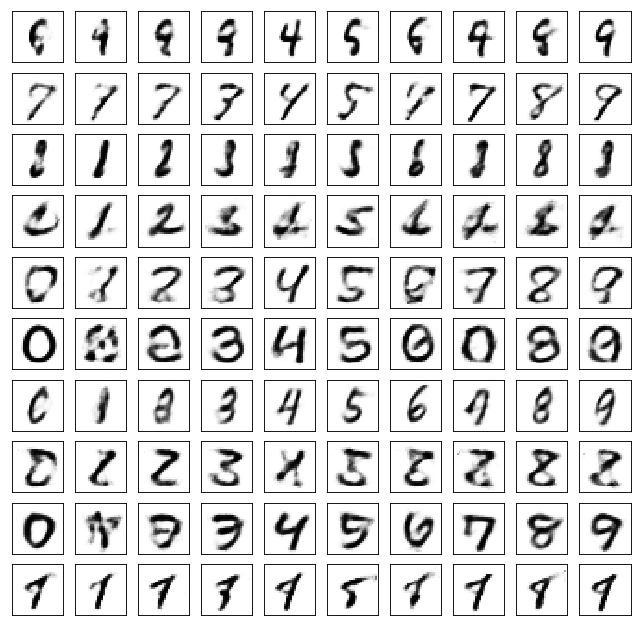

	reconstruction


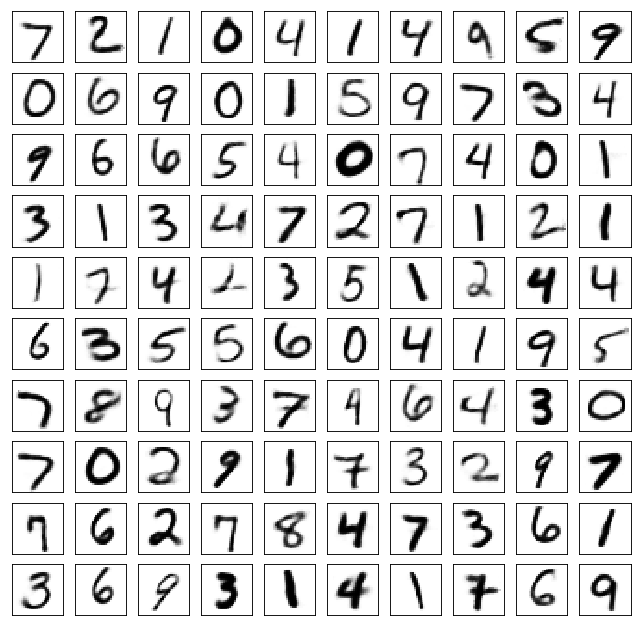

Test losses. E: 0.6817, AE: 0.0441, D: 0.6932
Train Epoch: 200 [0/50000 (0%)]	Losses E: 0.7146, AE: 0.0374, D: 0.6942
Train Epoch: 200 [25000/50000 (50%)]	Losses E: 0.6564, AE: 0.0456, D: 0.6986
Train Epoch: 200 [50000/50000 (100%)]	Losses E: 0.7073, AE: 0.0403, D: 0.6928
	generation


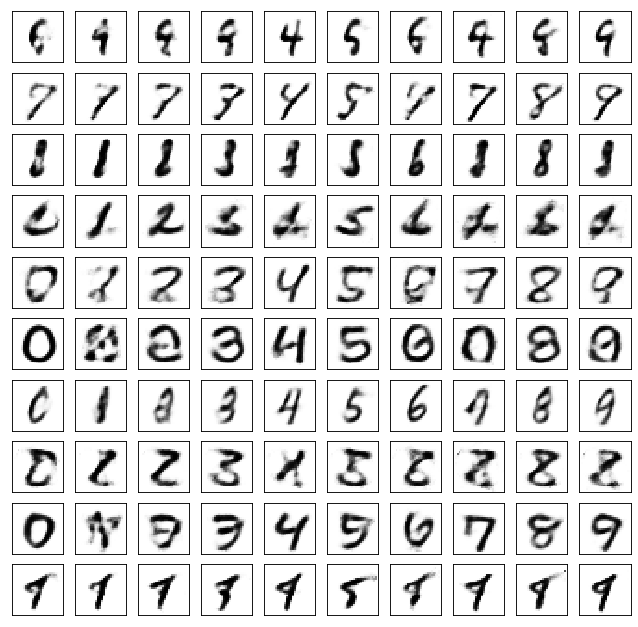

	reconstruction


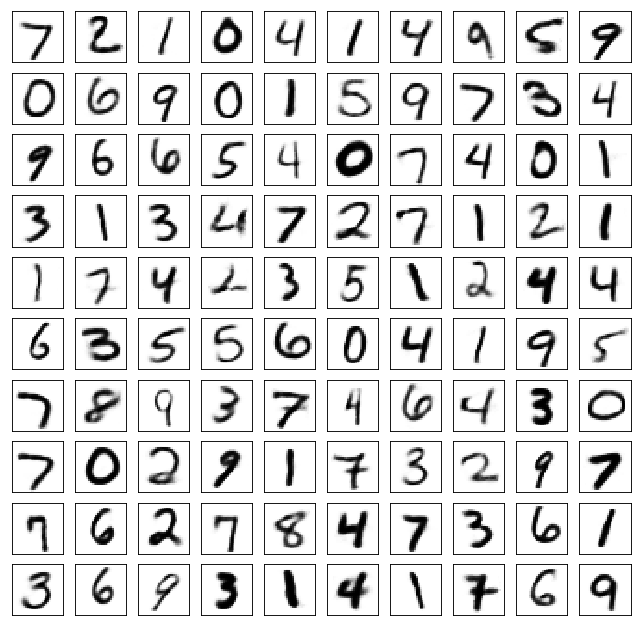

Test losses. E: 0.7065, AE: 0.0452, D: 0.6930
Train Epoch: 205 [0/50000 (0%)]	Losses E: 0.6880, AE: 0.0369, D: 0.6945
Train Epoch: 205 [25000/50000 (50%)]	Losses E: 0.6978, AE: 0.0373, D: 0.6933
Train Epoch: 205 [50000/50000 (100%)]	Losses E: 0.7066, AE: 0.0359, D: 0.6933
	generation


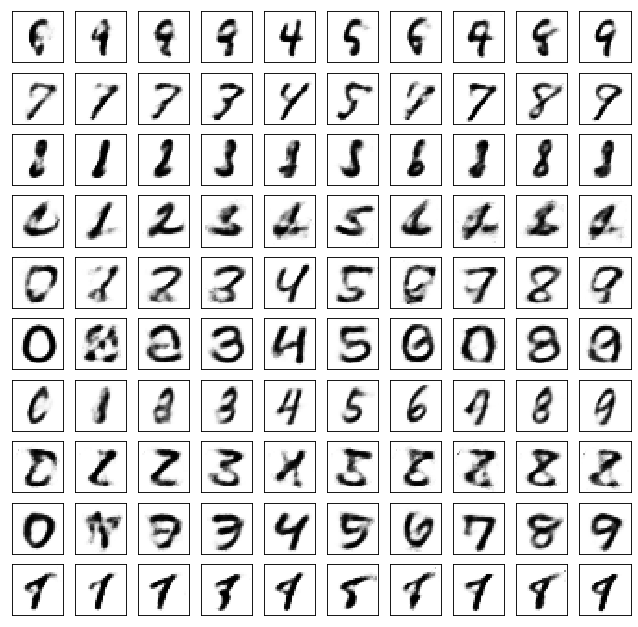

	reconstruction


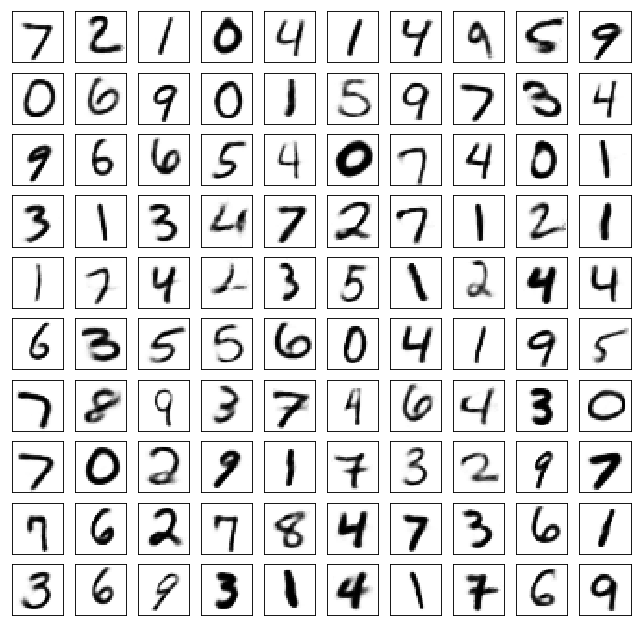

Test losses. E: 0.7062, AE: 0.0441, D: 0.6930
Train Epoch: 210 [0/50000 (0%)]	Losses E: 0.7000, AE: 0.0368, D: 0.6934
Train Epoch: 210 [25000/50000 (50%)]	Losses E: 0.6939, AE: 0.0343, D: 0.6930
Train Epoch: 210 [50000/50000 (100%)]	Losses E: 0.6897, AE: 0.0358, D: 0.6932
	generation


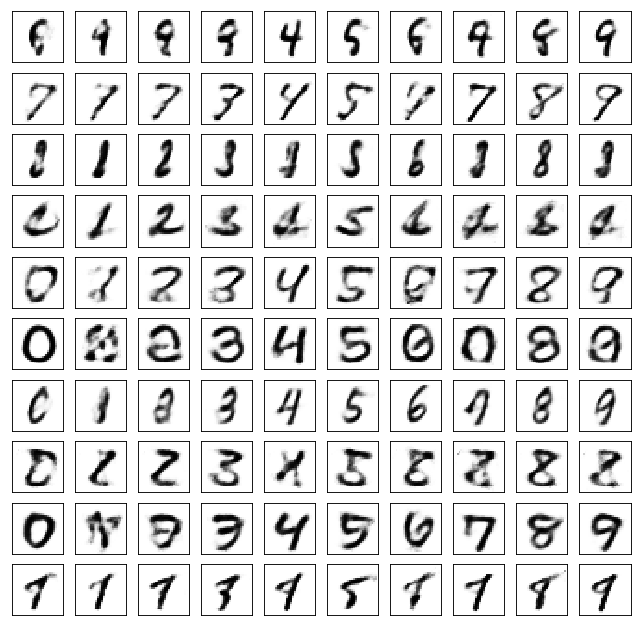

	reconstruction


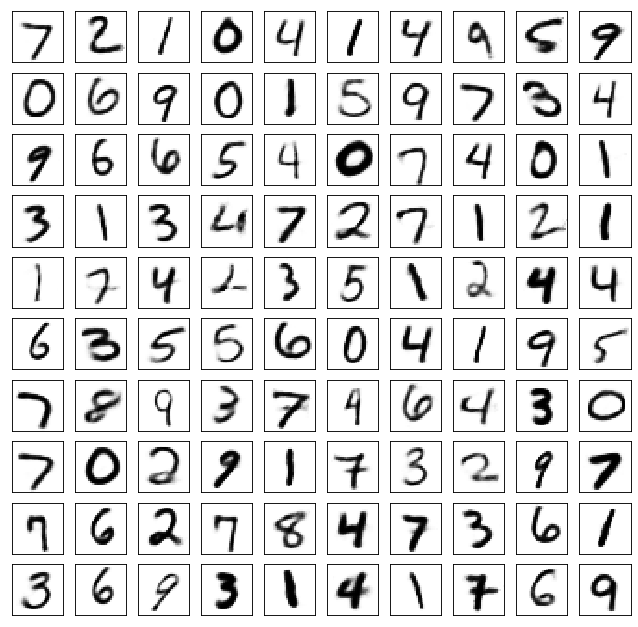

Test losses. E: 0.6896, AE: 0.0438, D: 0.6930
Train Epoch: 215 [0/50000 (0%)]	Losses E: 0.6896, AE: 0.0327, D: 0.6941
Train Epoch: 215 [25000/50000 (50%)]	Losses E: 0.6880, AE: 0.0353, D: 0.6927
Train Epoch: 215 [50000/50000 (100%)]	Losses E: 0.6871, AE: 0.0355, D: 0.6934
	generation


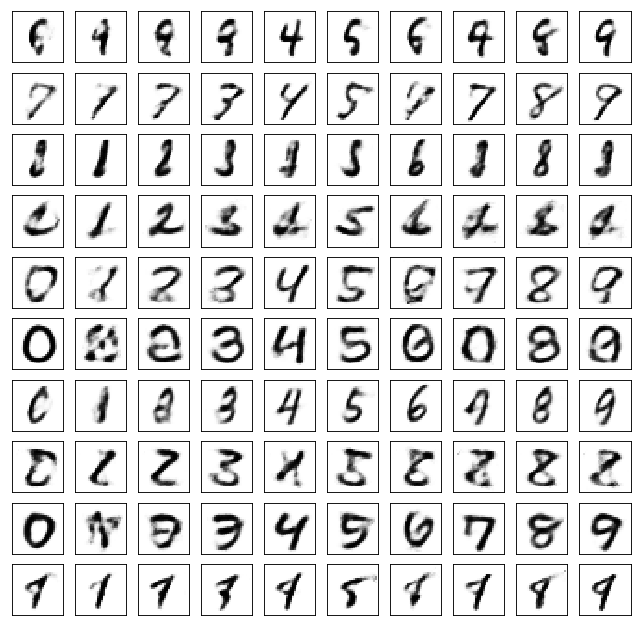

	reconstruction


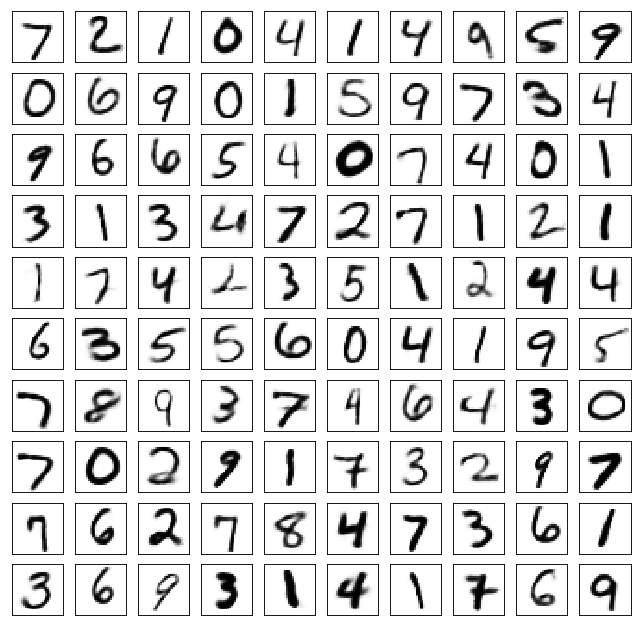

Test losses. E: 0.6868, AE: 0.0437, D: 0.6932
Train Epoch: 220 [0/50000 (0%)]	Losses E: 0.6977, AE: 0.0358, D: 0.6930
Train Epoch: 220 [25000/50000 (50%)]	Losses E: 0.6865, AE: 0.0359, D: 0.6935
Train Epoch: 220 [50000/50000 (100%)]	Losses E: 0.6930, AE: 0.0339, D: 0.6929
	generation


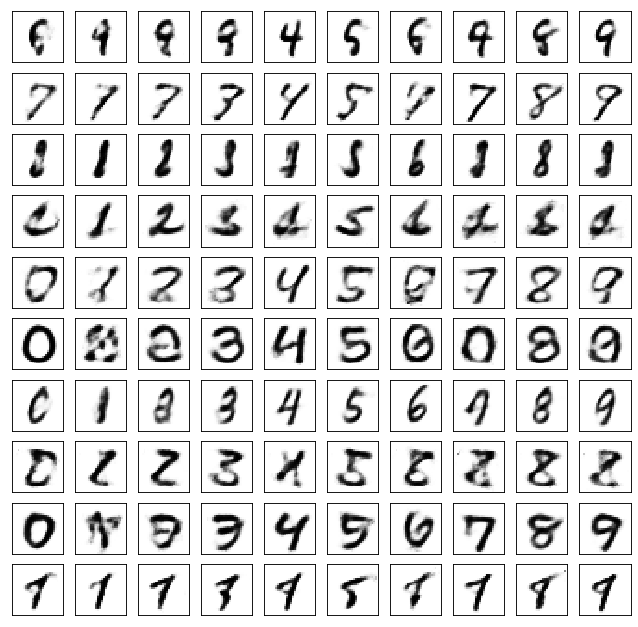

	reconstruction


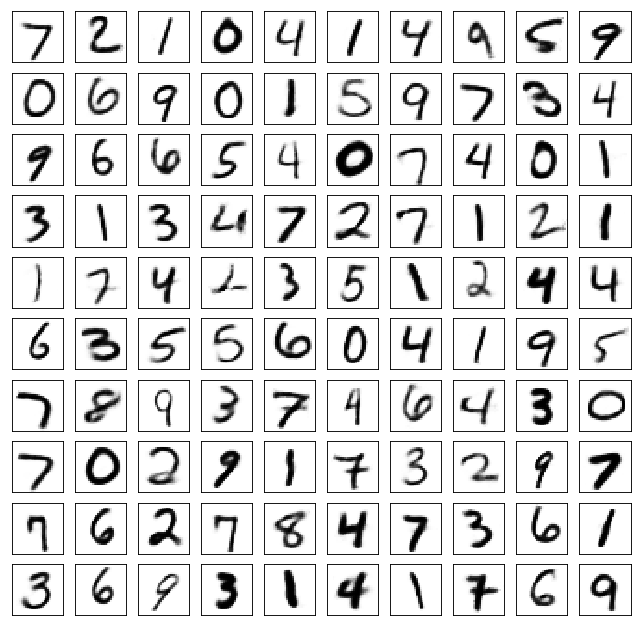

Test losses. E: 0.6926, AE: 0.0431, D: 0.6929
Train Epoch: 225 [0/50000 (0%)]	Losses E: 0.6989, AE: 0.0343, D: 0.6925
Train Epoch: 225 [25000/50000 (50%)]	Losses E: 0.6904, AE: 0.0348, D: 0.6931
Train Epoch: 225 [50000/50000 (100%)]	Losses E: 0.6947, AE: 0.0352, D: 0.6928
	generation


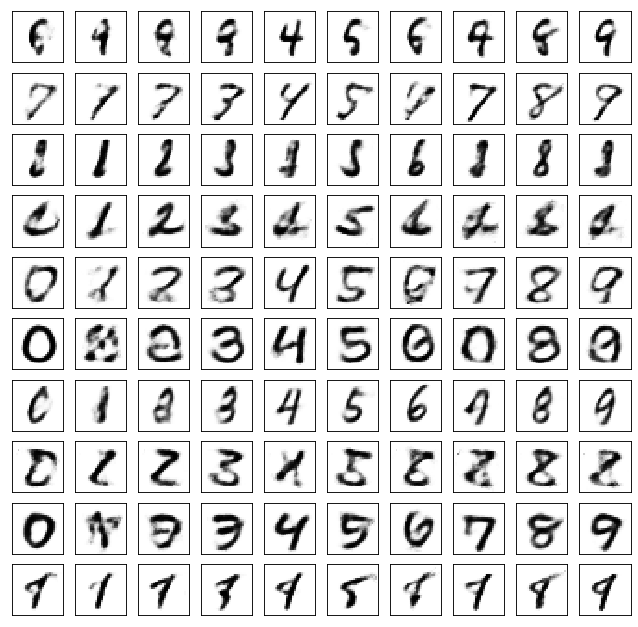

	reconstruction


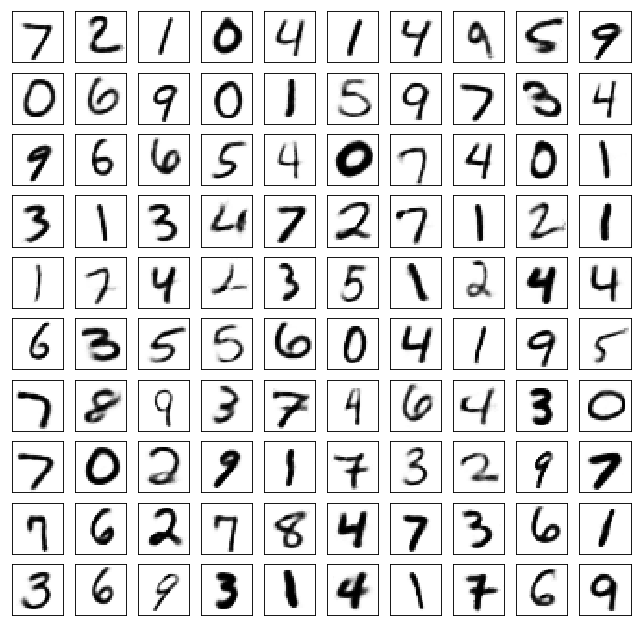

Test losses. E: 0.6935, AE: 0.0430, D: 0.6934
Train Epoch: 230 [0/50000 (0%)]	Losses E: 0.6978, AE: 0.0317, D: 0.6922
Train Epoch: 230 [25000/50000 (50%)]	Losses E: 0.7096, AE: 0.0351, D: 0.6928
Train Epoch: 230 [50000/50000 (100%)]	Losses E: 0.6949, AE: 0.0361, D: 0.6938
	generation


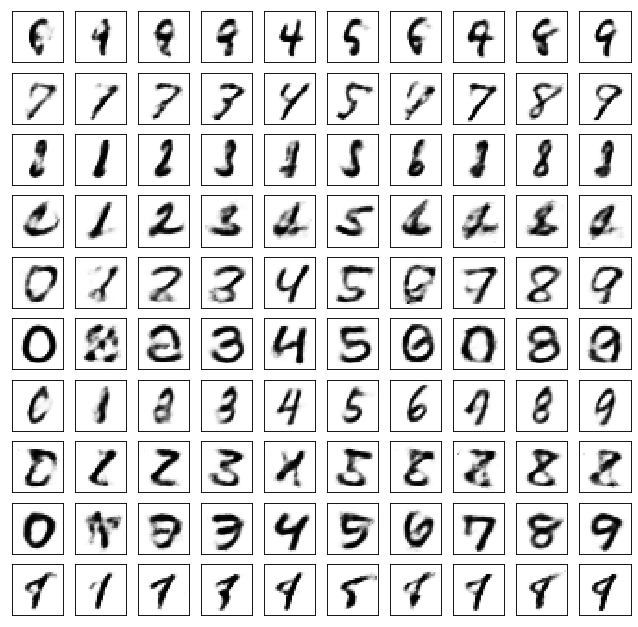

	reconstruction


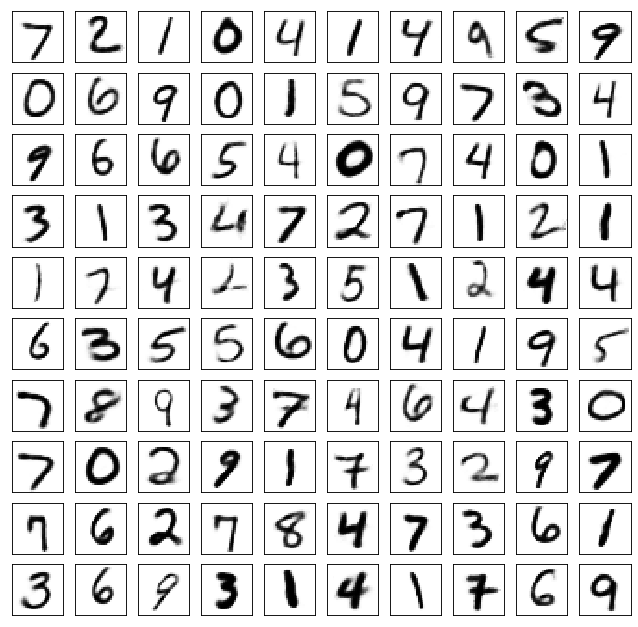

Test losses. E: 0.6935, AE: 0.0432, D: 0.6932
Train Epoch: 235 [0/50000 (0%)]	Losses E: 0.6904, AE: 0.0336, D: 0.6939
Train Epoch: 235 [25000/50000 (50%)]	Losses E: 0.6825, AE: 0.0322, D: 0.6929
Train Epoch: 235 [50000/50000 (100%)]	Losses E: 0.6946, AE: 0.0356, D: 0.6944
	generation


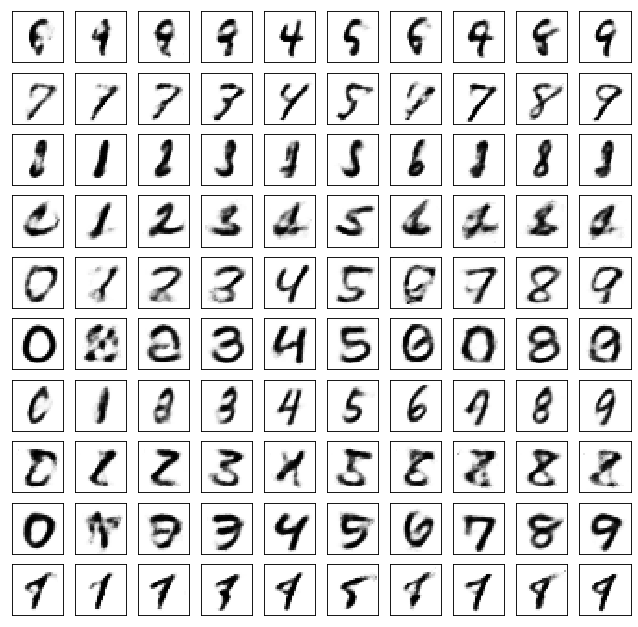

	reconstruction


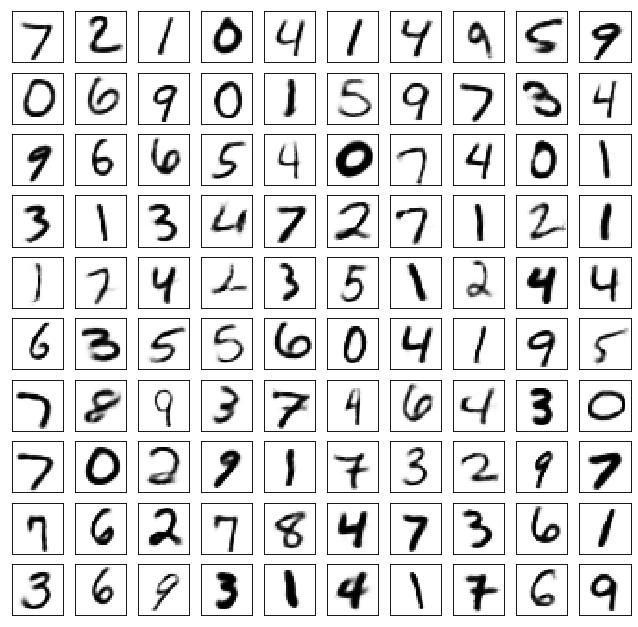

Test losses. E: 0.6945, AE: 0.0433, D: 0.6933
Train Epoch: 240 [0/50000 (0%)]	Losses E: 0.7052, AE: 0.0315, D: 0.6929
Train Epoch: 240 [25000/50000 (50%)]	Losses E: 0.7037, AE: 0.0334, D: 0.6930
Train Epoch: 240 [50000/50000 (100%)]	Losses E: 0.7013, AE: 0.0339, D: 0.6938
	generation


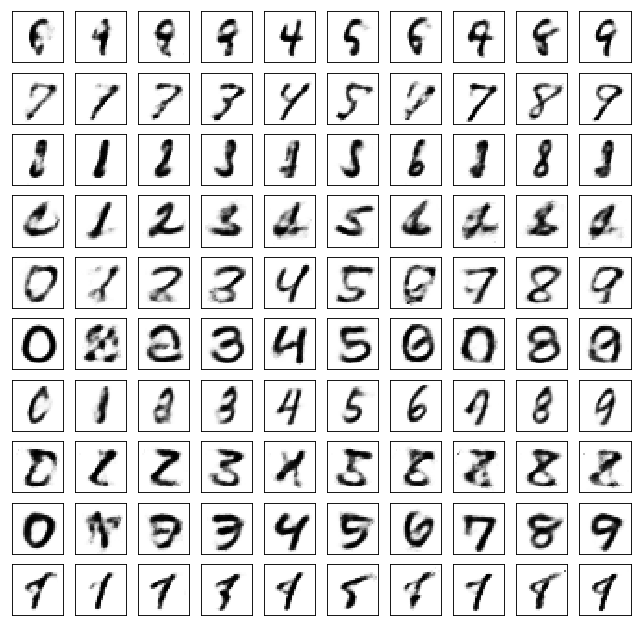

	reconstruction


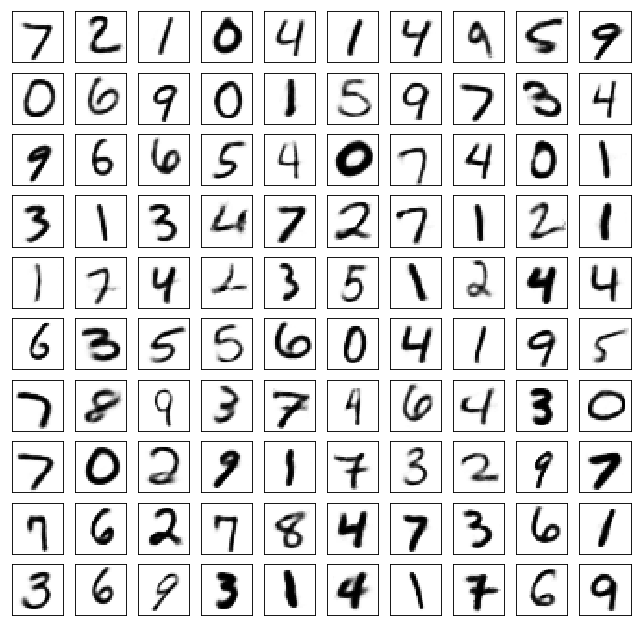

Test losses. E: 0.7007, AE: 0.0427, D: 0.6932
Train Epoch: 245 [0/50000 (0%)]	Losses E: 0.6992, AE: 0.0328, D: 0.6931
Train Epoch: 245 [25000/50000 (50%)]	Losses E: 0.6973, AE: 0.0328, D: 0.6932
Train Epoch: 245 [50000/50000 (100%)]	Losses E: 0.6967, AE: 0.0329, D: 0.6934
	generation


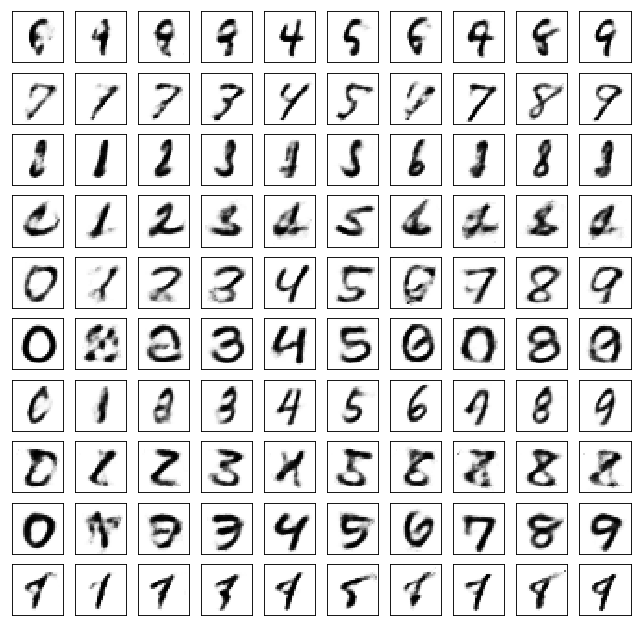

	reconstruction


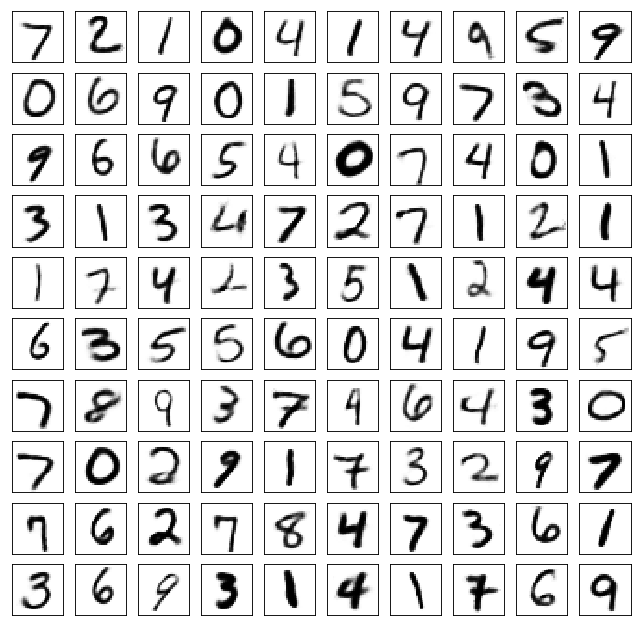

Test losses. E: 0.6965, AE: 0.0428, D: 0.6930
Train Epoch: 250 [0/50000 (0%)]	Losses E: 0.6995, AE: 0.0341, D: 0.6929
Train Epoch: 250 [25000/50000 (50%)]	Losses E: 0.6927, AE: 0.0348, D: 0.6929
Train Epoch: 250 [50000/50000 (100%)]	Losses E: 0.6958, AE: 0.0308, D: 0.6930
	generation


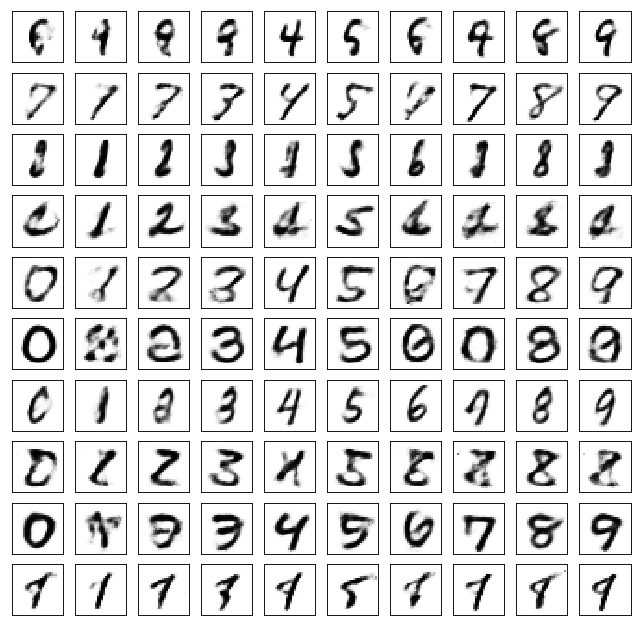

	reconstruction


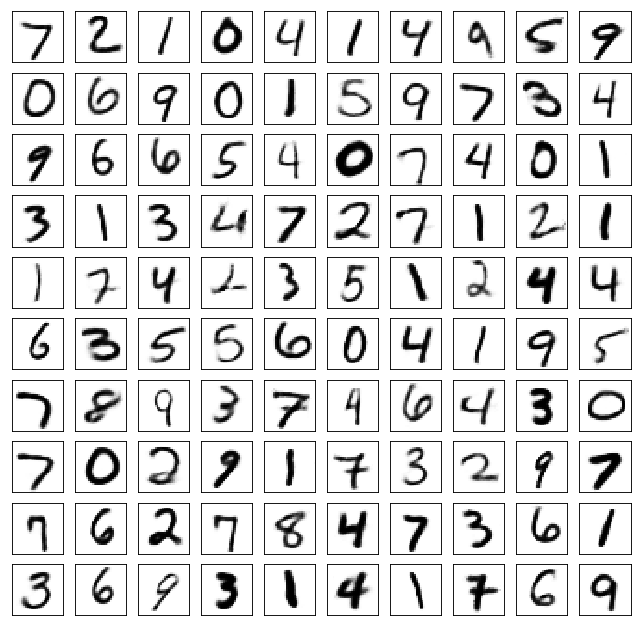

Test losses. E: 0.6952, AE: 0.0424, D: 0.6930
Train Epoch: 255 [0/50000 (0%)]	Losses E: 0.6909, AE: 0.0307, D: 0.6939
Train Epoch: 255 [25000/50000 (50%)]	Losses E: 0.6918, AE: 0.0329, D: 0.6935
Train Epoch: 255 [50000/50000 (100%)]	Losses E: 0.6976, AE: 0.0329, D: 0.6939
	generation


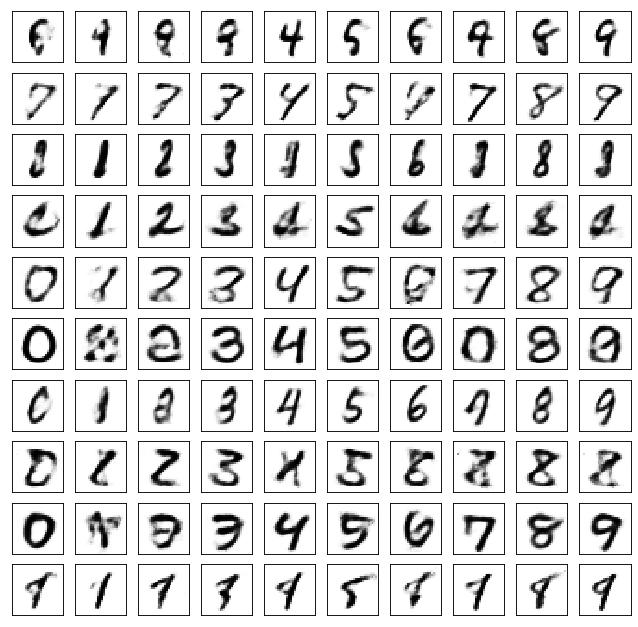

	reconstruction


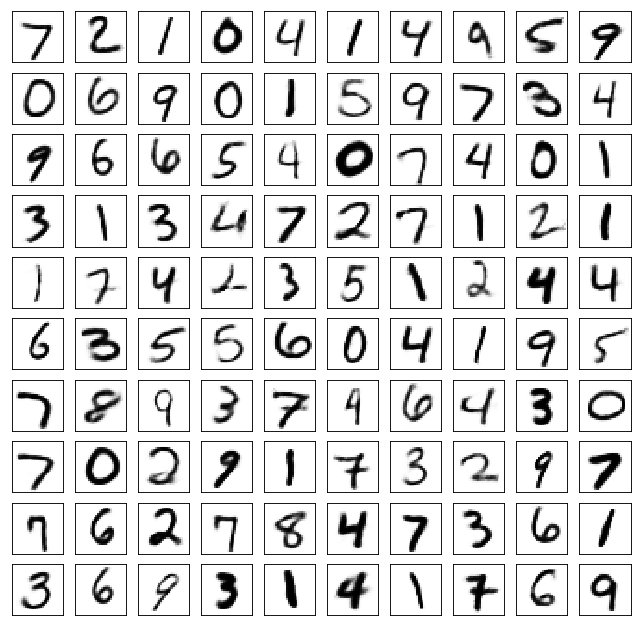

Test losses. E: 0.6956, AE: 0.0426, D: 0.6932
Train Epoch: 260 [0/50000 (0%)]	Losses E: 0.6964, AE: 0.0323, D: 0.6927
Train Epoch: 260 [25000/50000 (50%)]	Losses E: 0.7050, AE: 0.0319, D: 0.6921
Train Epoch: 260 [50000/50000 (100%)]	Losses E: 0.6997, AE: 0.0344, D: 0.6931
	generation


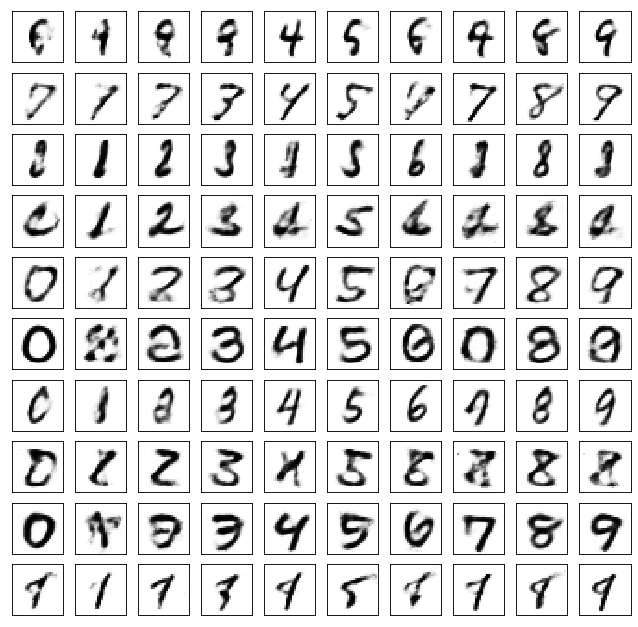

	reconstruction


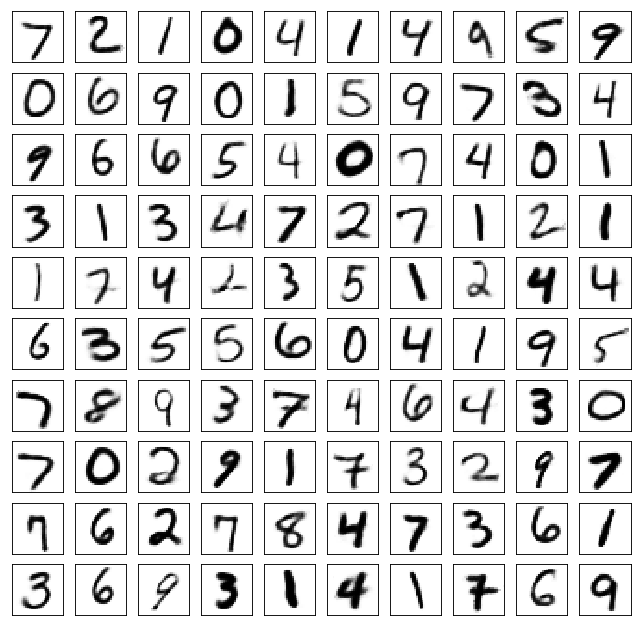

Test losses. E: 0.6982, AE: 0.0427, D: 0.6931
Train Epoch: 265 [0/50000 (0%)]	Losses E: 0.6969, AE: 0.0322, D: 0.6937
Train Epoch: 265 [25000/50000 (50%)]	Losses E: 0.6931, AE: 0.0335, D: 0.6931
Train Epoch: 265 [50000/50000 (100%)]	Losses E: 0.7006, AE: 0.0320, D: 0.6932
	generation


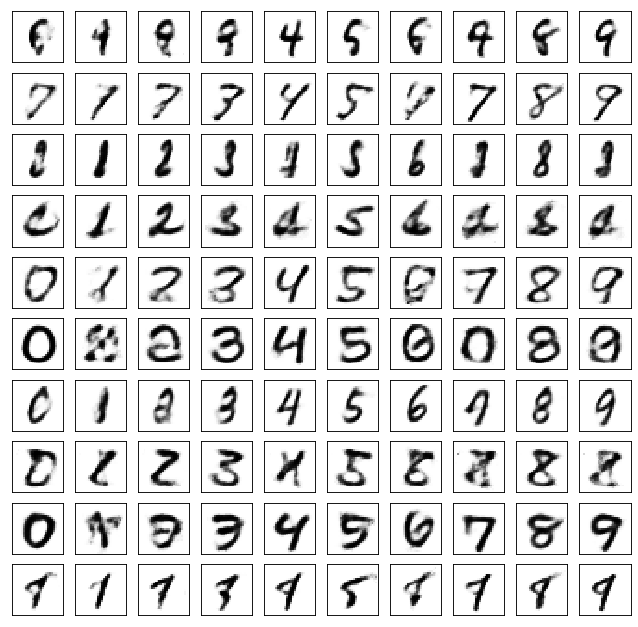

	reconstruction


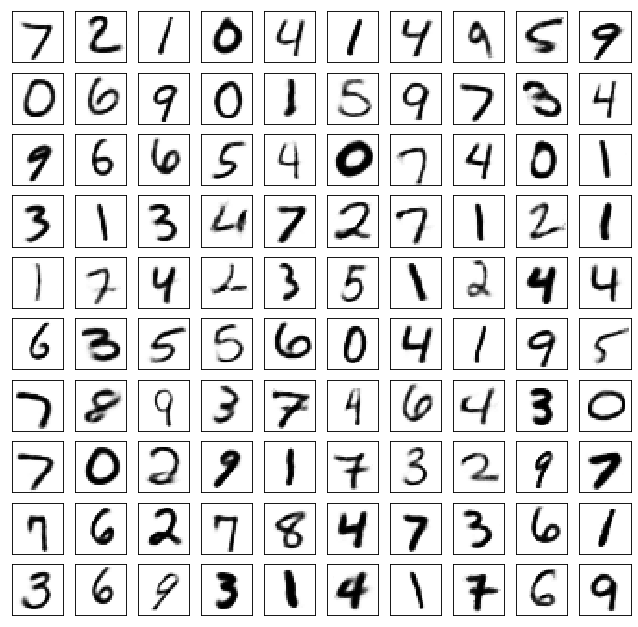

Test losses. E: 0.6982, AE: 0.0427, D: 0.6930
Train Epoch: 270 [0/50000 (0%)]	Losses E: 0.6926, AE: 0.0317, D: 0.6932
Train Epoch: 270 [25000/50000 (50%)]	Losses E: 0.6974, AE: 0.0306, D: 0.6940
Train Epoch: 270 [50000/50000 (100%)]	Losses E: 0.6999, AE: 0.0320, D: 0.6939
	generation


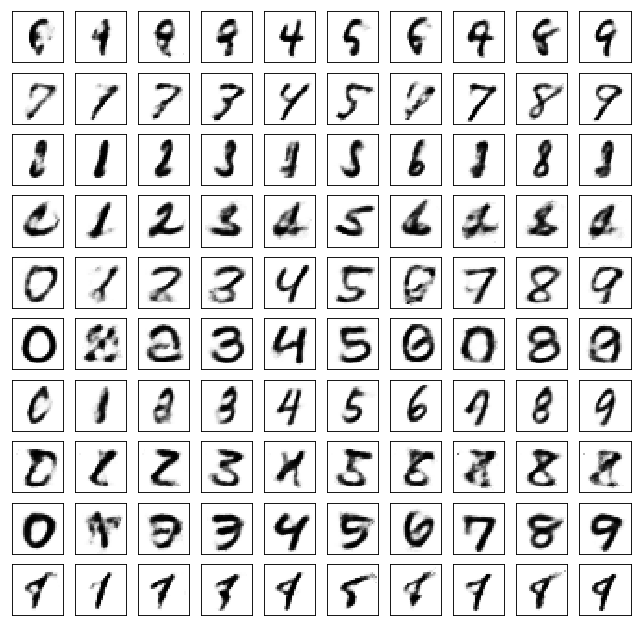

	reconstruction


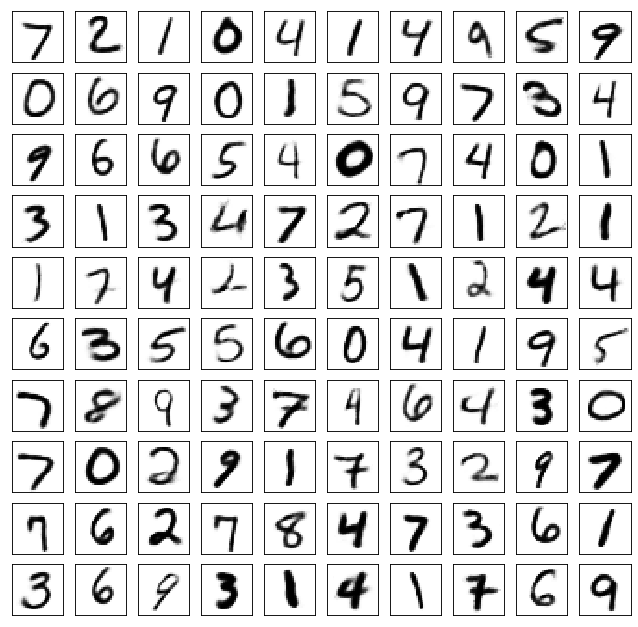

Test losses. E: 0.6992, AE: 0.0421, D: 0.6929
Train Epoch: 275 [0/50000 (0%)]	Losses E: 0.6984, AE: 0.0313, D: 0.6930
Train Epoch: 275 [25000/50000 (50%)]	Losses E: 0.6945, AE: 0.0322, D: 0.6940
Train Epoch: 275 [50000/50000 (100%)]	Losses E: 0.6943, AE: 0.0322, D: 0.6932
	generation


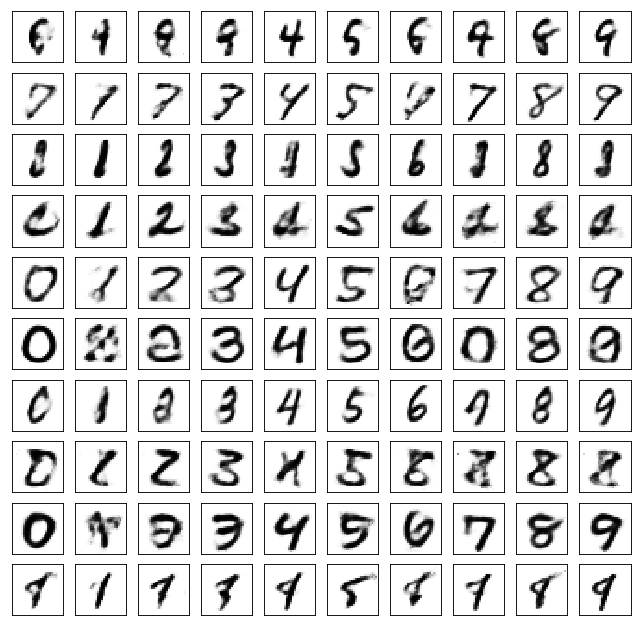

	reconstruction


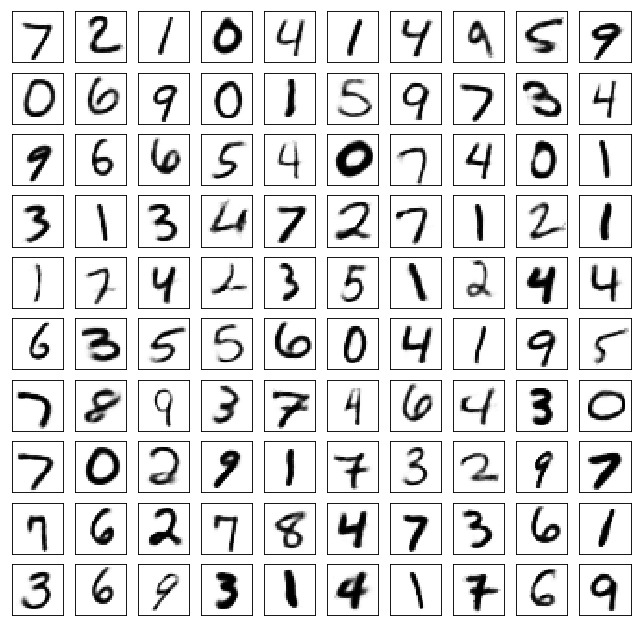

Test losses. E: 0.6939, AE: 0.0424, D: 0.6930
Train Epoch: 280 [0/50000 (0%)]	Losses E: 0.6881, AE: 0.0304, D: 0.6934
Train Epoch: 280 [25000/50000 (50%)]	Losses E: 0.6898, AE: 0.0345, D: 0.6925
Train Epoch: 280 [50000/50000 (100%)]	Losses E: 0.6910, AE: 0.0334, D: 0.6937
	generation


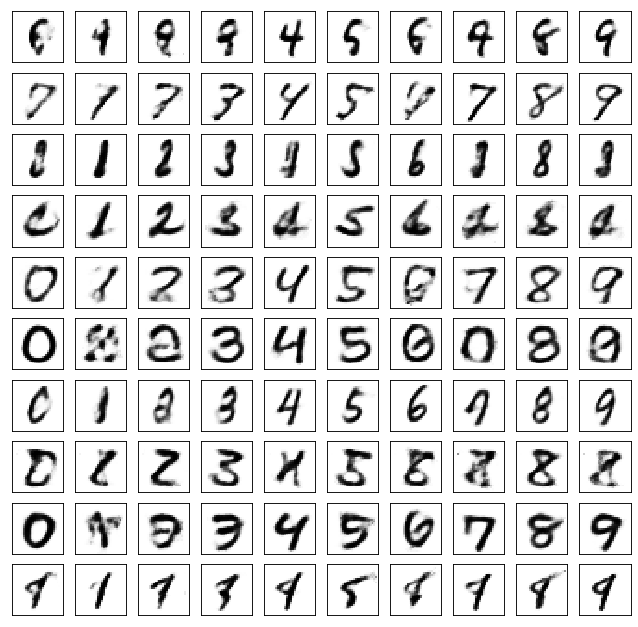

	reconstruction


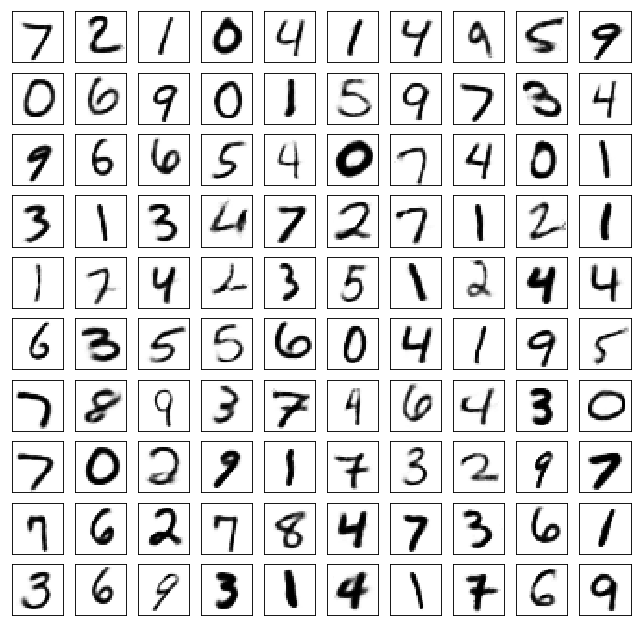

Test losses. E: 0.6900, AE: 0.0425, D: 0.6933
Train Epoch: 285 [0/50000 (0%)]	Losses E: 0.6968, AE: 0.0309, D: 0.6932
Train Epoch: 285 [25000/50000 (50%)]	Losses E: 0.6915, AE: 0.0306, D: 0.6934
Train Epoch: 285 [50000/50000 (100%)]	Losses E: 0.6910, AE: 0.0331, D: 0.6925
	generation


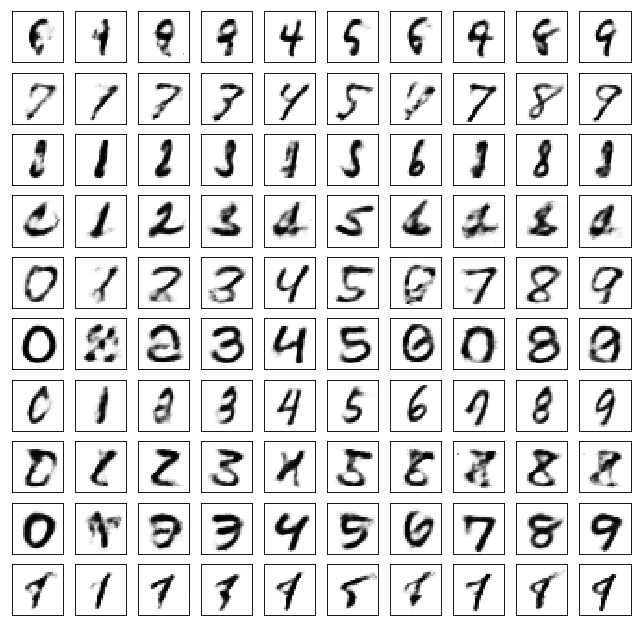

	reconstruction


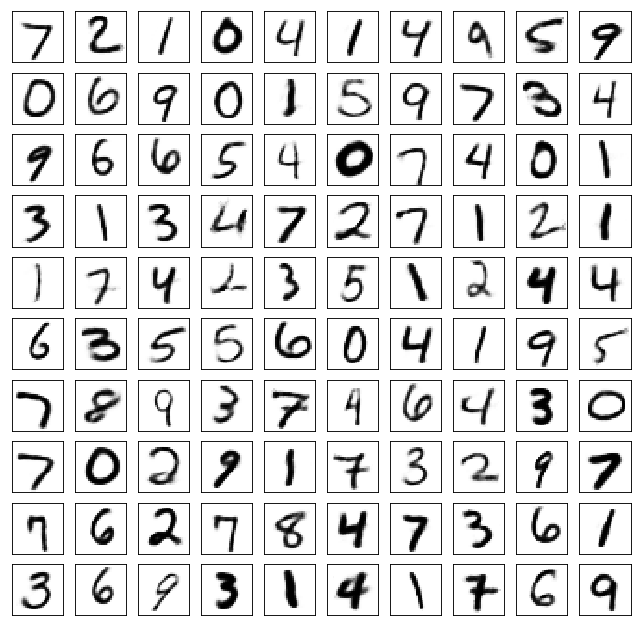

Test losses. E: 0.6916, AE: 0.0424, D: 0.6931
Train Epoch: 290 [0/50000 (0%)]	Losses E: 0.6941, AE: 0.0312, D: 0.6932
Train Epoch: 290 [25000/50000 (50%)]	Losses E: 0.6955, AE: 0.0293, D: 0.6924
Train Epoch: 290 [50000/50000 (100%)]	Losses E: 0.6927, AE: 0.0337, D: 0.6940
	generation


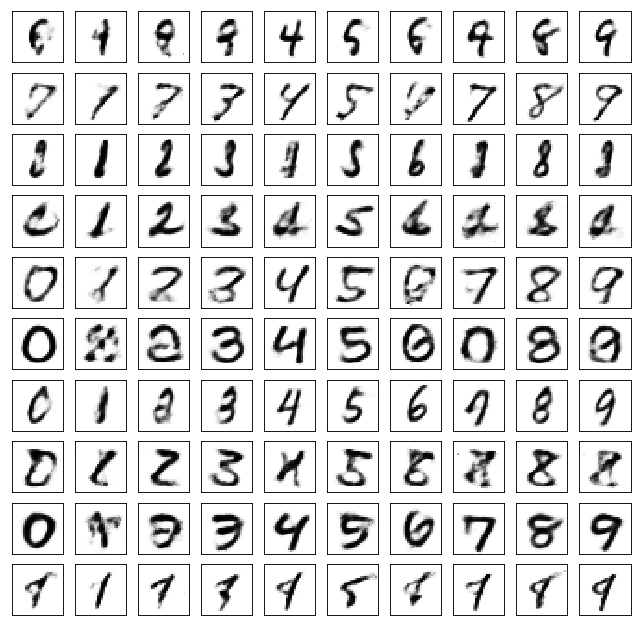

	reconstruction


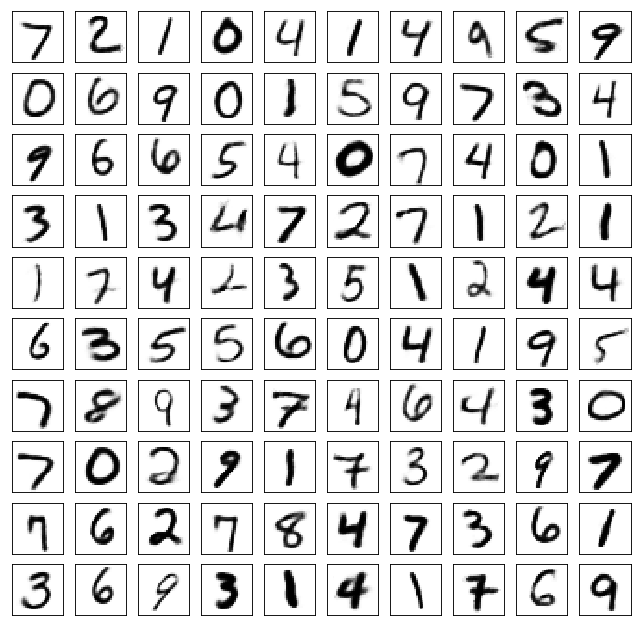

Test losses. E: 0.6926, AE: 0.0422, D: 0.6933
Train Epoch: 295 [0/50000 (0%)]	Losses E: 0.6985, AE: 0.0296, D: 0.6929
Train Epoch: 295 [25000/50000 (50%)]	Losses E: 0.6893, AE: 0.0302, D: 0.6929
Train Epoch: 295 [50000/50000 (100%)]	Losses E: 0.6918, AE: 0.0311, D: 0.6933
	generation


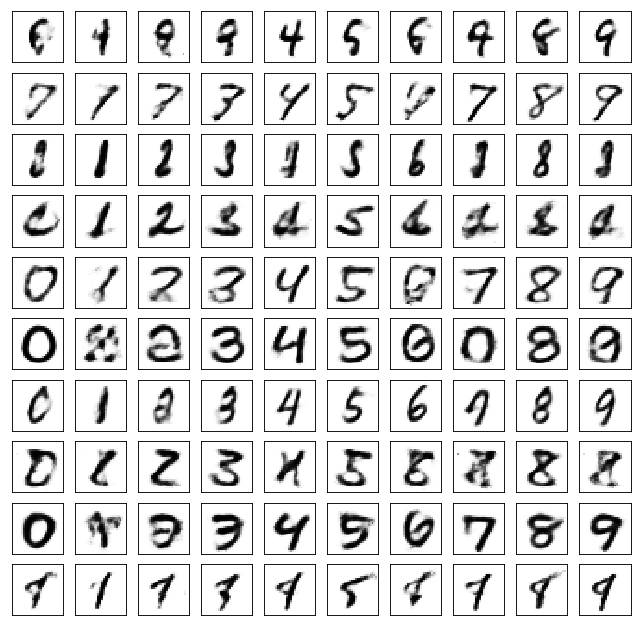

	reconstruction


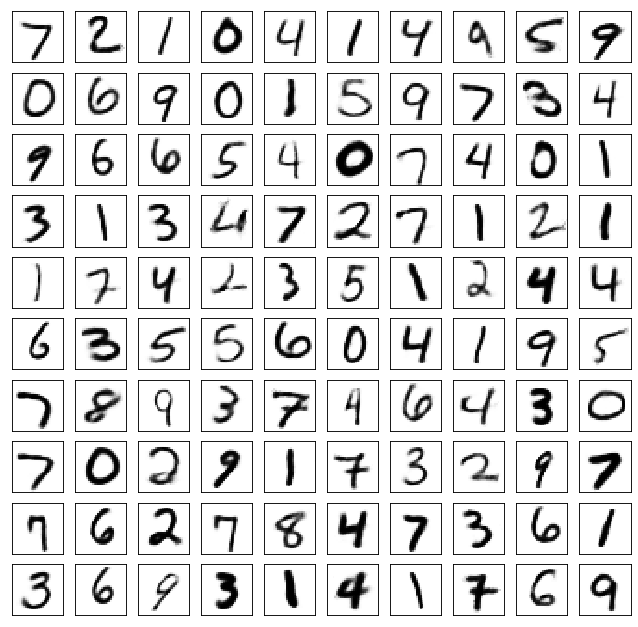

Test losses. E: 0.6923, AE: 0.0422, D: 0.6932
Train Epoch: 300 [0/50000 (0%)]	Losses E: 0.6901, AE: 0.0320, D: 0.6933
Train Epoch: 300 [25000/50000 (50%)]	Losses E: 0.6903, AE: 0.0321, D: 0.6927
Train Epoch: 300 [50000/50000 (100%)]	Losses E: 0.6852, AE: 0.0306, D: 0.6929
	generation


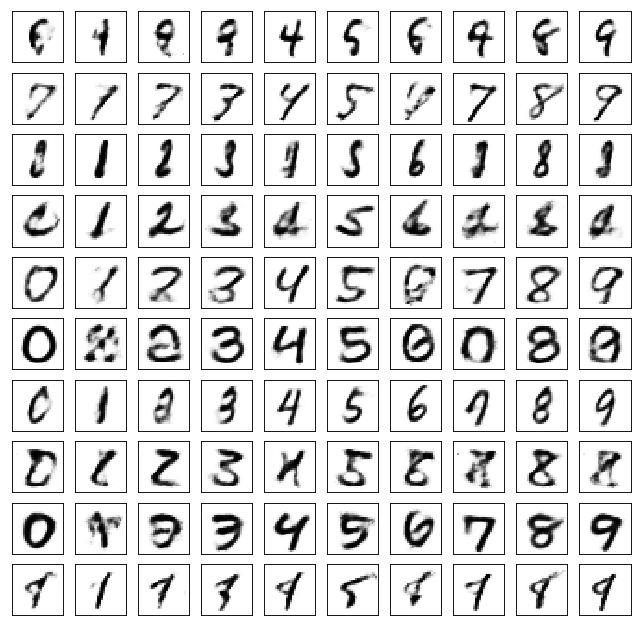

	reconstruction


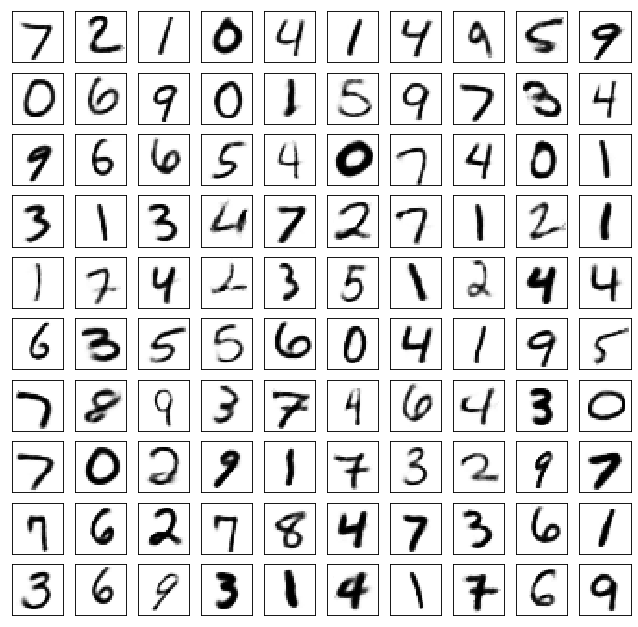

Test losses. E: 0.6852, AE: 0.0422, D: 0.6927
Train Epoch: 305 [0/50000 (0%)]	Losses E: 0.6955, AE: 0.0283, D: 0.6942
Train Epoch: 305 [25000/50000 (50%)]	Losses E: 0.6901, AE: 0.0300, D: 0.6936
Train Epoch: 305 [50000/50000 (100%)]	Losses E: 0.6900, AE: 0.0316, D: 0.6940
	generation


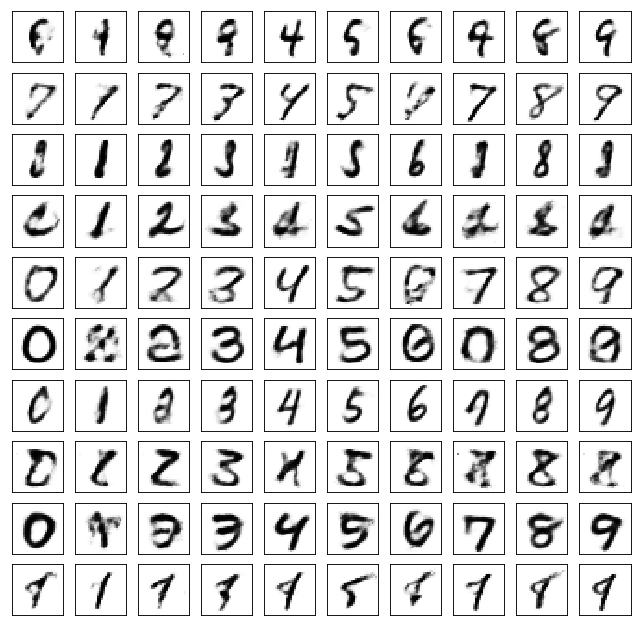

	reconstruction


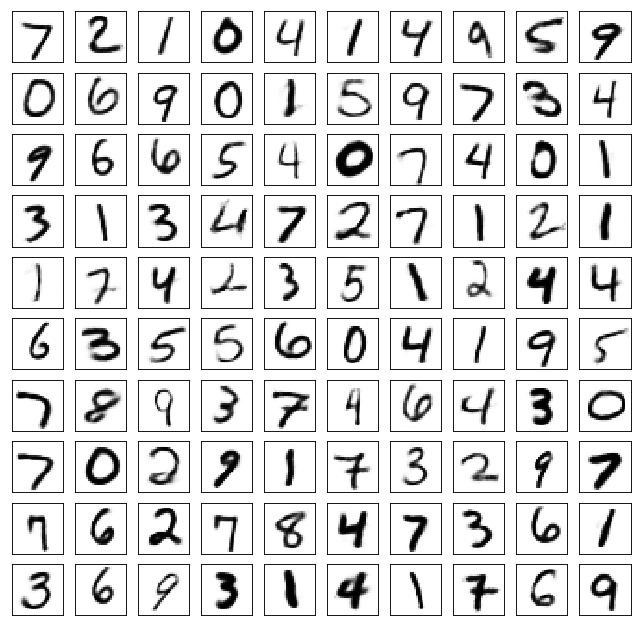

Test losses. E: 0.6900, AE: 0.0422, D: 0.6932
Train Epoch: 310 [0/50000 (0%)]	Losses E: 0.6936, AE: 0.0283, D: 0.6935
Train Epoch: 310 [25000/50000 (50%)]	Losses E: 0.6977, AE: 0.0287, D: 0.6923
Train Epoch: 310 [50000/50000 (100%)]	Losses E: 0.6937, AE: 0.0329, D: 0.6936
	generation


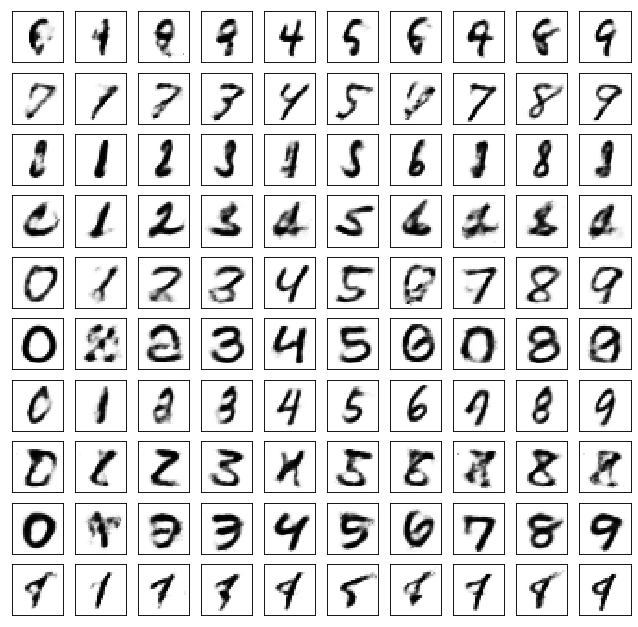

	reconstruction


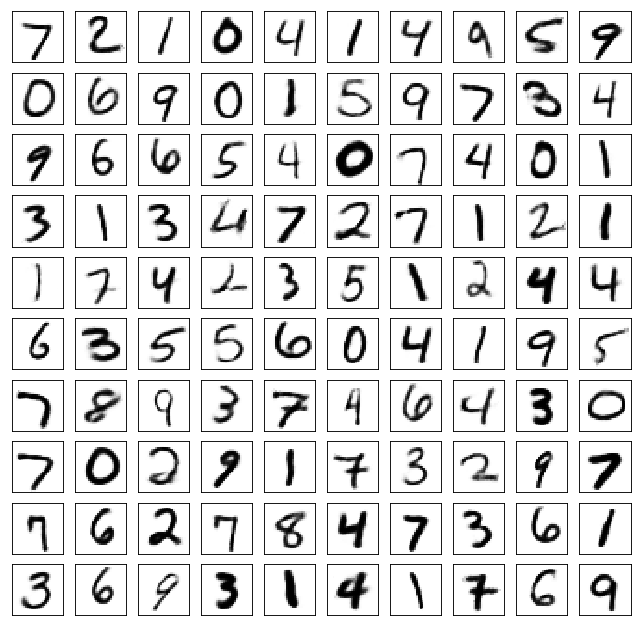

Test losses. E: 0.6930, AE: 0.0423, D: 0.6932
Train Epoch: 315 [0/50000 (0%)]	Losses E: 0.6901, AE: 0.0306, D: 0.6936
Train Epoch: 315 [25000/50000 (50%)]	Losses E: 0.6954, AE: 0.0299, D: 0.6938
Train Epoch: 315 [50000/50000 (100%)]	Losses E: 0.6930, AE: 0.0318, D: 0.6931
	generation


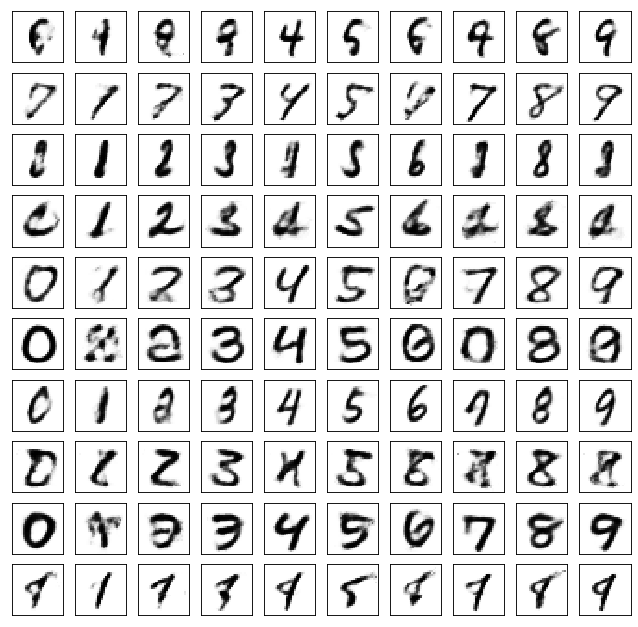

	reconstruction


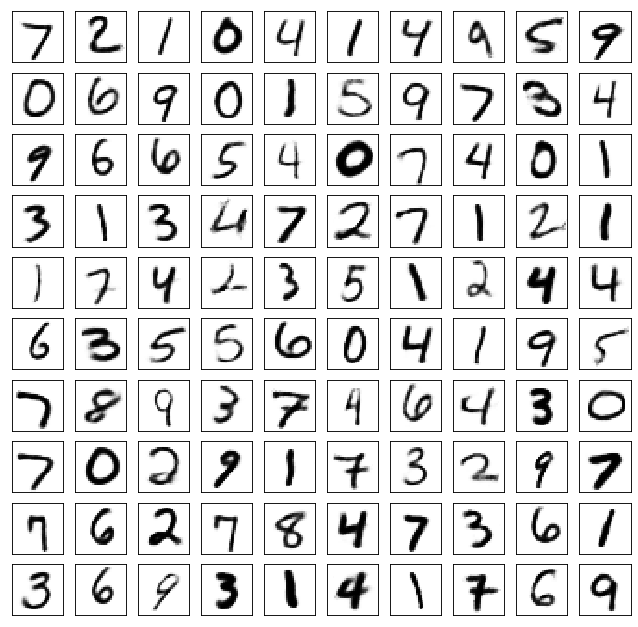

Test losses. E: 0.6922, AE: 0.0425, D: 0.6933
Train Epoch: 320 [0/50000 (0%)]	Losses E: 0.6920, AE: 0.0294, D: 0.6929
Train Epoch: 320 [25000/50000 (50%)]	Losses E: 0.6977, AE: 0.0320, D: 0.6940
Train Epoch: 320 [50000/50000 (100%)]	Losses E: 0.6954, AE: 0.0300, D: 0.6934
	generation


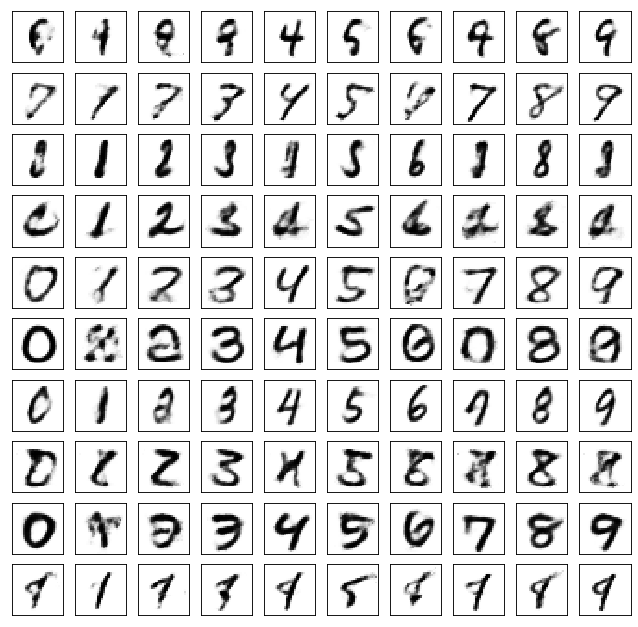

	reconstruction


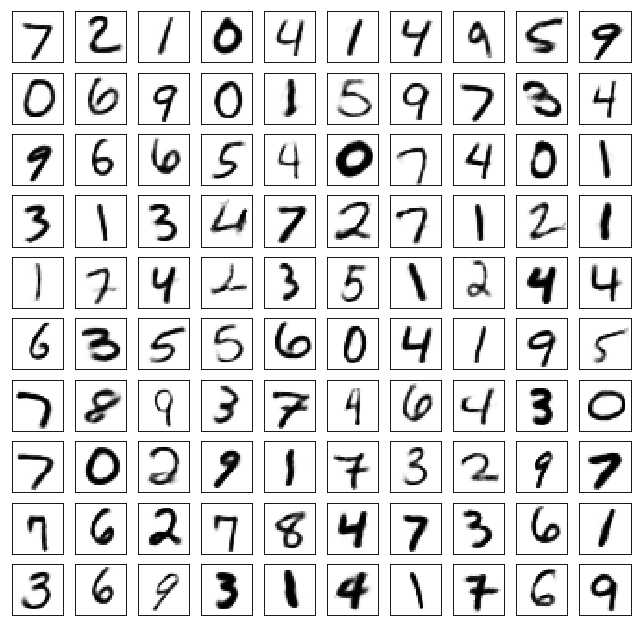

Test losses. E: 0.6943, AE: 0.0422, D: 0.6935
Train Epoch: 325 [0/50000 (0%)]	Losses E: 0.7025, AE: 0.0291, D: 0.6931
Train Epoch: 325 [25000/50000 (50%)]	Losses E: 0.6974, AE: 0.0293, D: 0.6937
Train Epoch: 325 [50000/50000 (100%)]	Losses E: 0.6917, AE: 0.0297, D: 0.6934
	generation


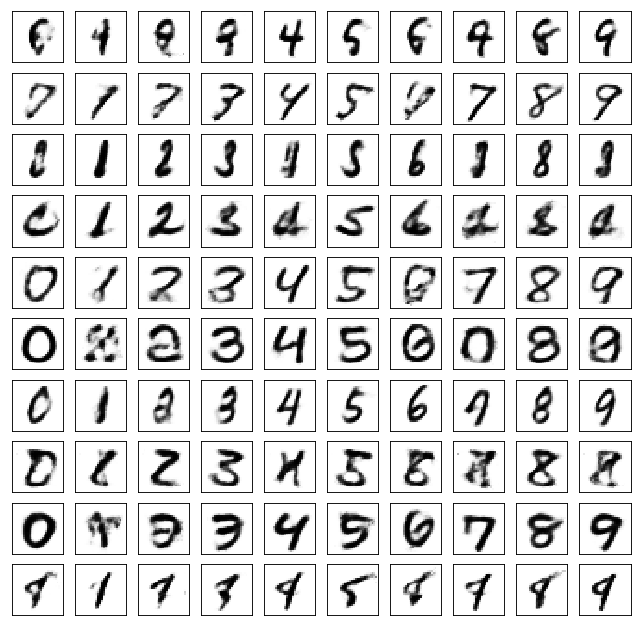

	reconstruction


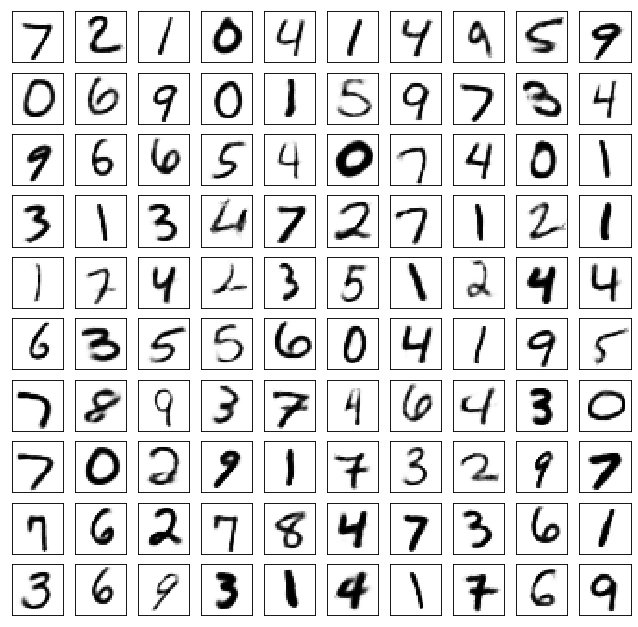

Test losses. E: 0.6913, AE: 0.0428, D: 0.6932
Train Epoch: 330 [0/50000 (0%)]	Losses E: 0.6876, AE: 0.0286, D: 0.6936
Train Epoch: 330 [25000/50000 (50%)]	Losses E: 0.6890, AE: 0.0282, D: 0.6932
Train Epoch: 330 [50000/50000 (100%)]	Losses E: 0.6863, AE: 0.0309, D: 0.6936
	generation


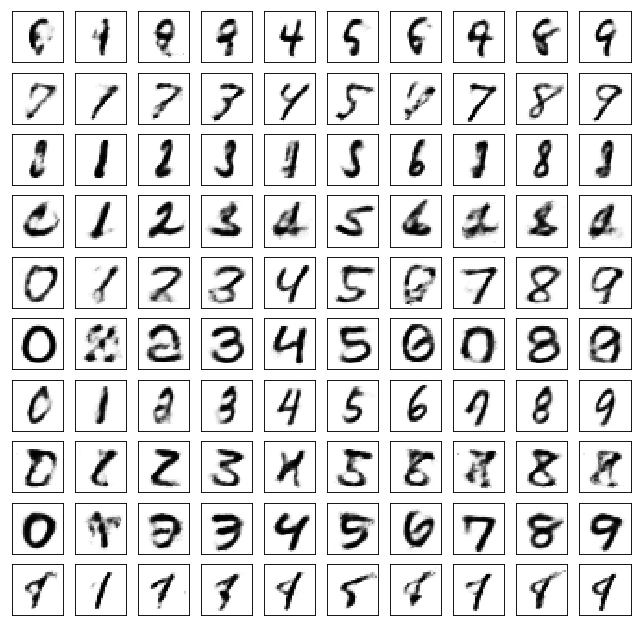

	reconstruction


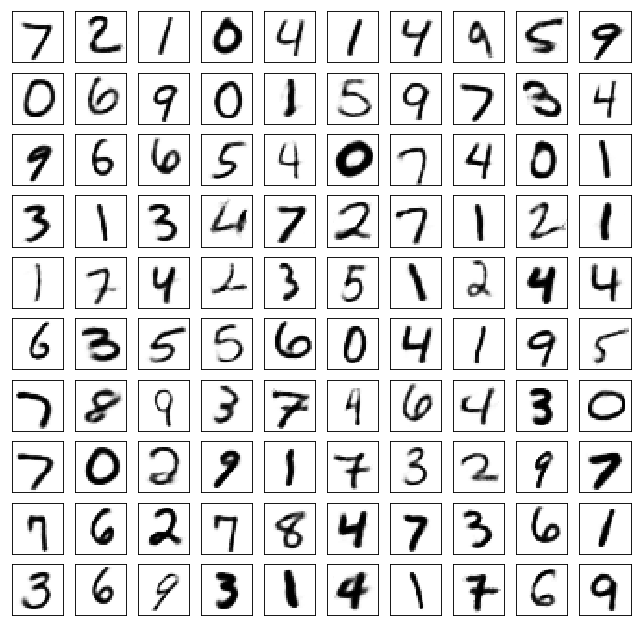

Test losses. E: 0.6851, AE: 0.0422, D: 0.6928
Train Epoch: 335 [0/50000 (0%)]	Losses E: 0.7002, AE: 0.0296, D: 0.6921
Train Epoch: 335 [25000/50000 (50%)]	Losses E: 0.6995, AE: 0.0280, D: 0.6928
Train Epoch: 335 [50000/50000 (100%)]	Losses E: 0.6984, AE: 0.0300, D: 0.6936
	generation


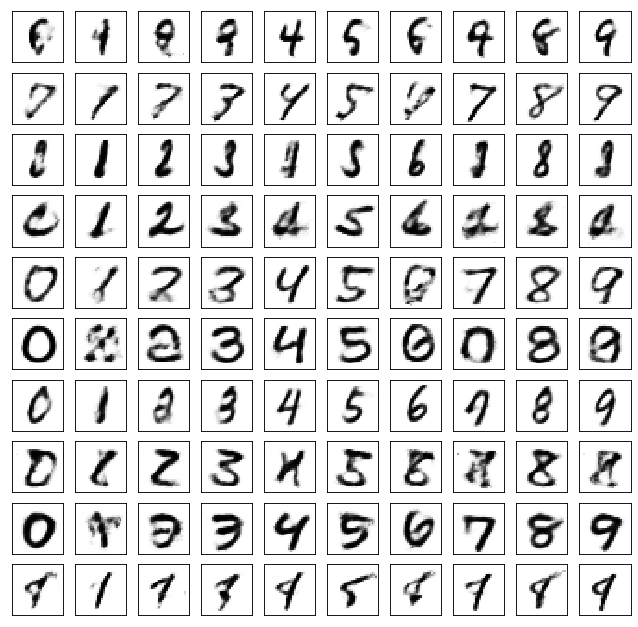

	reconstruction


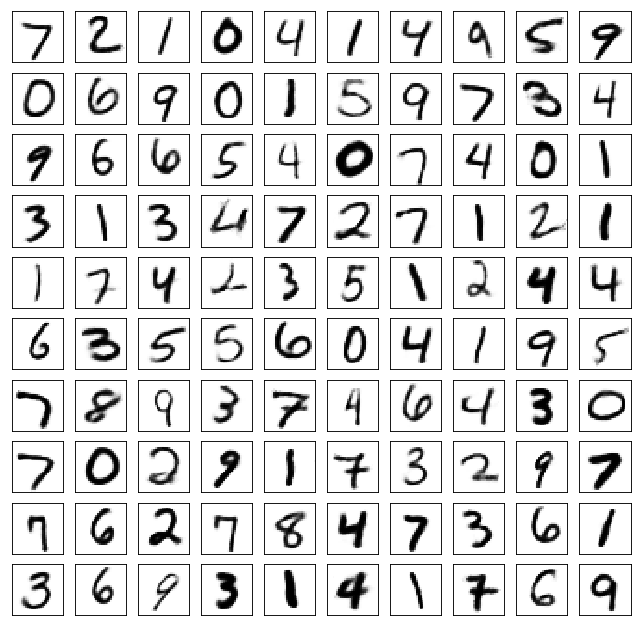

Test losses. E: 0.6981, AE: 0.0422, D: 0.6931
Train Epoch: 340 [0/50000 (0%)]	Losses E: 0.6956, AE: 0.0291, D: 0.6936
Train Epoch: 340 [25000/50000 (50%)]	Losses E: 0.6891, AE: 0.0291, D: 0.6933
Train Epoch: 340 [50000/50000 (100%)]	Losses E: 0.6885, AE: 0.0287, D: 0.6924
	generation


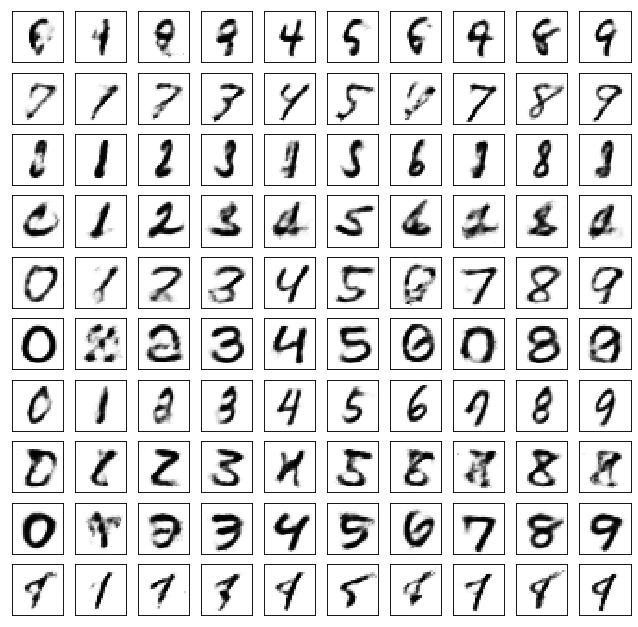

	reconstruction


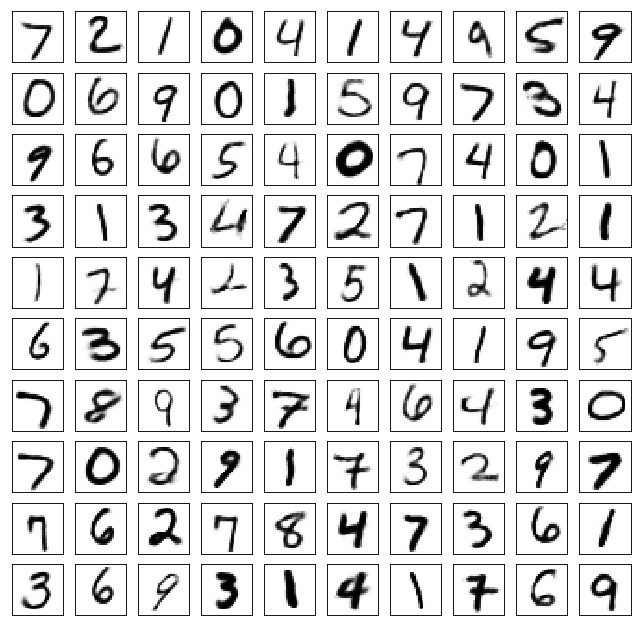

Test losses. E: 0.6882, AE: 0.0423, D: 0.6930
Train Epoch: 345 [0/50000 (0%)]	Losses E: 0.6915, AE: 0.0299, D: 0.6936
Train Epoch: 345 [25000/50000 (50%)]	Losses E: 0.6929, AE: 0.0305, D: 0.6939
Train Epoch: 345 [50000/50000 (100%)]	Losses E: 0.6997, AE: 0.0272, D: 0.6928
	generation


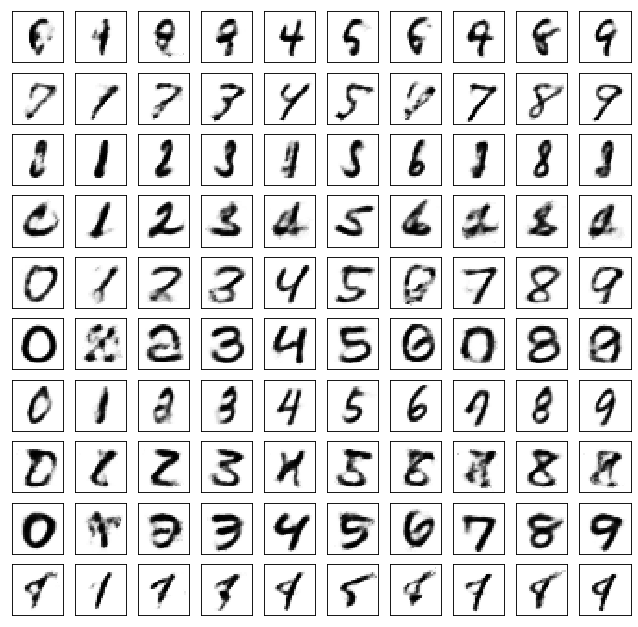

	reconstruction


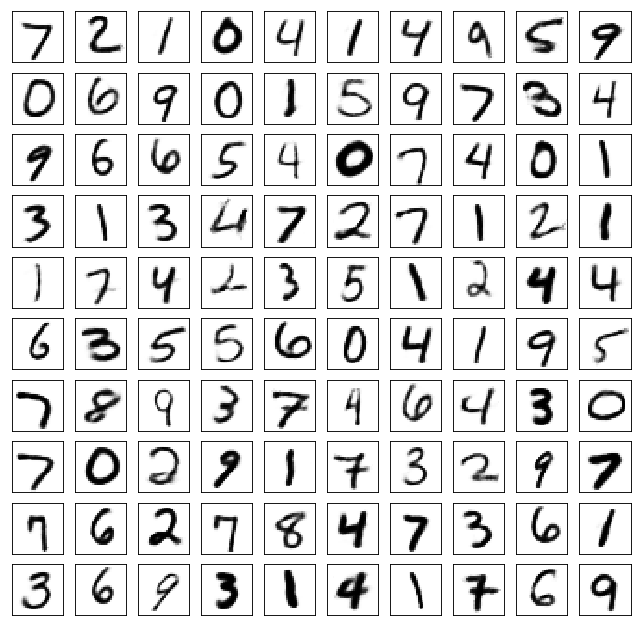

Test losses. E: 0.6981, AE: 0.0422, D: 0.6931
Train Epoch: 350 [0/50000 (0%)]	Losses E: 0.6961, AE: 0.0281, D: 0.6927
Train Epoch: 350 [25000/50000 (50%)]	Losses E: 0.6977, AE: 0.0306, D: 0.6933
Train Epoch: 350 [50000/50000 (100%)]	Losses E: 0.6931, AE: 0.0293, D: 0.6928
	generation


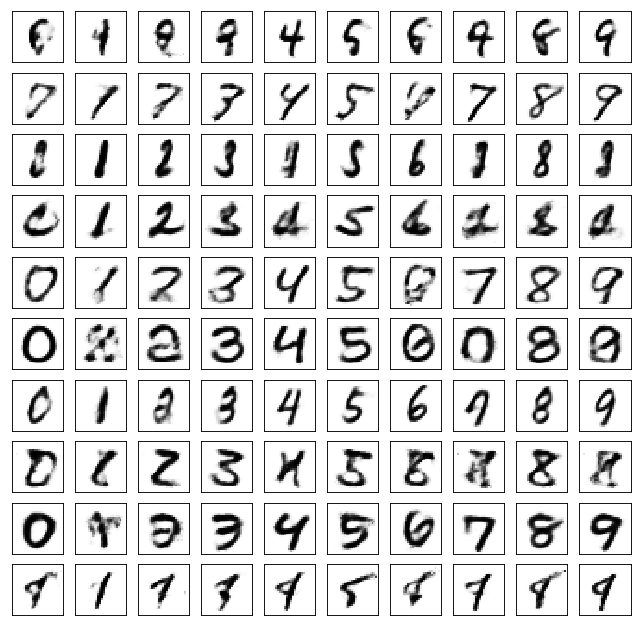

	reconstruction


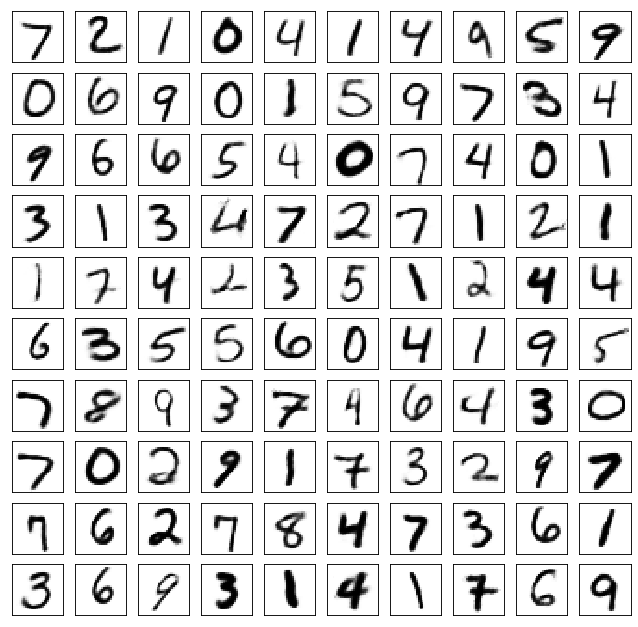

Test losses. E: 0.6928, AE: 0.0424, D: 0.6931
Train Epoch: 355 [0/50000 (0%)]	Losses E: 0.6849, AE: 0.0276, D: 0.6931
Train Epoch: 355 [25000/50000 (50%)]	Losses E: 0.6892, AE: 0.0290, D: 0.6940
Train Epoch: 355 [50000/50000 (100%)]	Losses E: 0.6974, AE: 0.0287, D: 0.6929
	generation


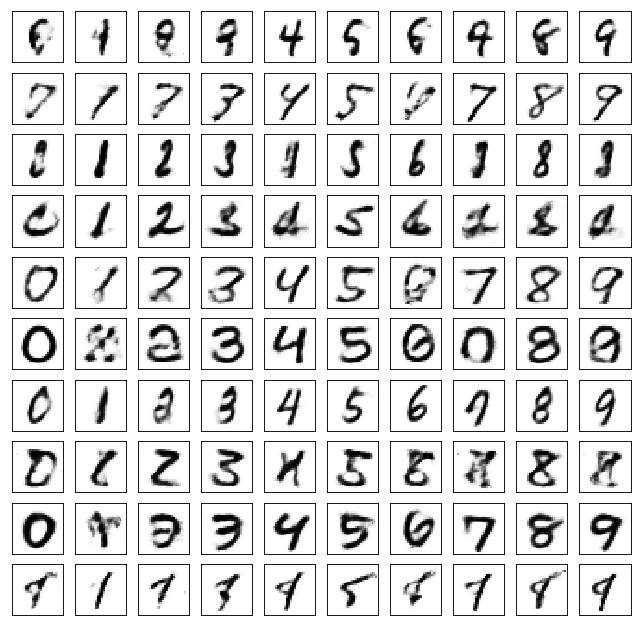

	reconstruction


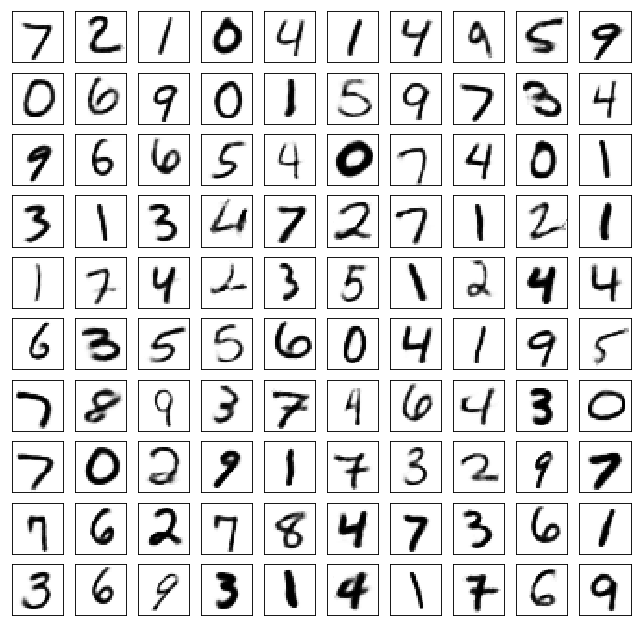

Test losses. E: 0.6963, AE: 0.0423, D: 0.6930
Train Epoch: 360 [0/50000 (0%)]	Losses E: 0.6966, AE: 0.0291, D: 0.6929
Train Epoch: 360 [25000/50000 (50%)]	Losses E: 0.6961, AE: 0.0274, D: 0.6931
Train Epoch: 360 [50000/50000 (100%)]	Losses E: 0.6915, AE: 0.0288, D: 0.6931
	generation


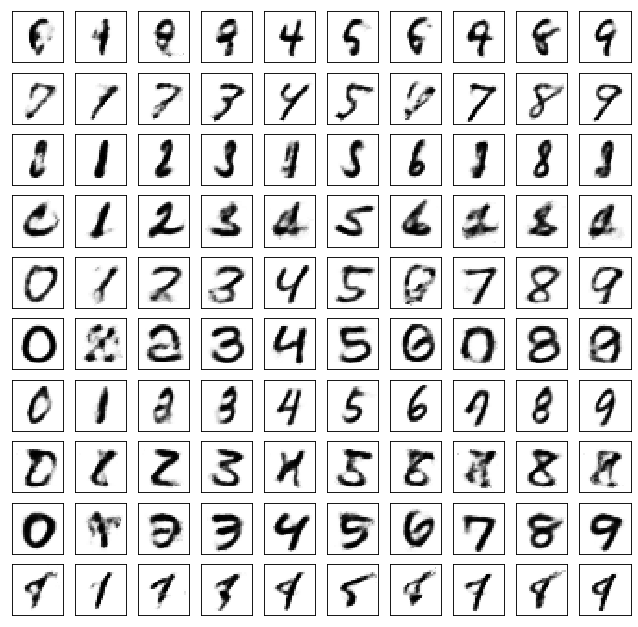

	reconstruction


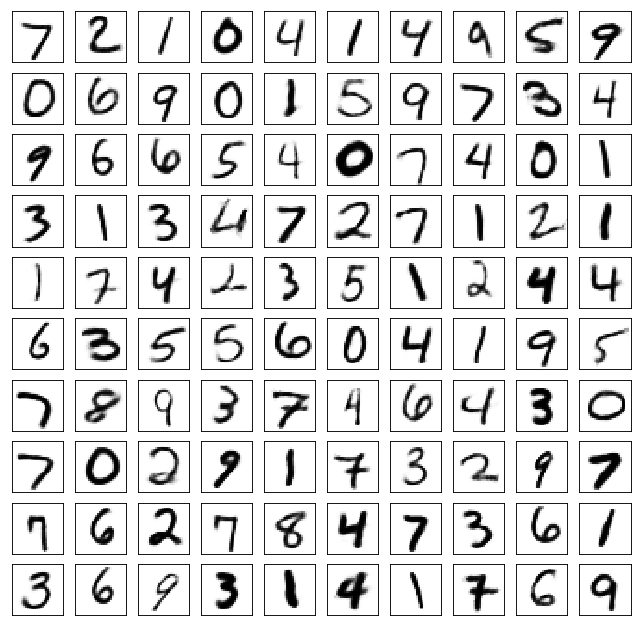

Test losses. E: 0.6907, AE: 0.0422, D: 0.6930
Train Epoch: 365 [0/50000 (0%)]	Losses E: 0.6953, AE: 0.0279, D: 0.6927
Train Epoch: 365 [25000/50000 (50%)]	Losses E: 0.6975, AE: 0.0293, D: 0.6913
Train Epoch: 365 [50000/50000 (100%)]	Losses E: 0.6953, AE: 0.0288, D: 0.6921
	generation


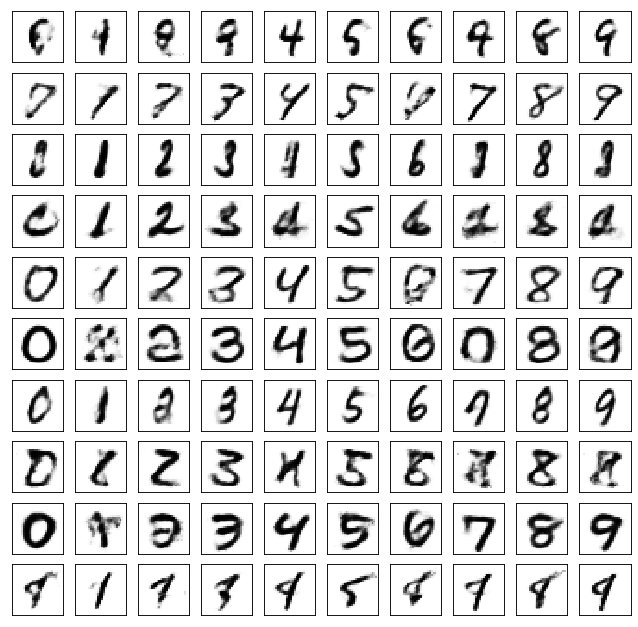

	reconstruction


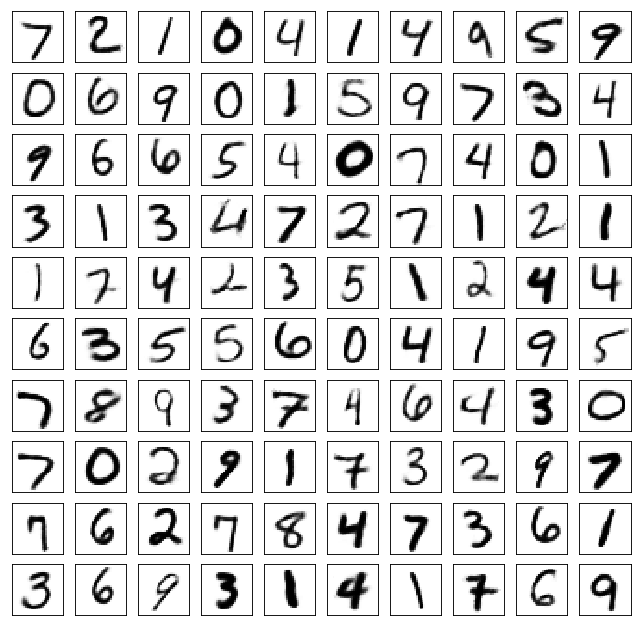

Test losses. E: 0.6942, AE: 0.0425, D: 0.6929
Train Epoch: 370 [0/50000 (0%)]	Losses E: 0.6934, AE: 0.0302, D: 0.6921
Train Epoch: 370 [25000/50000 (50%)]	Losses E: 0.6957, AE: 0.0299, D: 0.6924
Train Epoch: 370 [50000/50000 (100%)]	Losses E: 0.6983, AE: 0.0298, D: 0.6934
	generation


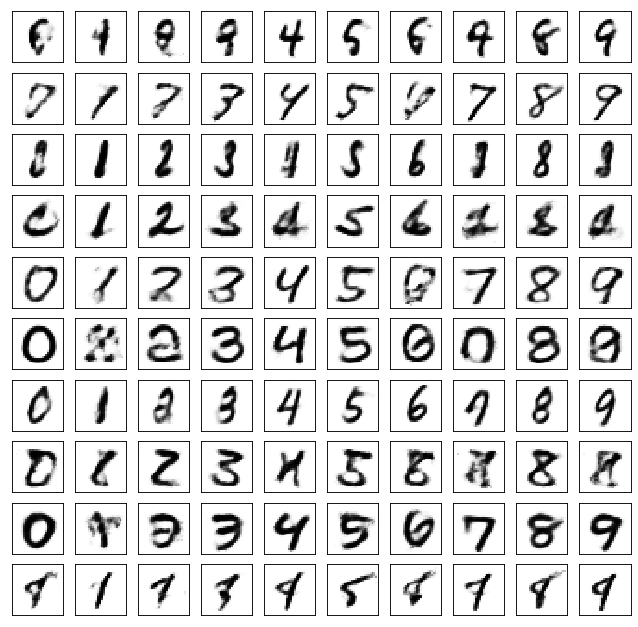

	reconstruction


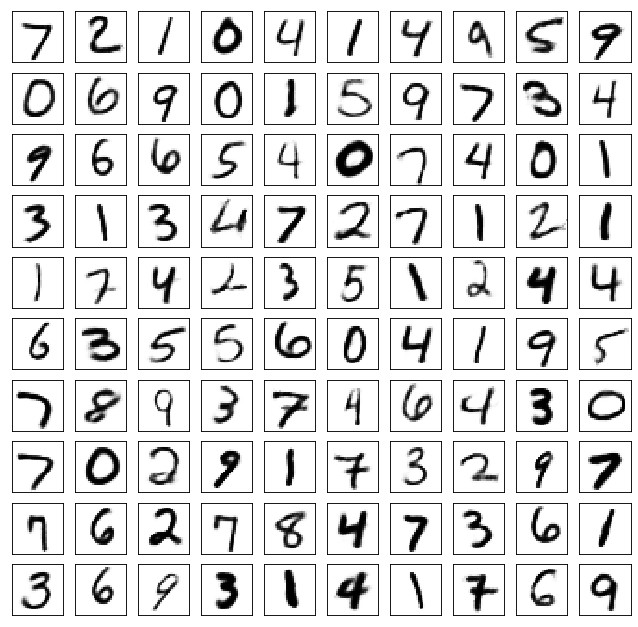

Test losses. E: 0.6977, AE: 0.0429, D: 0.6932
Train Epoch: 375 [0/50000 (0%)]	Losses E: 0.6838, AE: 0.0279, D: 0.6937
Train Epoch: 375 [25000/50000 (50%)]	Losses E: 0.6918, AE: 0.0272, D: 0.6932
Train Epoch: 375 [50000/50000 (100%)]	Losses E: 0.6972, AE: 0.0279, D: 0.6936
	generation


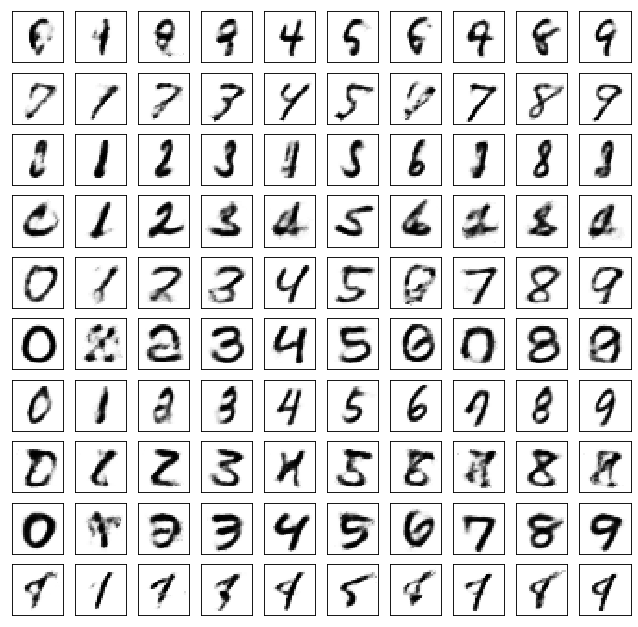

	reconstruction


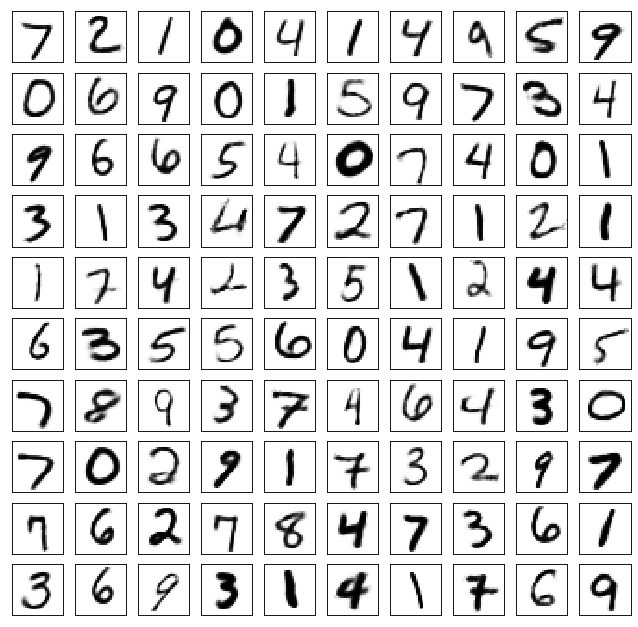

Test losses. E: 0.6969, AE: 0.0425, D: 0.6930
Train Epoch: 380 [0/50000 (0%)]	Losses E: 0.6952, AE: 0.0285, D: 0.6929
Train Epoch: 380 [25000/50000 (50%)]	Losses E: 0.6965, AE: 0.0292, D: 0.6938
Train Epoch: 380 [50000/50000 (100%)]	Losses E: 0.6997, AE: 0.0293, D: 0.6933
	generation


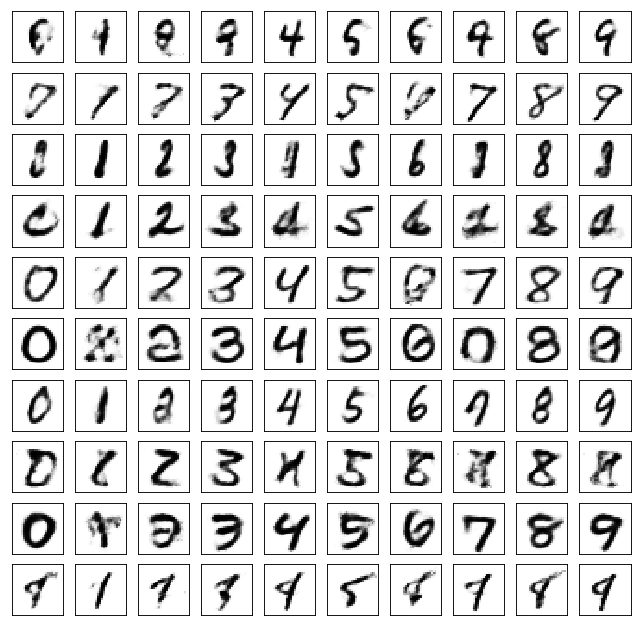

	reconstruction


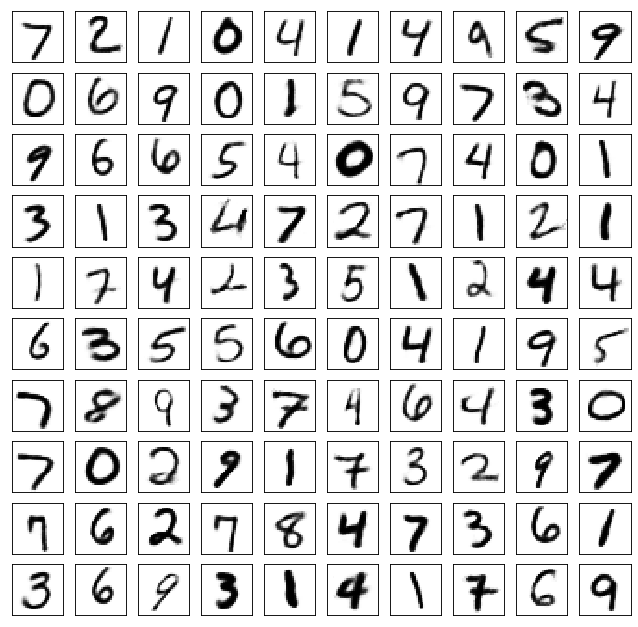

Test losses. E: 0.6989, AE: 0.0424, D: 0.6929
Train Epoch: 385 [0/50000 (0%)]	Losses E: 0.6883, AE: 0.0281, D: 0.6930
Train Epoch: 385 [25000/50000 (50%)]	Losses E: 0.6954, AE: 0.0288, D: 0.6930
Train Epoch: 385 [50000/50000 (100%)]	Losses E: 0.6988, AE: 0.0263, D: 0.6931
	generation


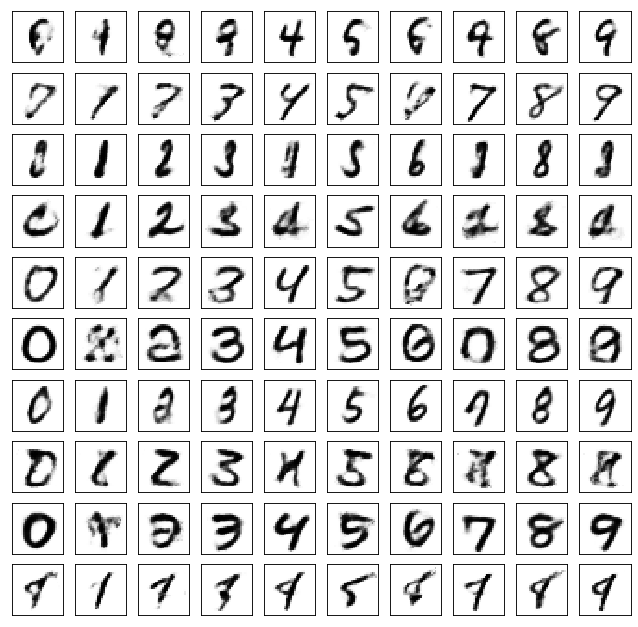

	reconstruction


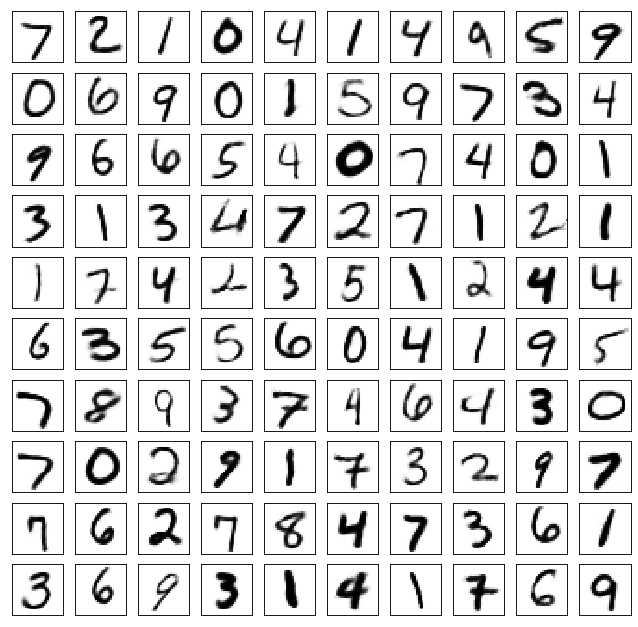

Test losses. E: 0.6990, AE: 0.0425, D: 0.6930
Train Epoch: 390 [0/50000 (0%)]	Losses E: 0.6968, AE: 0.0291, D: 0.6927
Train Epoch: 390 [25000/50000 (50%)]	Losses E: 0.6990, AE: 0.0283, D: 0.6935
Train Epoch: 390 [50000/50000 (100%)]	Losses E: 0.6992, AE: 0.0263, D: 0.6927
	generation


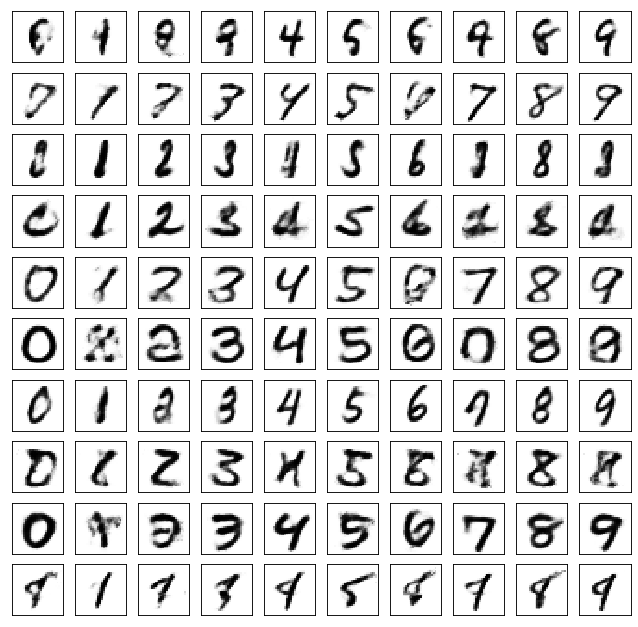

	reconstruction


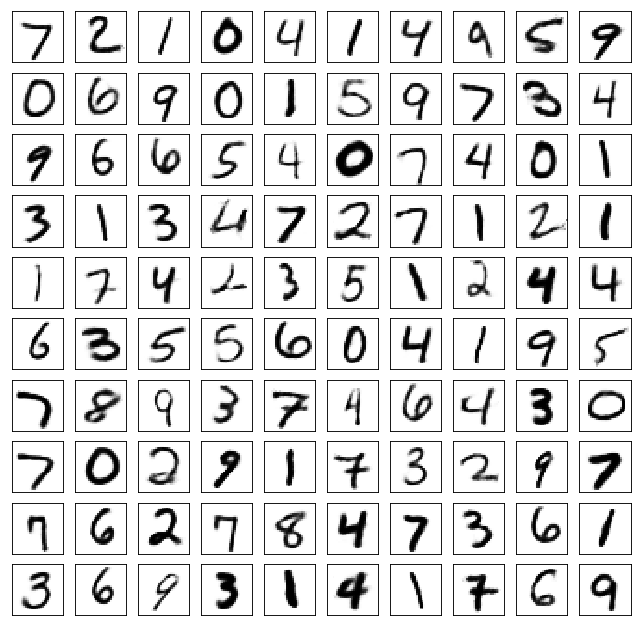

Test losses. E: 0.6989, AE: 0.0427, D: 0.6931
Train Epoch: 395 [0/50000 (0%)]	Losses E: 0.6912, AE: 0.0264, D: 0.6931
Train Epoch: 395 [25000/50000 (50%)]	Losses E: 0.6908, AE: 0.0263, D: 0.6936
Train Epoch: 395 [50000/50000 (100%)]	Losses E: 0.6941, AE: 0.0250, D: 0.6924
	generation


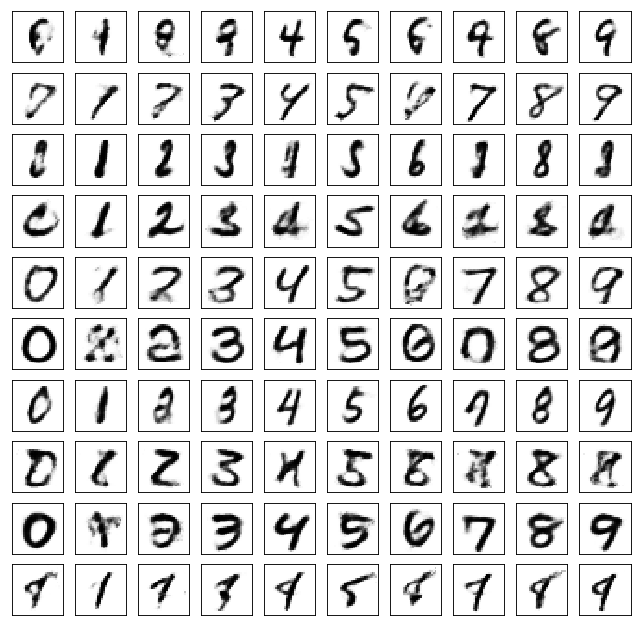

	reconstruction


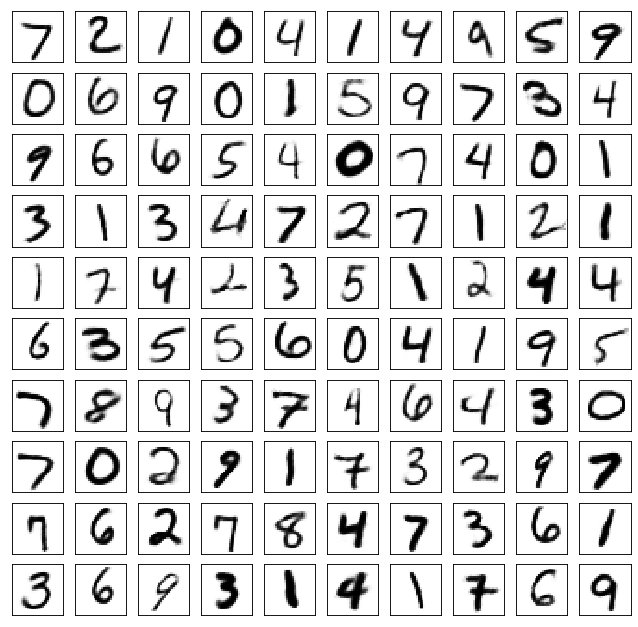

Test losses. E: 0.6945, AE: 0.0426, D: 0.6931
Train Epoch: 400 [0/50000 (0%)]	Losses E: 0.6906, AE: 0.0270, D: 0.6936
Train Epoch: 400 [25000/50000 (50%)]	Losses E: 0.6946, AE: 0.0278, D: 0.6922
Train Epoch: 400 [50000/50000 (100%)]	Losses E: 0.6959, AE: 0.0270, D: 0.6922
	generation


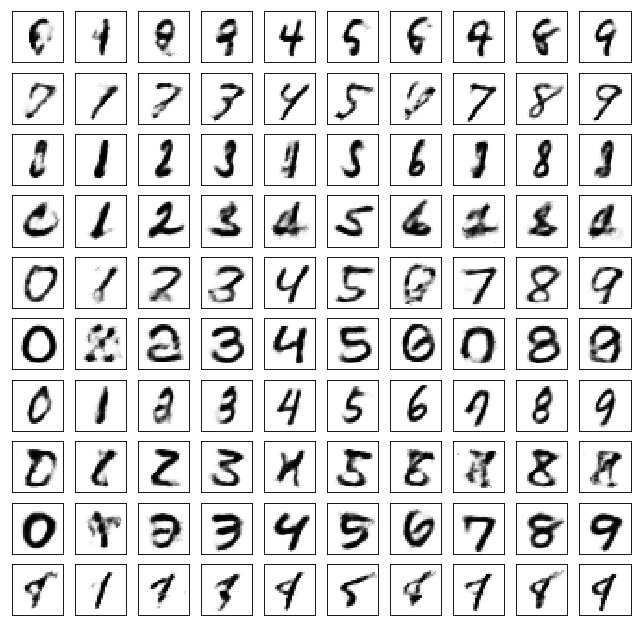

	reconstruction


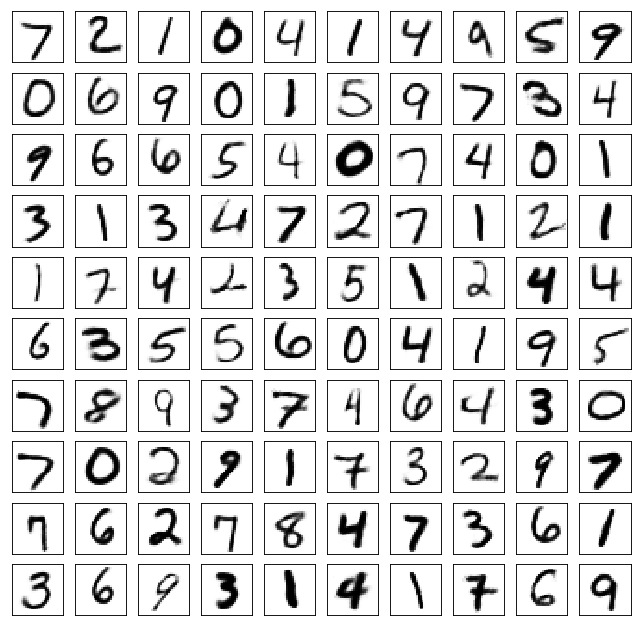

Test losses. E: 0.6951, AE: 0.0426, D: 0.6931
Train Epoch: 405 [0/50000 (0%)]	Losses E: 0.6915, AE: 0.0280, D: 0.6924
Train Epoch: 405 [25000/50000 (50%)]	Losses E: 0.6959, AE: 0.0271, D: 0.6932
Train Epoch: 405 [50000/50000 (100%)]	Losses E: 0.6945, AE: 0.0287, D: 0.6938
	generation


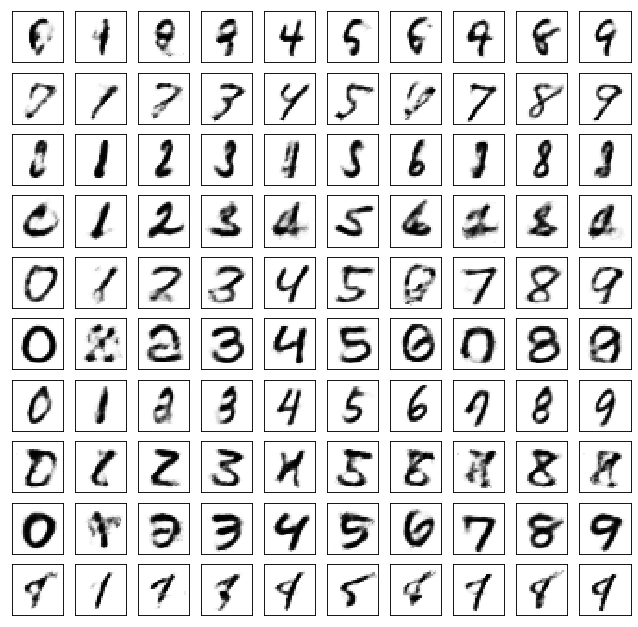

	reconstruction


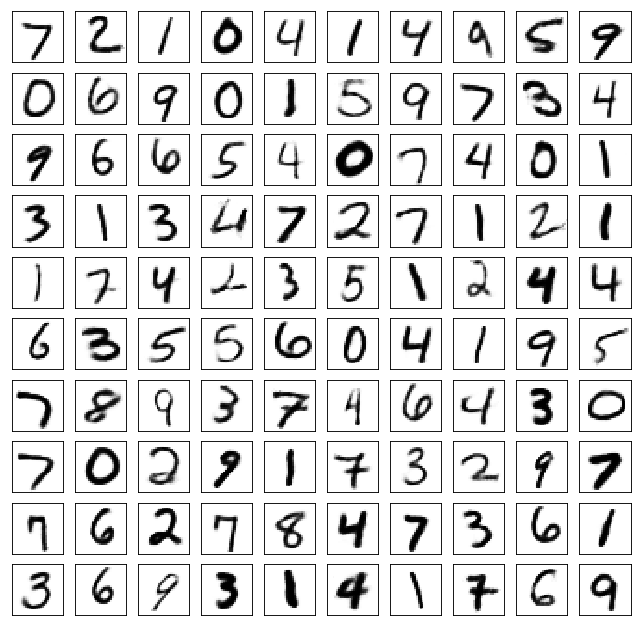

Test losses. E: 0.6942, AE: 0.0427, D: 0.6932
Train Epoch: 410 [0/50000 (0%)]	Losses E: 0.6907, AE: 0.0244, D: 0.6936
Train Epoch: 410 [25000/50000 (50%)]	Losses E: 0.6924, AE: 0.0265, D: 0.6930
Train Epoch: 410 [50000/50000 (100%)]	Losses E: 0.6972, AE: 0.0284, D: 0.6935
	generation


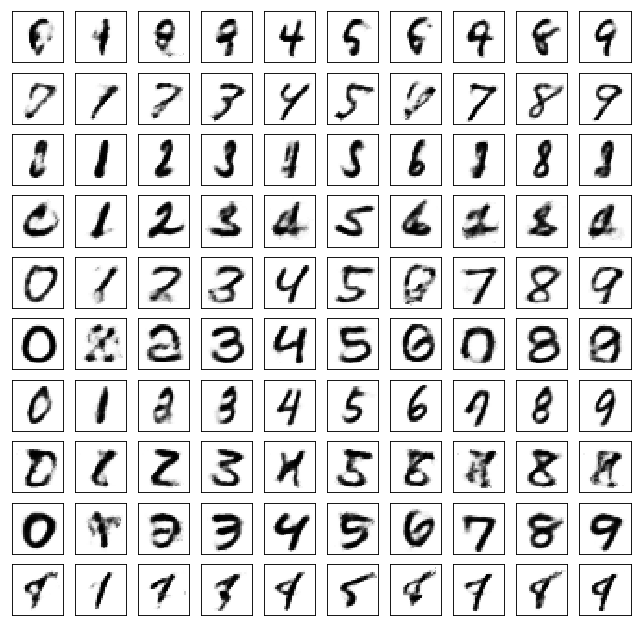

	reconstruction


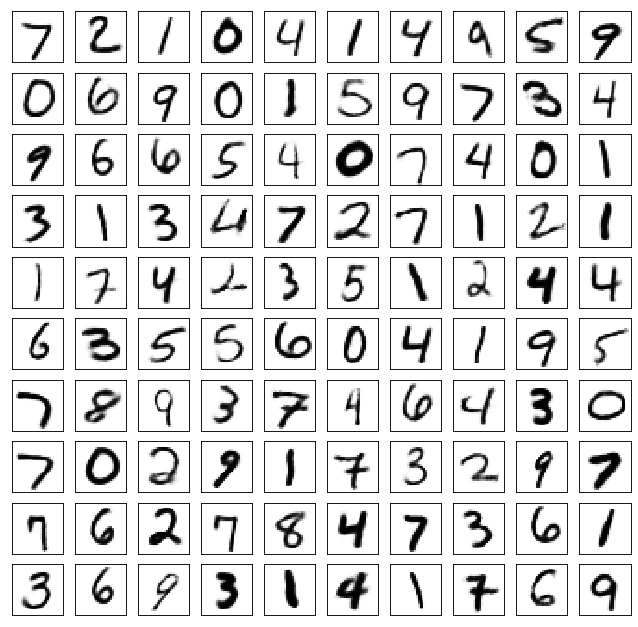

Test losses. E: 0.6959, AE: 0.0428, D: 0.6929
Train Epoch: 415 [0/50000 (0%)]	Losses E: 0.6890, AE: 0.0265, D: 0.6933
Train Epoch: 415 [25000/50000 (50%)]	Losses E: 0.6899, AE: 0.0281, D: 0.6931
Train Epoch: 415 [50000/50000 (100%)]	Losses E: 0.6919, AE: 0.0256, D: 0.6933
	generation


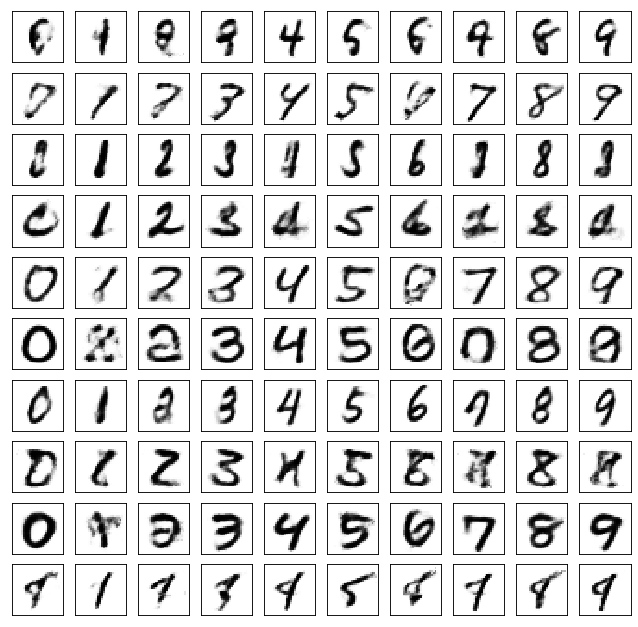

	reconstruction


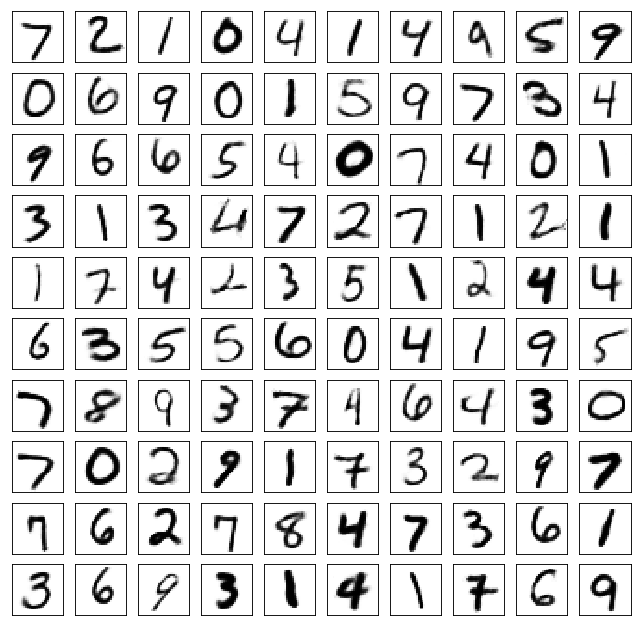

Test losses. E: 0.6914, AE: 0.0428, D: 0.6931
Train Epoch: 420 [0/50000 (0%)]	Losses E: 0.6992, AE: 0.0271, D: 0.6926
Train Epoch: 420 [25000/50000 (50%)]	Losses E: 0.6892, AE: 0.0267, D: 0.6930
Train Epoch: 420 [50000/50000 (100%)]	Losses E: 0.6889, AE: 0.0272, D: 0.6926
	generation


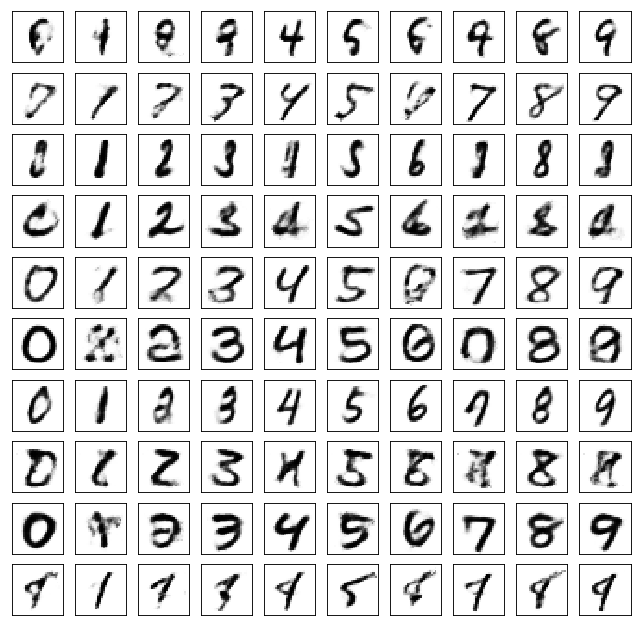

	reconstruction


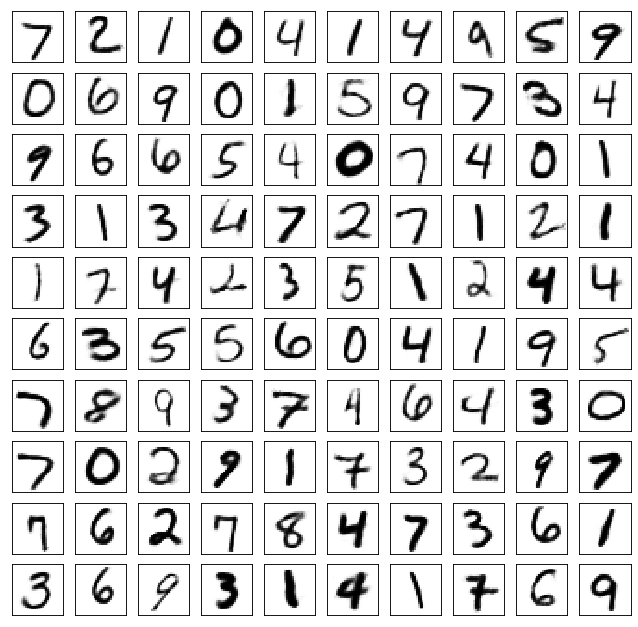

Test losses. E: 0.6888, AE: 0.0428, D: 0.6931
Train Epoch: 425 [0/50000 (0%)]	Losses E: 0.6920, AE: 0.0271, D: 0.6931
Train Epoch: 425 [25000/50000 (50%)]	Losses E: 0.6988, AE: 0.0277, D: 0.6937
Train Epoch: 425 [50000/50000 (100%)]	Losses E: 0.6975, AE: 0.0271, D: 0.6926
	generation


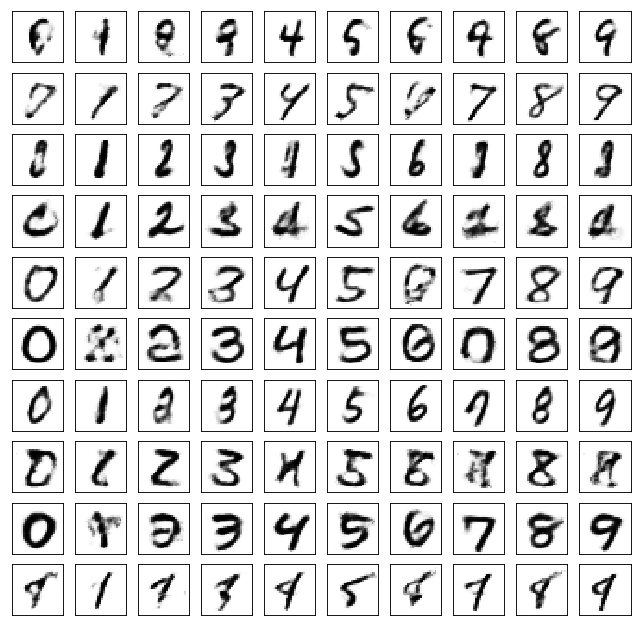

	reconstruction


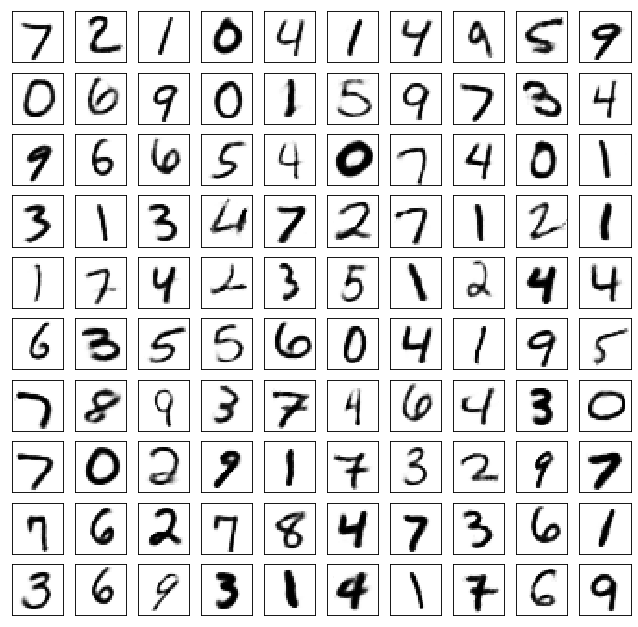

Test losses. E: 0.6958, AE: 0.0430, D: 0.6932
Train Epoch: 430 [0/50000 (0%)]	Losses E: 0.6999, AE: 0.0270, D: 0.6933
Train Epoch: 430 [25000/50000 (50%)]	Losses E: 0.6929, AE: 0.0273, D: 0.6939
Train Epoch: 430 [50000/50000 (100%)]	Losses E: 0.6941, AE: 0.0241, D: 0.6934
	generation


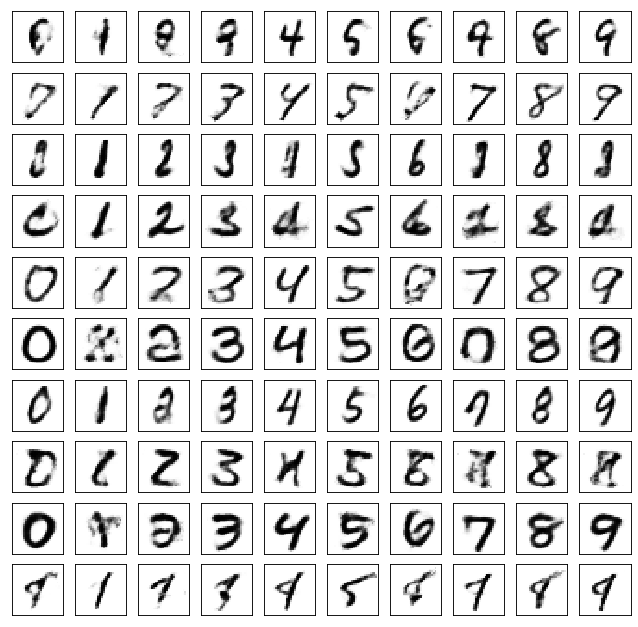

	reconstruction


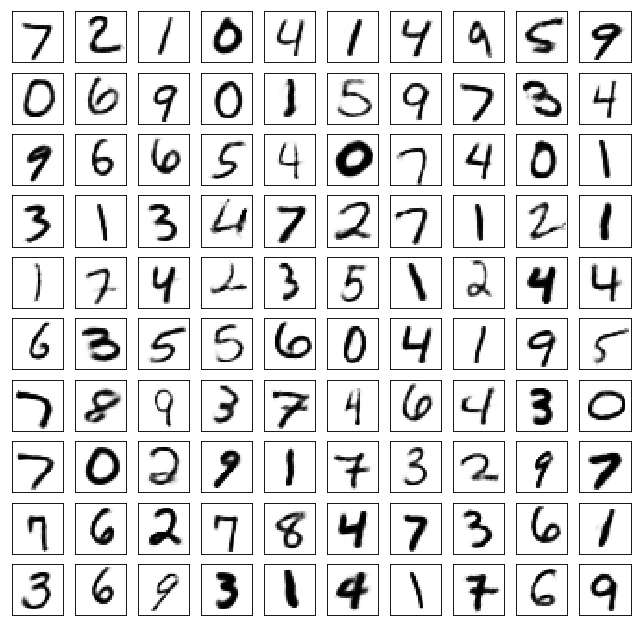

Test losses. E: 0.6929, AE: 0.0430, D: 0.6931
Train Epoch: 435 [0/50000 (0%)]	Losses E: 0.6937, AE: 0.0254, D: 0.6933
Train Epoch: 435 [25000/50000 (50%)]	Losses E: 0.7029, AE: 0.0253, D: 0.6937
Train Epoch: 435 [50000/50000 (100%)]	Losses E: 0.6883, AE: 0.0278, D: 0.6940
	generation


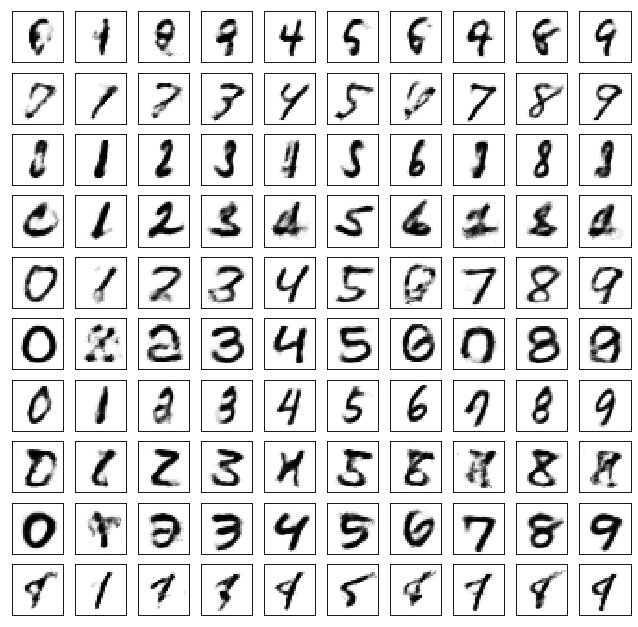

	reconstruction


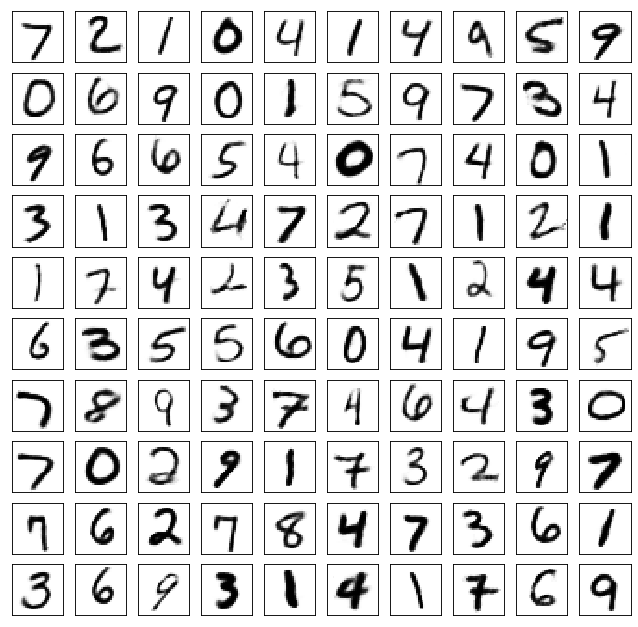

Test losses. E: 0.6868, AE: 0.0431, D: 0.6931
Train Epoch: 440 [0/50000 (0%)]	Losses E: 0.6958, AE: 0.0266, D: 0.6930
Train Epoch: 440 [25000/50000 (50%)]	Losses E: 0.6948, AE: 0.0255, D: 0.6925
Train Epoch: 440 [50000/50000 (100%)]	Losses E: 0.7019, AE: 0.0269, D: 0.6924
	generation


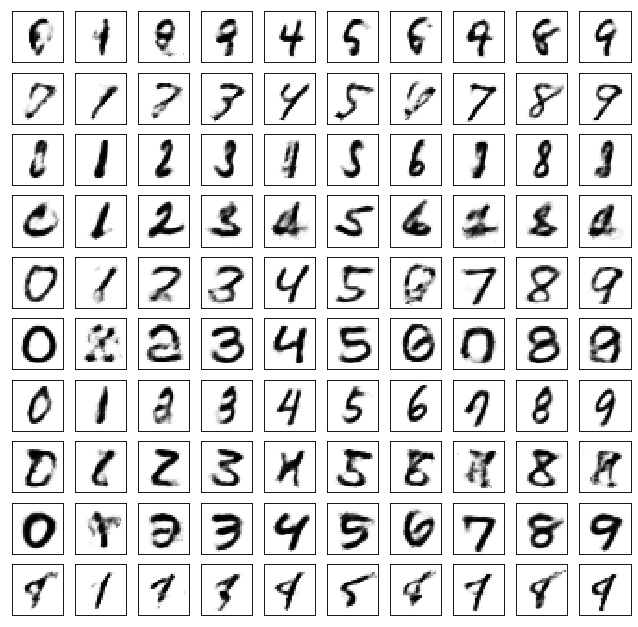

	reconstruction


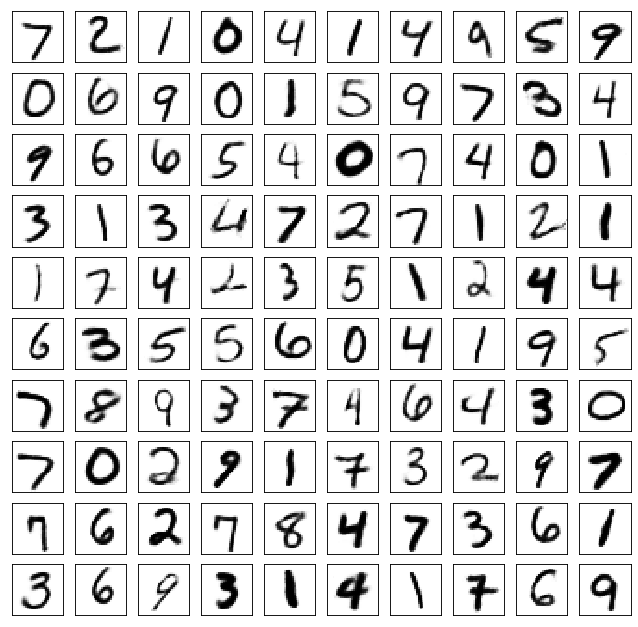

Test losses. E: 0.7002, AE: 0.0433, D: 0.6931
Train Epoch: 445 [0/50000 (0%)]	Losses E: 0.6894, AE: 0.0265, D: 0.6929
Train Epoch: 445 [25000/50000 (50%)]	Losses E: 0.6936, AE: 0.0264, D: 0.6926
Train Epoch: 445 [50000/50000 (100%)]	Losses E: 0.6934, AE: 0.0265, D: 0.6930
	generation


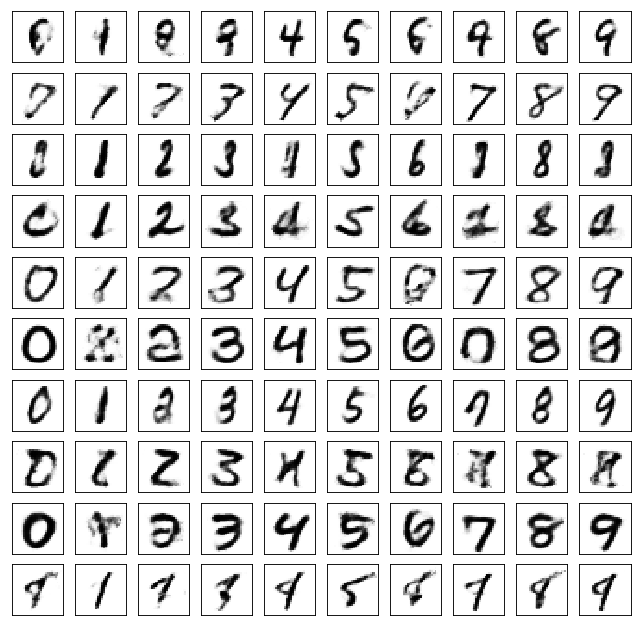

	reconstruction


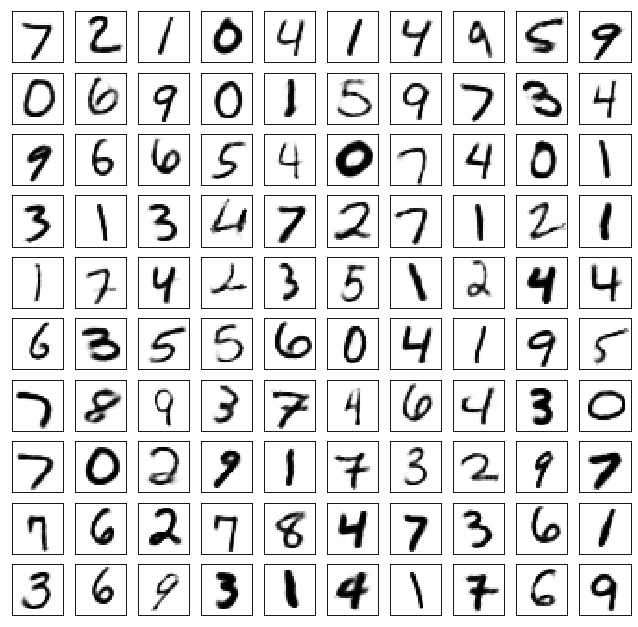

Test losses. E: 0.6938, AE: 0.0430, D: 0.6930
Train Epoch: 450 [0/50000 (0%)]	Losses E: 0.6975, AE: 0.0266, D: 0.6932
Train Epoch: 450 [25000/50000 (50%)]	Losses E: 0.6976, AE: 0.0266, D: 0.6934
Train Epoch: 450 [50000/50000 (100%)]	Losses E: 0.6957, AE: 0.0251, D: 0.6928
	generation


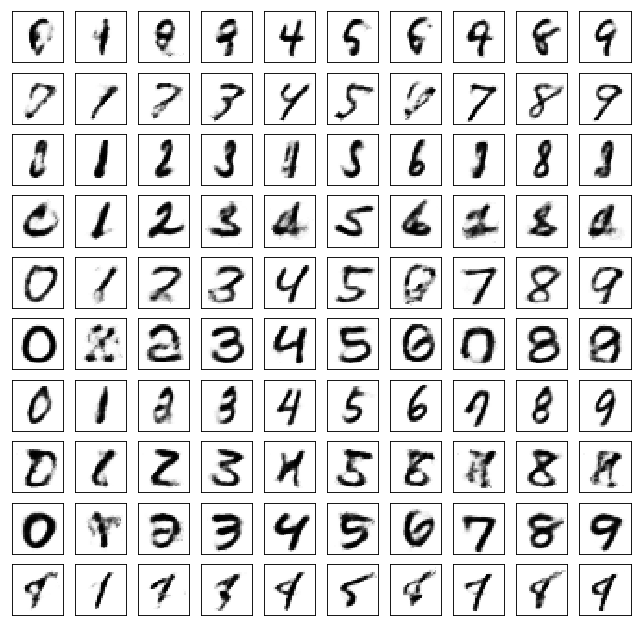

	reconstruction


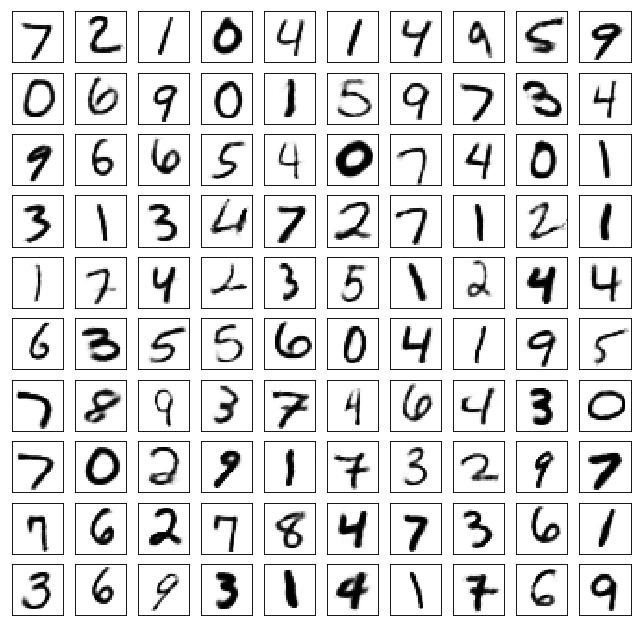

Test losses. E: 0.6947, AE: 0.0430, D: 0.6930
Train Epoch: 455 [0/50000 (0%)]	Losses E: 0.6946, AE: 0.0263, D: 0.6934
Train Epoch: 455 [25000/50000 (50%)]	Losses E: 0.7000, AE: 0.0260, D: 0.6926
Train Epoch: 455 [50000/50000 (100%)]	Losses E: 0.6976, AE: 0.0263, D: 0.6931
	generation


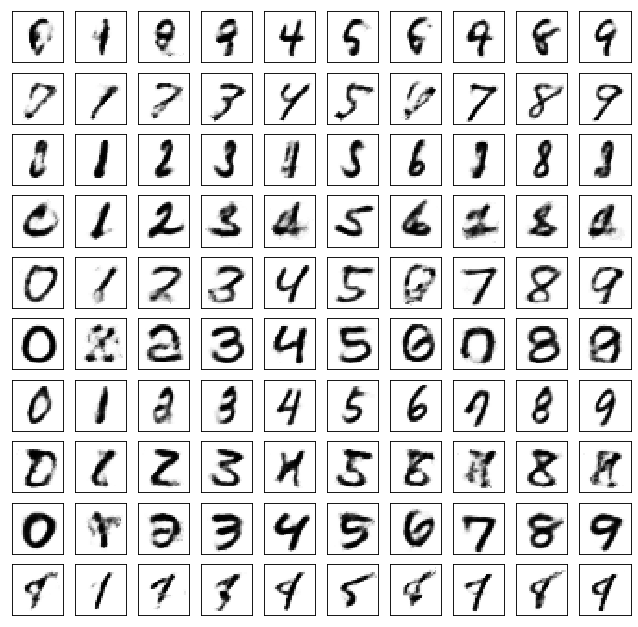

	reconstruction


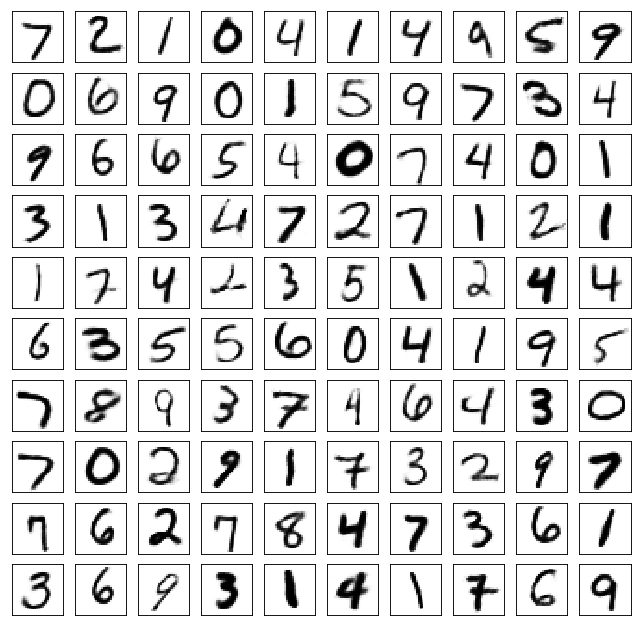

Test losses. E: 0.6965, AE: 0.0432, D: 0.6932
Train Epoch: 460 [0/50000 (0%)]	Losses E: 0.6952, AE: 0.0255, D: 0.6927
Train Epoch: 460 [25000/50000 (50%)]	Losses E: 0.6932, AE: 0.0261, D: 0.6932
Train Epoch: 460 [50000/50000 (100%)]	Losses E: 0.6896, AE: 0.0267, D: 0.6937
	generation


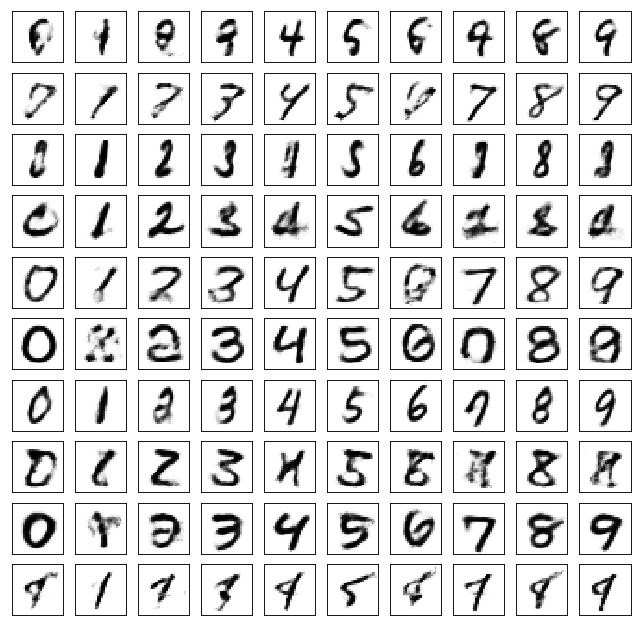

	reconstruction


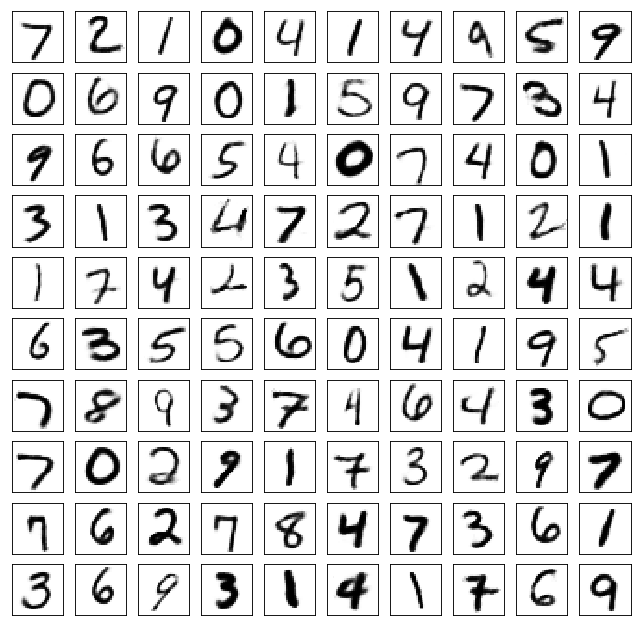

Test losses. E: 0.6895, AE: 0.0434, D: 0.6934
Train Epoch: 465 [0/50000 (0%)]	Losses E: 0.6940, AE: 0.0244, D: 0.6936
Train Epoch: 465 [25000/50000 (50%)]	Losses E: 0.6944, AE: 0.0249, D: 0.6935
Train Epoch: 465 [50000/50000 (100%)]	Losses E: 0.6961, AE: 0.0251, D: 0.6937
	generation


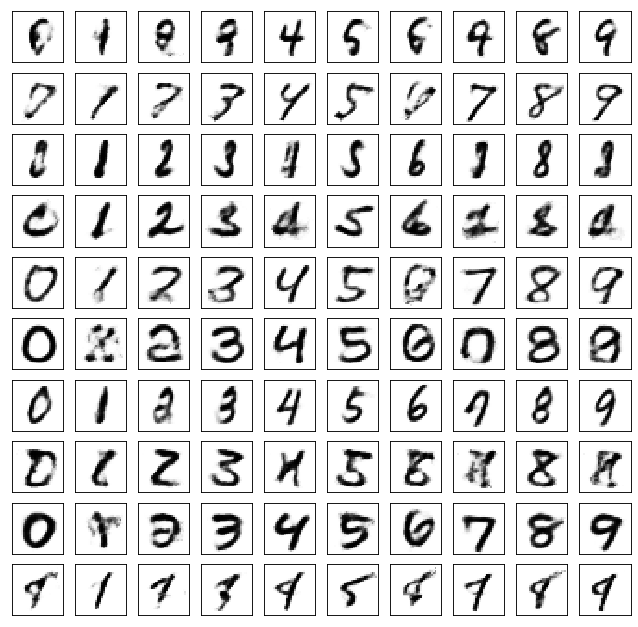

	reconstruction


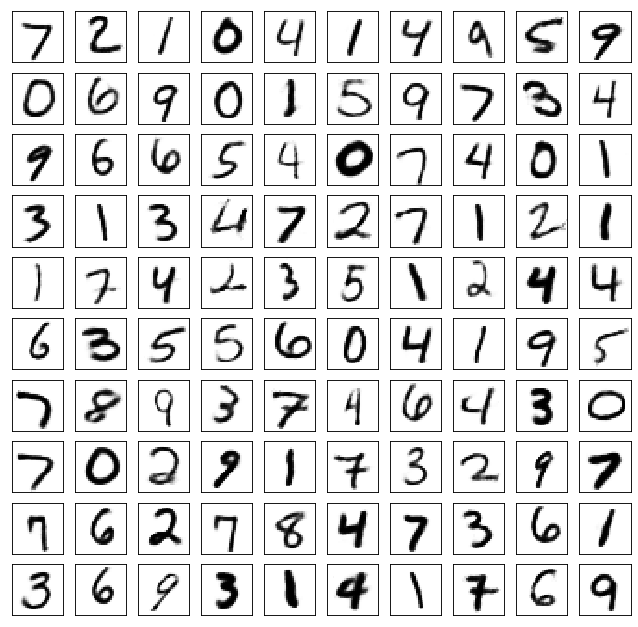

Test losses. E: 0.6966, AE: 0.0432, D: 0.6930
Train Epoch: 470 [0/50000 (0%)]	Losses E: 0.6898, AE: 0.0258, D: 0.6935
Train Epoch: 470 [25000/50000 (50%)]	Losses E: 0.6929, AE: 0.0257, D: 0.6935
Train Epoch: 470 [50000/50000 (100%)]	Losses E: 0.7001, AE: 0.0257, D: 0.6925
	generation


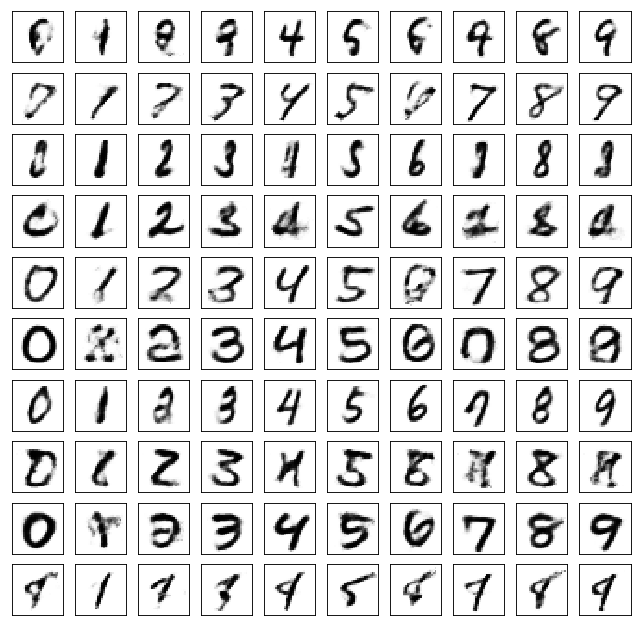

	reconstruction


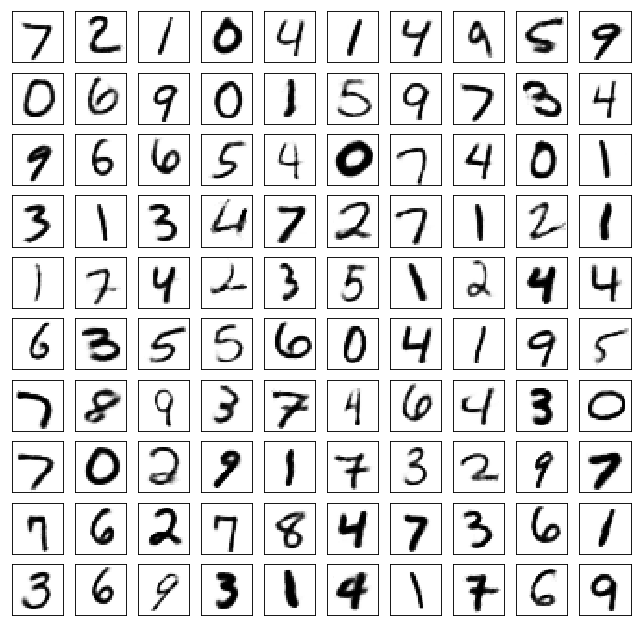

Test losses. E: 0.6991, AE: 0.0434, D: 0.6930
Train Epoch: 475 [0/50000 (0%)]	Losses E: 0.6934, AE: 0.0264, D: 0.6929
Train Epoch: 475 [25000/50000 (50%)]	Losses E: 0.6892, AE: 0.0261, D: 0.6933
Train Epoch: 475 [50000/50000 (100%)]	Losses E: 0.6935, AE: 0.0263, D: 0.6929
	generation


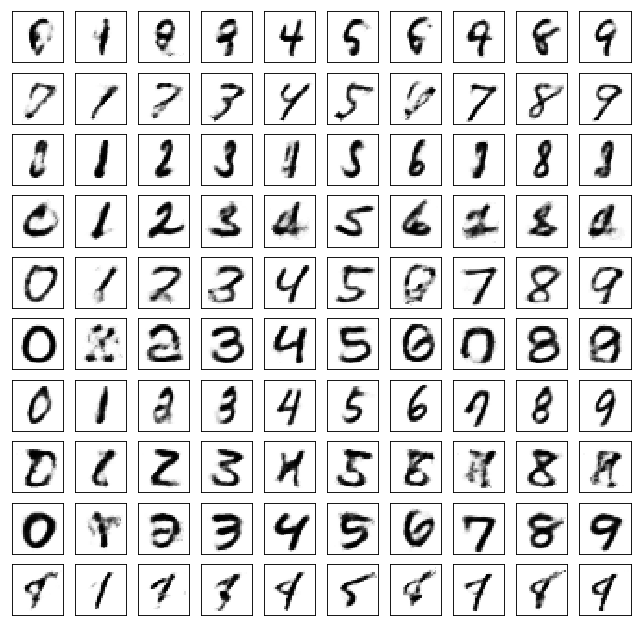

	reconstruction


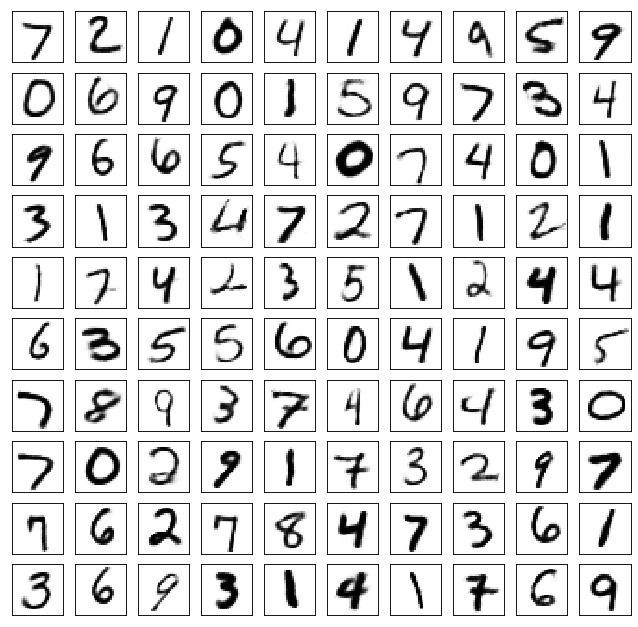

Test losses. E: 0.6931, AE: 0.0434, D: 0.6930
Train Epoch: 480 [0/50000 (0%)]	Losses E: 0.6912, AE: 0.0243, D: 0.6934
Train Epoch: 480 [25000/50000 (50%)]	Losses E: 0.6873, AE: 0.0256, D: 0.6927
Train Epoch: 480 [50000/50000 (100%)]	Losses E: 0.6943, AE: 0.0250, D: 0.6931
	generation


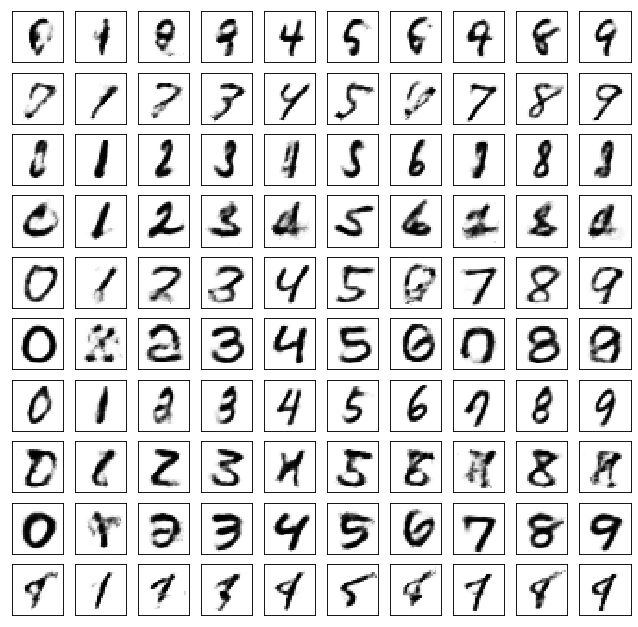

	reconstruction


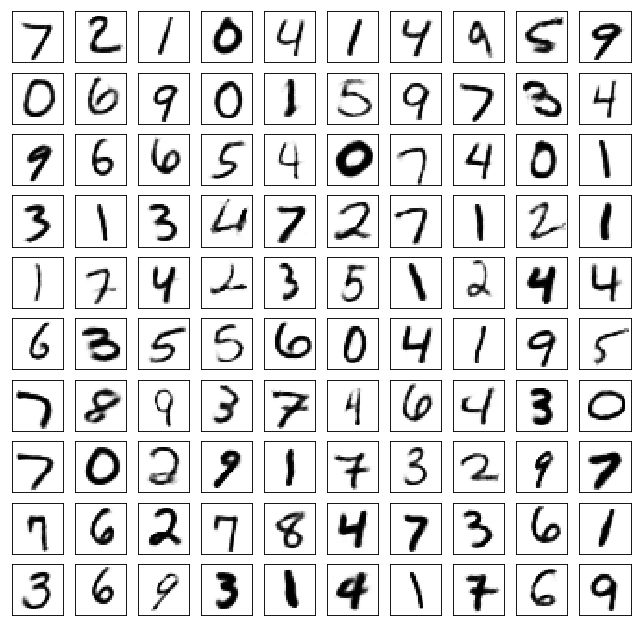

Test losses. E: 0.6934, AE: 0.0434, D: 0.6930
Train Epoch: 485 [0/50000 (0%)]	Losses E: 0.6928, AE: 0.0237, D: 0.6936
Train Epoch: 485 [25000/50000 (50%)]	Losses E: 0.6919, AE: 0.0246, D: 0.6923
Train Epoch: 485 [50000/50000 (100%)]	Losses E: 0.6962, AE: 0.0266, D: 0.6934
	generation


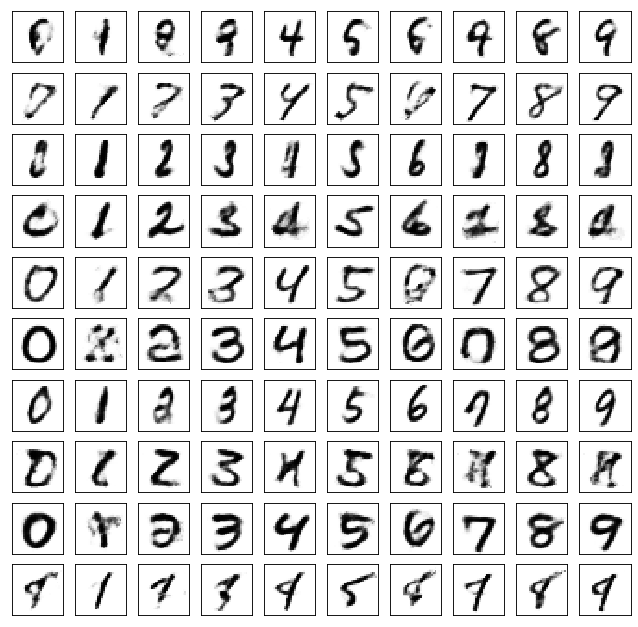

	reconstruction


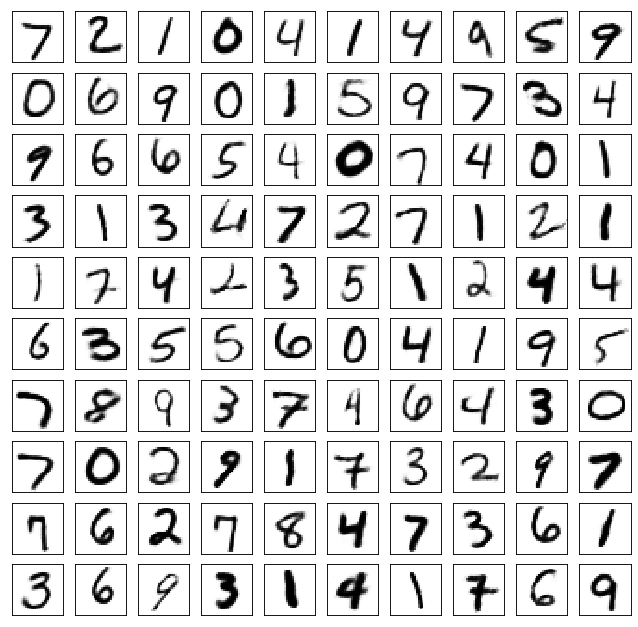

Test losses. E: 0.6953, AE: 0.0435, D: 0.6933
Train Epoch: 490 [0/50000 (0%)]	Losses E: 0.6873, AE: 0.0237, D: 0.6939
Train Epoch: 490 [25000/50000 (50%)]	Losses E: 0.6920, AE: 0.0255, D: 0.6946
Train Epoch: 490 [50000/50000 (100%)]	Losses E: 0.6897, AE: 0.0264, D: 0.6937
	generation


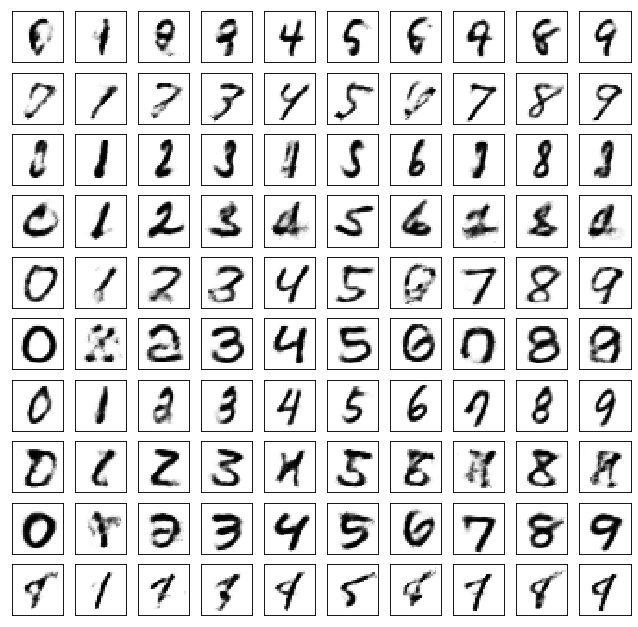

	reconstruction


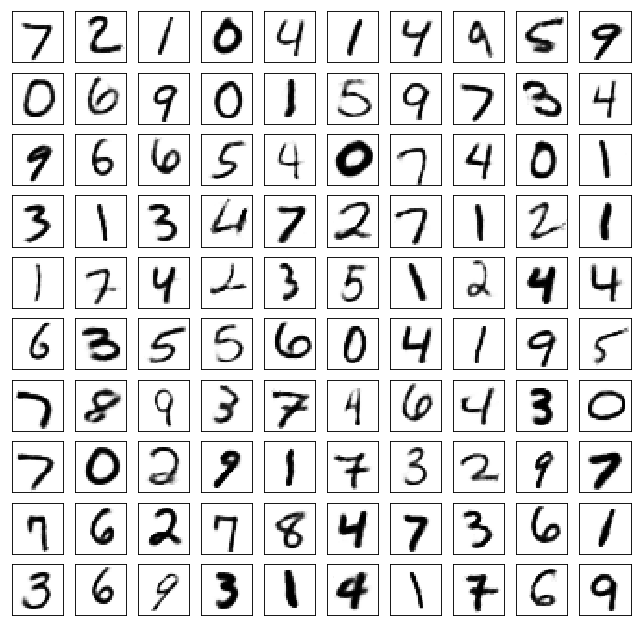

Test losses. E: 0.6877, AE: 0.0435, D: 0.6933
Train Epoch: 495 [0/50000 (0%)]	Losses E: 0.6911, AE: 0.0268, D: 0.6932
Train Epoch: 495 [25000/50000 (50%)]	Losses E: 0.6919, AE: 0.0245, D: 0.6940
Train Epoch: 495 [50000/50000 (100%)]	Losses E: 0.6918, AE: 0.0248, D: 0.6930
	generation


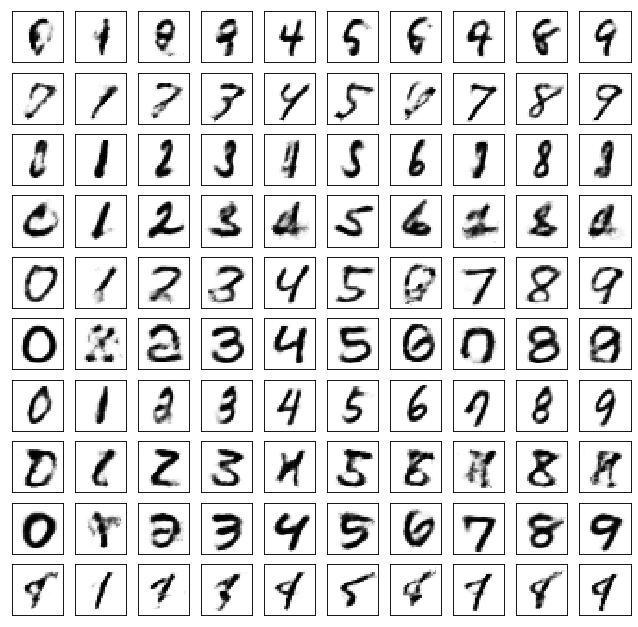

	reconstruction


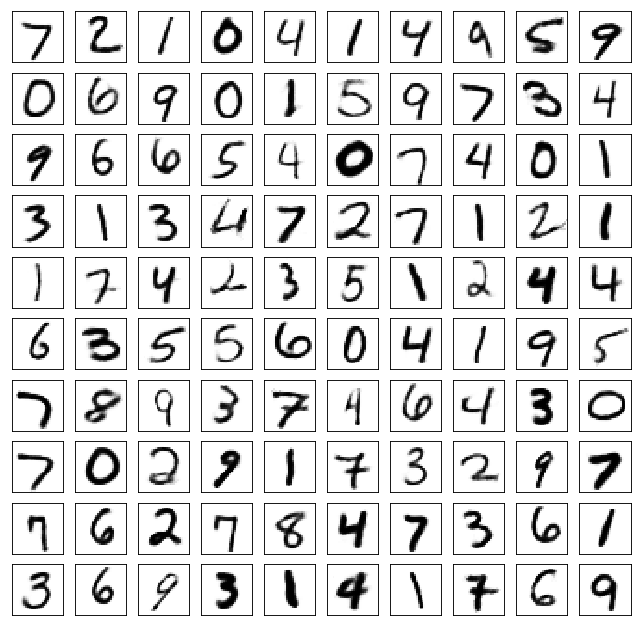

Test losses. E: 0.6903, AE: 0.0435, D: 0.6931
Train Epoch: 500 [0/50000 (0%)]	Losses E: 0.6962, AE: 0.0262, D: 0.6931
Train Epoch: 500 [25000/50000 (50%)]	Losses E: 0.6960, AE: 0.0244, D: 0.6927
Train Epoch: 500 [50000/50000 (100%)]	Losses E: 0.6913, AE: 0.0259, D: 0.6927
	generation


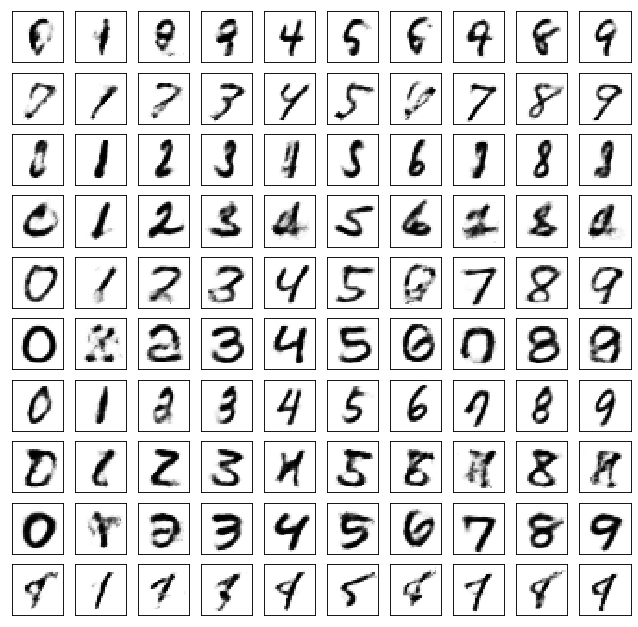

	reconstruction


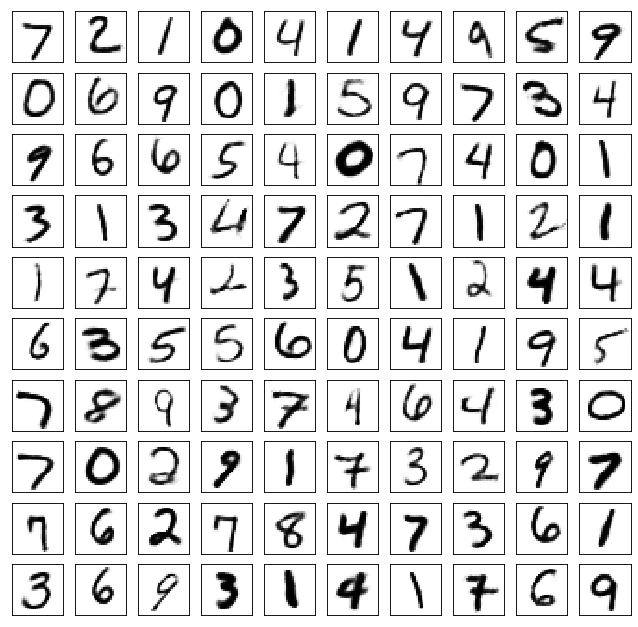

Test losses. E: 0.6897, AE: 0.0435, D: 0.6931
CPU times: user 2h 58min 6s, sys: 10min 52s, total: 3h 8min 58s
Wall time: 3h 9min 20s


In [ ]:
%%time

for epoch in range(1, train_epoch + 1):
    coders[variant]["Enc"].train()
    coders[variant]["Dec"].train()
    coders[variant]["Disc"].train()
    train(epoch, 
          coders[variant]["Enc"],
          coders[variant]["Dec"],
          coders[variant]["Disc"], 
          freq, logs[variant]["train"])
    coders[variant]["Enc"].eval()
    coders[variant]["Dec"].eval()
    coders[variant]["Disc"].eval()
    test(coders[variant]["Enc"],
         coders[variant]["Dec"],
         coders[variant]["Disc"], 
         valid_loader, epoch, freq, variant, logs[variant]["test"])

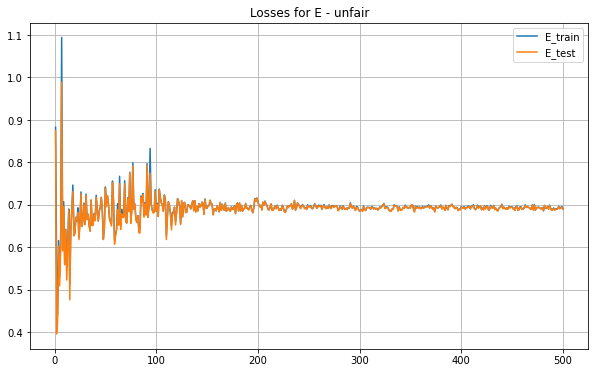

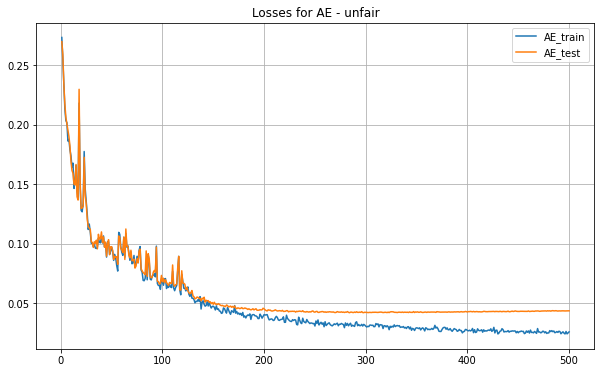

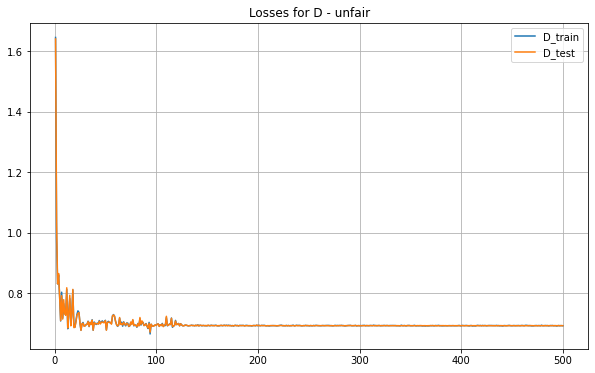

In [ ]:
for item in logs[variant]["train"]:
    plt.figure(figsize=(10, 6))
    for mode in logs[variant]:
        plt.plot(range(1, len(logs[variant][mode][item]) + 1), logs[variant][mode][item], 
                 label=f"{item}_{mode}")
    plt.title(f"Losses for {item} - {variant}")
    plt.legend()
    plt.grid()
    plt.show()

## <center>2) "Честный" вариант (fair)

In [15]:
variant = "fair"

In [16]:
coders[variant] = {}

In [17]:
coders[variant]["Enc"] = FullyConnected([28*28, 1024, 1024, prior_size], activation_fn=nn.LeakyReLU(0.2), flatten=True, device=device)
coders[variant]["Dec"] = FullyConnected([prior_size+10, 1024, 1024, 28*28], activation_fn=nn.LeakyReLU(0.2), last_fn=nn.Tanh(), device=device)
coders[variant]["Disc"] = FullyConnected([prior_size+10, 1024, 1024, 1], dropout=0.3, activation_fn=nn.LeakyReLU(0.2), device=device)

Enc_optimizer = optim.Adam(coders[variant]["Enc"].parameters(), lr=lr)
Dec_optimizer = optim.Adam(coders[variant]["Dec"].parameters(), lr=lr)
Disc_optimizer = optim.Adam(coders[variant]["Disc"].parameters(), lr=lr)

In [18]:
logs[variant] = {}
logs[variant]["train"] = {'E': [],'AE': [], 'D': []}
logs[variant]["test"] = {'E': [],'AE': [], 'D': []}

In [19]:
batch_zeros = torch.zeros((batch_size, 1)).to(device)
batch_ones = torch.ones((batch_size, 1)).to(device)

#### тренировочные функции

In [20]:
def train(epoch, Enc, Dec, Disc, freq=1, log=None):
    train_size = len(train_loader.sampler)
    for batch_idx, (data, label) in enumerate(train_loader):
        label = to_onehot(label, 10, device)
        # train D
        Enc.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size)).to(device)
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)

        fake_pred = Disc(Enc(data), label)
        true_pred = Disc(z, z_label)

        
        fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros)
        true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones)
        
        Disc_loss = 0.5*(fake_loss + true_loss)
        
        Disc_loss.backward()
        Disc_optimizer.step()
        
        # train AE
        Enc.zero_grad()
        Dec.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size))
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10)
        
        latent = Enc(data)
        reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
        fake_pred = Disc(latent, label)
        
        Enc_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_ones)
        AE_loss = F.mse_loss(reconstructed, data)
        G_loss = AE_loss + Enc_loss
        
        G_loss.backward()
        Dec_optimizer.step()
        Enc_optimizer.step()
            
        if epoch % freq == 0 or epoch == 1:
            if batch_idx % 100 == 0:
                line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                    epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
                losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
                print(line + losses)
            
    else:
        if epoch % freq == 0 or epoch == 1:
            batch_idx += 1
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
            losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
            print(line + losses)
        if log is not None:
            log['E'].append(Enc_loss.item())
            log['AE'].append(AE_loss.item())
            log['D'].append(Disc_loss.item())

In [21]:
def test(Enc, Dec, Disc, loader, epoch, freq=1, file_prefix='', log=None):
    test_size = len(loader)
    E_loss = 0.
    AE_loss = 0.
    D_loss = 0.
    test_loss = {'E': 0., 'AE': 0., 'D': 0.}
    with torch.no_grad():
        for data, label in loader:
            label = to_onehot(label, 10, device)
            z = torch.randn((batch_size, prior_size)).to(device)
            z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)
            latent = Enc(data)
            reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
            fake_pred = Disc(latent, label)
            true_pred = Disc(z, z_label)
        
            fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros).item()
            true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones).item()
            
            D_loss += 0.5*(fake_loss + true_loss)
            E_loss += F.binary_cross_entropy_with_logits(fake_pred, batch_ones).item()
            AE_loss += F.mse_loss(reconstructed, data)
            
        E_loss /= test_size
        D_loss /= test_size
        AE_loss /= test_size

        if epoch % freq == 0 or epoch == 1:
            fixed_gen = Dec(fixed_z, fixed_z_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\tgeneration")
            plot_mnist(fixed_gen, (10, 10), True, fixed_folder + file_prefix + '%03d.png' % epoch)
            fixed_reconstruction = Dec(Enc(fixed_data), fixed_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\treconstruction")
            plot_mnist(fixed_reconstruction, (10, 10), True, 
                    recon_folder + file_prefix + '%03d.png' % epoch)
            
            report = 'Test losses. E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(E_loss, AE_loss, D_loss)
            print(report)

        if log is not None:
            log['E'].append(E_loss)
            log['AE'].append(AE_loss)
            log['D'].append(D_loss)

Train Epoch: 1 [0/50000 (0%)]	Losses E: 0.6754, AE: 0.9264, D: 0.7000
Train Epoch: 1 [25000/50000 (50%)]	Losses E: 3.8418, AE: 0.2628, D: 2.0531
Train Epoch: 1 [50000/50000 (100%)]	Losses E: 0.9073, AE: 0.2684, D: 1.3349
	generation


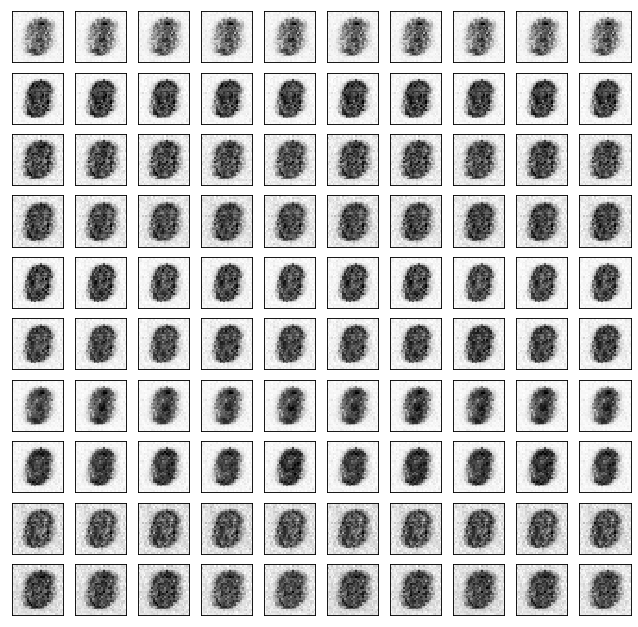

	reconstruction


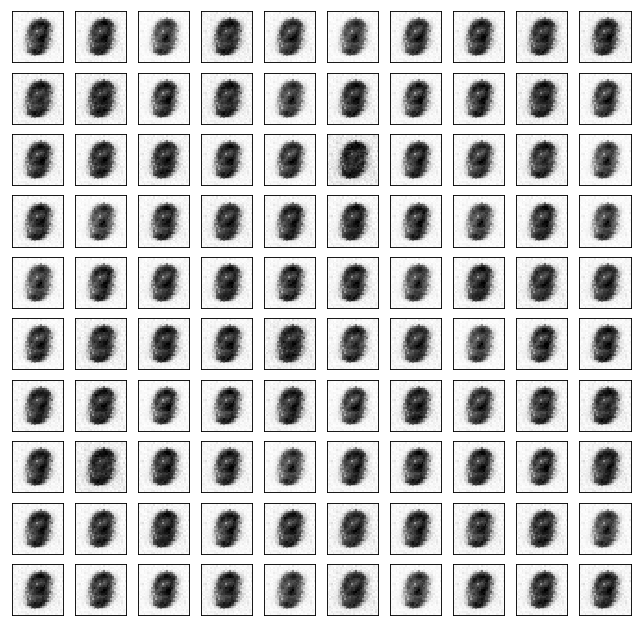

Test losses. E: 0.8946, AE: 0.2659, D: 1.2953
Train Epoch: 5 [0/50000 (0%)]	Losses E: 0.5746, AE: 0.2163, D: 0.8285
Train Epoch: 5 [25000/50000 (50%)]	Losses E: 0.6546, AE: 0.2142, D: 0.7850
Train Epoch: 5 [50000/50000 (100%)]	Losses E: 0.5546, AE: 0.2062, D: 0.7359
	generation


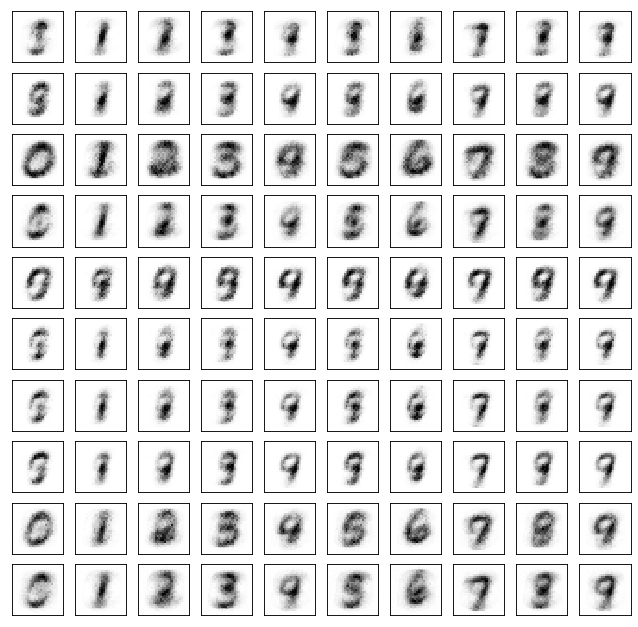

	reconstruction


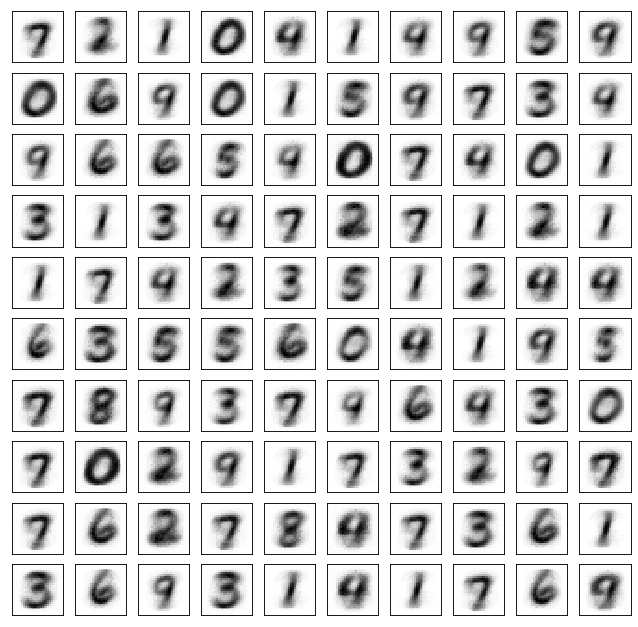

Test losses. E: 0.5475, AE: 0.2040, D: 0.7350
Train Epoch: 10 [0/50000 (0%)]	Losses E: 0.6017, AE: 0.1664, D: 0.7063
Train Epoch: 10 [25000/50000 (50%)]	Losses E: 0.4795, AE: 0.1794, D: 0.7772
Train Epoch: 10 [50000/50000 (100%)]	Losses E: 0.6885, AE: 0.1626, D: 0.7393
	generation


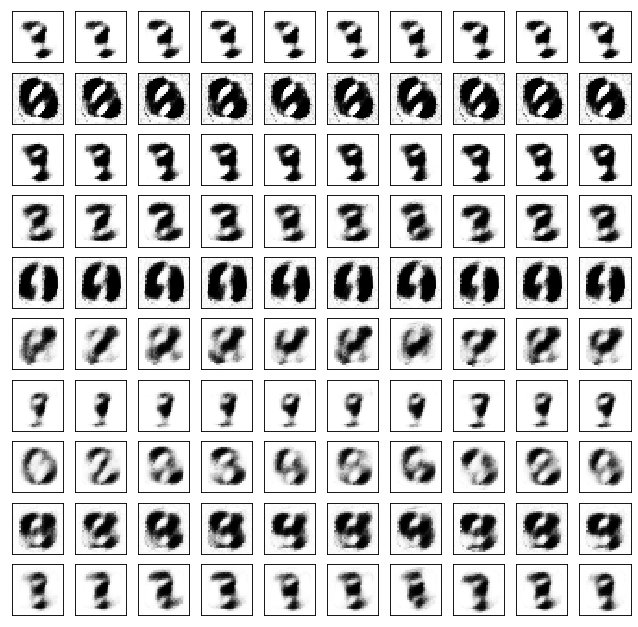

	reconstruction


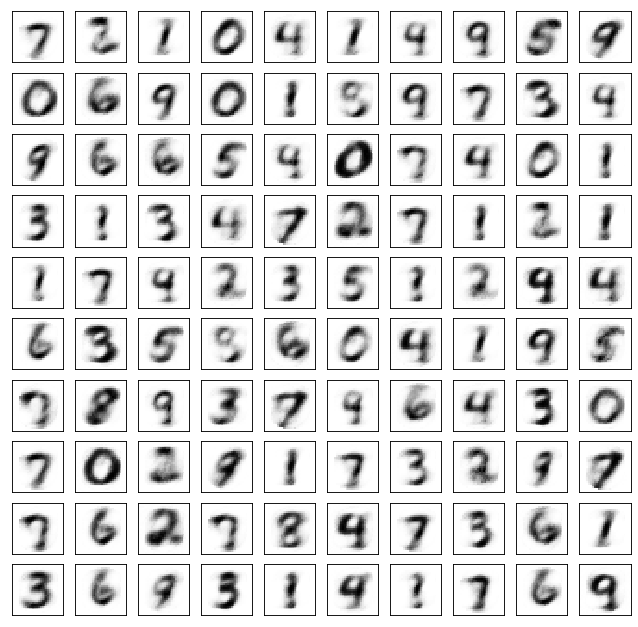

Test losses. E: 0.6820, AE: 0.1611, D: 0.7349
Train Epoch: 15 [0/50000 (0%)]	Losses E: 0.6868, AE: 0.1479, D: 0.6946
Train Epoch: 15 [25000/50000 (50%)]	Losses E: 0.6688, AE: 0.1372, D: 0.7455
Train Epoch: 15 [50000/50000 (100%)]	Losses E: 0.6503, AE: 0.1306, D: 0.6897
	generation


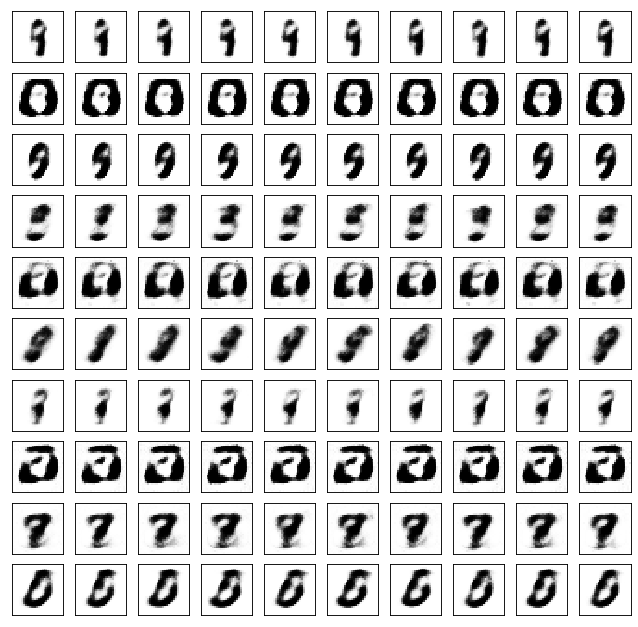

	reconstruction


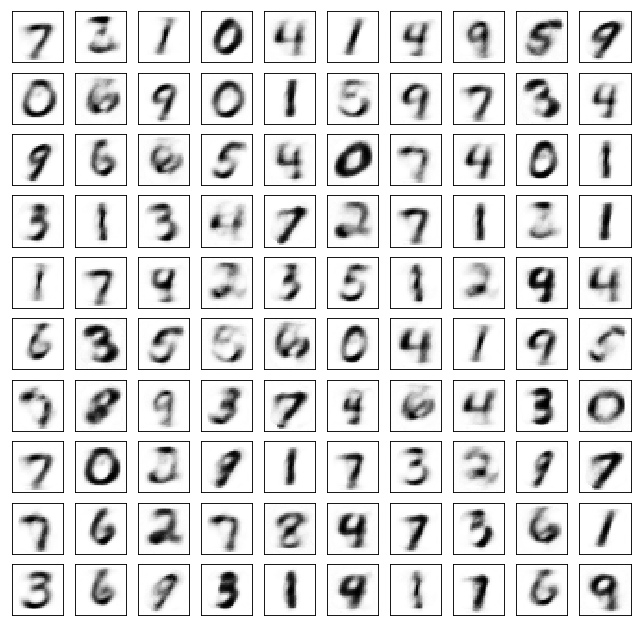

Test losses. E: 0.6494, AE: 0.1339, D: 0.6876
Train Epoch: 20 [0/50000 (0%)]	Losses E: 0.6735, AE: 0.1265, D: 0.6863
Train Epoch: 20 [25000/50000 (50%)]	Losses E: 0.7215, AE: 0.2587, D: 0.7427
Train Epoch: 20 [50000/50000 (100%)]	Losses E: 0.7046, AE: 0.1256, D: 0.7137
	generation


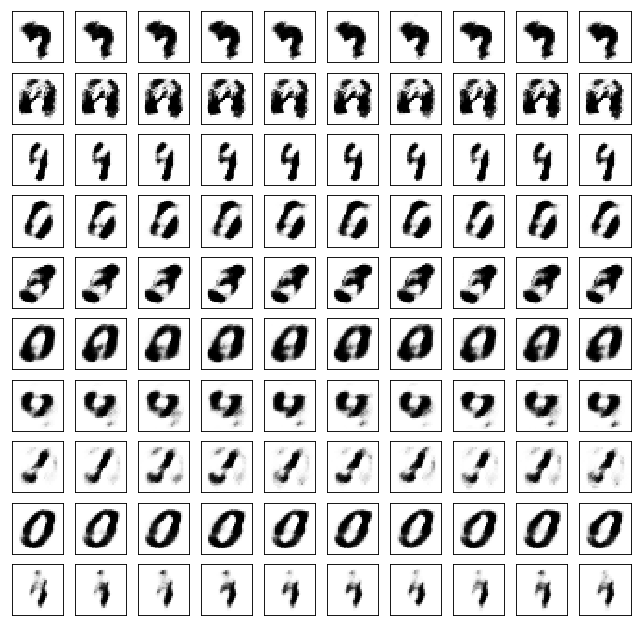

	reconstruction


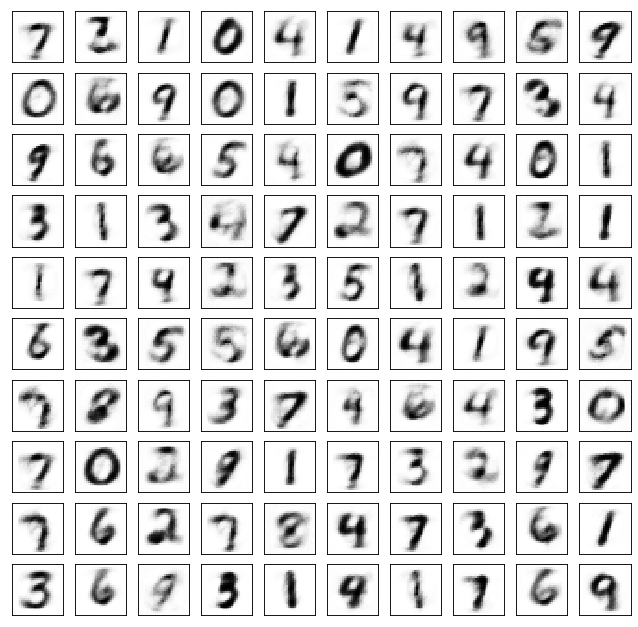

Test losses. E: 0.7057, AE: 0.1270, D: 0.7098
Train Epoch: 25 [0/50000 (0%)]	Losses E: 0.7142, AE: 0.1325, D: 0.7025
Train Epoch: 25 [25000/50000 (50%)]	Losses E: 0.6571, AE: 0.1291, D: 0.6977
Train Epoch: 25 [50000/50000 (100%)]	Losses E: 0.6963, AE: 0.1182, D: 0.7103
	generation


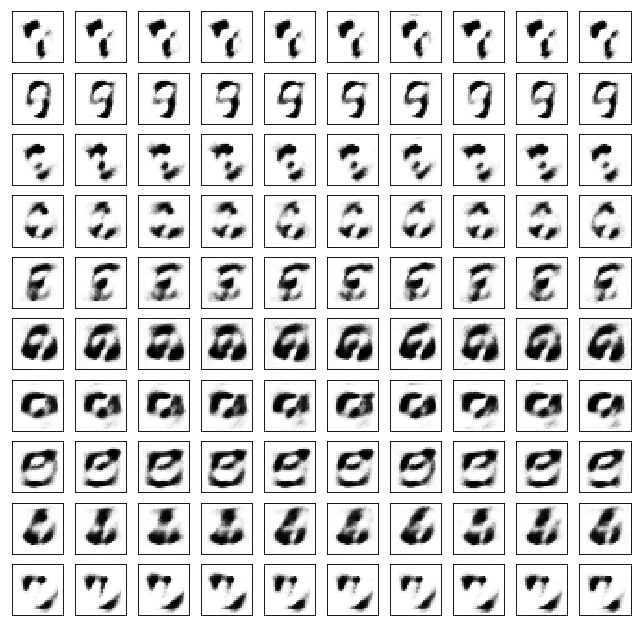

	reconstruction


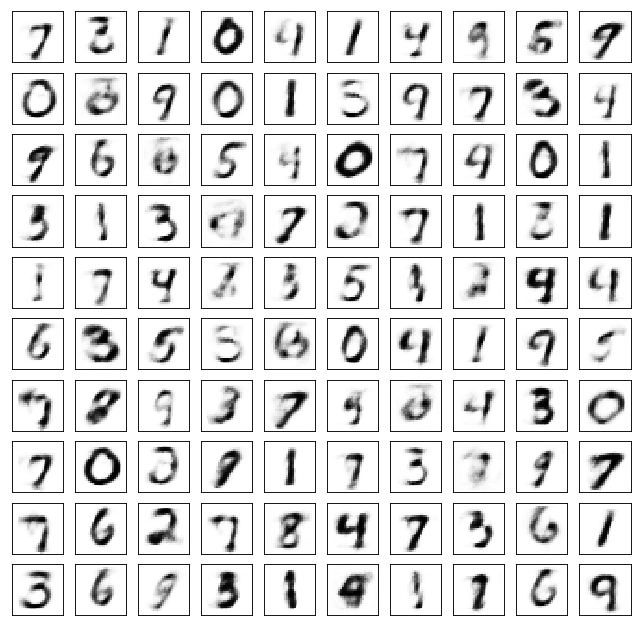

Test losses. E: 0.6907, AE: 0.1245, D: 0.7108
Train Epoch: 30 [0/50000 (0%)]	Losses E: 0.6916, AE: 0.1112, D: 0.6975
Train Epoch: 30 [25000/50000 (50%)]	Losses E: 0.6850, AE: 0.0999, D: 0.6960
Train Epoch: 30 [50000/50000 (100%)]	Losses E: 0.7022, AE: 0.0986, D: 0.6925
	generation


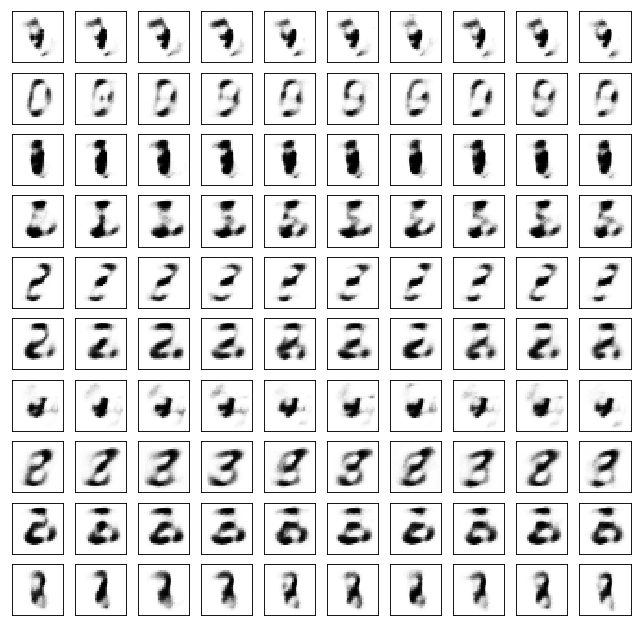

	reconstruction


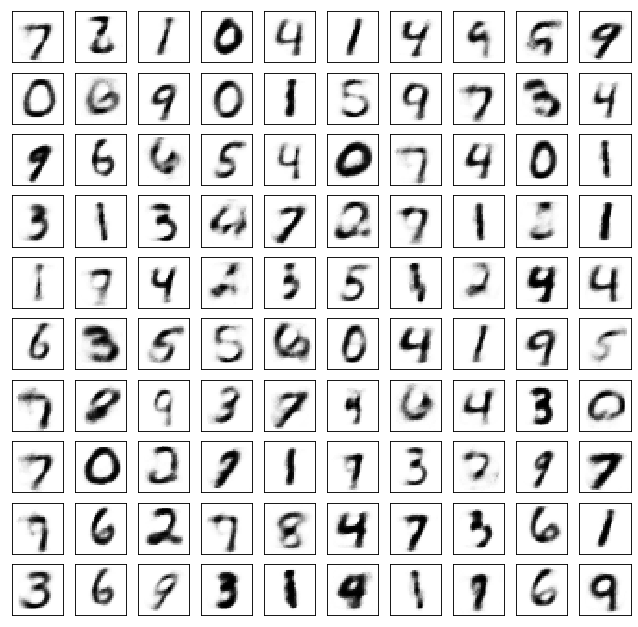

Test losses. E: 0.6995, AE: 0.0976, D: 0.6926
Train Epoch: 35 [0/50000 (0%)]	Losses E: 0.6978, AE: 0.1088, D: 0.6904
Train Epoch: 35 [25000/50000 (50%)]	Losses E: 0.7197, AE: 0.1129, D: 0.7031
Train Epoch: 35 [50000/50000 (100%)]	Losses E: 0.7010, AE: 0.1064, D: 0.6990
	generation


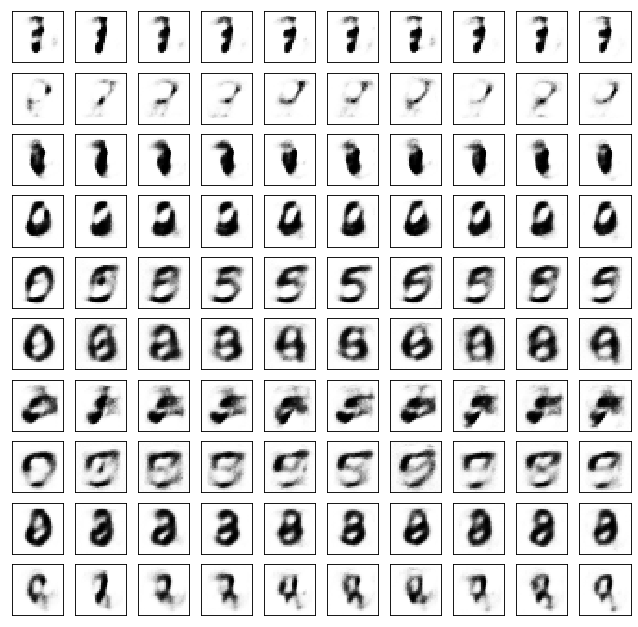

	reconstruction


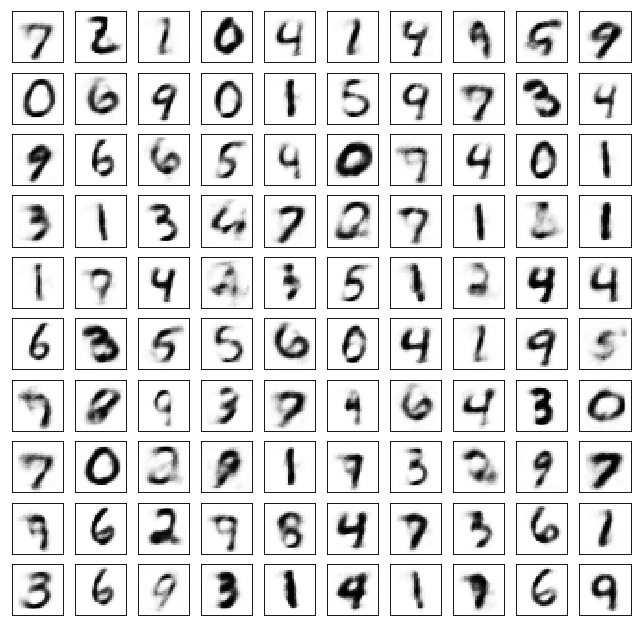

Test losses. E: 0.7002, AE: 0.1069, D: 0.6981
Train Epoch: 40 [0/50000 (0%)]	Losses E: 0.6642, AE: 0.0950, D: 0.6934
Train Epoch: 40 [25000/50000 (50%)]	Losses E: 0.7044, AE: 0.1058, D: 0.6972
Train Epoch: 40 [50000/50000 (100%)]	Losses E: 0.6919, AE: 0.1107, D: 0.7061
	generation


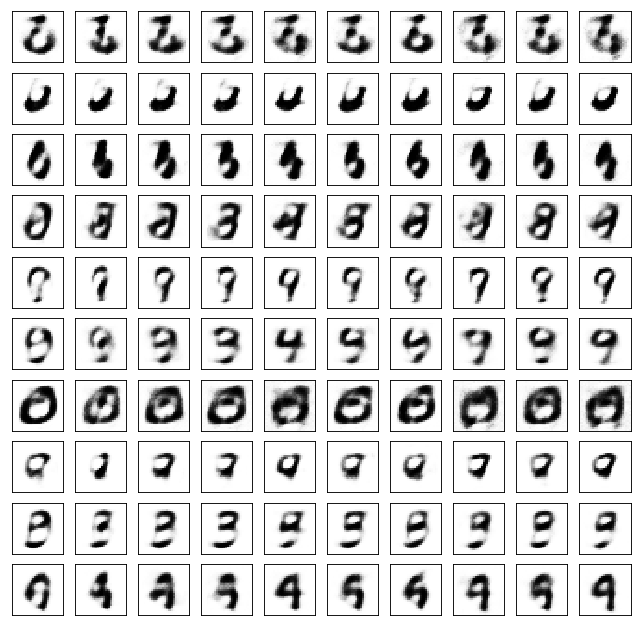

	reconstruction


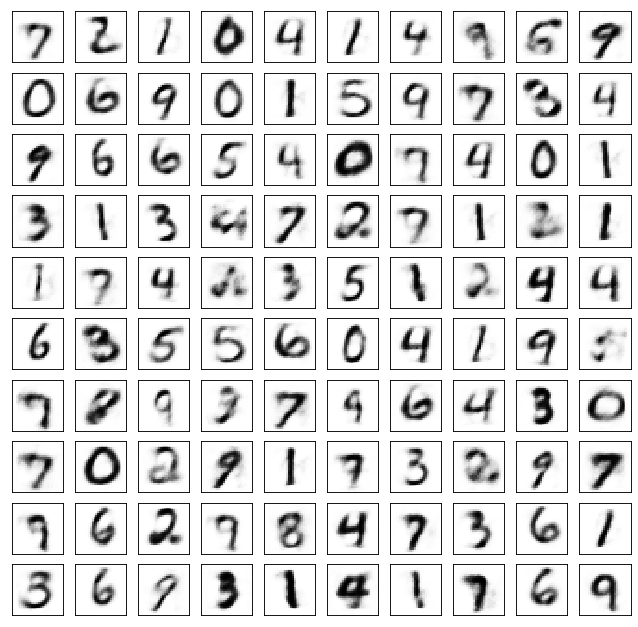

Test losses. E: 0.6923, AE: 0.1065, D: 0.7040
Train Epoch: 45 [0/50000 (0%)]	Losses E: 0.6833, AE: 0.0902, D: 0.6951
Train Epoch: 45 [25000/50000 (50%)]	Losses E: 0.7093, AE: 0.1033, D: 0.6894
Train Epoch: 45 [50000/50000 (100%)]	Losses E: 0.6982, AE: 0.0854, D: 0.6924
	generation


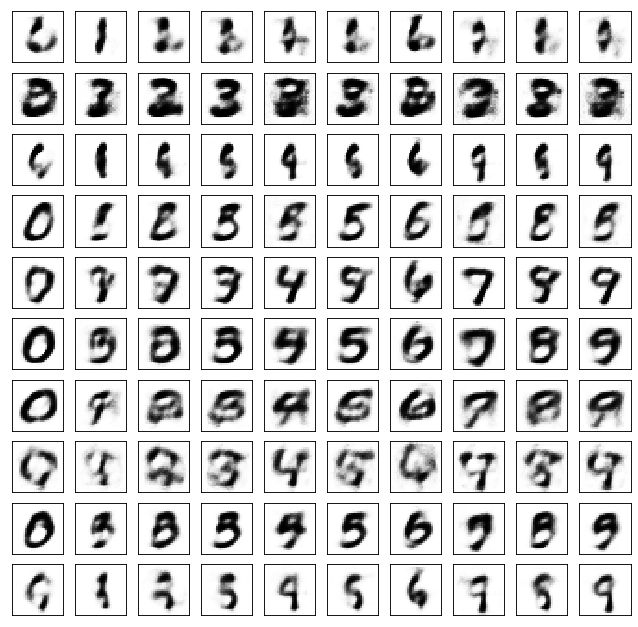

	reconstruction


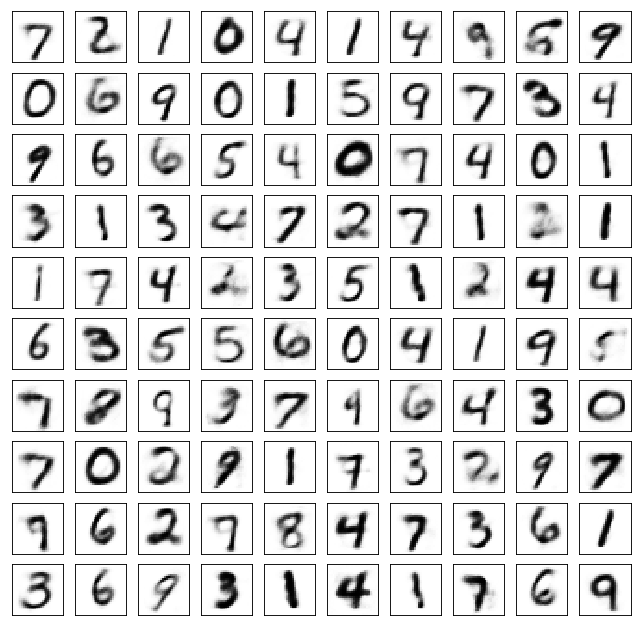

Test losses. E: 0.6987, AE: 0.0875, D: 0.6907
Train Epoch: 50 [0/50000 (0%)]	Losses E: 0.7196, AE: 0.0858, D: 0.6928
Train Epoch: 50 [25000/50000 (50%)]	Losses E: 0.7112, AE: 0.0874, D: 0.6914
Train Epoch: 50 [50000/50000 (100%)]	Losses E: 0.7146, AE: 0.0844, D: 0.6913
	generation


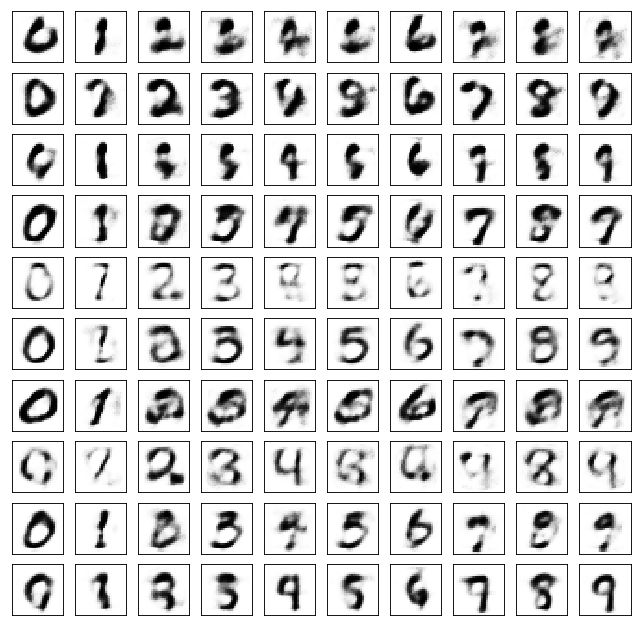

	reconstruction


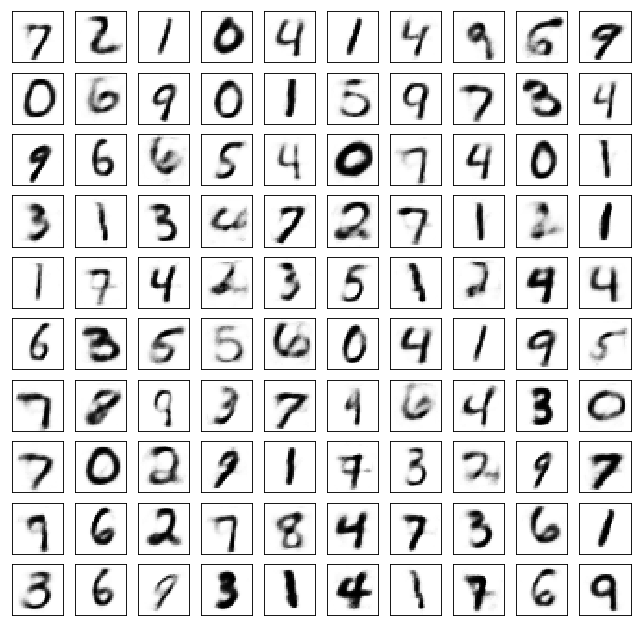

Test losses. E: 0.7184, AE: 0.0846, D: 0.6887
Train Epoch: 55 [0/50000 (0%)]	Losses E: 0.6477, AE: 0.0874, D: 0.6998
Train Epoch: 55 [25000/50000 (50%)]	Losses E: 0.7571, AE: 0.1277, D: 0.7077
Train Epoch: 55 [50000/50000 (100%)]	Losses E: 0.6263, AE: 0.1256, D: 0.7239
	generation


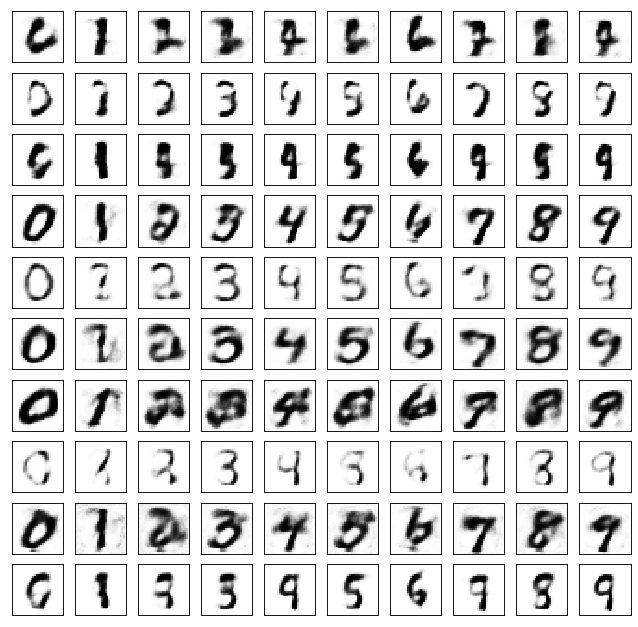

	reconstruction


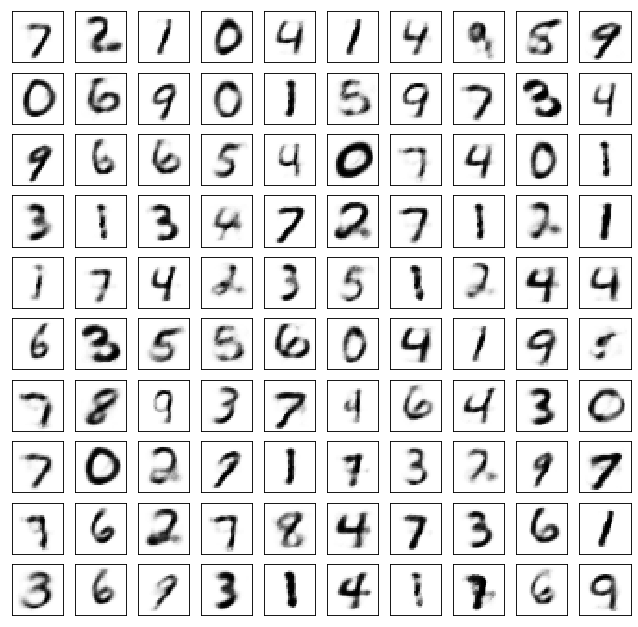

Test losses. E: 0.6266, AE: 0.1166, D: 0.7231
Train Epoch: 60 [0/50000 (0%)]	Losses E: 0.6861, AE: 0.0882, D: 0.6984
Train Epoch: 60 [25000/50000 (50%)]	Losses E: 0.7237, AE: 0.0914, D: 0.7027
Train Epoch: 60 [50000/50000 (100%)]	Losses E: 0.6875, AE: 0.0877, D: 0.7007
	generation


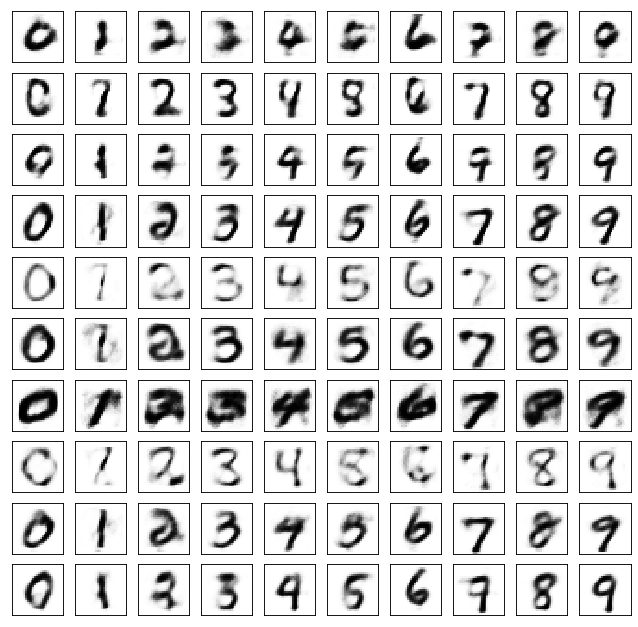

	reconstruction


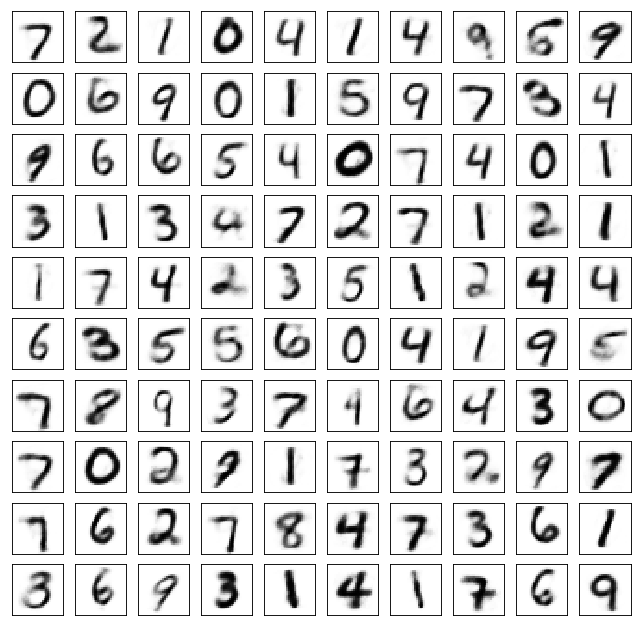

Test losses. E: 0.6881, AE: 0.0872, D: 0.6986
Train Epoch: 65 [0/50000 (0%)]	Losses E: 0.6818, AE: 0.0862, D: 0.6982
Train Epoch: 65 [25000/50000 (50%)]	Losses E: 0.6933, AE: 0.0860, D: 0.7019
Train Epoch: 65 [50000/50000 (100%)]	Losses E: 0.7076, AE: 0.0920, D: 0.7012
	generation


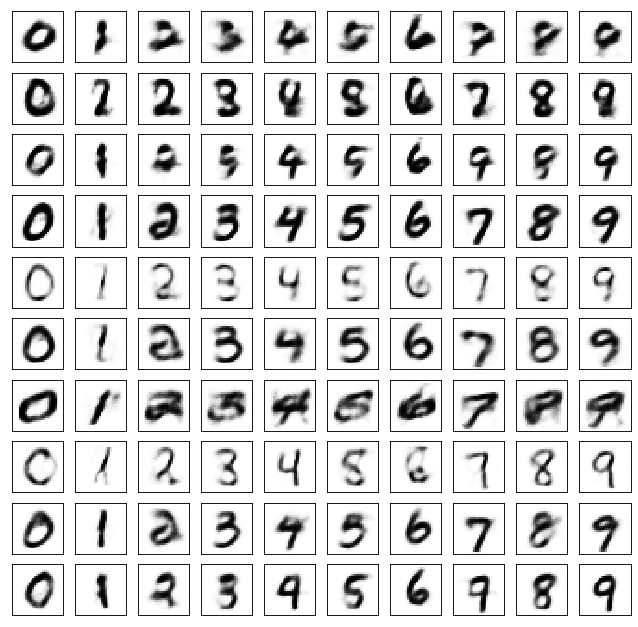

	reconstruction


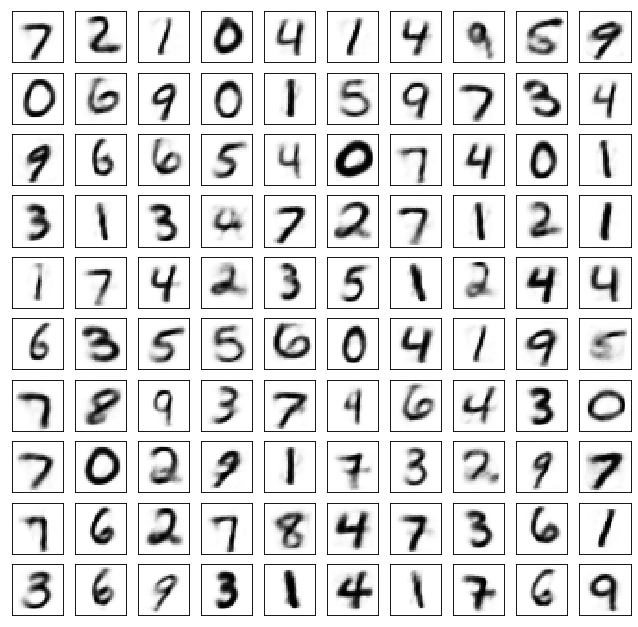

Test losses. E: 0.7058, AE: 0.0895, D: 0.7007
Train Epoch: 70 [0/50000 (0%)]	Losses E: 0.6974, AE: 0.0890, D: 0.7002
Train Epoch: 70 [25000/50000 (50%)]	Losses E: 0.6571, AE: 0.0812, D: 0.6973
Train Epoch: 70 [50000/50000 (100%)]	Losses E: 0.6960, AE: 0.0866, D: 0.6952
	generation


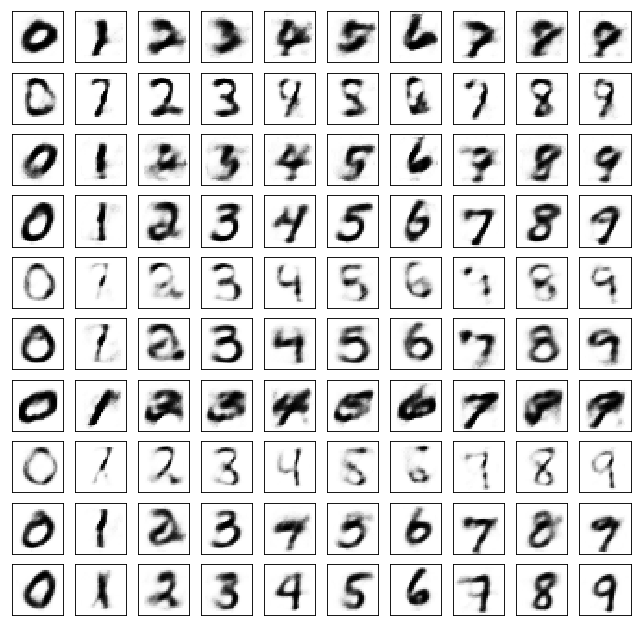

	reconstruction


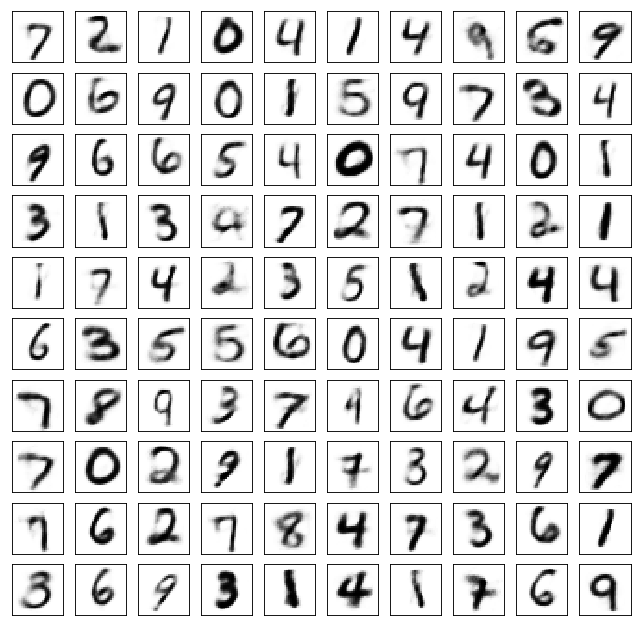

Test losses. E: 0.6929, AE: 0.0845, D: 0.6959
Train Epoch: 75 [0/50000 (0%)]	Losses E: 0.6801, AE: 0.0734, D: 0.6916
Train Epoch: 75 [25000/50000 (50%)]	Losses E: 0.7013, AE: 0.0745, D: 0.6995
Train Epoch: 75 [50000/50000 (100%)]	Losses E: 0.7357, AE: 0.0883, D: 0.6959
	generation


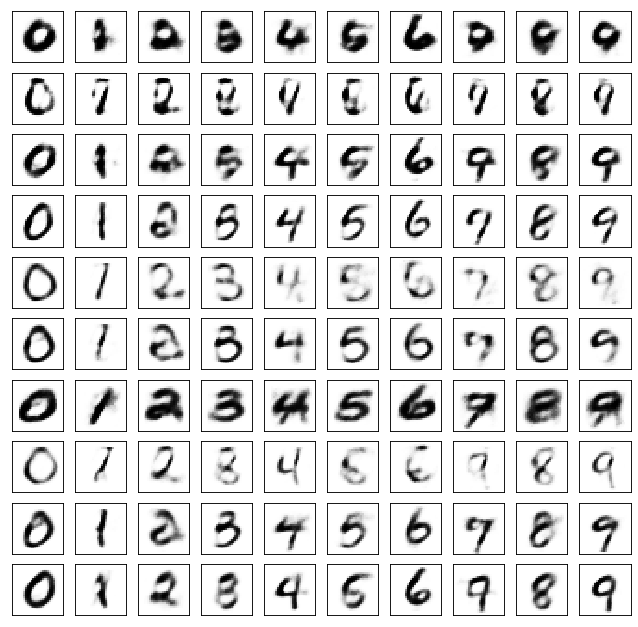

	reconstruction


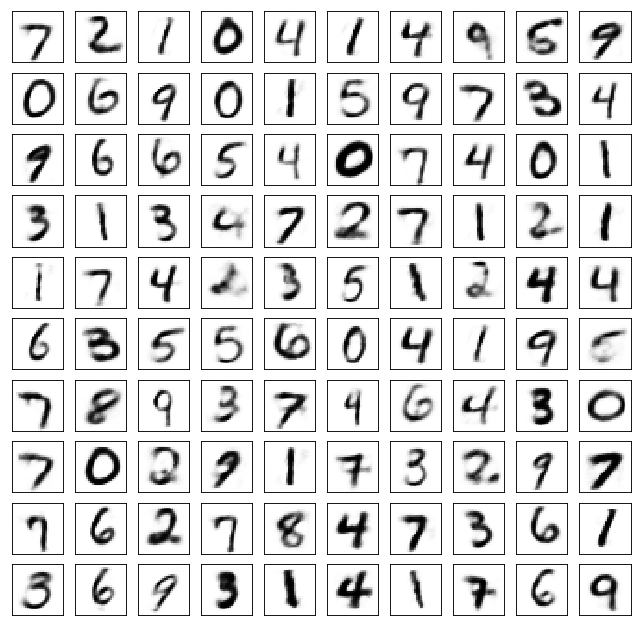

Test losses. E: 0.7343, AE: 0.0841, D: 0.6985
Train Epoch: 80 [0/50000 (0%)]	Losses E: 0.6689, AE: 0.0758, D: 0.6939
Train Epoch: 80 [25000/50000 (50%)]	Losses E: 0.7021, AE: 0.0710, D: 0.6944
Train Epoch: 80 [50000/50000 (100%)]	Losses E: 0.7070, AE: 0.0711, D: 0.6886
	generation


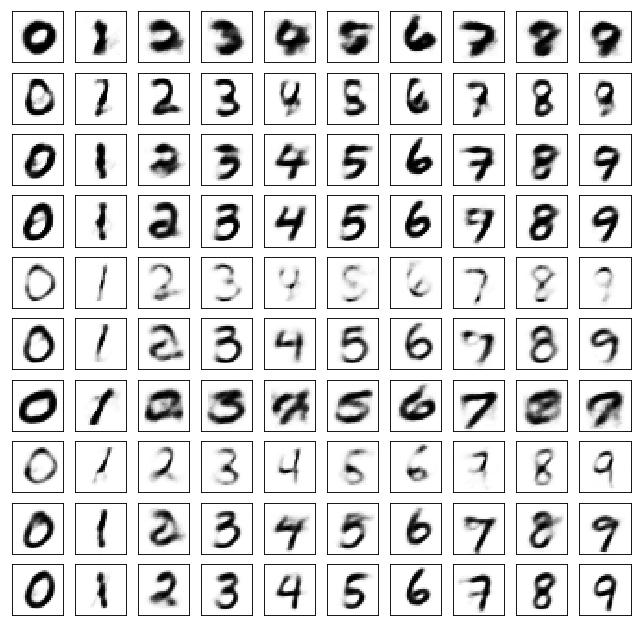

	reconstruction


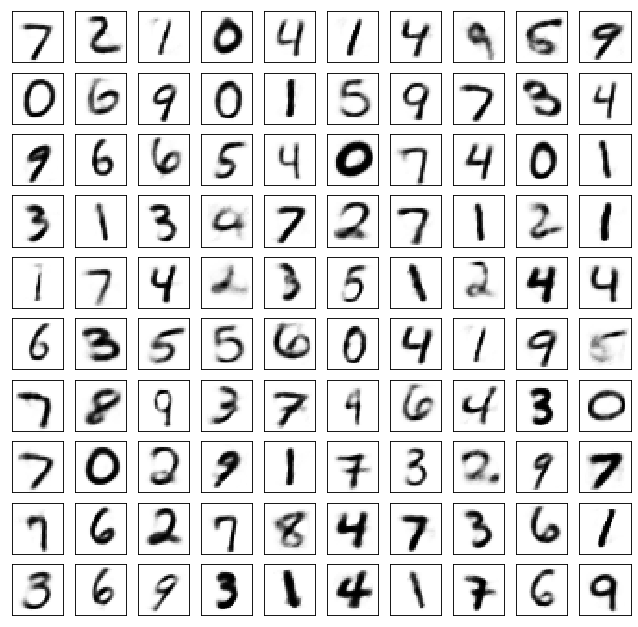

Test losses. E: 0.7067, AE: 0.0712, D: 0.6888
Train Epoch: 85 [0/50000 (0%)]	Losses E: 0.7008, AE: 0.0669, D: 0.6914
Train Epoch: 85 [25000/50000 (50%)]	Losses E: 0.6915, AE: 0.0710, D: 0.6979
Train Epoch: 85 [50000/50000 (100%)]	Losses E: 0.6855, AE: 0.0789, D: 0.7089
	generation


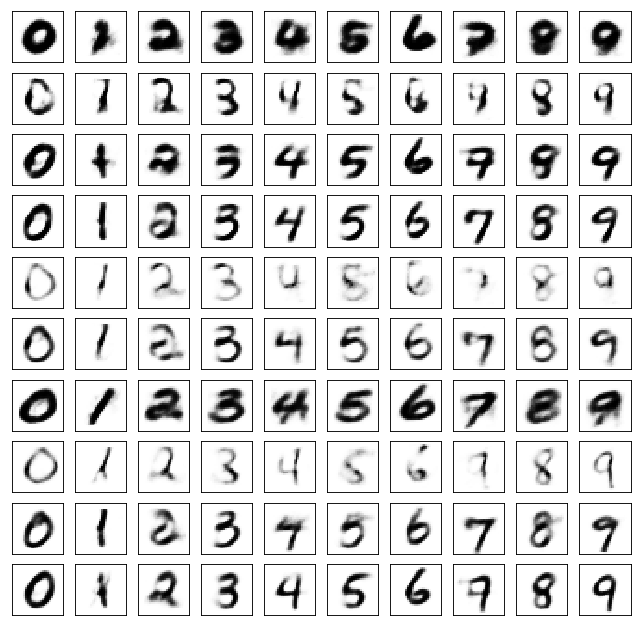

	reconstruction


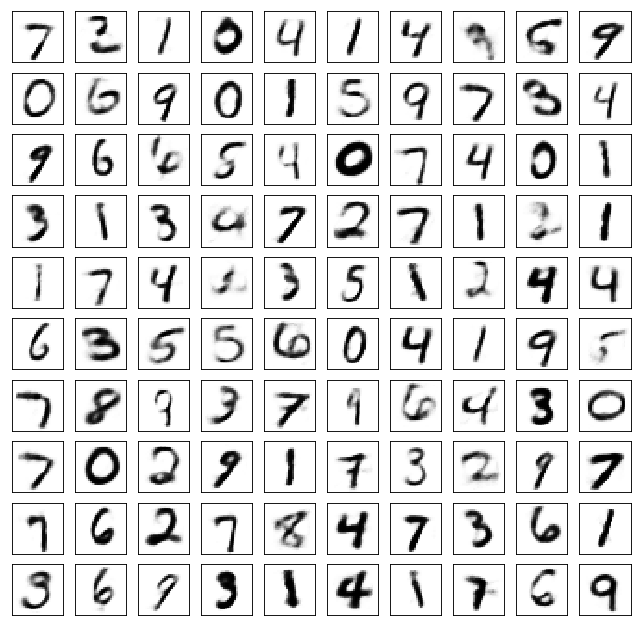

Test losses. E: 0.6887, AE: 0.0809, D: 0.7038
Train Epoch: 90 [0/50000 (0%)]	Losses E: 0.7709, AE: 0.0806, D: 0.6958
Train Epoch: 90 [25000/50000 (50%)]	Losses E: 0.7264, AE: 0.0848, D: 0.7023
Train Epoch: 90 [50000/50000 (100%)]	Losses E: 0.6987, AE: 0.0746, D: 0.6948
	generation


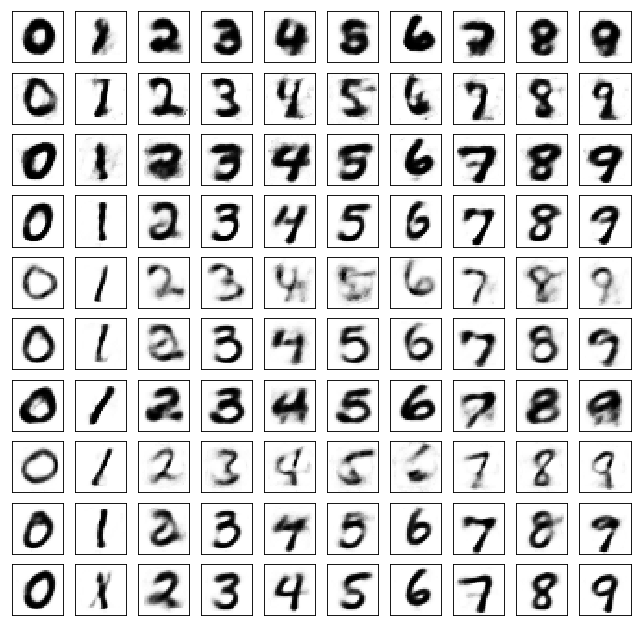

	reconstruction


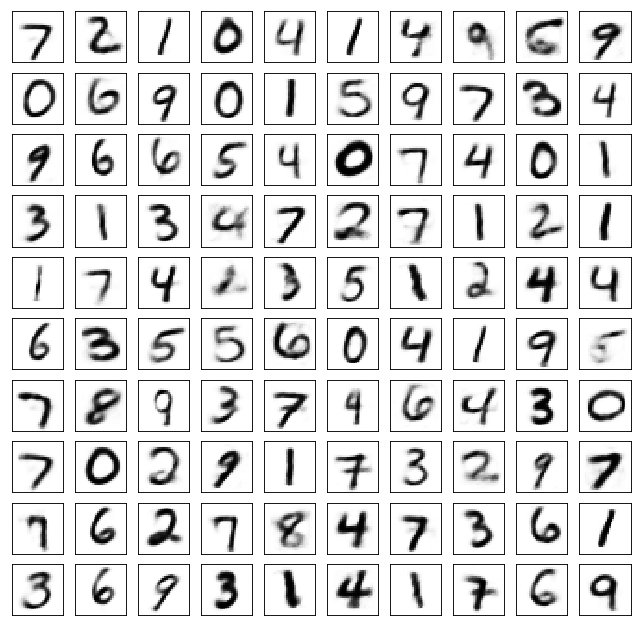

Test losses. E: 0.6985, AE: 0.0745, D: 0.6939
Train Epoch: 95 [0/50000 (0%)]	Losses E: 0.7067, AE: 0.0655, D: 0.6939
Train Epoch: 95 [25000/50000 (50%)]	Losses E: 0.7141, AE: 0.0655, D: 0.6942
Train Epoch: 95 [50000/50000 (100%)]	Losses E: 0.6730, AE: 0.0624, D: 0.6909
	generation


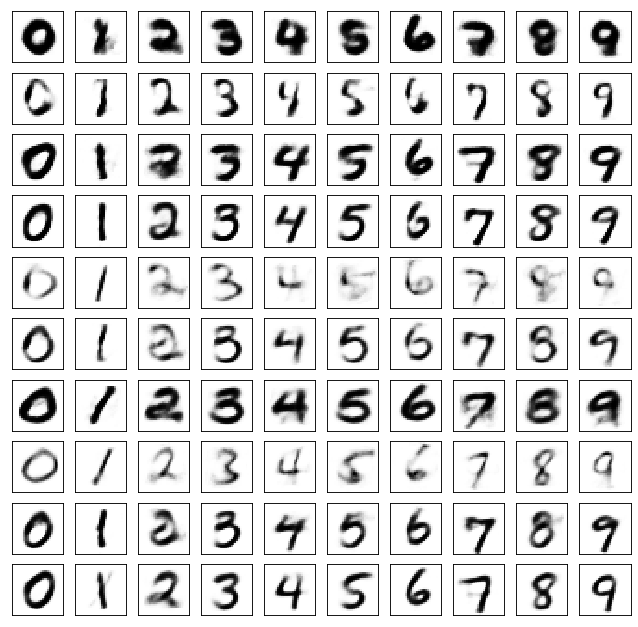

	reconstruction


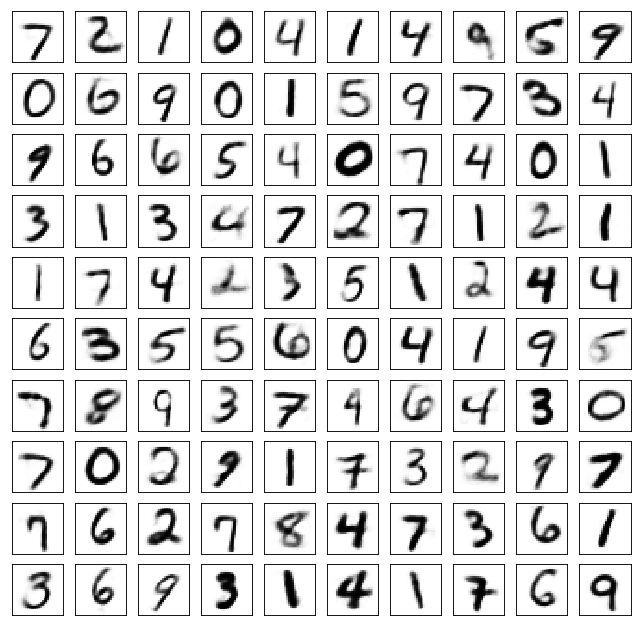

Test losses. E: 0.6702, AE: 0.0660, D: 0.6918
Train Epoch: 100 [0/50000 (0%)]	Losses E: 0.6810, AE: 0.0653, D: 0.6989
Train Epoch: 100 [25000/50000 (50%)]	Losses E: 0.7042, AE: 0.0618, D: 0.6925
Train Epoch: 100 [50000/50000 (100%)]	Losses E: 0.7054, AE: 0.0620, D: 0.6920
	generation


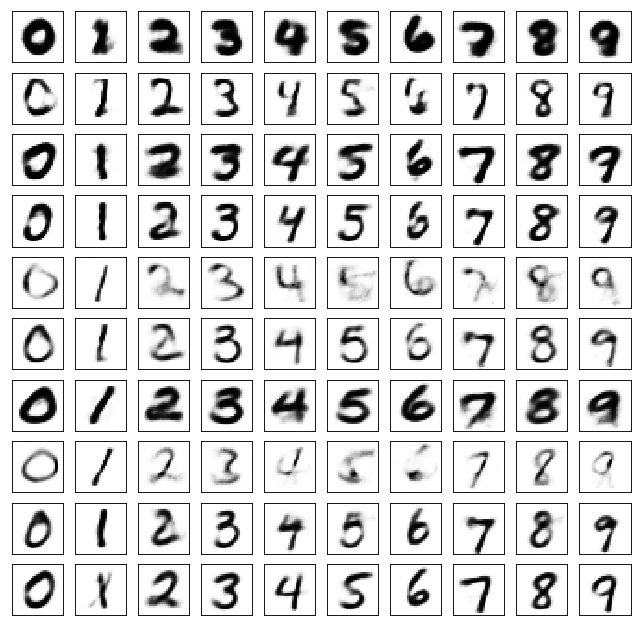

	reconstruction


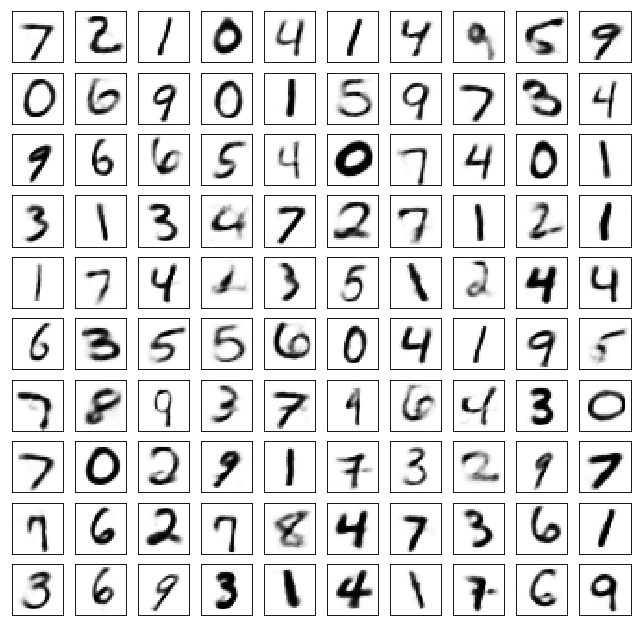

Test losses. E: 0.7057, AE: 0.0637, D: 0.6929
Train Epoch: 105 [0/50000 (0%)]	Losses E: 0.7034, AE: 0.0725, D: 0.6976
Train Epoch: 105 [25000/50000 (50%)]	Losses E: 0.7014, AE: 0.0637, D: 0.6911
Train Epoch: 105 [50000/50000 (100%)]	Losses E: 0.7062, AE: 0.0624, D: 0.6928
	generation


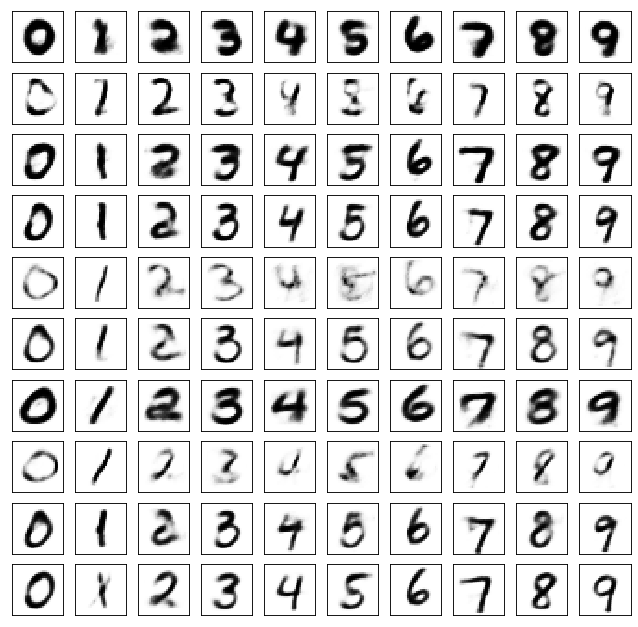

	reconstruction


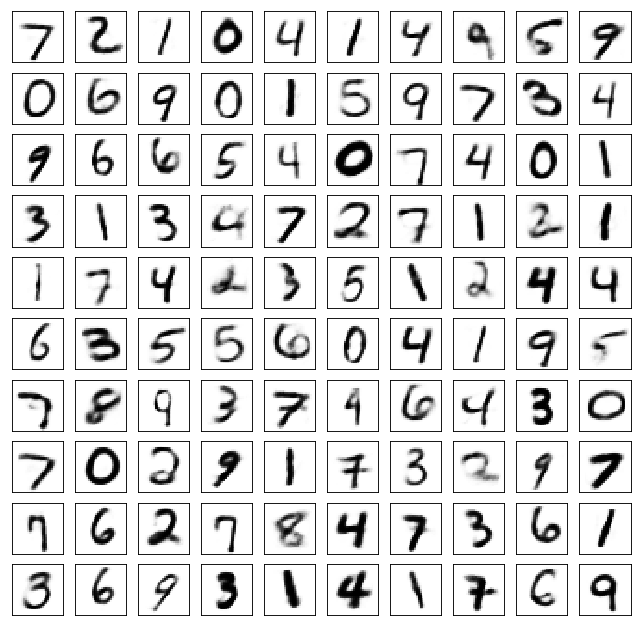

Test losses. E: 0.7039, AE: 0.0647, D: 0.6924
Train Epoch: 110 [0/50000 (0%)]	Losses E: 0.7131, AE: 0.0552, D: 0.6905
Train Epoch: 110 [25000/50000 (50%)]	Losses E: 0.6936, AE: 0.0497, D: 0.6919
Train Epoch: 110 [50000/50000 (100%)]	Losses E: 0.6775, AE: 0.0595, D: 0.6948
	generation


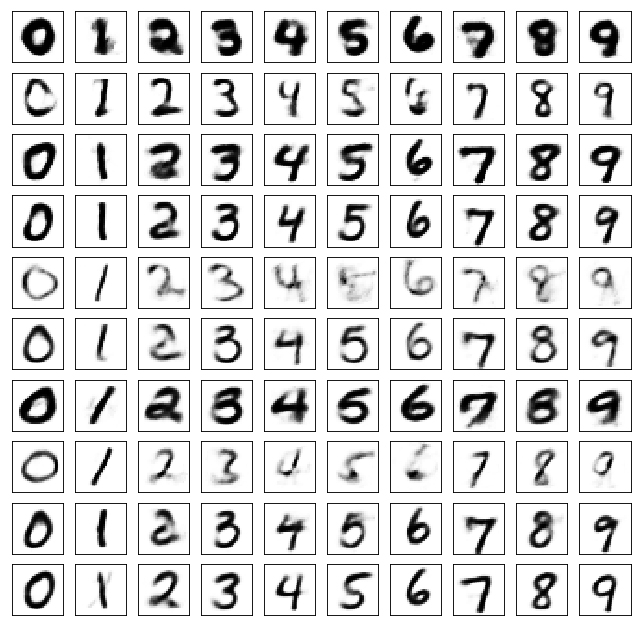

	reconstruction


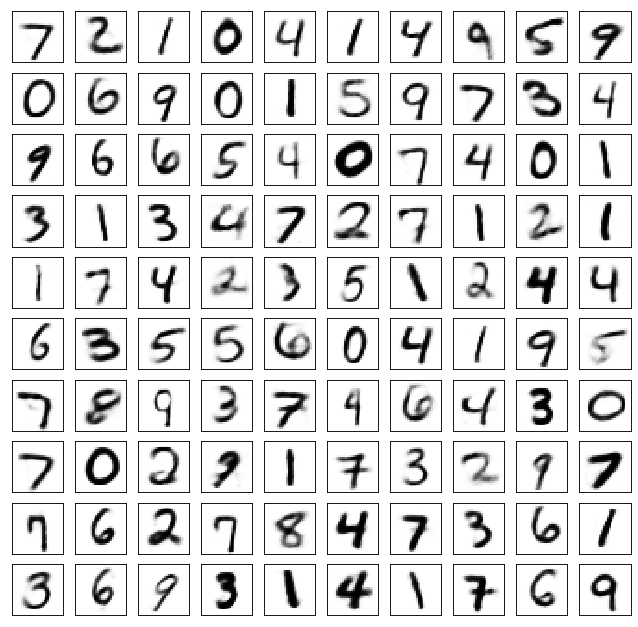

Test losses. E: 0.6768, AE: 0.0611, D: 0.6938
Train Epoch: 115 [0/50000 (0%)]	Losses E: 0.6895, AE: 0.0551, D: 0.6923
Train Epoch: 115 [25000/50000 (50%)]	Losses E: 0.6862, AE: 0.0569, D: 0.6946
Train Epoch: 115 [50000/50000 (100%)]	Losses E: 0.6961, AE: 0.0562, D: 0.6929
	generation


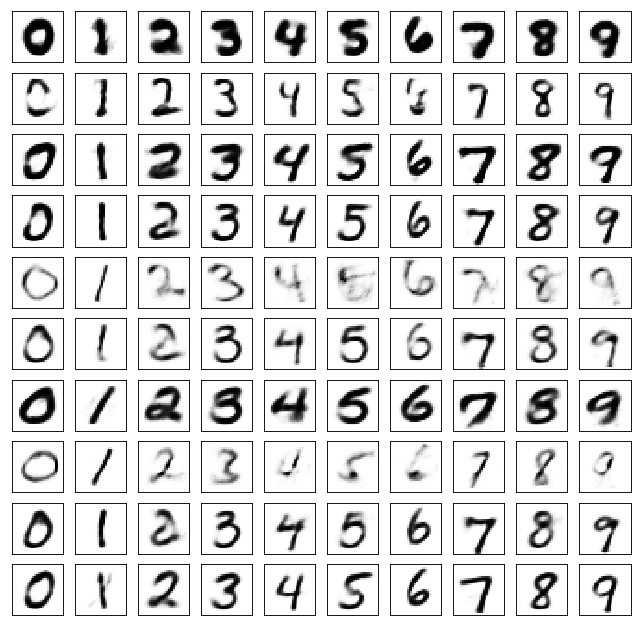

	reconstruction


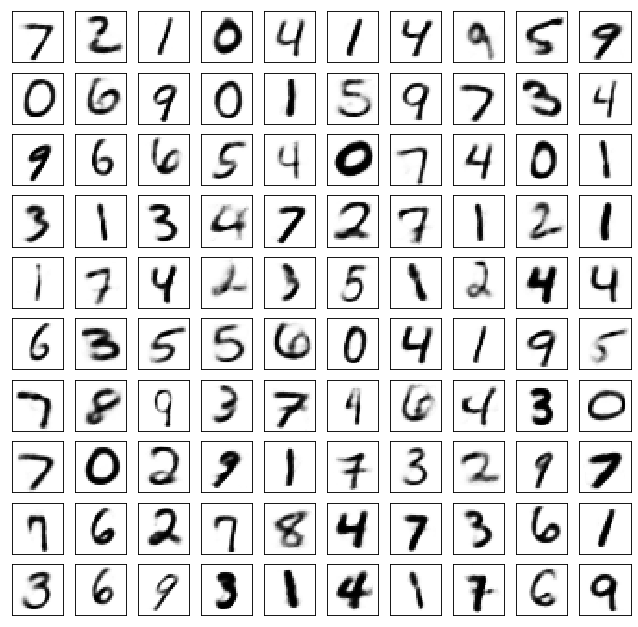

Test losses. E: 0.6980, AE: 0.0583, D: 0.6922
Train Epoch: 120 [0/50000 (0%)]	Losses E: 0.6901, AE: 0.0544, D: 0.6931
Train Epoch: 120 [25000/50000 (50%)]	Losses E: 0.7001, AE: 0.0536, D: 0.6945
Train Epoch: 120 [50000/50000 (100%)]	Losses E: 0.6848, AE: 0.0521, D: 0.6918
	generation


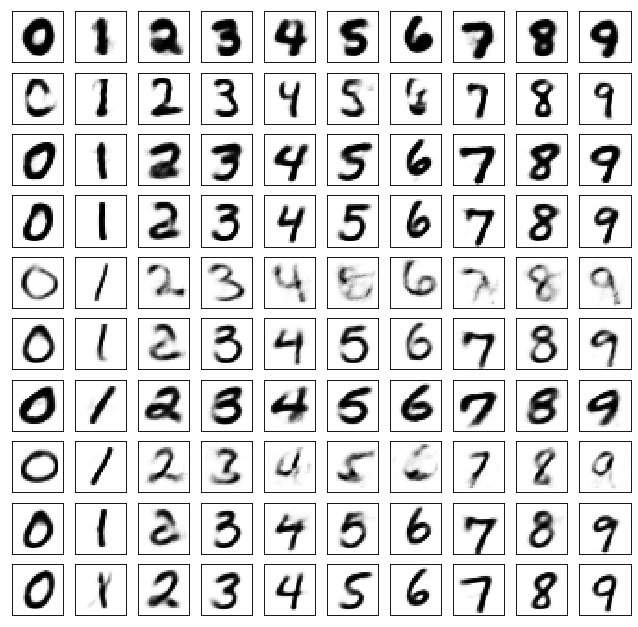

	reconstruction


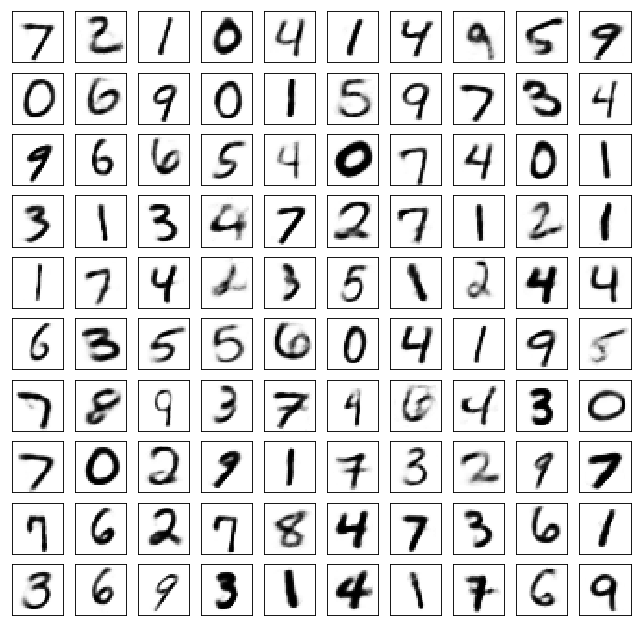

Test losses. E: 0.6850, AE: 0.0584, D: 0.6939
Train Epoch: 125 [0/50000 (0%)]	Losses E: 0.6856, AE: 0.0525, D: 0.6936
Train Epoch: 125 [25000/50000 (50%)]	Losses E: 0.6729, AE: 0.0555, D: 0.6922
Train Epoch: 125 [50000/50000 (100%)]	Losses E: 0.6799, AE: 0.0494, D: 0.6904
	generation


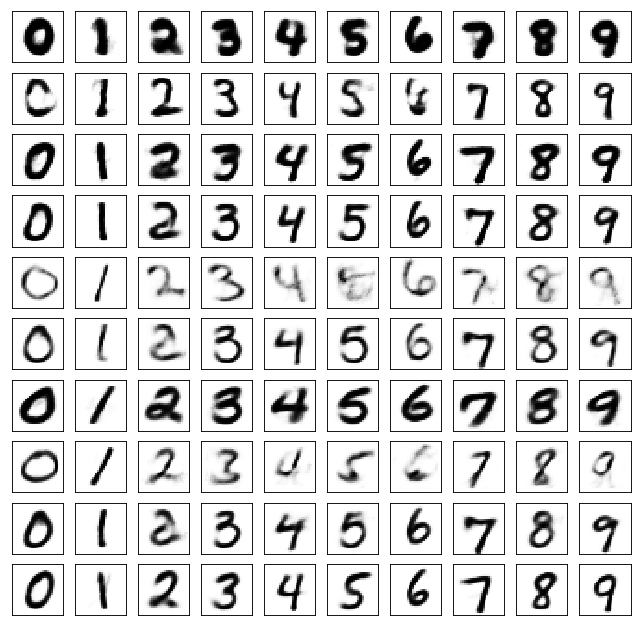

	reconstruction


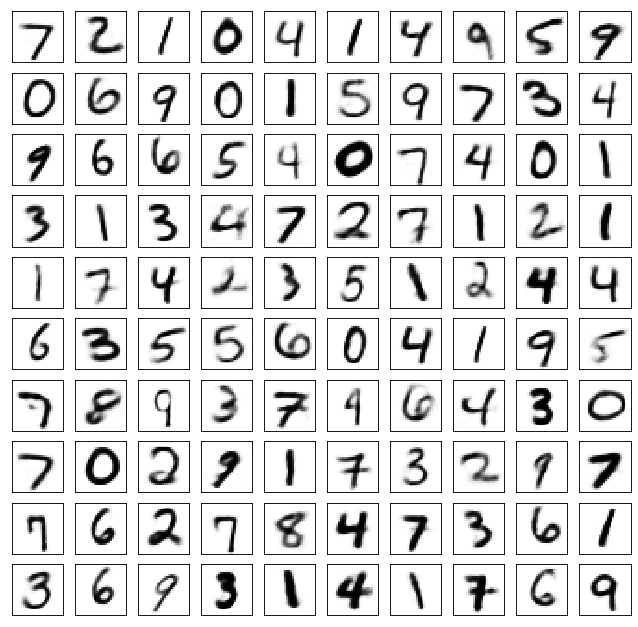

Test losses. E: 0.6802, AE: 0.0555, D: 0.6921
Train Epoch: 130 [0/50000 (0%)]	Losses E: 0.6852, AE: 0.0504, D: 0.6922
Train Epoch: 130 [25000/50000 (50%)]	Losses E: 0.6880, AE: 0.0490, D: 0.6927
Train Epoch: 130 [50000/50000 (100%)]	Losses E: 0.6937, AE: 0.0521, D: 0.6908
	generation


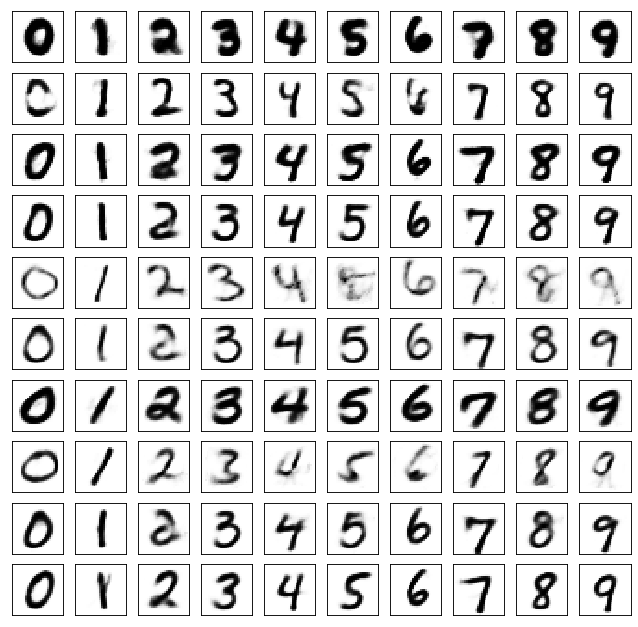

	reconstruction


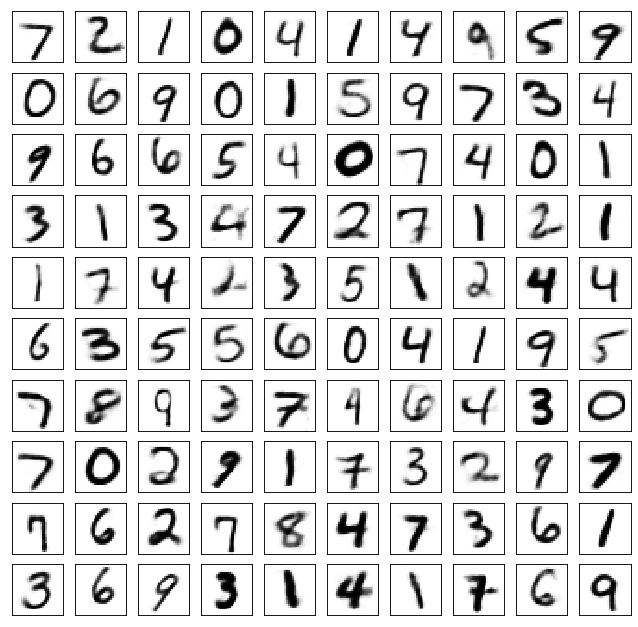

Test losses. E: 0.6941, AE: 0.0542, D: 0.6913
Train Epoch: 135 [0/50000 (0%)]	Losses E: 0.6890, AE: 0.0533, D: 0.6935
Train Epoch: 135 [25000/50000 (50%)]	Losses E: 0.6923, AE: 0.0471, D: 0.6940
Train Epoch: 135 [50000/50000 (100%)]	Losses E: 0.6913, AE: 0.0489, D: 0.6924
	generation


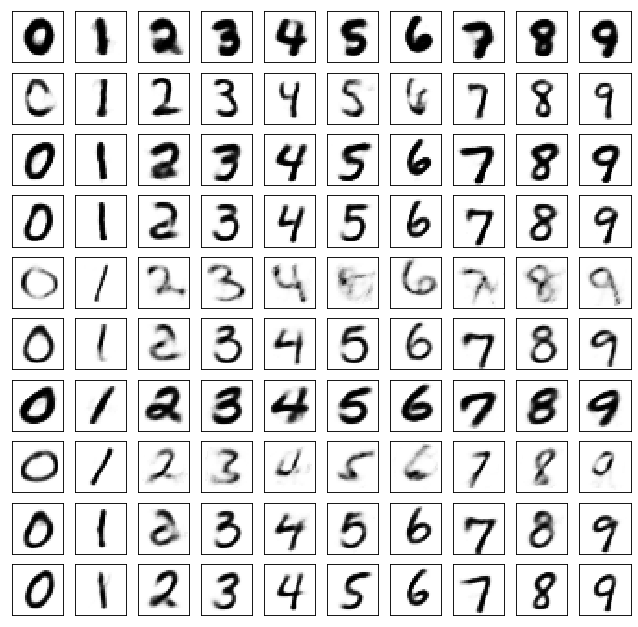

	reconstruction


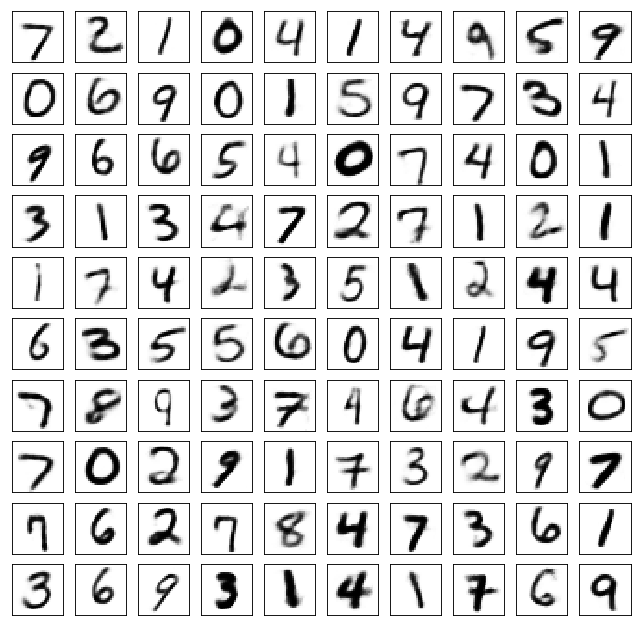

Test losses. E: 0.6901, AE: 0.0542, D: 0.6929
Train Epoch: 140 [0/50000 (0%)]	Losses E: 0.6846, AE: 0.0489, D: 0.6925
Train Epoch: 140 [25000/50000 (50%)]	Losses E: 0.6807, AE: 0.0524, D: 0.6950
Train Epoch: 140 [50000/50000 (100%)]	Losses E: 0.6907, AE: 0.0461, D: 0.6928
	generation


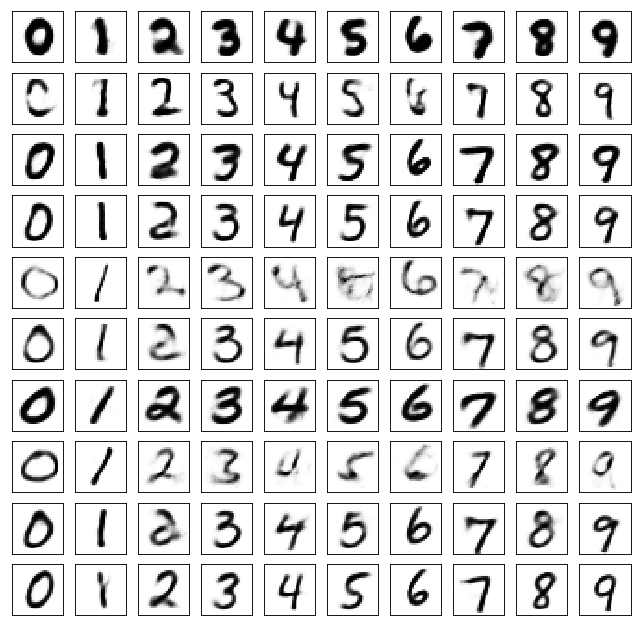

	reconstruction


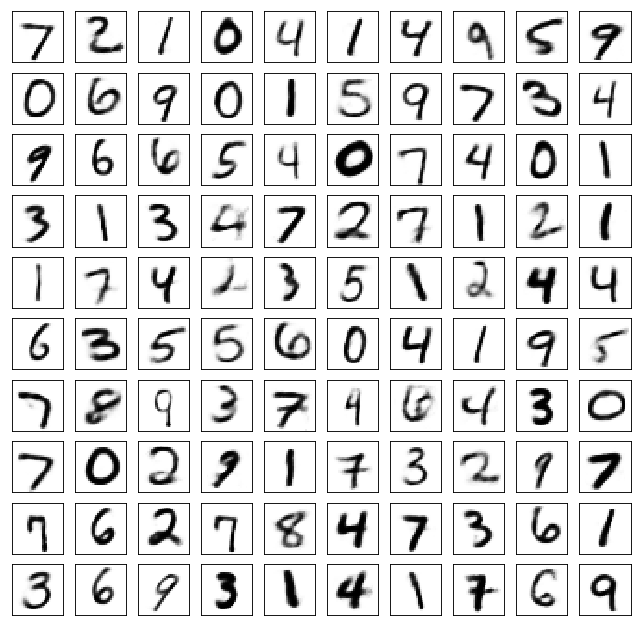

Test losses. E: 0.6903, AE: 0.0526, D: 0.6918
Train Epoch: 145 [0/50000 (0%)]	Losses E: 0.6847, AE: 0.0454, D: 0.6931
Train Epoch: 145 [25000/50000 (50%)]	Losses E: 0.6913, AE: 0.0491, D: 0.6930
Train Epoch: 145 [50000/50000 (100%)]	Losses E: 0.6856, AE: 0.0482, D: 0.6947
	generation


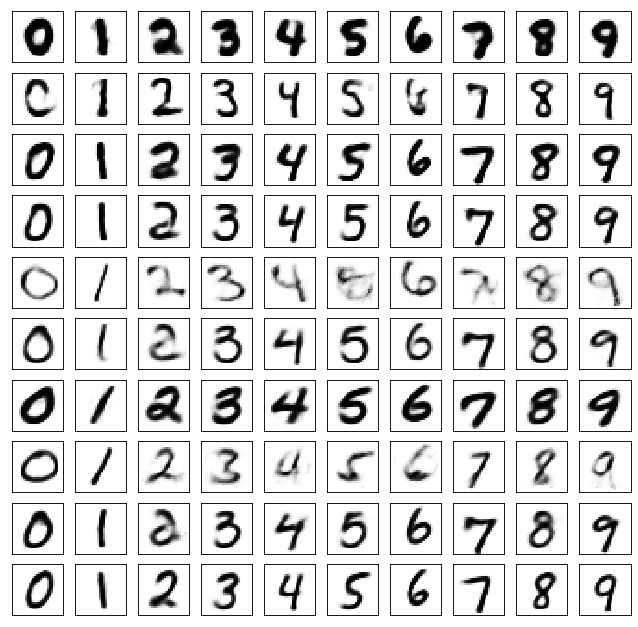

	reconstruction


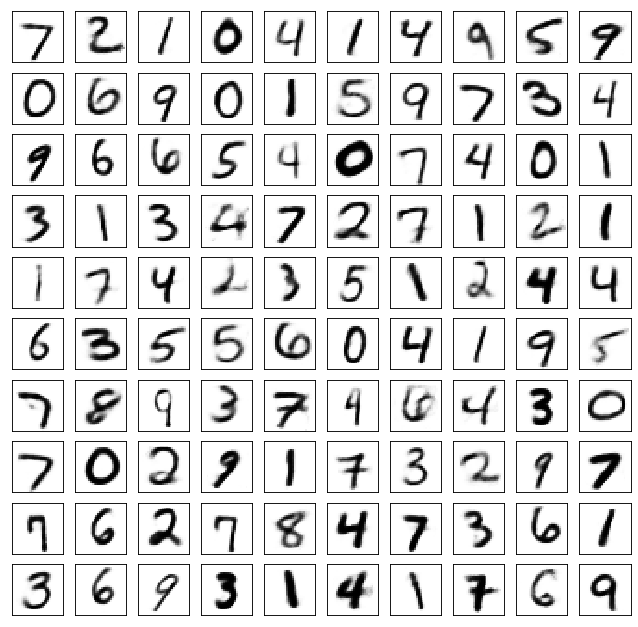

Test losses. E: 0.6869, AE: 0.0521, D: 0.6920
Train Epoch: 150 [0/50000 (0%)]	Losses E: 0.6977, AE: 0.0477, D: 0.6936
Train Epoch: 150 [25000/50000 (50%)]	Losses E: 0.7013, AE: 0.0487, D: 0.6949
Train Epoch: 150 [50000/50000 (100%)]	Losses E: 0.6911, AE: 0.0461, D: 0.6919
	generation


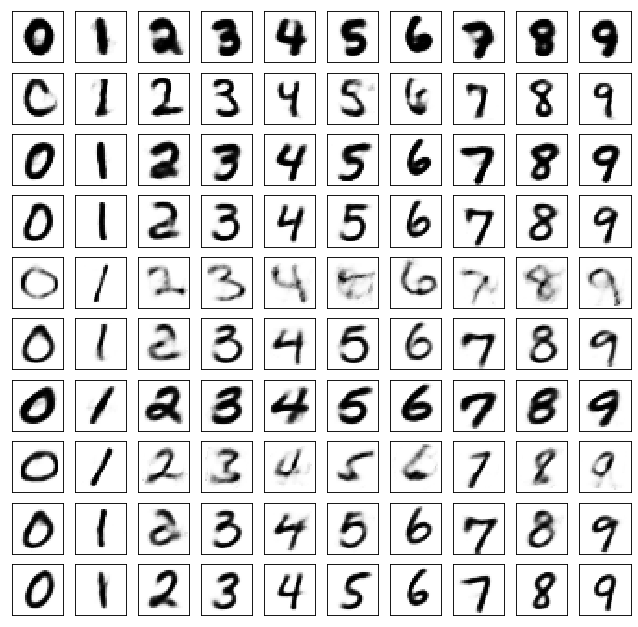

	reconstruction


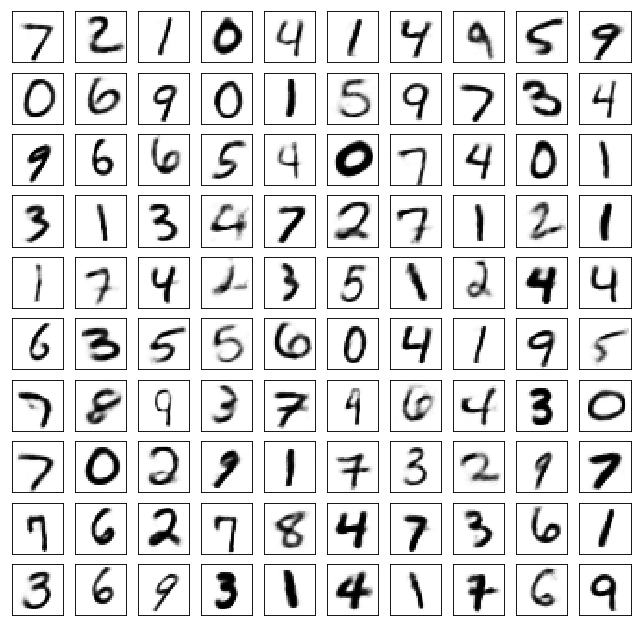

Test losses. E: 0.6873, AE: 0.0524, D: 0.6926
Train Epoch: 155 [0/50000 (0%)]	Losses E: 0.6931, AE: 0.0450, D: 0.6936
Train Epoch: 155 [25000/50000 (50%)]	Losses E: 0.7027, AE: 0.0473, D: 0.6908
Train Epoch: 155 [50000/50000 (100%)]	Losses E: 0.6905, AE: 0.0476, D: 0.6923
	generation


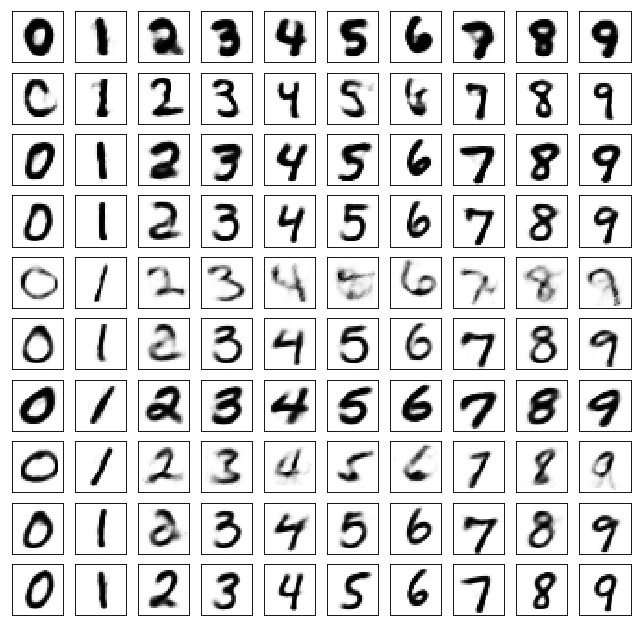

	reconstruction


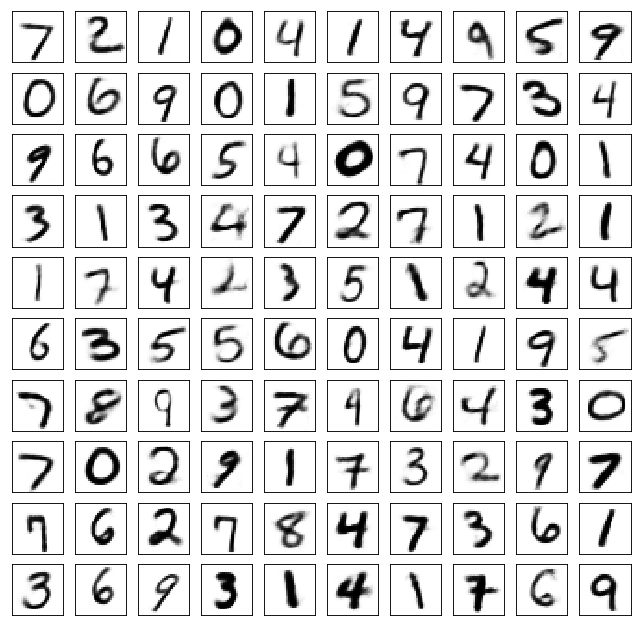

Test losses. E: 0.6892, AE: 0.0524, D: 0.6918
Train Epoch: 160 [0/50000 (0%)]	Losses E: 0.6944, AE: 0.0466, D: 0.6925
Train Epoch: 160 [25000/50000 (50%)]	Losses E: 0.6966, AE: 0.0470, D: 0.6926
Train Epoch: 160 [50000/50000 (100%)]	Losses E: 0.6897, AE: 0.0426, D: 0.6913
	generation


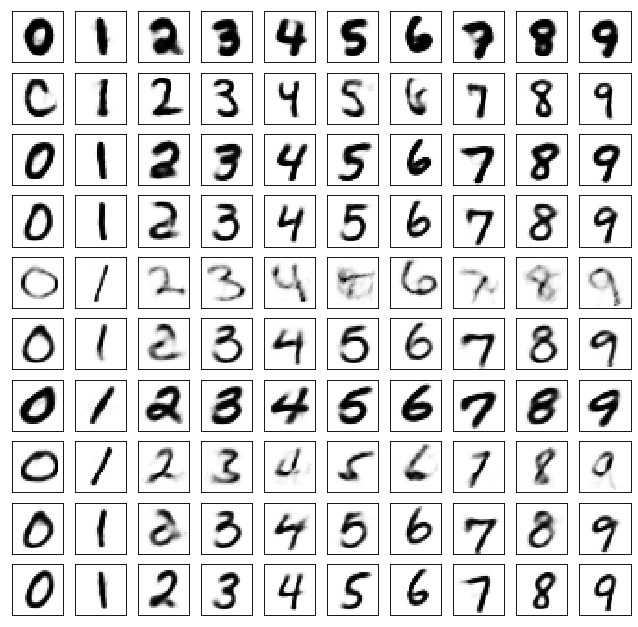

	reconstruction


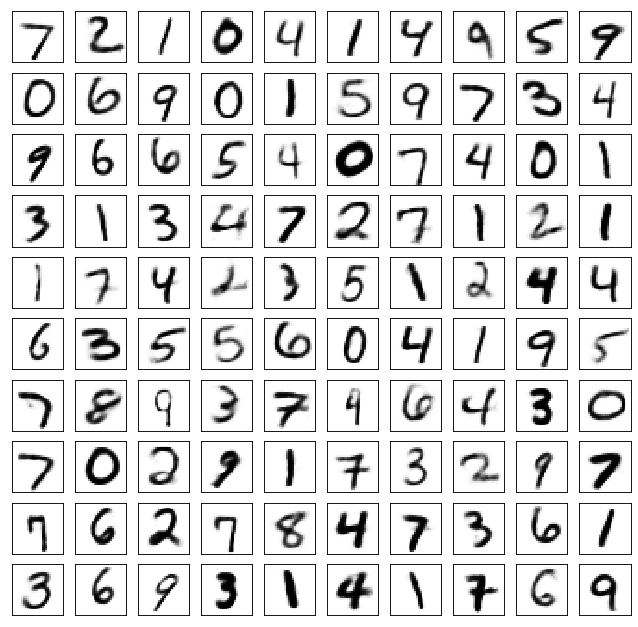

Test losses. E: 0.6883, AE: 0.0513, D: 0.6927
Train Epoch: 165 [0/50000 (0%)]	Losses E: 0.7004, AE: 0.0457, D: 0.6939
Train Epoch: 165 [25000/50000 (50%)]	Losses E: 0.6769, AE: 0.0442, D: 0.6960
Train Epoch: 165 [50000/50000 (100%)]	Losses E: 0.6901, AE: 0.0431, D: 0.6945
	generation


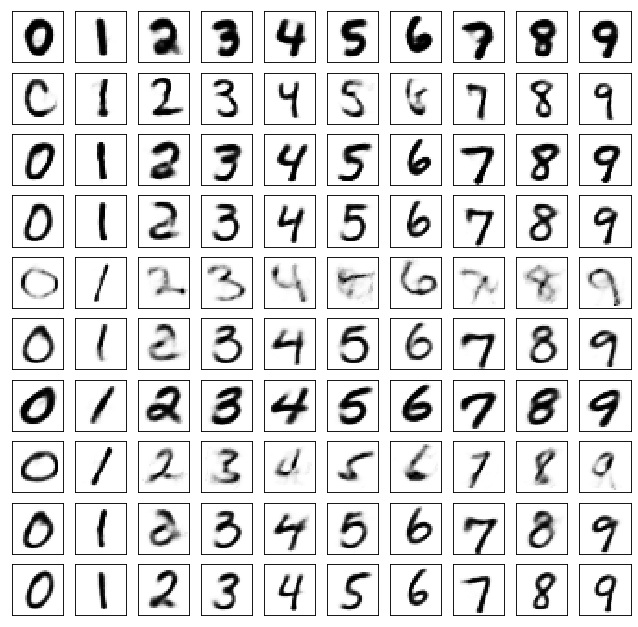

	reconstruction


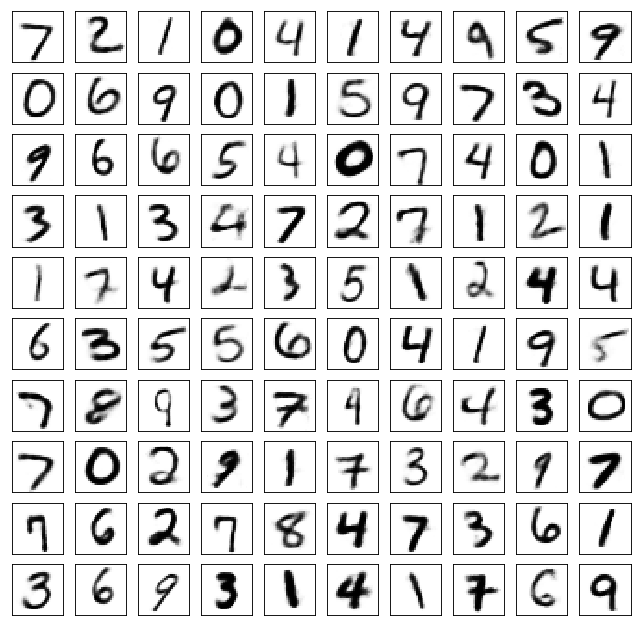

Test losses. E: 0.6882, AE: 0.0517, D: 0.6930
Train Epoch: 170 [0/50000 (0%)]	Losses E: 0.7001, AE: 0.0464, D: 0.6952
Train Epoch: 170 [25000/50000 (50%)]	Losses E: 0.6865, AE: 0.0454, D: 0.6934
Train Epoch: 170 [50000/50000 (100%)]	Losses E: 0.6839, AE: 0.0469, D: 0.6964
	generation


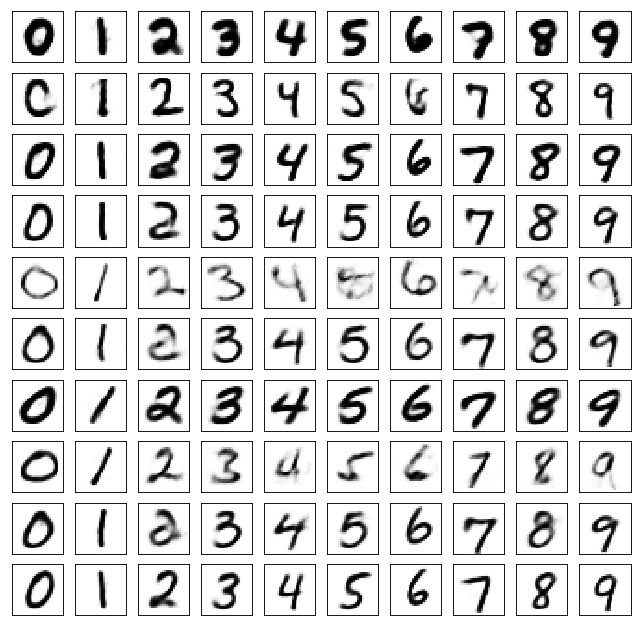

	reconstruction


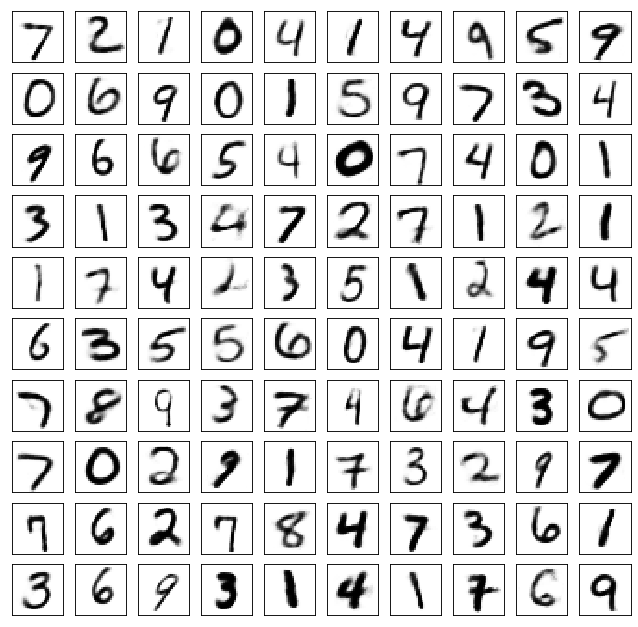

Test losses. E: 0.6862, AE: 0.0502, D: 0.6930
Train Epoch: 175 [0/50000 (0%)]	Losses E: 0.7087, AE: 0.0367, D: 0.6888
Train Epoch: 175 [25000/50000 (50%)]	Losses E: 0.6945, AE: 0.0415, D: 0.6909
Train Epoch: 175 [50000/50000 (100%)]	Losses E: 0.6984, AE: 0.0450, D: 0.6918
	generation


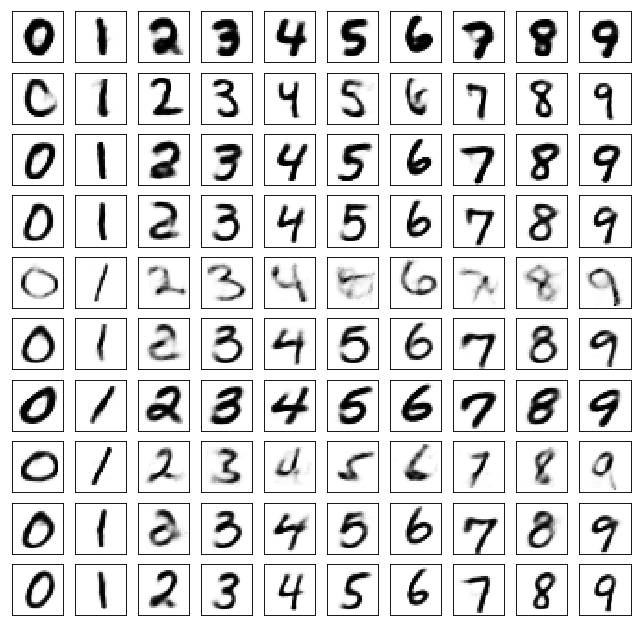

	reconstruction


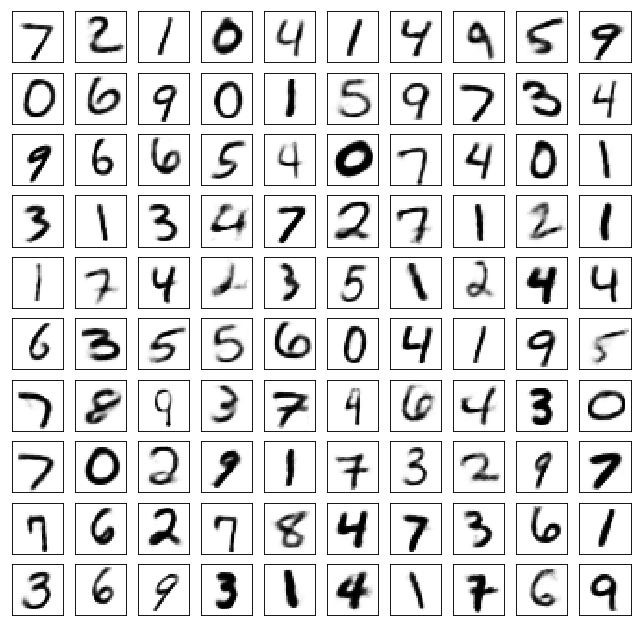

Test losses. E: 0.6999, AE: 0.0498, D: 0.6920
Train Epoch: 180 [0/50000 (0%)]	Losses E: 0.6857, AE: 0.0419, D: 0.6925
Train Epoch: 180 [25000/50000 (50%)]	Losses E: 0.6896, AE: 0.0411, D: 0.6936
Train Epoch: 180 [50000/50000 (100%)]	Losses E: 0.6961, AE: 0.0455, D: 0.6914
	generation


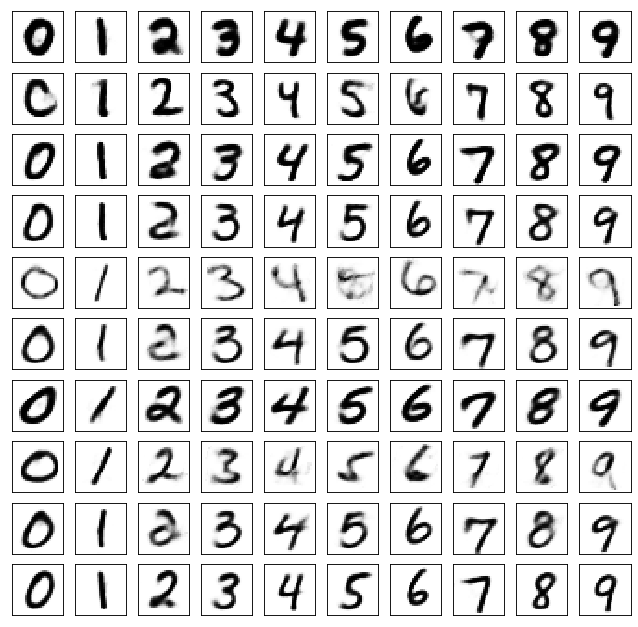

	reconstruction


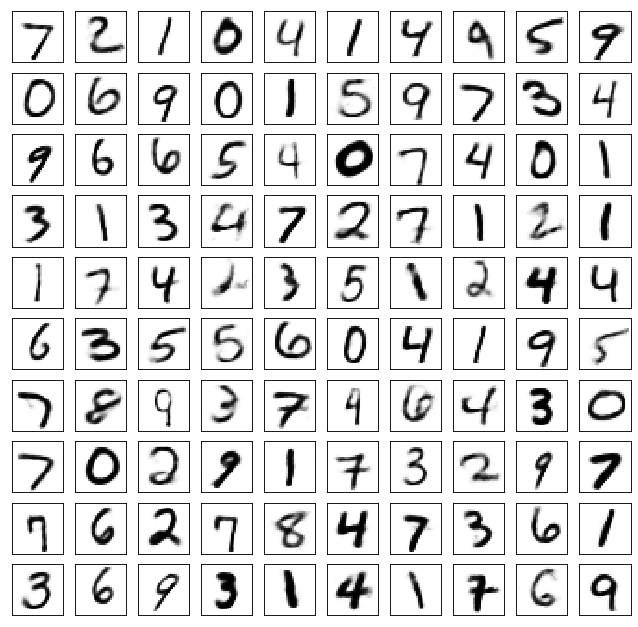

Test losses. E: 0.6974, AE: 0.0502, D: 0.6934
Train Epoch: 185 [0/50000 (0%)]	Losses E: 0.6937, AE: 0.0416, D: 0.6951
Train Epoch: 185 [25000/50000 (50%)]	Losses E: 0.7021, AE: 0.0427, D: 0.6927
Train Epoch: 185 [50000/50000 (100%)]	Losses E: 0.7028, AE: 0.0416, D: 0.6923
	generation


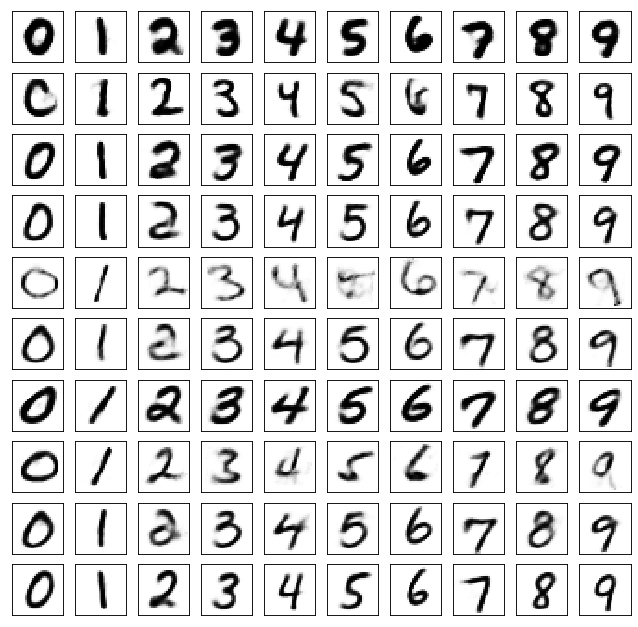

	reconstruction


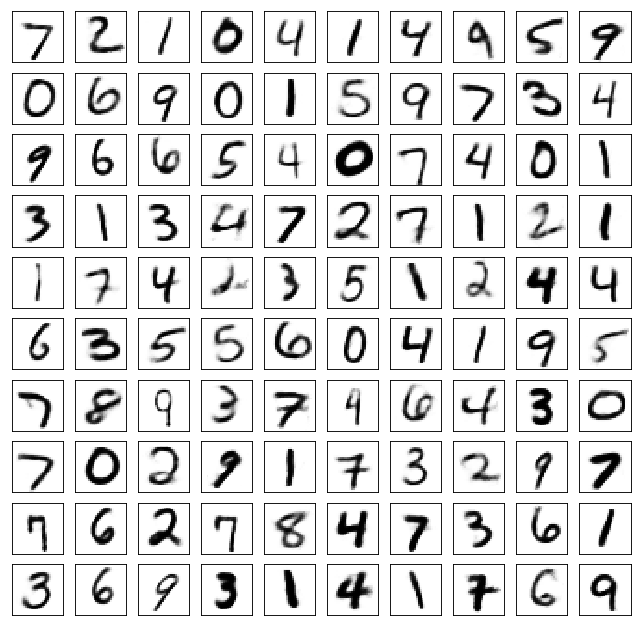

Test losses. E: 0.7012, AE: 0.0491, D: 0.6923
Train Epoch: 190 [0/50000 (0%)]	Losses E: 0.6850, AE: 0.0397, D: 0.6914
Train Epoch: 190 [25000/50000 (50%)]	Losses E: 0.6997, AE: 0.0432, D: 0.6939
Train Epoch: 190 [50000/50000 (100%)]	Losses E: 0.6908, AE: 0.0394, D: 0.6926
	generation


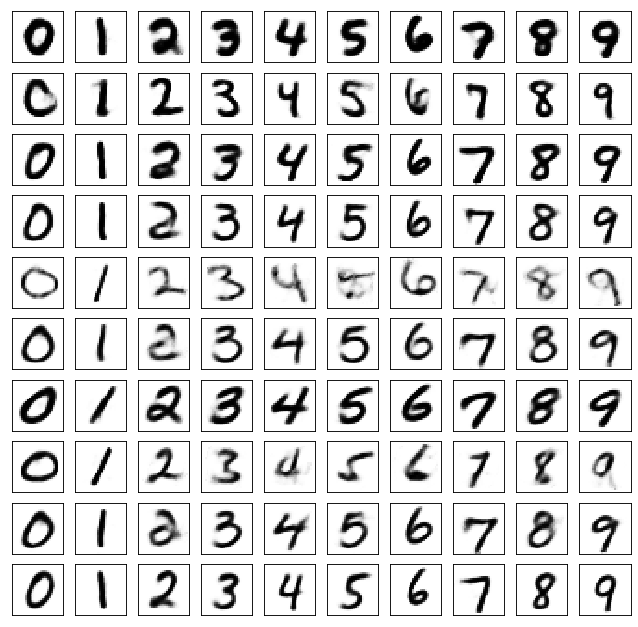

	reconstruction


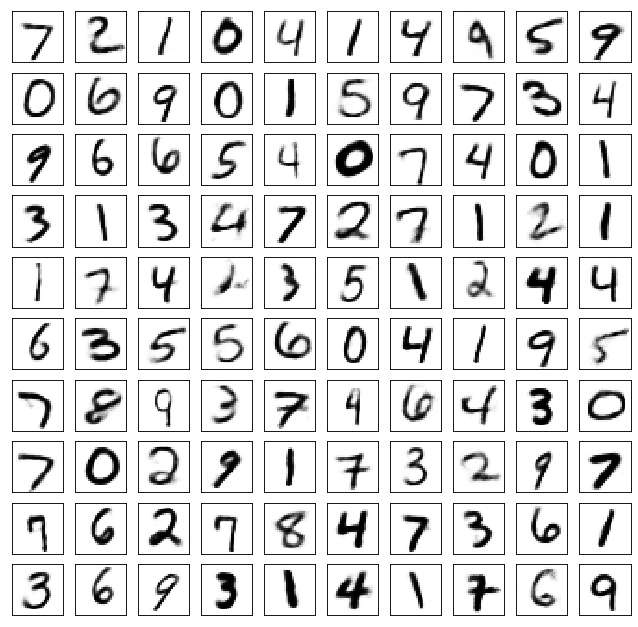

Test losses. E: 0.6907, AE: 0.0498, D: 0.6928
Train Epoch: 195 [0/50000 (0%)]	Losses E: 0.6895, AE: 0.0414, D: 0.6928
Train Epoch: 195 [25000/50000 (50%)]	Losses E: 0.6943, AE: 0.0386, D: 0.6913
Train Epoch: 195 [50000/50000 (100%)]	Losses E: 0.7014, AE: 0.0402, D: 0.6919
	generation


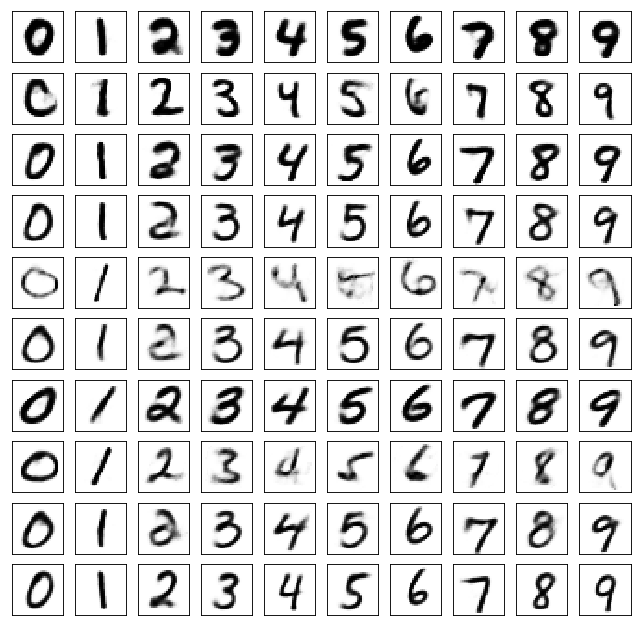

	reconstruction


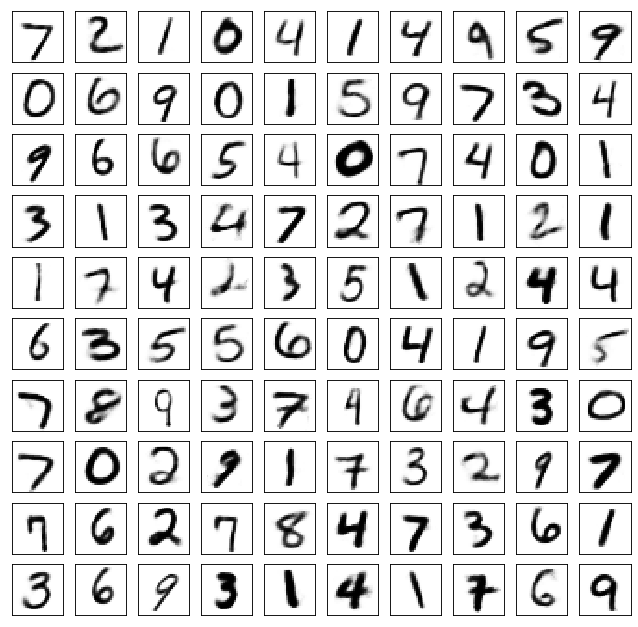

Test losses. E: 0.6998, AE: 0.0489, D: 0.6923
Train Epoch: 200 [0/50000 (0%)]	Losses E: 0.7055, AE: 0.0432, D: 0.6935
Train Epoch: 200 [25000/50000 (50%)]	Losses E: 0.6970, AE: 0.0421, D: 0.6926
Train Epoch: 200 [50000/50000 (100%)]	Losses E: 0.6878, AE: 0.0385, D: 0.6923
	generation


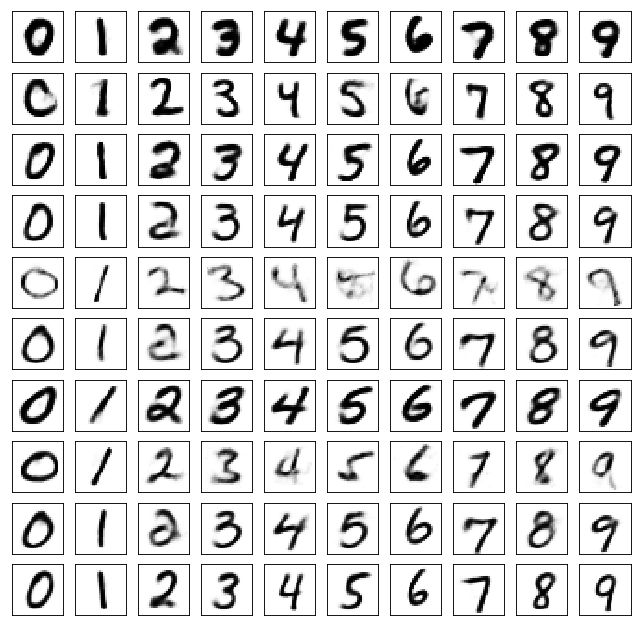

	reconstruction


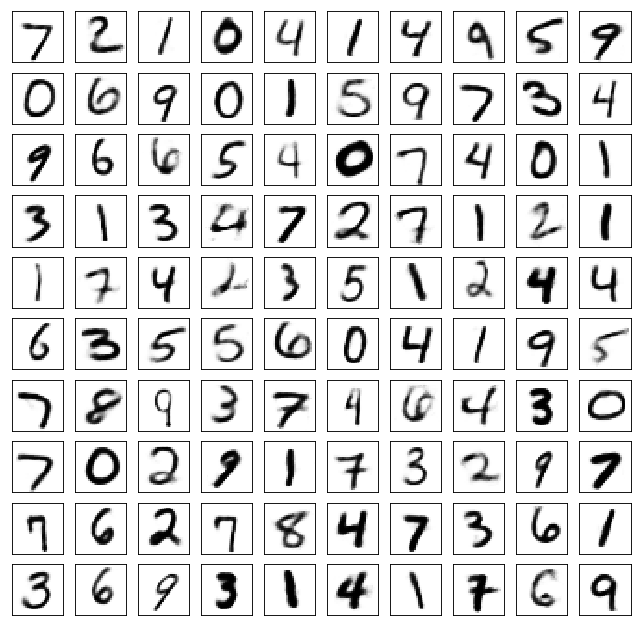

Test losses. E: 0.6898, AE: 0.0489, D: 0.6929
Train Epoch: 205 [0/50000 (0%)]	Losses E: 0.6885, AE: 0.0377, D: 0.6965
Train Epoch: 205 [25000/50000 (50%)]	Losses E: 0.6871, AE: 0.0389, D: 0.6904
Train Epoch: 205 [50000/50000 (100%)]	Losses E: 0.6971, AE: 0.0384, D: 0.6918
	generation


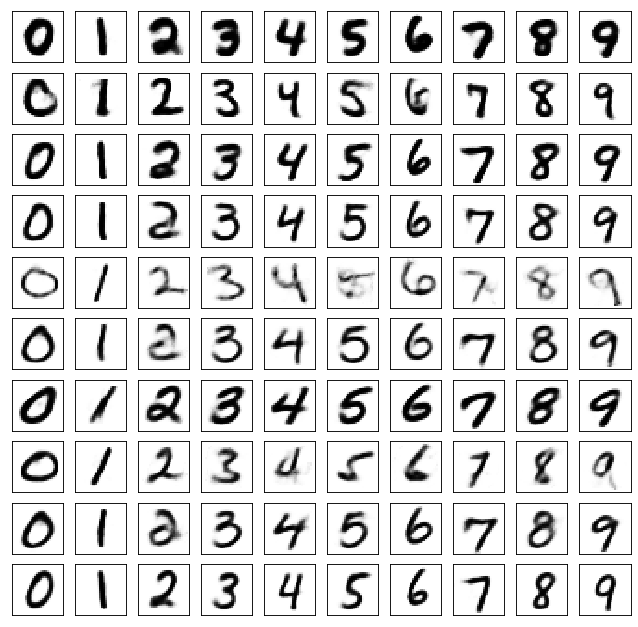

	reconstruction


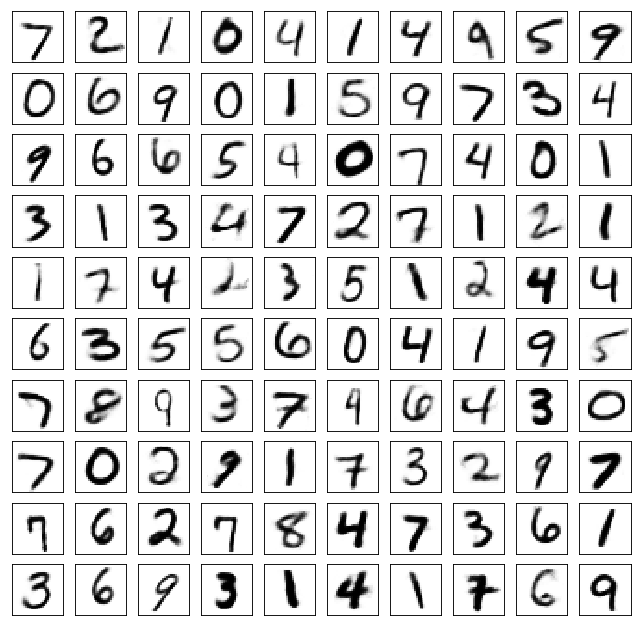

Test losses. E: 0.6952, AE: 0.0488, D: 0.6919
Train Epoch: 210 [0/50000 (0%)]	Losses E: 0.7013, AE: 0.0404, D: 0.6935
Train Epoch: 210 [25000/50000 (50%)]	Losses E: 0.6994, AE: 0.0395, D: 0.6934
Train Epoch: 210 [50000/50000 (100%)]	Losses E: 0.6856, AE: 0.0416, D: 0.6913
	generation


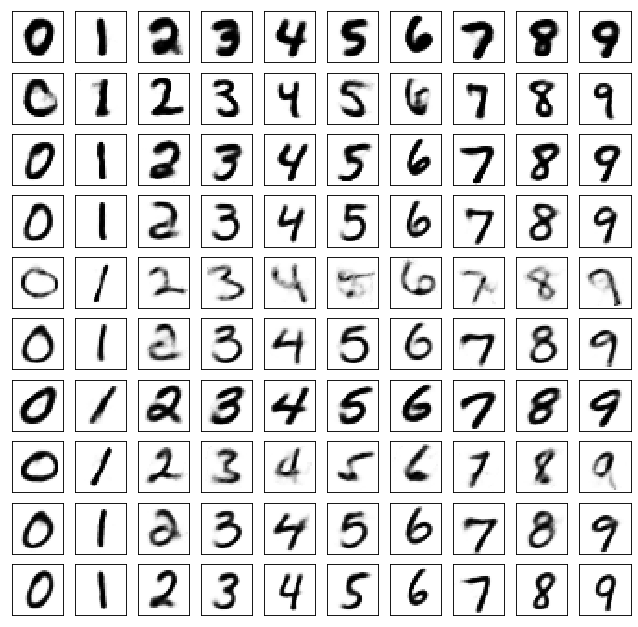

	reconstruction


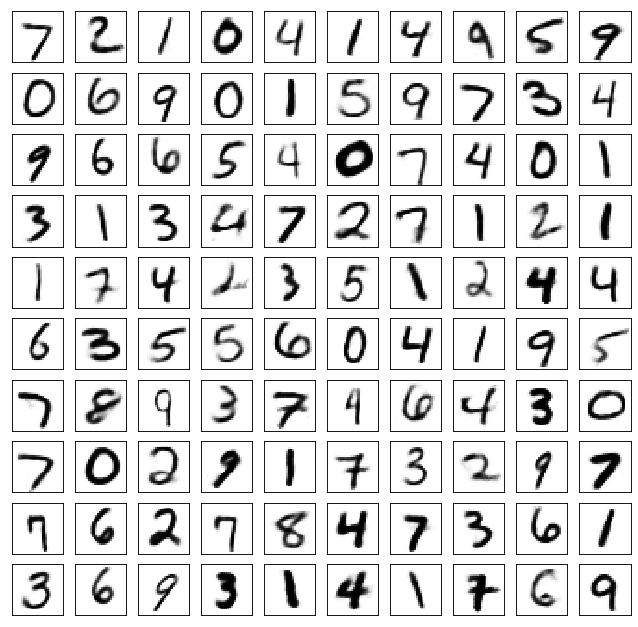

Test losses. E: 0.6839, AE: 0.0490, D: 0.6920
Train Epoch: 215 [0/50000 (0%)]	Losses E: 0.6878, AE: 0.0373, D: 0.6905
Train Epoch: 215 [25000/50000 (50%)]	Losses E: 0.6940, AE: 0.0395, D: 0.6902
Train Epoch: 215 [50000/50000 (100%)]	Losses E: 0.6931, AE: 0.0375, D: 0.6934
	generation


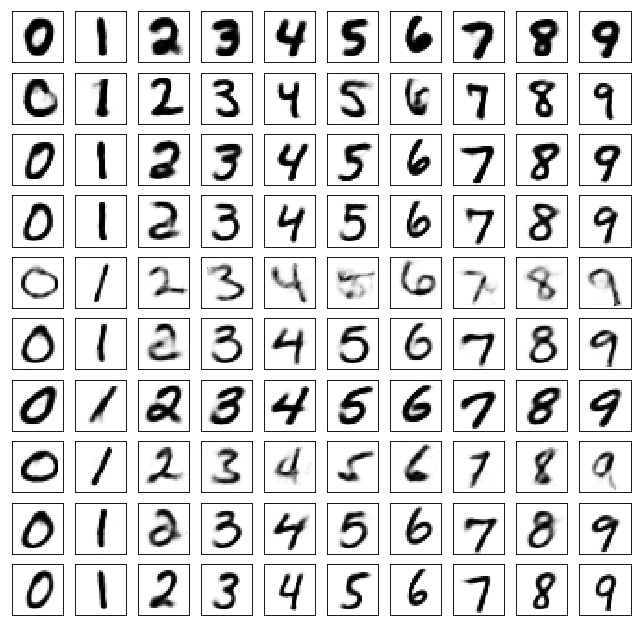

	reconstruction


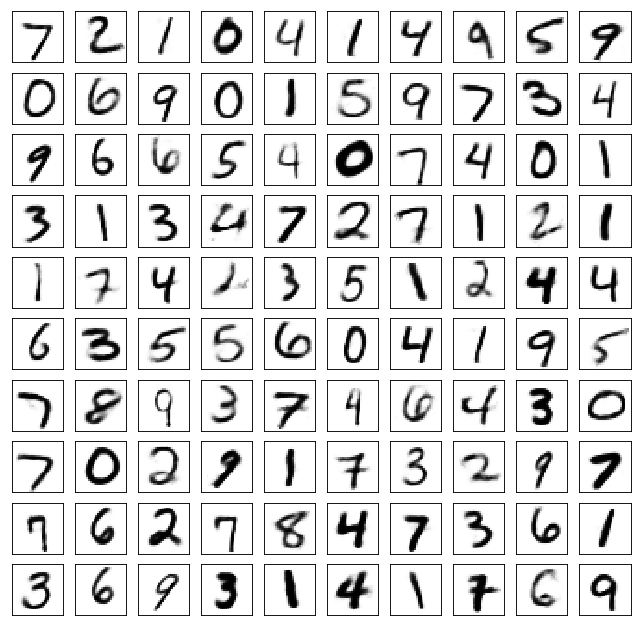

Test losses. E: 0.6927, AE: 0.0490, D: 0.6920
Train Epoch: 220 [0/50000 (0%)]	Losses E: 0.6933, AE: 0.0388, D: 0.6957
Train Epoch: 220 [25000/50000 (50%)]	Losses E: 0.6851, AE: 0.0371, D: 0.6924
Train Epoch: 220 [50000/50000 (100%)]	Losses E: 0.6917, AE: 0.0385, D: 0.6912
	generation


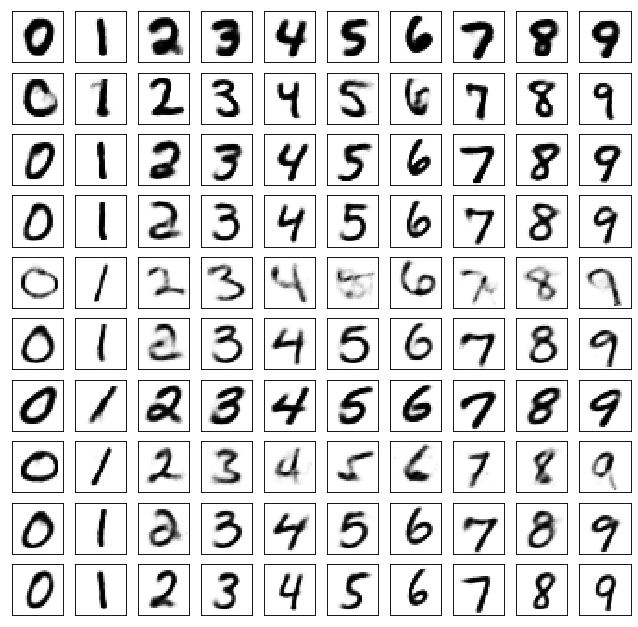

	reconstruction


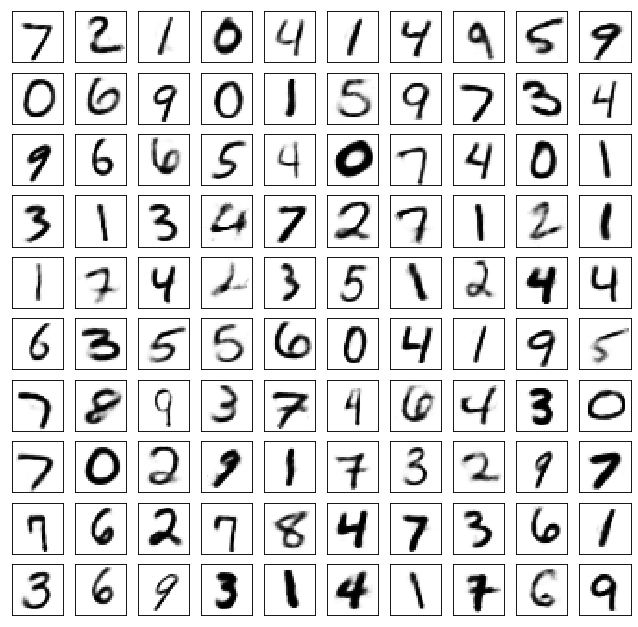

Test losses. E: 0.6904, AE: 0.0487, D: 0.6927
Train Epoch: 225 [0/50000 (0%)]	Losses E: 0.6907, AE: 0.0365, D: 0.6917
Train Epoch: 225 [25000/50000 (50%)]	Losses E: 0.6925, AE: 0.0379, D: 0.6927
Train Epoch: 225 [50000/50000 (100%)]	Losses E: 0.6858, AE: 0.0419, D: 0.6949
	generation


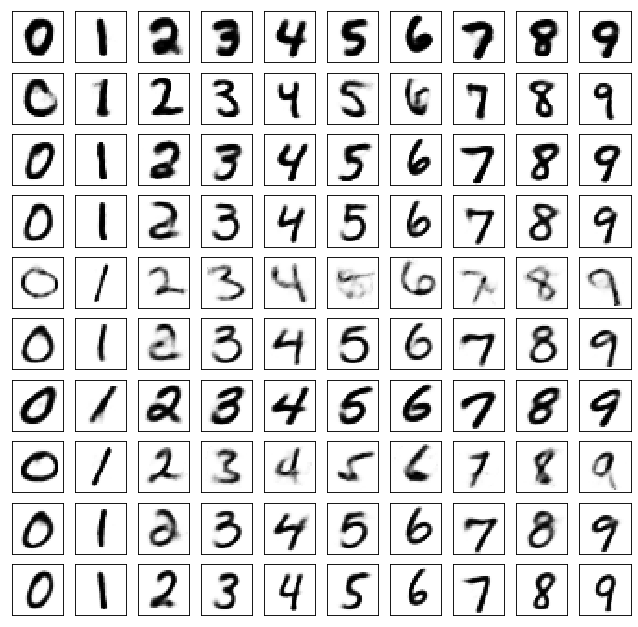

	reconstruction


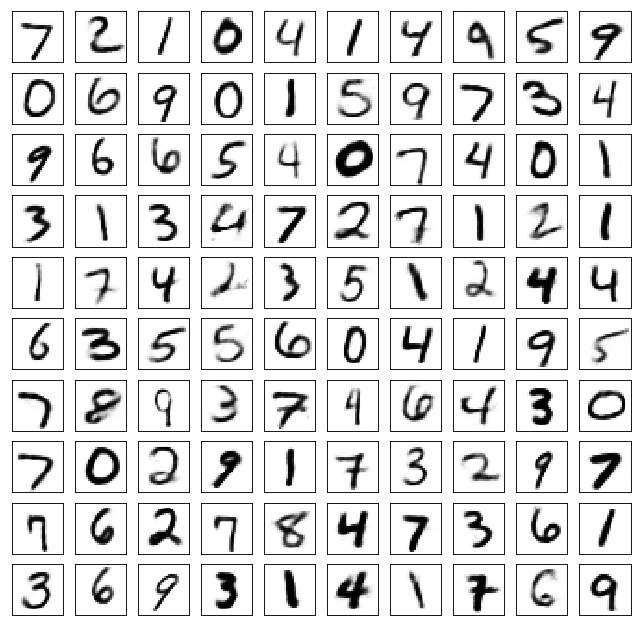

Test losses. E: 0.6878, AE: 0.0490, D: 0.6929
Train Epoch: 230 [0/50000 (0%)]	Losses E: 0.6886, AE: 0.0384, D: 0.6928
Train Epoch: 230 [25000/50000 (50%)]	Losses E: 0.6933, AE: 0.0372, D: 0.6910
Train Epoch: 230 [50000/50000 (100%)]	Losses E: 0.6881, AE: 0.0367, D: 0.6922
	generation


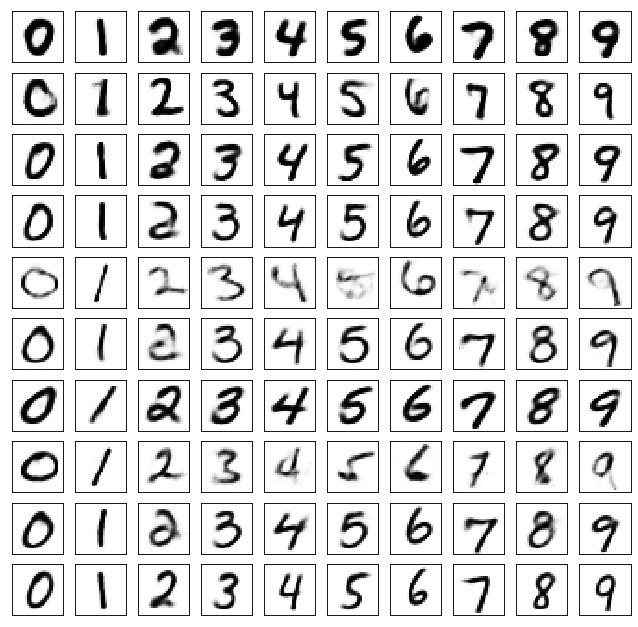

	reconstruction


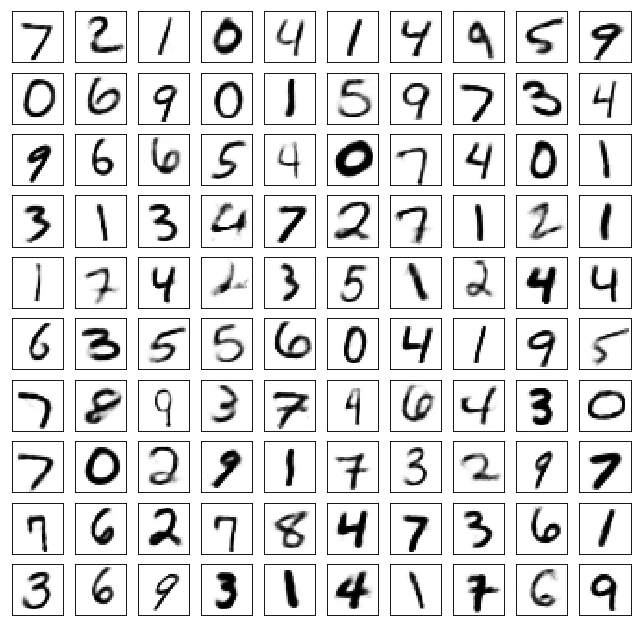

Test losses. E: 0.6892, AE: 0.0476, D: 0.6918
Train Epoch: 235 [0/50000 (0%)]	Losses E: 0.6933, AE: 0.0355, D: 0.6918
Train Epoch: 235 [25000/50000 (50%)]	Losses E: 0.6979, AE: 0.0354, D: 0.6937
Train Epoch: 235 [50000/50000 (100%)]	Losses E: 0.7011, AE: 0.0353, D: 0.6954
	generation


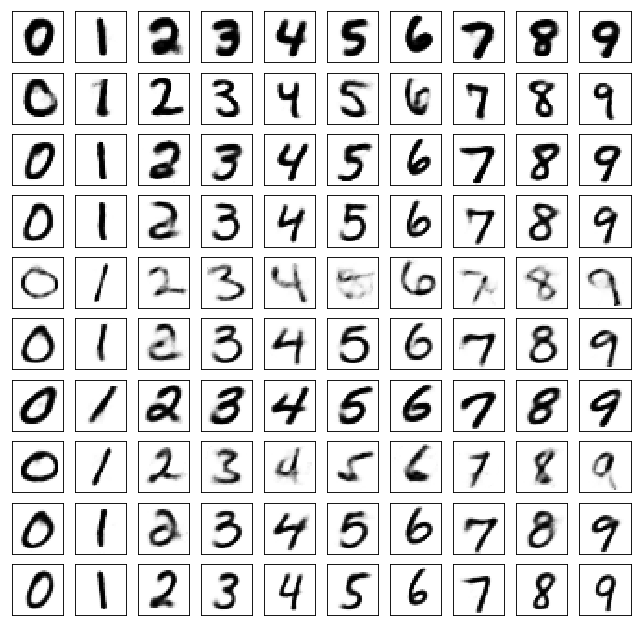

	reconstruction


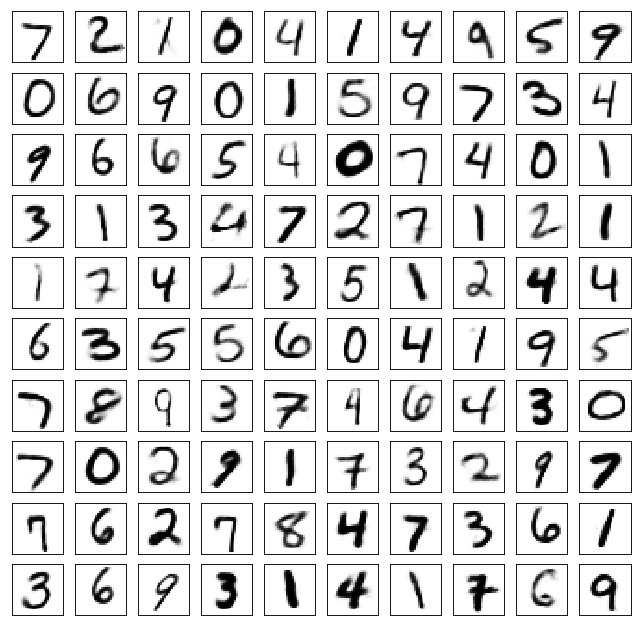

Test losses. E: 0.6977, AE: 0.0480, D: 0.6927
Train Epoch: 240 [0/50000 (0%)]	Losses E: 0.6859, AE: 0.0336, D: 0.6917
Train Epoch: 240 [25000/50000 (50%)]	Losses E: 0.6938, AE: 0.0396, D: 0.6931
Train Epoch: 240 [50000/50000 (100%)]	Losses E: 0.6927, AE: 0.0392, D: 0.6946
	generation


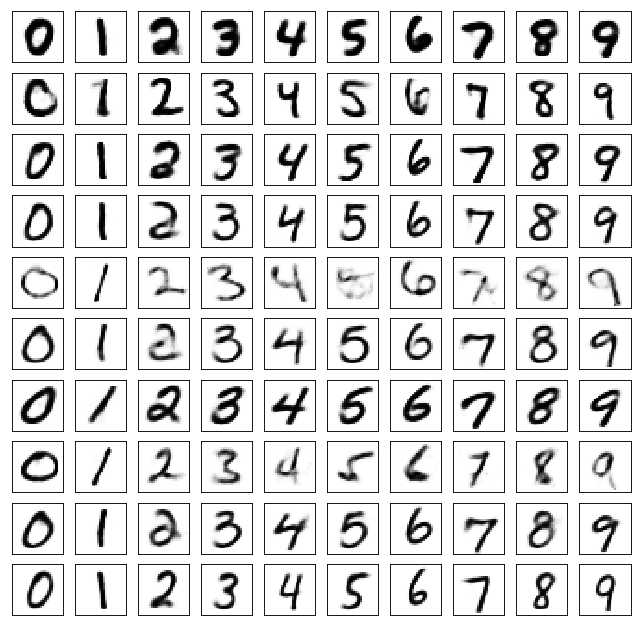

	reconstruction


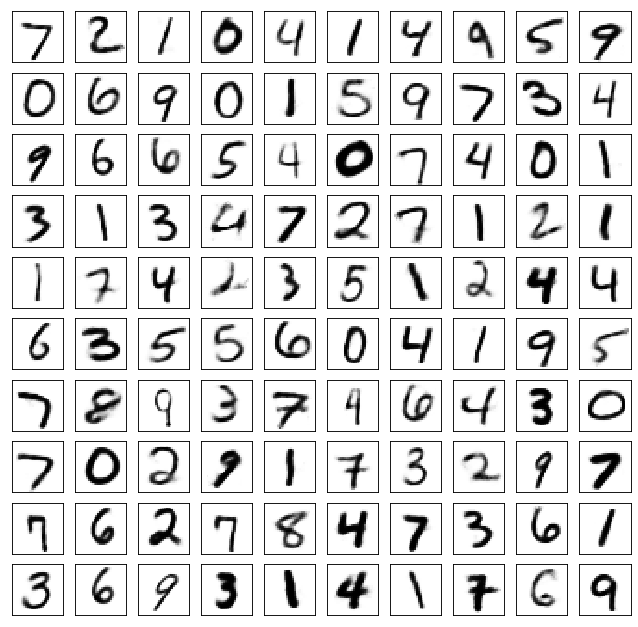

Test losses. E: 0.6962, AE: 0.0473, D: 0.6920
Train Epoch: 245 [0/50000 (0%)]	Losses E: 0.6913, AE: 0.0358, D: 0.6907
Train Epoch: 245 [25000/50000 (50%)]	Losses E: 0.6870, AE: 0.0340, D: 0.6927
Train Epoch: 245 [50000/50000 (100%)]	Losses E: 0.7018, AE: 0.0355, D: 0.6911
	generation


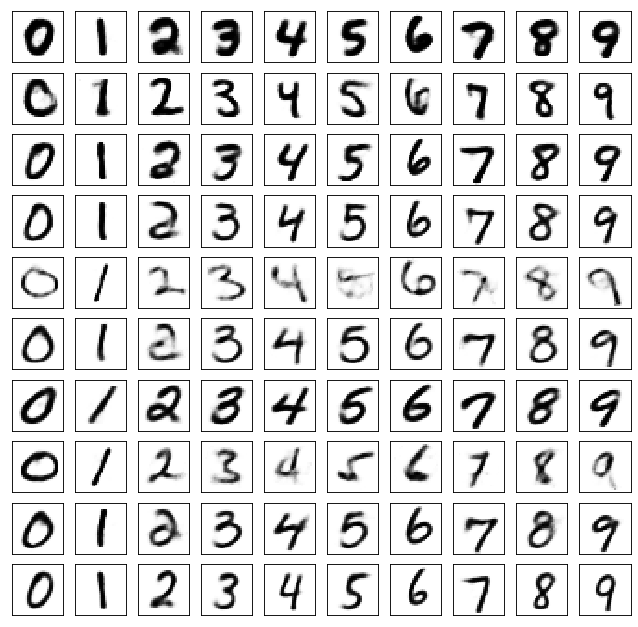

	reconstruction


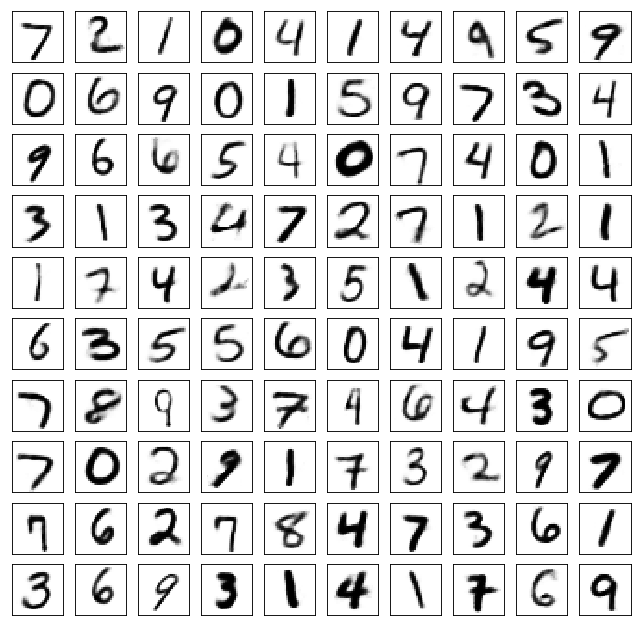

Test losses. E: 0.7017, AE: 0.0481, D: 0.6925
Train Epoch: 250 [0/50000 (0%)]	Losses E: 0.6991, AE: 0.0349, D: 0.6917
Train Epoch: 250 [25000/50000 (50%)]	Losses E: 0.6919, AE: 0.0358, D: 0.6925
Train Epoch: 250 [50000/50000 (100%)]	Losses E: 0.6963, AE: 0.0345, D: 0.6911
	generation


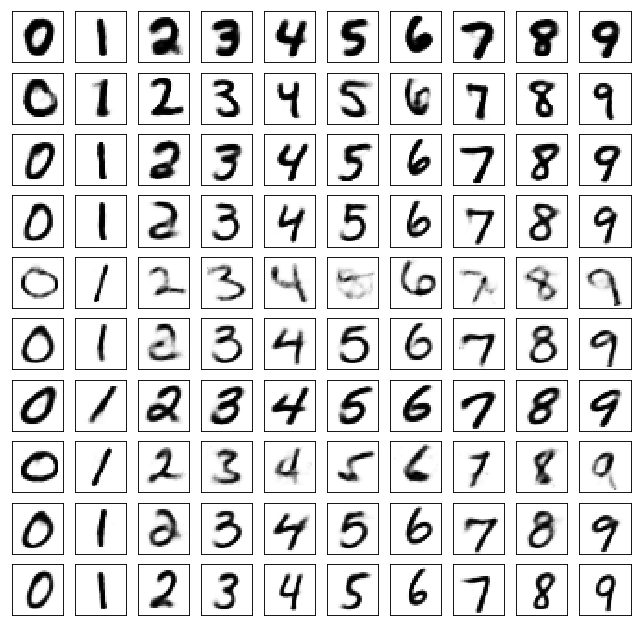

	reconstruction


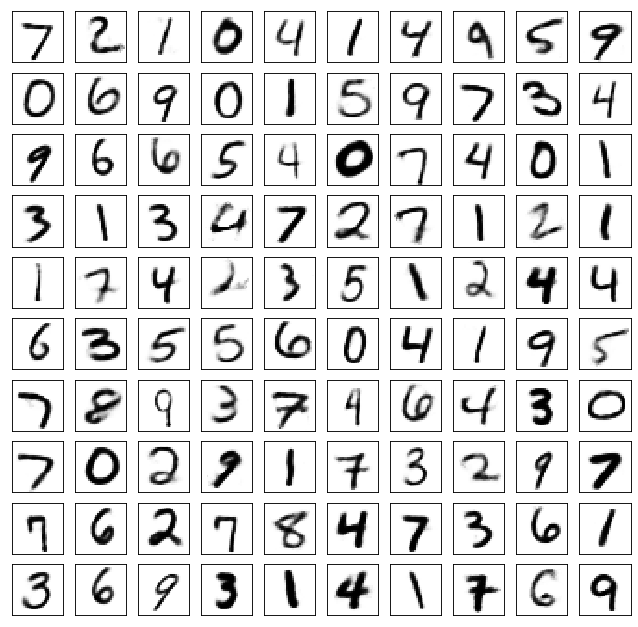

Test losses. E: 0.6953, AE: 0.0482, D: 0.6926
Train Epoch: 255 [0/50000 (0%)]	Losses E: 0.6895, AE: 0.0358, D: 0.6928
Train Epoch: 255 [25000/50000 (50%)]	Losses E: 0.7021, AE: 0.0323, D: 0.6903
Train Epoch: 255 [50000/50000 (100%)]	Losses E: 0.6995, AE: 0.0395, D: 0.6932
	generation


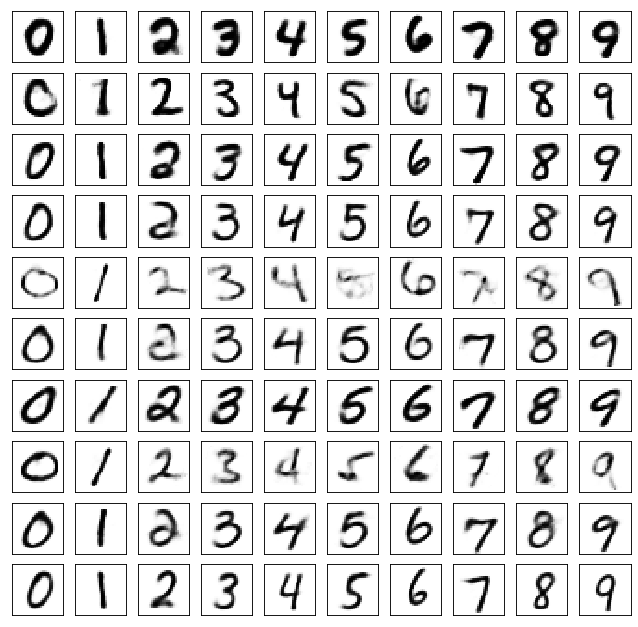

	reconstruction


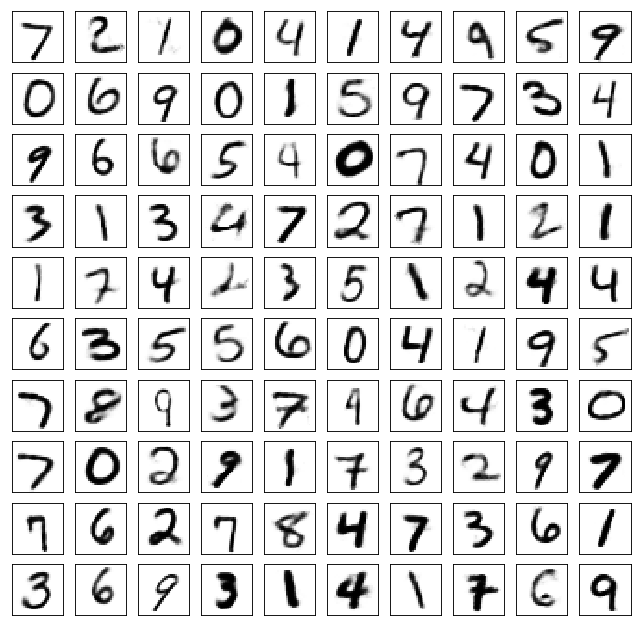

Test losses. E: 0.6987, AE: 0.0498, D: 0.6935
Train Epoch: 260 [0/50000 (0%)]	Losses E: 0.6900, AE: 0.0376, D: 0.6937
Train Epoch: 260 [25000/50000 (50%)]	Losses E: 0.6871, AE: 0.0373, D: 0.6937
Train Epoch: 260 [50000/50000 (100%)]	Losses E: 0.6925, AE: 0.0378, D: 0.6926
	generation


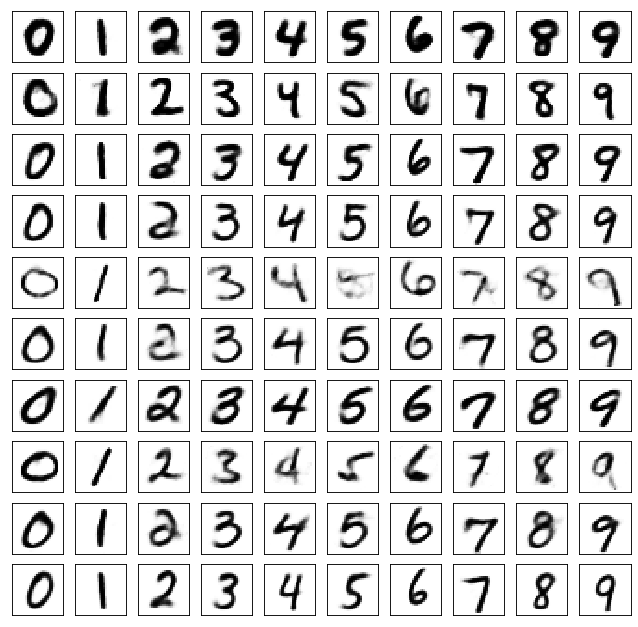

	reconstruction


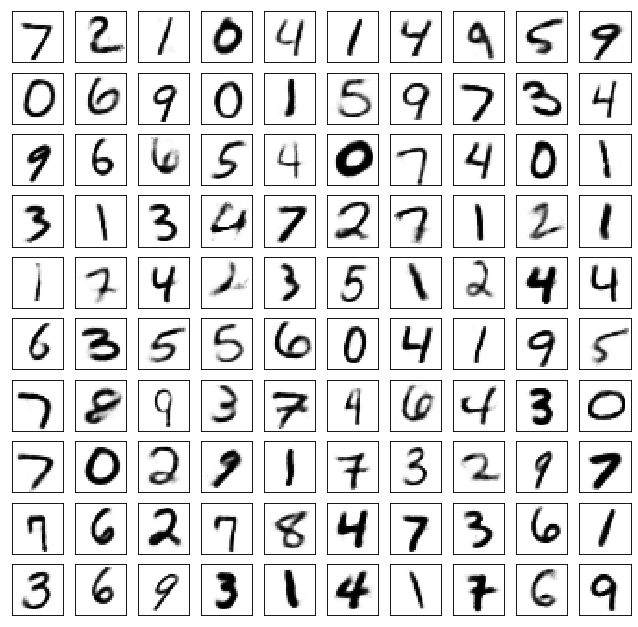

Test losses. E: 0.6903, AE: 0.0484, D: 0.6929
Train Epoch: 265 [0/50000 (0%)]	Losses E: 0.6947, AE: 0.0360, D: 0.6946
Train Epoch: 265 [25000/50000 (50%)]	Losses E: 0.6915, AE: 0.0346, D: 0.6944
Train Epoch: 265 [50000/50000 (100%)]	Losses E: 0.6855, AE: 0.0378, D: 0.6923
	generation


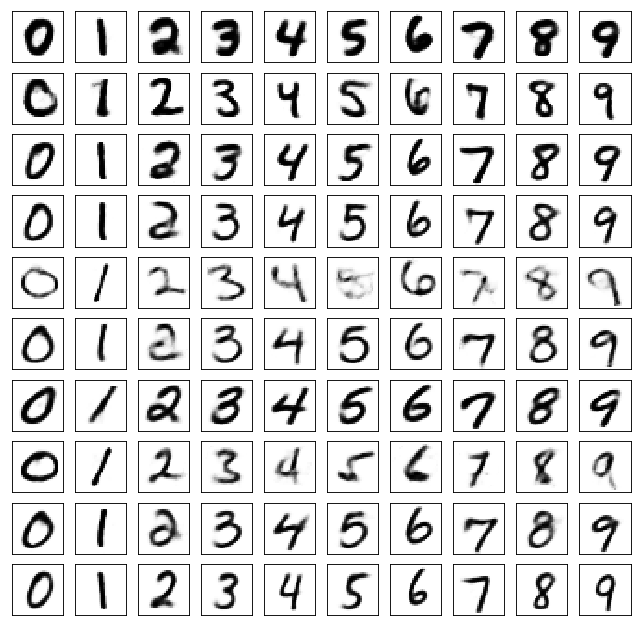

	reconstruction


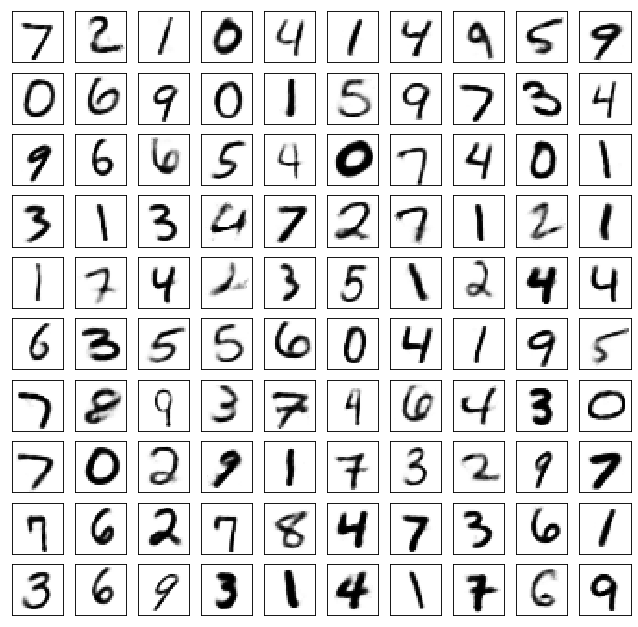

Test losses. E: 0.6861, AE: 0.0474, D: 0.6926
Train Epoch: 270 [0/50000 (0%)]	Losses E: 0.7075, AE: 0.0340, D: 0.6911
Train Epoch: 270 [25000/50000 (50%)]	Losses E: 0.6916, AE: 0.0340, D: 0.6921
Train Epoch: 270 [50000/50000 (100%)]	Losses E: 0.7021, AE: 0.0341, D: 0.6909
	generation


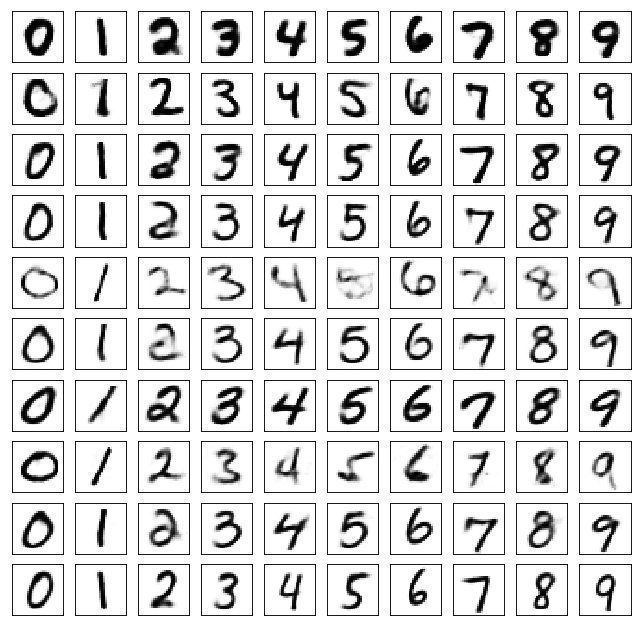

	reconstruction


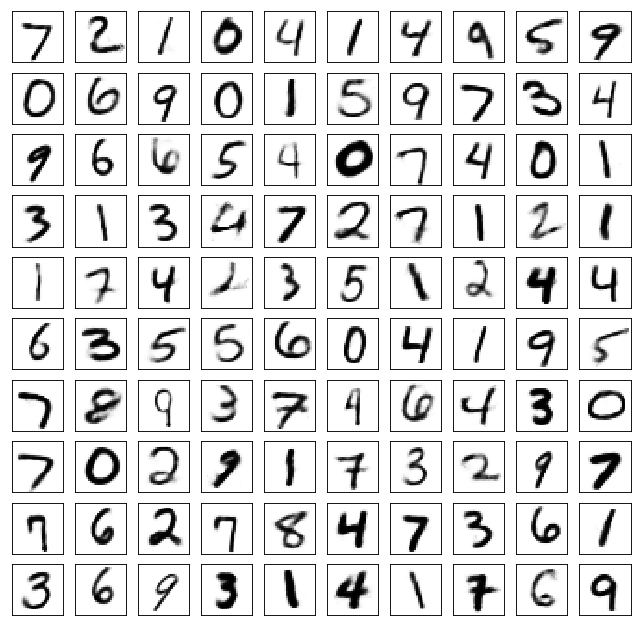

Test losses. E: 0.6983, AE: 0.0474, D: 0.6921
Train Epoch: 275 [0/50000 (0%)]	Losses E: 0.6980, AE: 0.0338, D: 0.6942
Train Epoch: 275 [25000/50000 (50%)]	Losses E: 0.6920, AE: 0.0356, D: 0.6939
Train Epoch: 275 [50000/50000 (100%)]	Losses E: 0.6934, AE: 0.0348, D: 0.6907
	generation


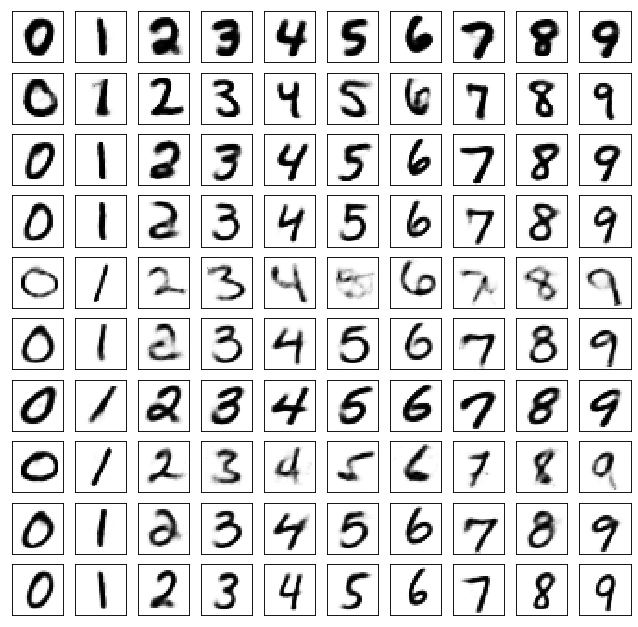

	reconstruction


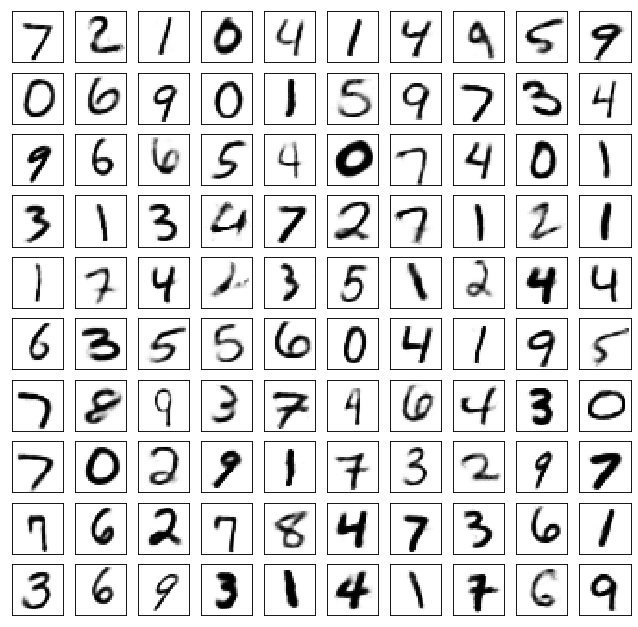

Test losses. E: 0.6913, AE: 0.0476, D: 0.6925
Train Epoch: 280 [0/50000 (0%)]	Losses E: 0.6973, AE: 0.0354, D: 0.6920
Train Epoch: 280 [25000/50000 (50%)]	Losses E: 0.6975, AE: 0.0371, D: 0.6934
Train Epoch: 280 [50000/50000 (100%)]	Losses E: 0.6880, AE: 0.0357, D: 0.6894
	generation


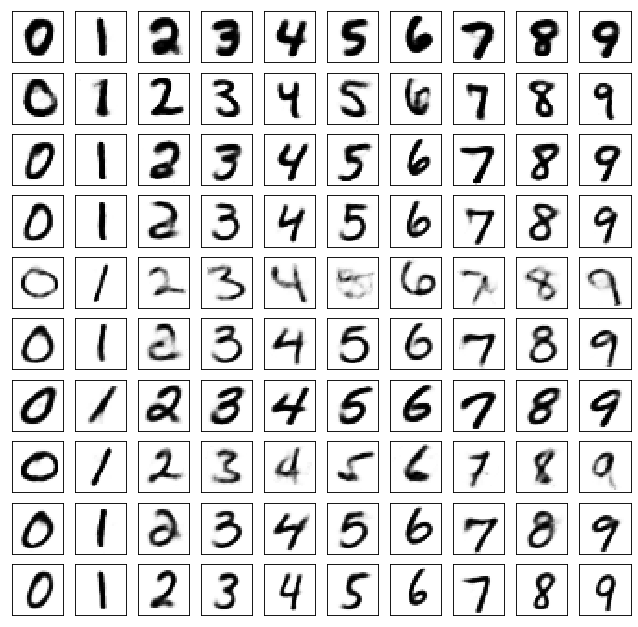

	reconstruction


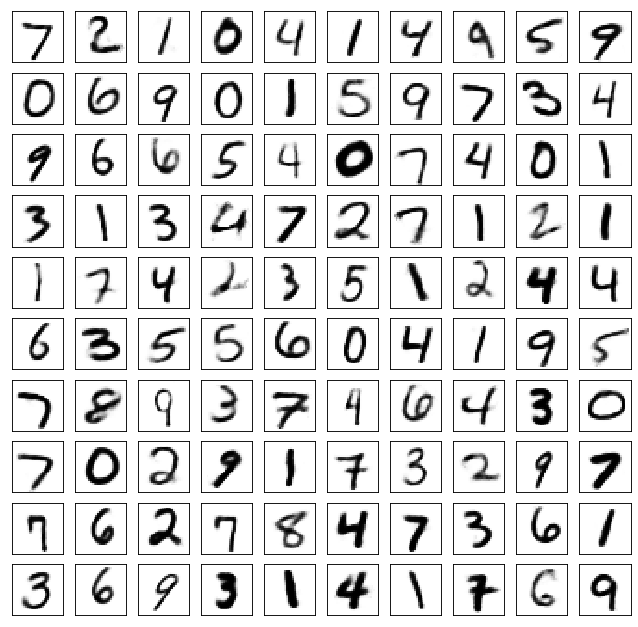

Test losses. E: 0.6867, AE: 0.0476, D: 0.6920
Train Epoch: 285 [0/50000 (0%)]	Losses E: 0.6917, AE: 0.0349, D: 0.6927
Train Epoch: 285 [25000/50000 (50%)]	Losses E: 0.6870, AE: 0.0336, D: 0.6963
Train Epoch: 285 [50000/50000 (100%)]	Losses E: 0.6996, AE: 0.0359, D: 0.6949
	generation


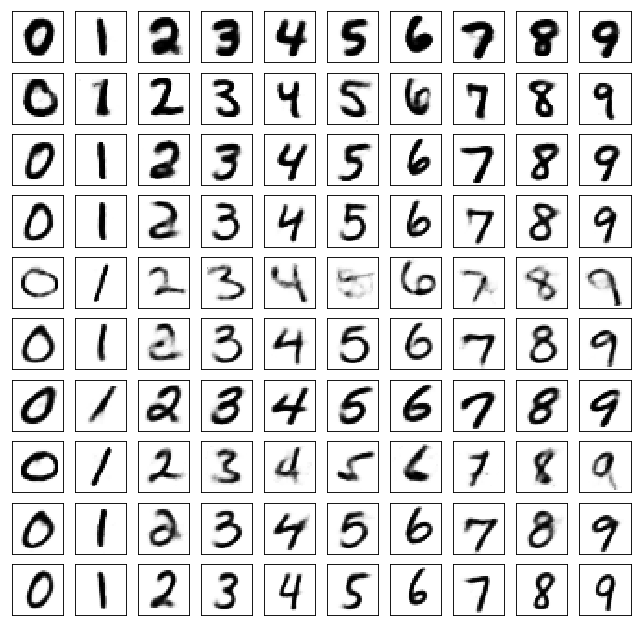

	reconstruction


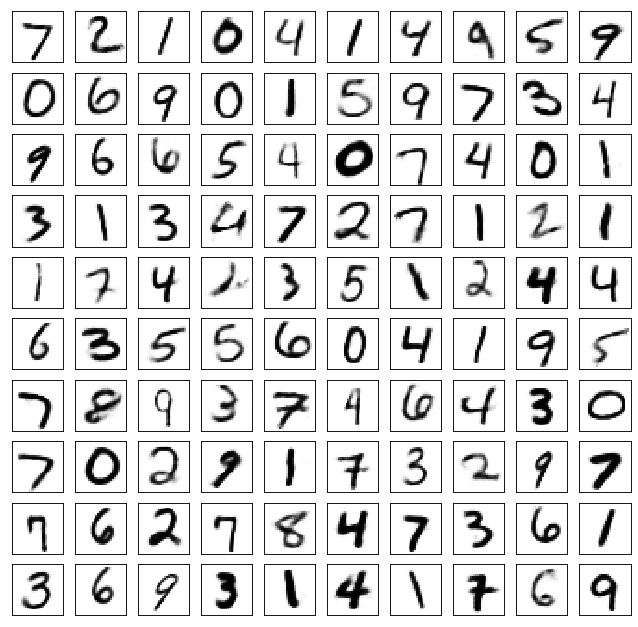

Test losses. E: 0.7025, AE: 0.0478, D: 0.6919
Train Epoch: 290 [0/50000 (0%)]	Losses E: 0.6851, AE: 0.0347, D: 0.6926
Train Epoch: 290 [25000/50000 (50%)]	Losses E: 0.6946, AE: 0.0350, D: 0.6981
Train Epoch: 290 [50000/50000 (100%)]	Losses E: 0.6904, AE: 0.0375, D: 0.6936
	generation


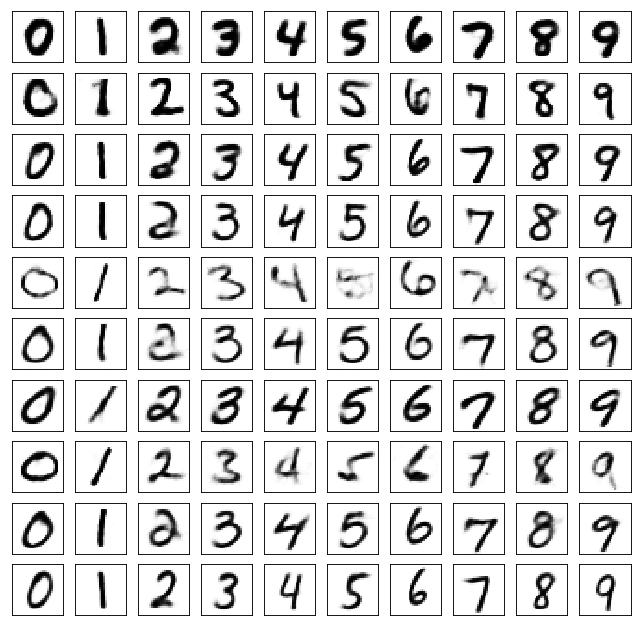

	reconstruction


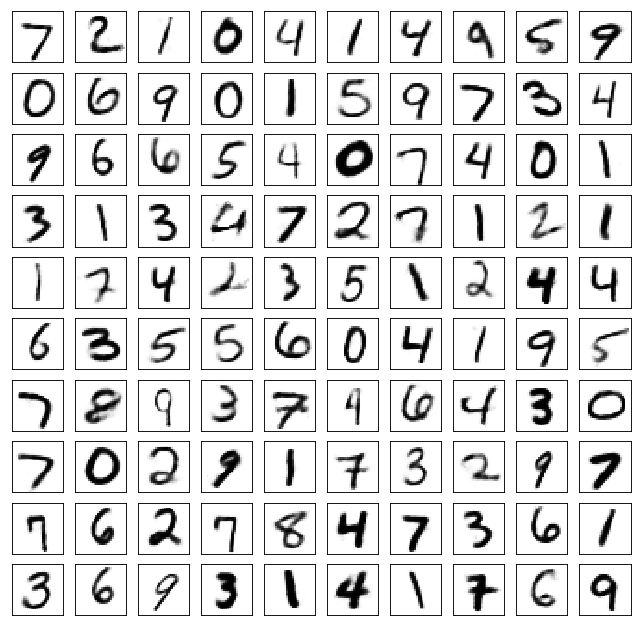

Test losses. E: 0.6933, AE: 0.0482, D: 0.6931
Train Epoch: 295 [0/50000 (0%)]	Losses E: 0.6944, AE: 0.0319, D: 0.6928
Train Epoch: 295 [25000/50000 (50%)]	Losses E: 0.6945, AE: 0.0345, D: 0.6937
Train Epoch: 295 [50000/50000 (100%)]	Losses E: 0.6973, AE: 0.0345, D: 0.6915
	generation


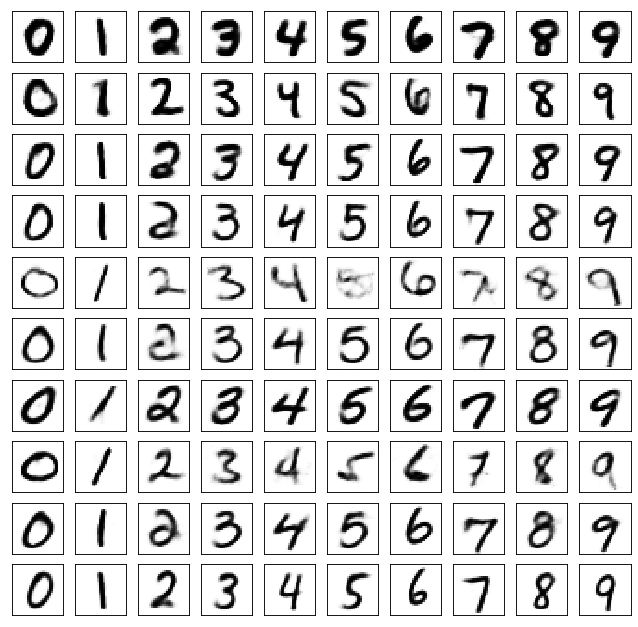

	reconstruction


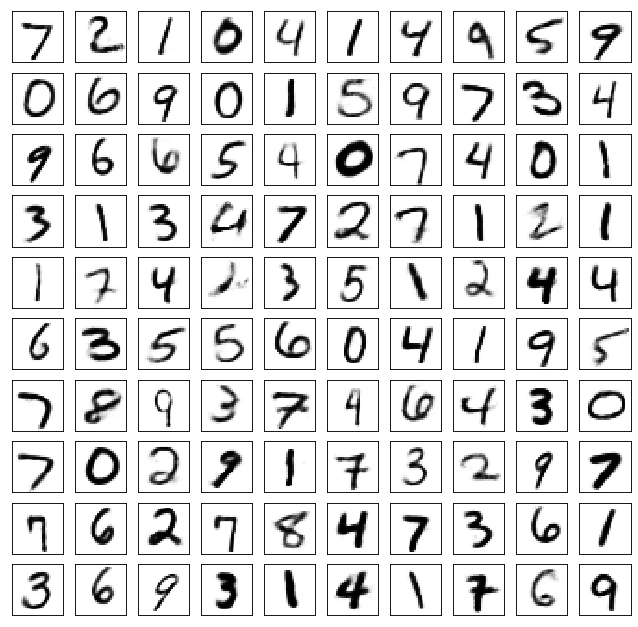

Test losses. E: 0.6954, AE: 0.0484, D: 0.6930
Train Epoch: 300 [0/50000 (0%)]	Losses E: 0.6855, AE: 0.0344, D: 0.6922
Train Epoch: 300 [25000/50000 (50%)]	Losses E: 0.6910, AE: 0.0348, D: 0.6929
Train Epoch: 300 [50000/50000 (100%)]	Losses E: 0.6915, AE: 0.0339, D: 0.6948
	generation


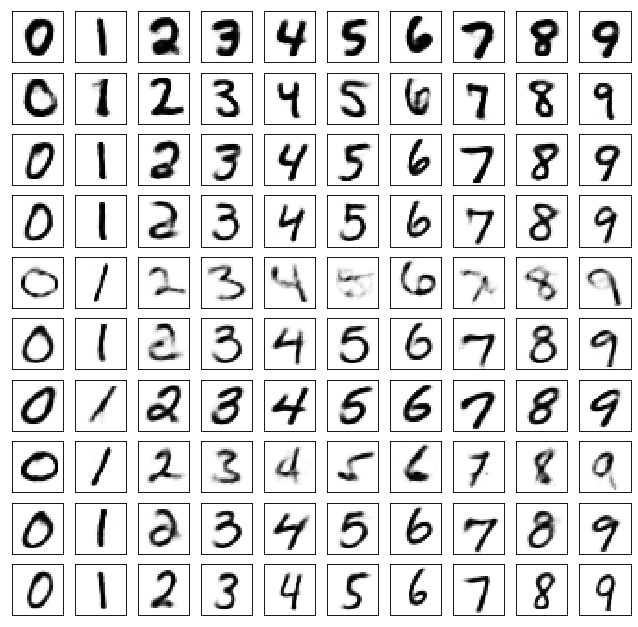

	reconstruction


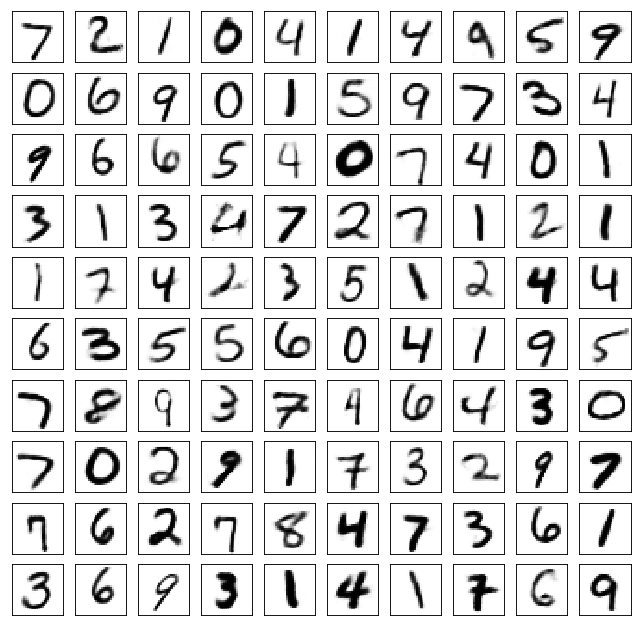

Test losses. E: 0.6922, AE: 0.0480, D: 0.6933
Train Epoch: 305 [0/50000 (0%)]	Losses E: 0.6945, AE: 0.0327, D: 0.6940
Train Epoch: 305 [25000/50000 (50%)]	Losses E: 0.6970, AE: 0.0356, D: 0.6913
Train Epoch: 305 [50000/50000 (100%)]	Losses E: 0.6977, AE: 0.0330, D: 0.6915
	generation


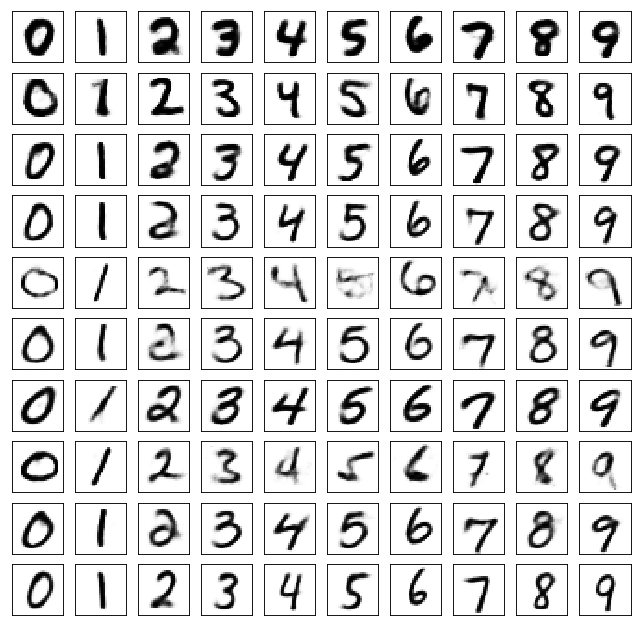

	reconstruction


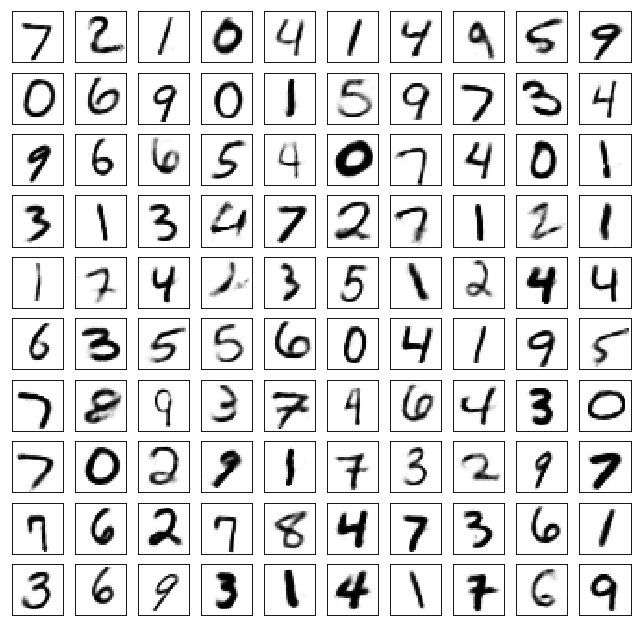

Test losses. E: 0.6938, AE: 0.0475, D: 0.6922
Train Epoch: 310 [0/50000 (0%)]	Losses E: 0.6938, AE: 0.0313, D: 0.6924
Train Epoch: 310 [25000/50000 (50%)]	Losses E: 0.6912, AE: 0.0332, D: 0.6921
Train Epoch: 310 [50000/50000 (100%)]	Losses E: 0.6945, AE: 0.0333, D: 0.6923
	generation


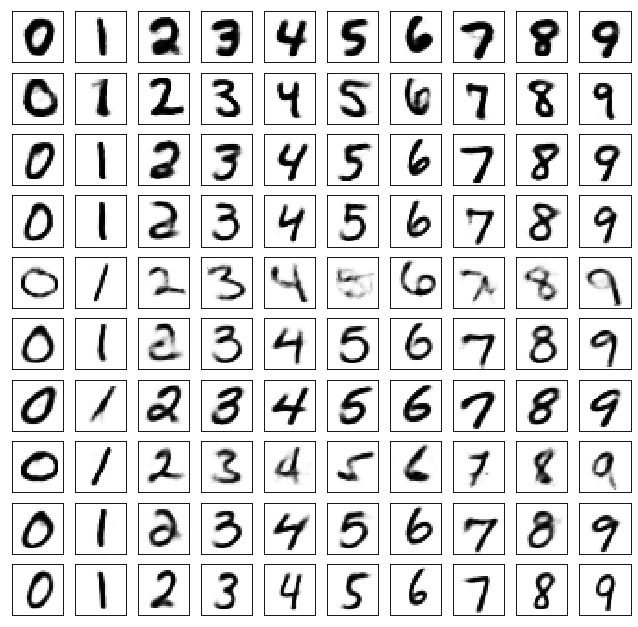

	reconstruction


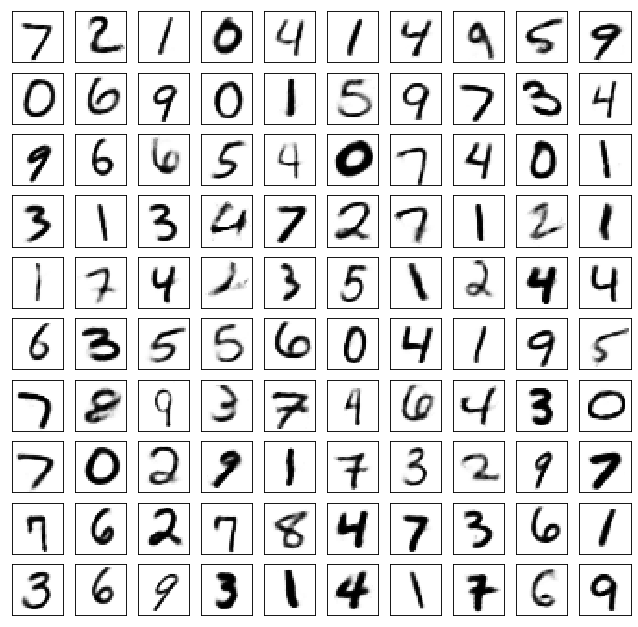

Test losses. E: 0.6943, AE: 0.0473, D: 0.6923
Train Epoch: 315 [0/50000 (0%)]	Losses E: 0.6959, AE: 0.0324, D: 0.6913
Train Epoch: 315 [25000/50000 (50%)]	Losses E: 0.6954, AE: 0.0337, D: 0.6938
Train Epoch: 315 [50000/50000 (100%)]	Losses E: 0.6893, AE: 0.0330, D: 0.6929
	generation


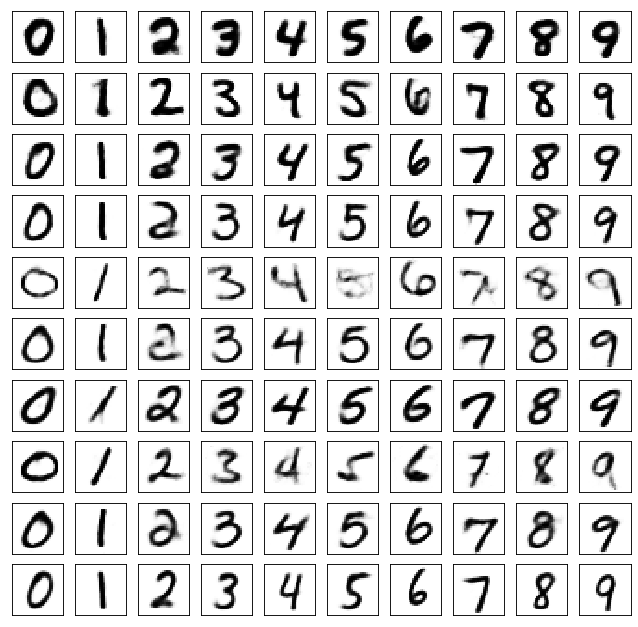

	reconstruction


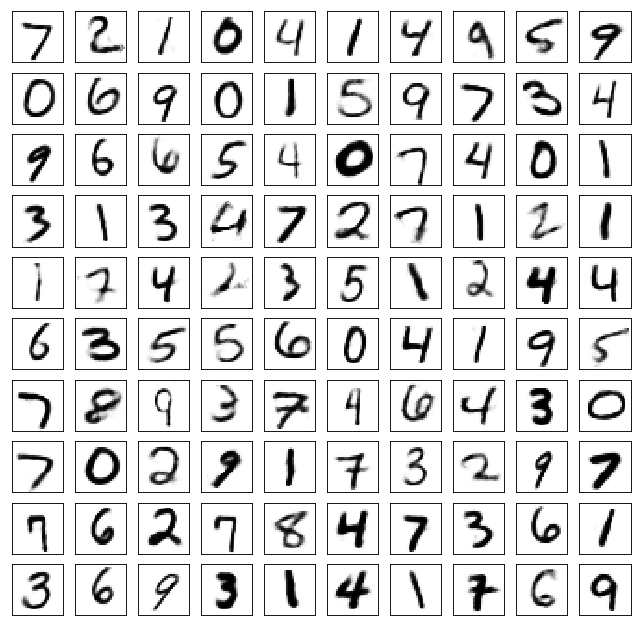

Test losses. E: 0.6937, AE: 0.0480, D: 0.6926
Train Epoch: 320 [0/50000 (0%)]	Losses E: 0.6991, AE: 0.0321, D: 0.6916
Train Epoch: 320 [25000/50000 (50%)]	Losses E: 0.6885, AE: 0.0335, D: 0.6944
Train Epoch: 320 [50000/50000 (100%)]	Losses E: 0.6966, AE: 0.0331, D: 0.6937
	generation


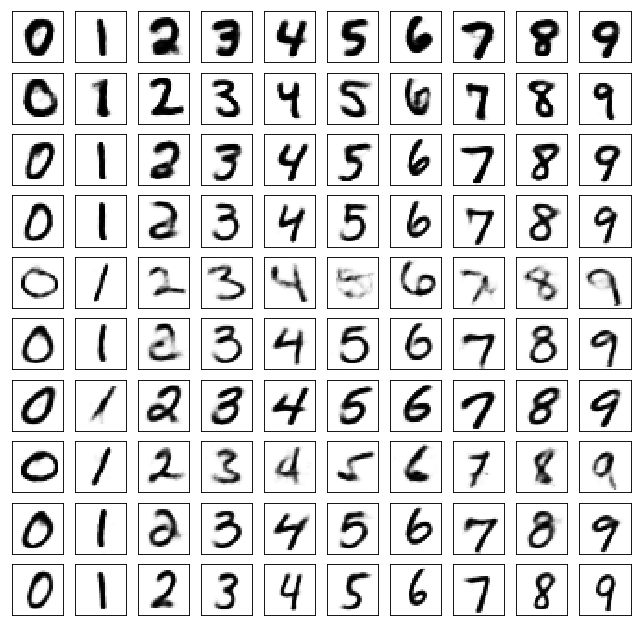

	reconstruction


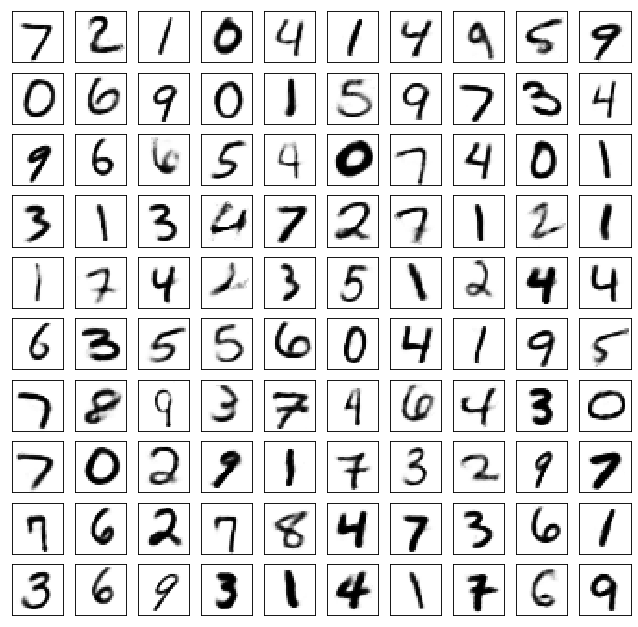

Test losses. E: 0.6951, AE: 0.0482, D: 0.6927
Train Epoch: 325 [0/50000 (0%)]	Losses E: 0.6944, AE: 0.0338, D: 0.6939
Train Epoch: 325 [25000/50000 (50%)]	Losses E: 0.6957, AE: 0.0337, D: 0.6935
Train Epoch: 325 [50000/50000 (100%)]	Losses E: 0.6925, AE: 0.0339, D: 0.6914
	generation


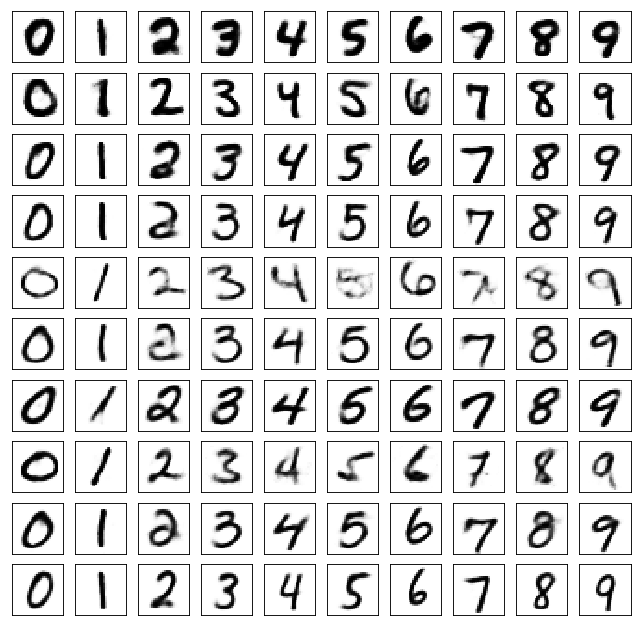

	reconstruction


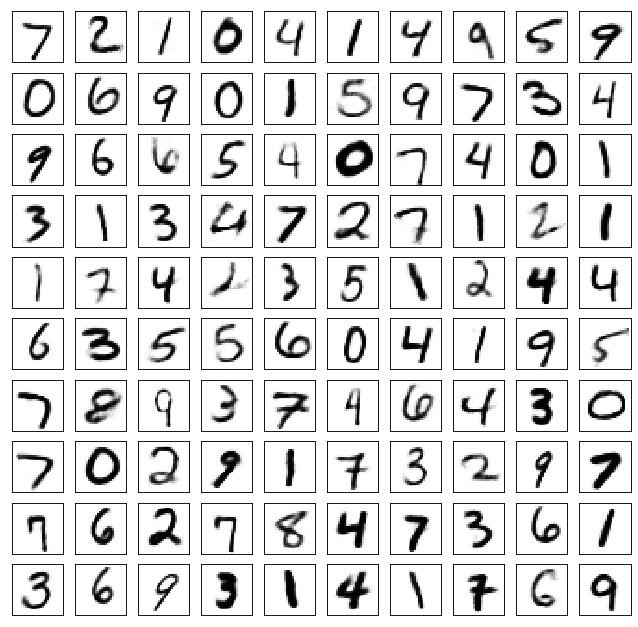

Test losses. E: 0.6936, AE: 0.0477, D: 0.6924
Train Epoch: 330 [0/50000 (0%)]	Losses E: 0.6961, AE: 0.0323, D: 0.6901
Train Epoch: 330 [25000/50000 (50%)]	Losses E: 0.6946, AE: 0.0364, D: 0.6931
Train Epoch: 330 [50000/50000 (100%)]	Losses E: 0.6938, AE: 0.0328, D: 0.6924
	generation


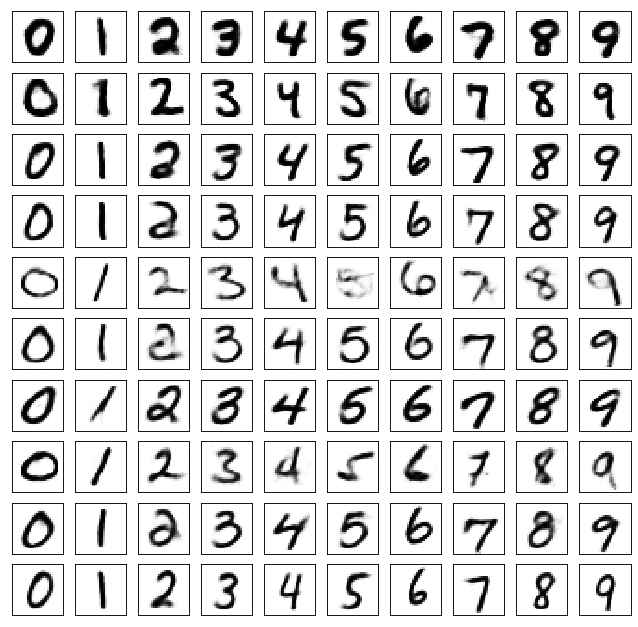

	reconstruction


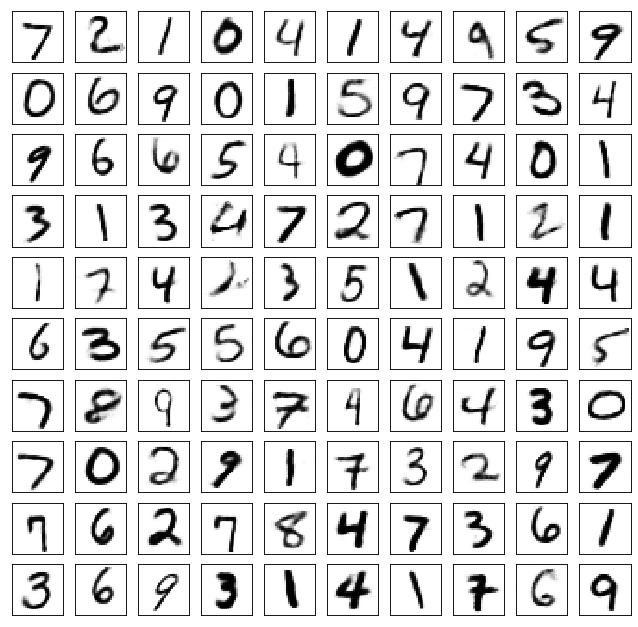

Test losses. E: 0.6934, AE: 0.0475, D: 0.6924
Train Epoch: 335 [0/50000 (0%)]	Losses E: 0.7016, AE: 0.0336, D: 0.6937
Train Epoch: 335 [25000/50000 (50%)]	Losses E: 0.7007, AE: 0.0288, D: 0.6924
Train Epoch: 335 [50000/50000 (100%)]	Losses E: 0.7013, AE: 0.0297, D: 0.6903
	generation


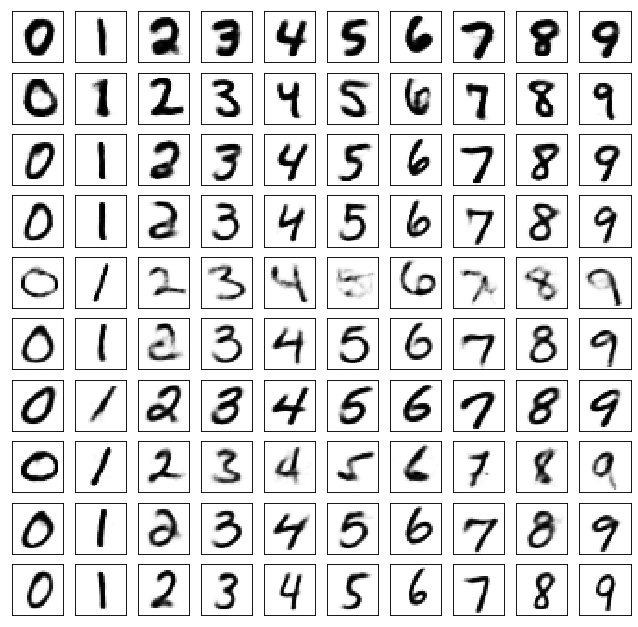

	reconstruction


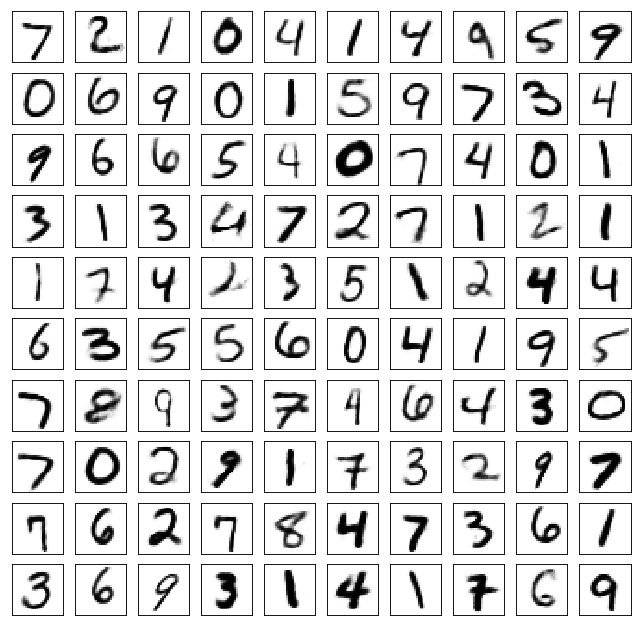

Test losses. E: 0.6981, AE: 0.0472, D: 0.6919
Train Epoch: 340 [0/50000 (0%)]	Losses E: 0.7047, AE: 0.0314, D: 0.6907
Train Epoch: 340 [25000/50000 (50%)]	Losses E: 0.7023, AE: 0.0326, D: 0.6931
Train Epoch: 340 [50000/50000 (100%)]	Losses E: 0.7012, AE: 0.0327, D: 0.6934
	generation


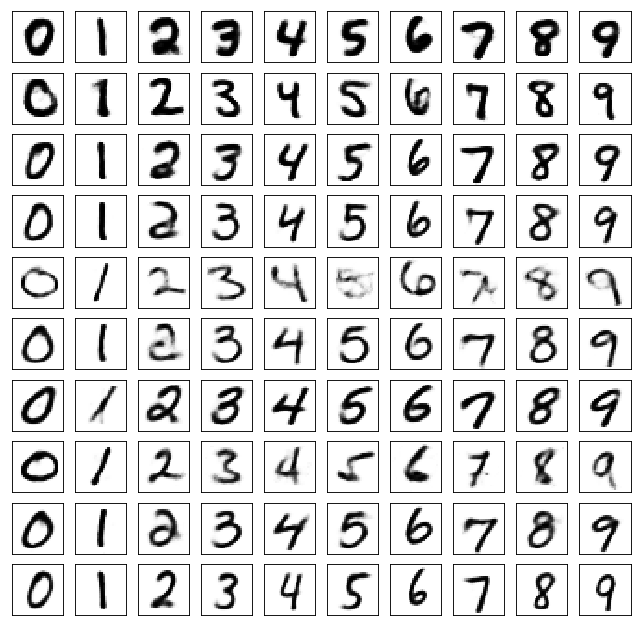

	reconstruction


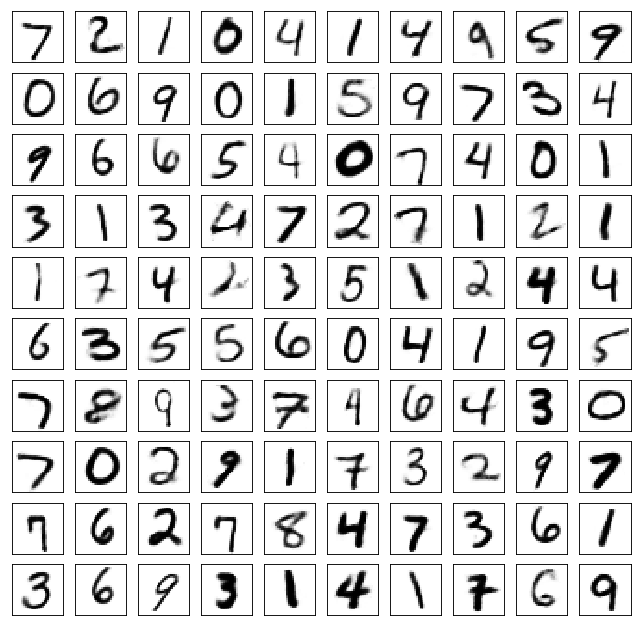

Test losses. E: 0.7016, AE: 0.0476, D: 0.6919
Train Epoch: 345 [0/50000 (0%)]	Losses E: 0.6985, AE: 0.0315, D: 0.6915
Train Epoch: 345 [25000/50000 (50%)]	Losses E: 0.6967, AE: 0.0310, D: 0.6909
Train Epoch: 345 [50000/50000 (100%)]	Losses E: 0.6897, AE: 0.0312, D: 0.6930
	generation


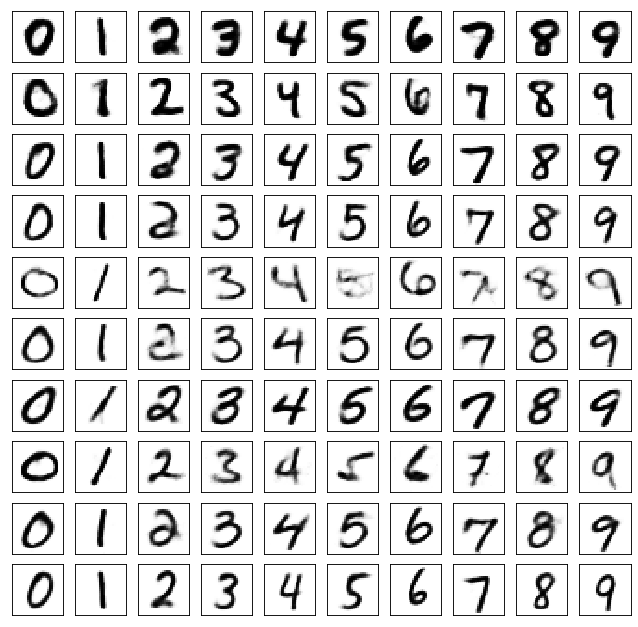

	reconstruction


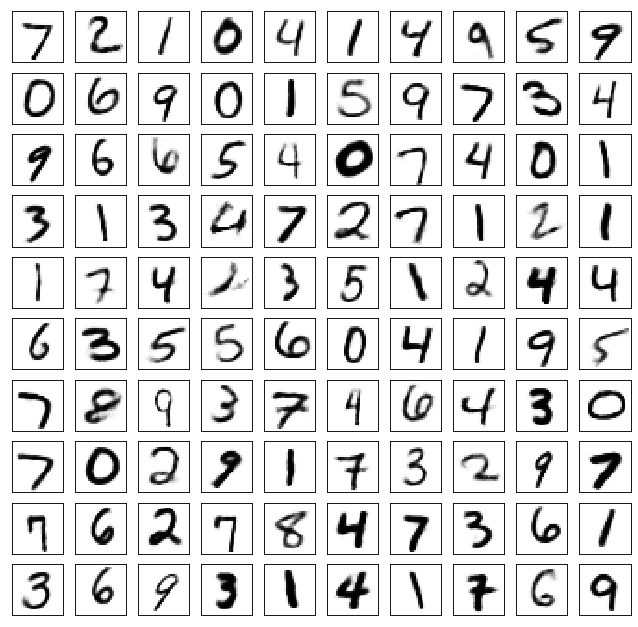

Test losses. E: 0.6883, AE: 0.0477, D: 0.6930
Train Epoch: 350 [0/50000 (0%)]	Losses E: 0.6899, AE: 0.0307, D: 0.6924
Train Epoch: 350 [25000/50000 (50%)]	Losses E: 0.6935, AE: 0.0321, D: 0.6924
Train Epoch: 350 [50000/50000 (100%)]	Losses E: 0.6901, AE: 0.0304, D: 0.6913
	generation


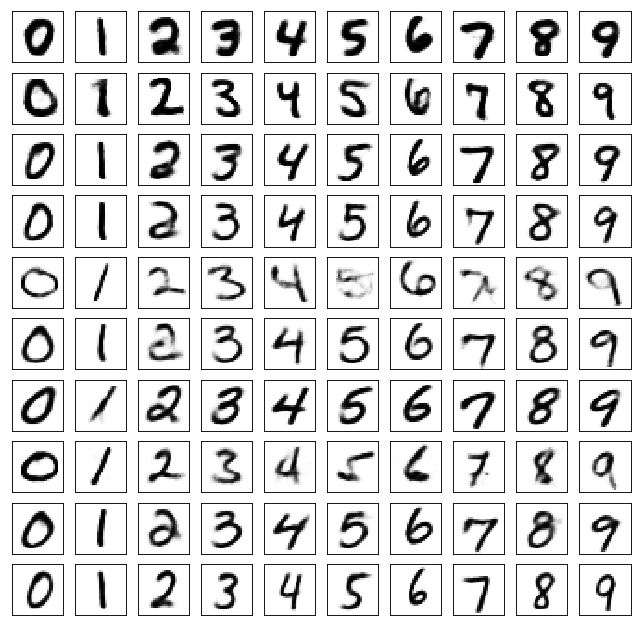

	reconstruction


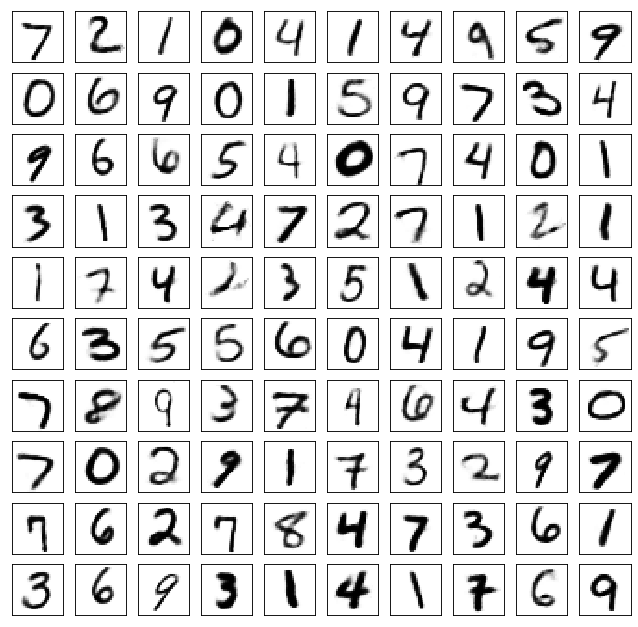

Test losses. E: 0.6905, AE: 0.0472, D: 0.6921
Train Epoch: 355 [0/50000 (0%)]	Losses E: 0.6957, AE: 0.0312, D: 0.6916
Train Epoch: 355 [25000/50000 (50%)]	Losses E: 0.7028, AE: 0.0325, D: 0.6948
Train Epoch: 355 [50000/50000 (100%)]	Losses E: 0.6974, AE: 0.0353, D: 0.6944
	generation


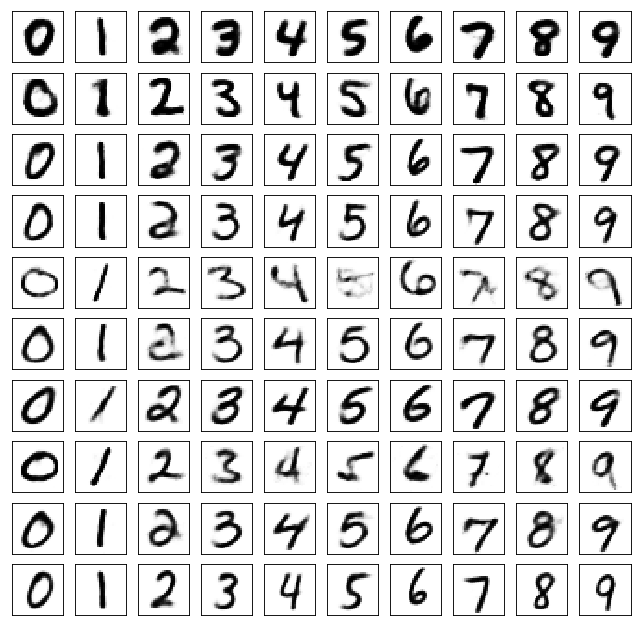

	reconstruction


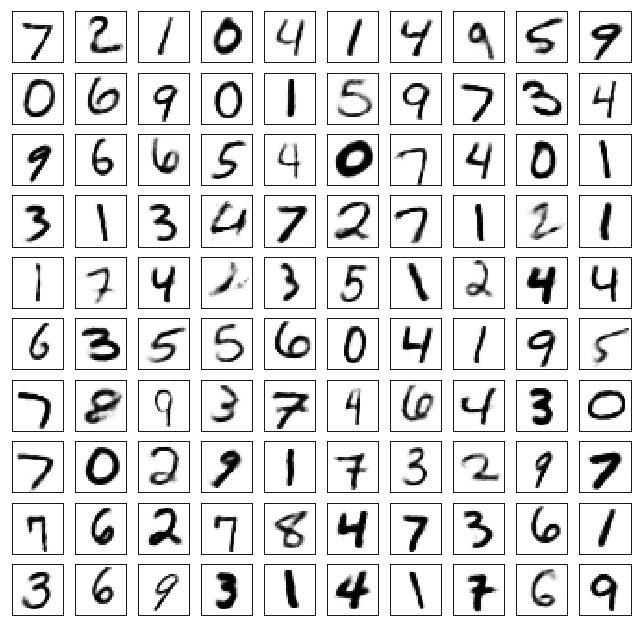

Test losses. E: 0.6947, AE: 0.0481, D: 0.6924
Train Epoch: 360 [0/50000 (0%)]	Losses E: 0.6931, AE: 0.0306, D: 0.6938
Train Epoch: 360 [25000/50000 (50%)]	Losses E: 0.7023, AE: 0.0302, D: 0.6940
Train Epoch: 360 [50000/50000 (100%)]	Losses E: 0.6875, AE: 0.0307, D: 0.6950
	generation


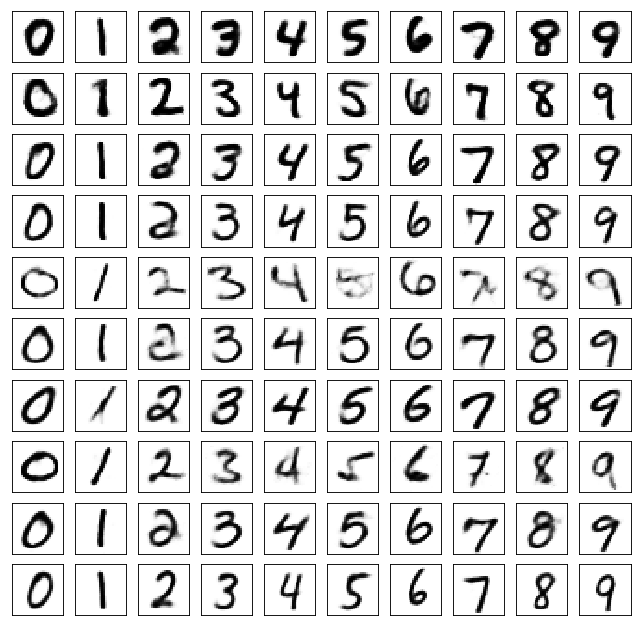

	reconstruction


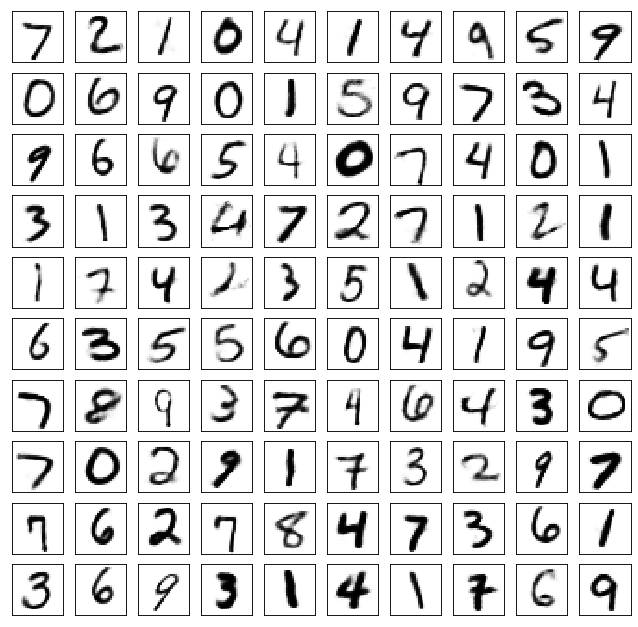

Test losses. E: 0.6863, AE: 0.0478, D: 0.6930
Train Epoch: 365 [0/50000 (0%)]	Losses E: 0.6988, AE: 0.0329, D: 0.6935
Train Epoch: 365 [25000/50000 (50%)]	Losses E: 0.6985, AE: 0.0312, D: 0.6941
Train Epoch: 365 [50000/50000 (100%)]	Losses E: 0.7015, AE: 0.0325, D: 0.6905
	generation


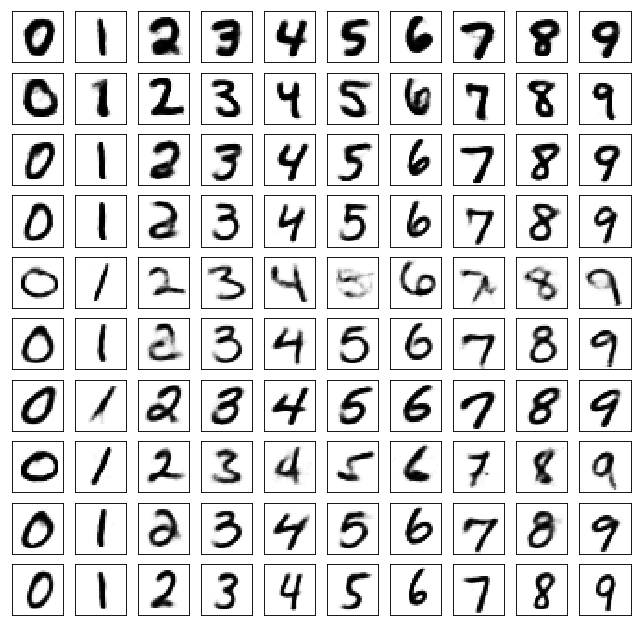

	reconstruction


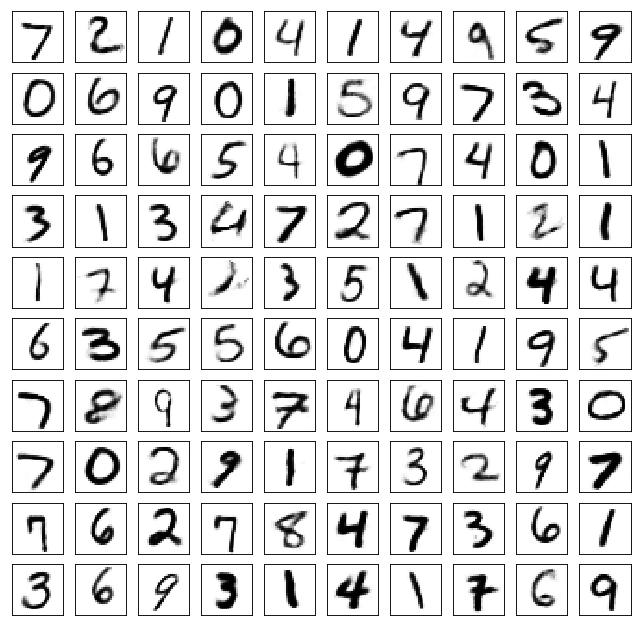

Test losses. E: 0.6981, AE: 0.0482, D: 0.6921
Train Epoch: 370 [0/50000 (0%)]	Losses E: 0.6992, AE: 0.0317, D: 0.6920
Train Epoch: 370 [25000/50000 (50%)]	Losses E: 0.6948, AE: 0.0330, D: 0.6931
Train Epoch: 370 [50000/50000 (100%)]	Losses E: 0.6980, AE: 0.0304, D: 0.6933
	generation


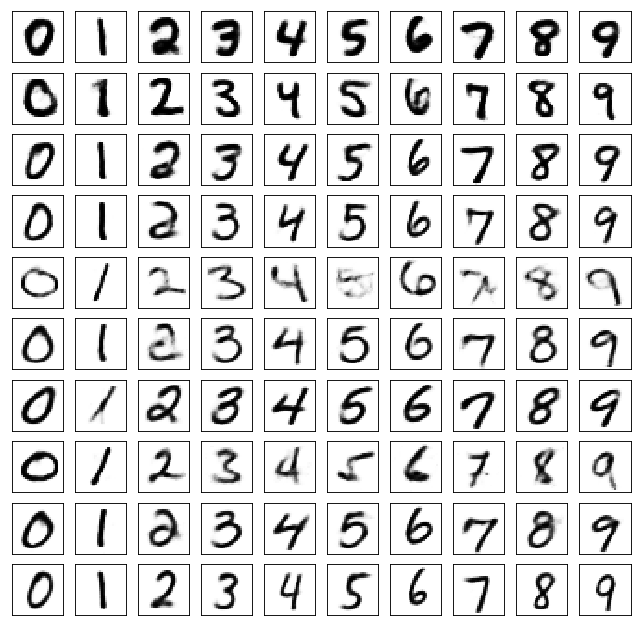

	reconstruction


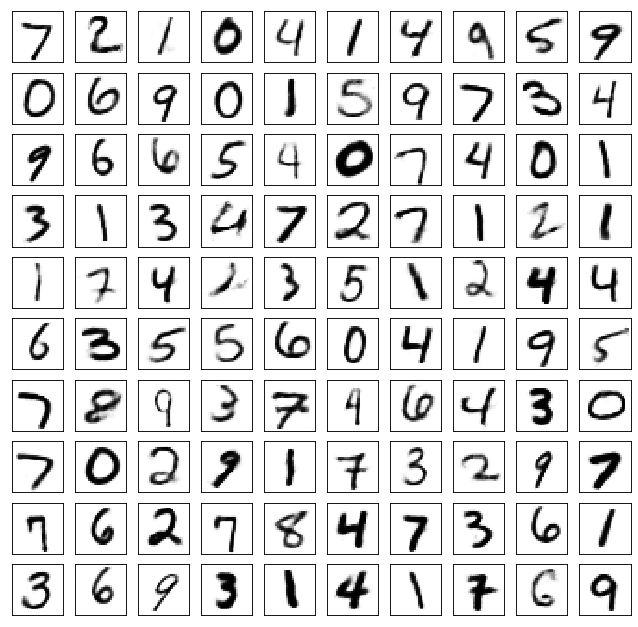

Test losses. E: 0.6968, AE: 0.0475, D: 0.6919
Train Epoch: 375 [0/50000 (0%)]	Losses E: 0.6943, AE: 0.0310, D: 0.6939
Train Epoch: 375 [25000/50000 (50%)]	Losses E: 0.6971, AE: 0.0310, D: 0.6930
Train Epoch: 375 [50000/50000 (100%)]	Losses E: 0.6941, AE: 0.0290, D: 0.6916
	generation


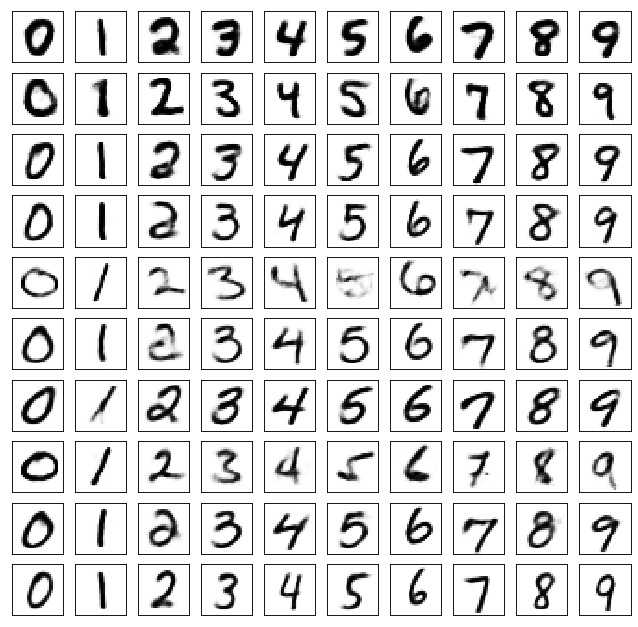

	reconstruction


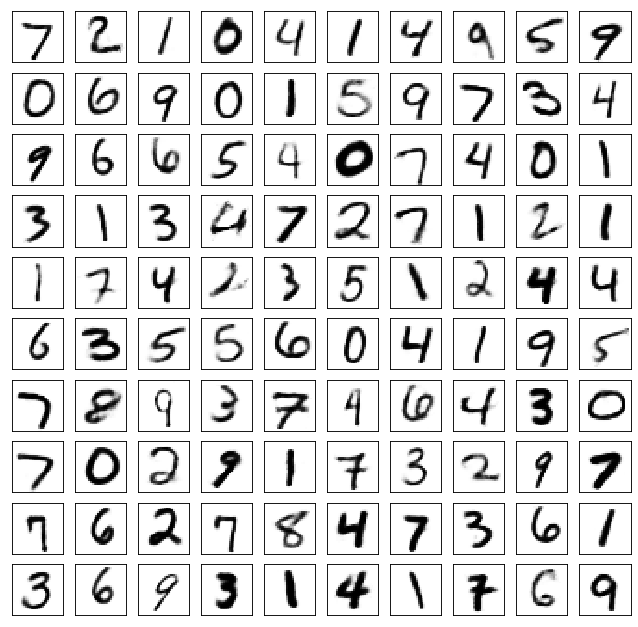

Test losses. E: 0.6912, AE: 0.0474, D: 0.6923
Train Epoch: 380 [0/50000 (0%)]	Losses E: 0.6863, AE: 0.0306, D: 0.6941
Train Epoch: 380 [25000/50000 (50%)]	Losses E: 0.6973, AE: 0.0331, D: 0.6945
Train Epoch: 380 [50000/50000 (100%)]	Losses E: 0.6875, AE: 0.0310, D: 0.6954
	generation


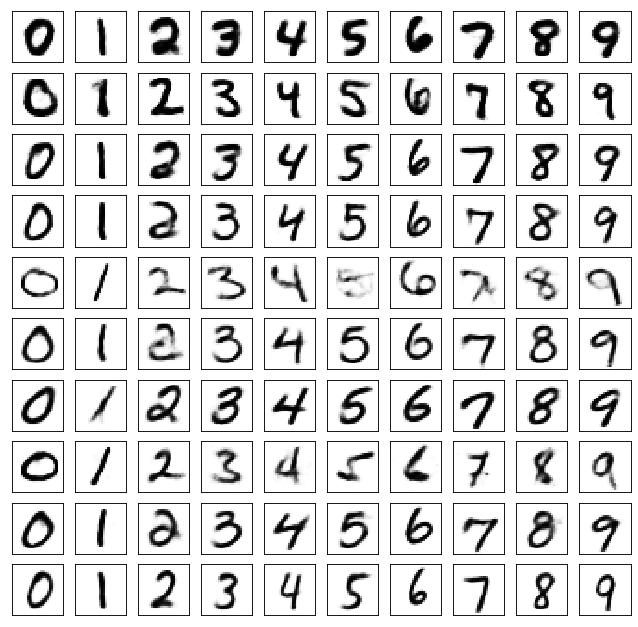

	reconstruction


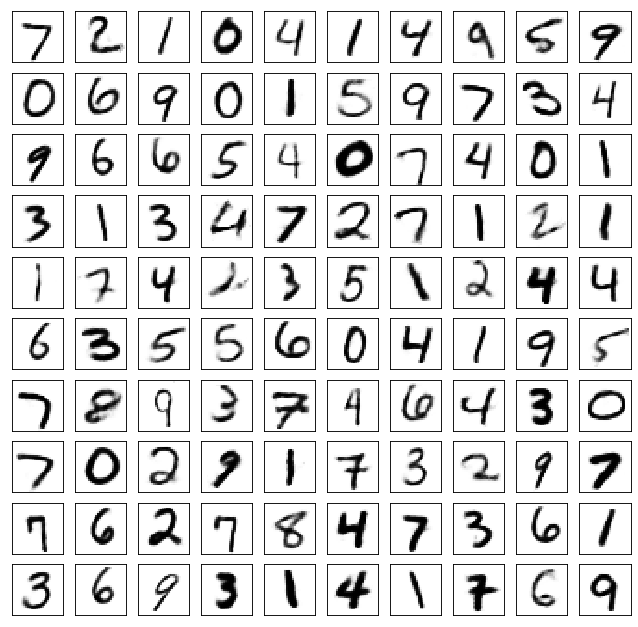

Test losses. E: 0.6869, AE: 0.0481, D: 0.6922
Train Epoch: 385 [0/50000 (0%)]	Losses E: 0.6996, AE: 0.0323, D: 0.6934
Train Epoch: 385 [25000/50000 (50%)]	Losses E: 0.6891, AE: 0.0300, D: 0.6936
Train Epoch: 385 [50000/50000 (100%)]	Losses E: 0.6864, AE: 0.0312, D: 0.6931
	generation


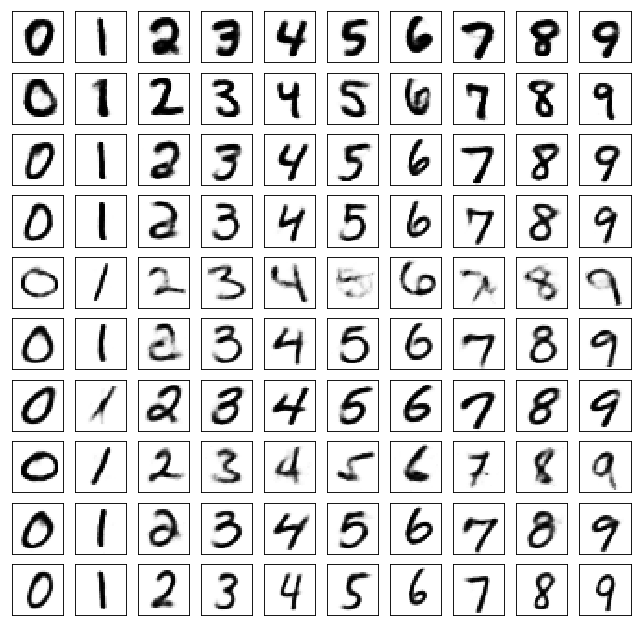

	reconstruction


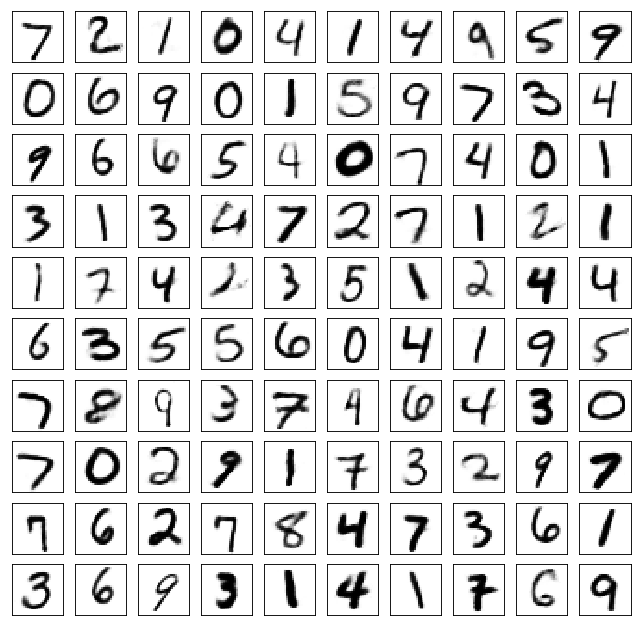

Test losses. E: 0.6893, AE: 0.0475, D: 0.6924
Train Epoch: 390 [0/50000 (0%)]	Losses E: 0.6929, AE: 0.0315, D: 0.6924
Train Epoch: 390 [25000/50000 (50%)]	Losses E: 0.7059, AE: 0.0298, D: 0.6910
Train Epoch: 390 [50000/50000 (100%)]	Losses E: 0.6871, AE: 0.0299, D: 0.6934
	generation


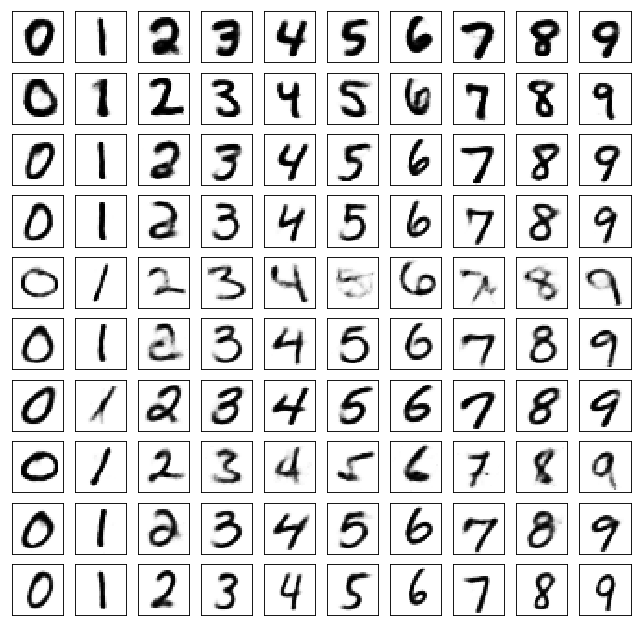

	reconstruction


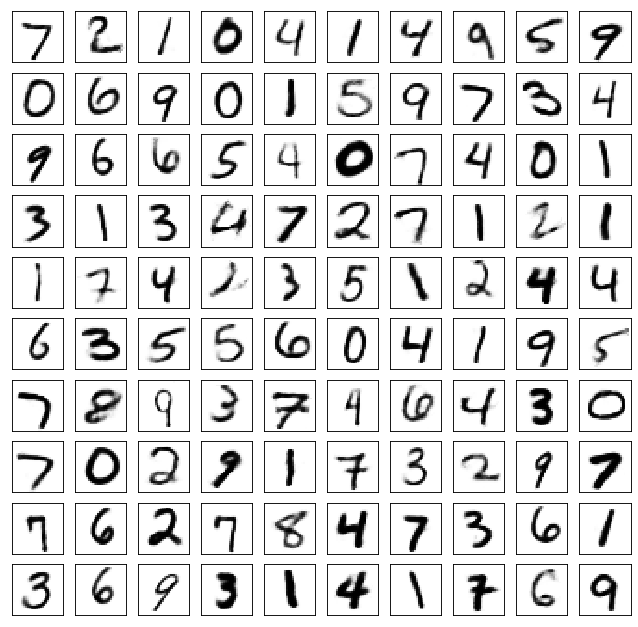

Test losses. E: 0.6885, AE: 0.0477, D: 0.6922
Train Epoch: 395 [0/50000 (0%)]	Losses E: 0.7043, AE: 0.0287, D: 0.6947
Train Epoch: 395 [25000/50000 (50%)]	Losses E: 0.6896, AE: 0.0322, D: 0.6942
Train Epoch: 395 [50000/50000 (100%)]	Losses E: 0.6932, AE: 0.0306, D: 0.6885
	generation


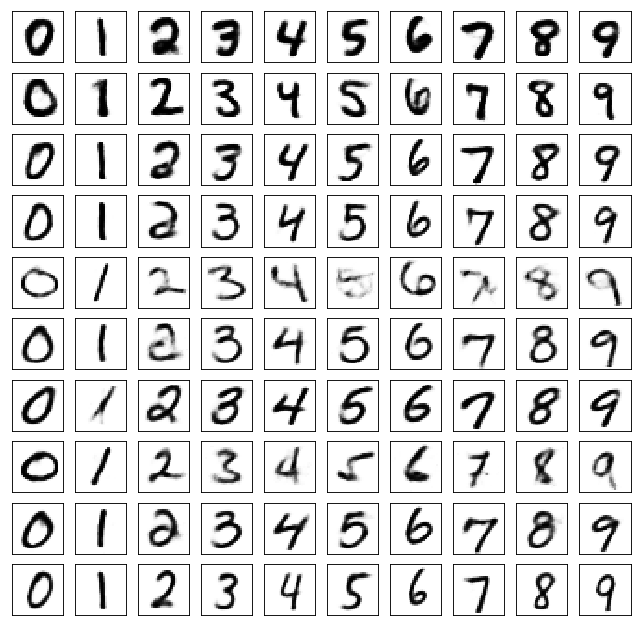

	reconstruction


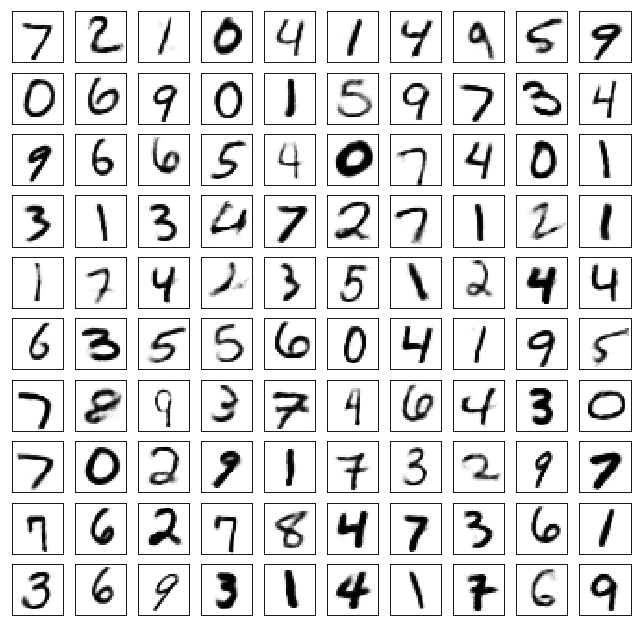

Test losses. E: 0.6921, AE: 0.0475, D: 0.6920
Train Epoch: 400 [0/50000 (0%)]	Losses E: 0.6918, AE: 0.0321, D: 0.6934
Train Epoch: 400 [25000/50000 (50%)]	Losses E: 0.6982, AE: 0.0326, D: 0.6917
Train Epoch: 400 [50000/50000 (100%)]	Losses E: 0.6911, AE: 0.0300, D: 0.6936
	generation


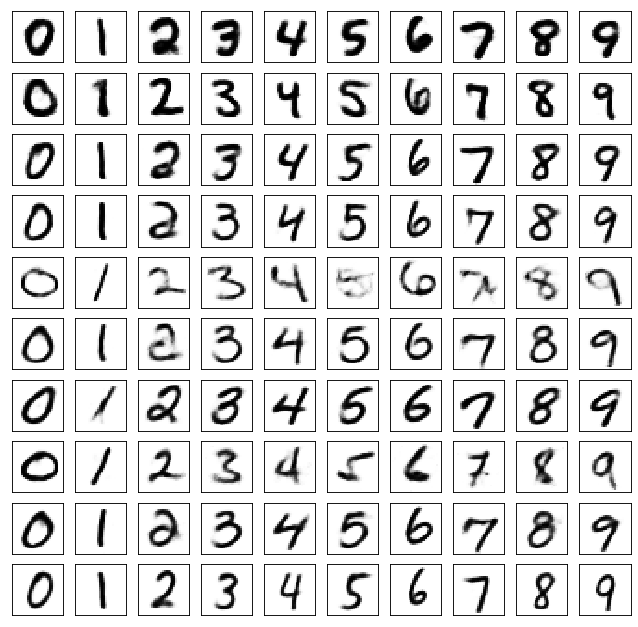

	reconstruction


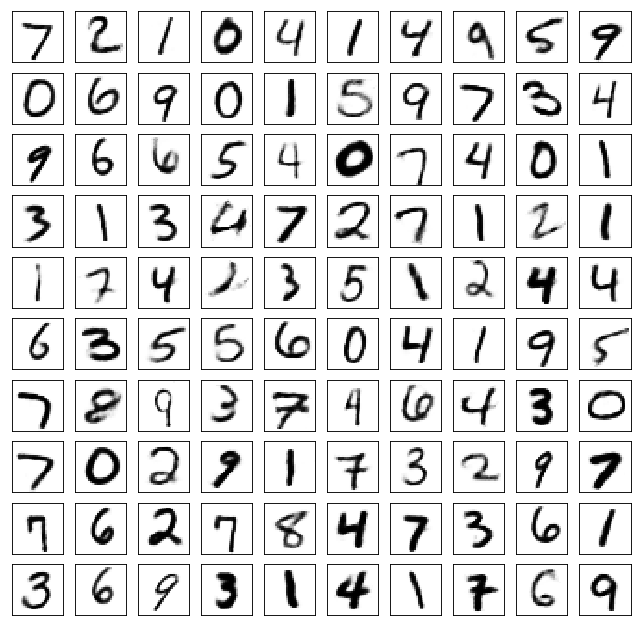

Test losses. E: 0.6902, AE: 0.0474, D: 0.6919
Train Epoch: 405 [0/50000 (0%)]	Losses E: 0.6991, AE: 0.0314, D: 0.6923
Train Epoch: 405 [25000/50000 (50%)]	Losses E: 0.6956, AE: 0.0293, D: 0.6938
Train Epoch: 405 [50000/50000 (100%)]	Losses E: 0.6919, AE: 0.0305, D: 0.6934
	generation


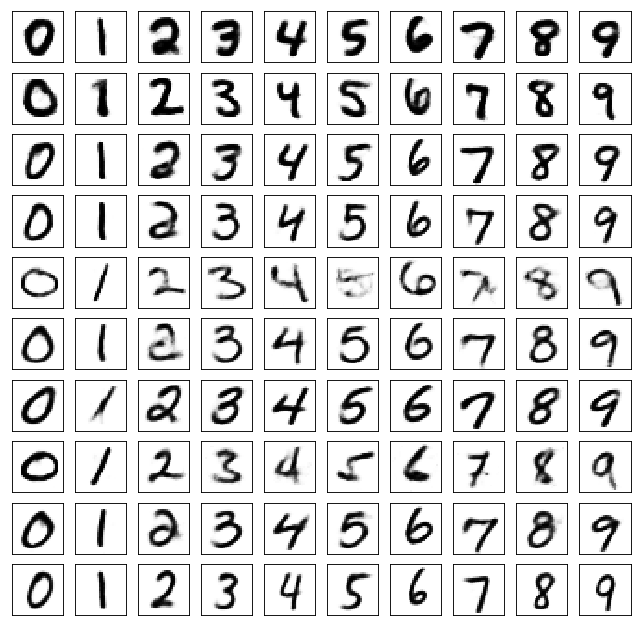

	reconstruction


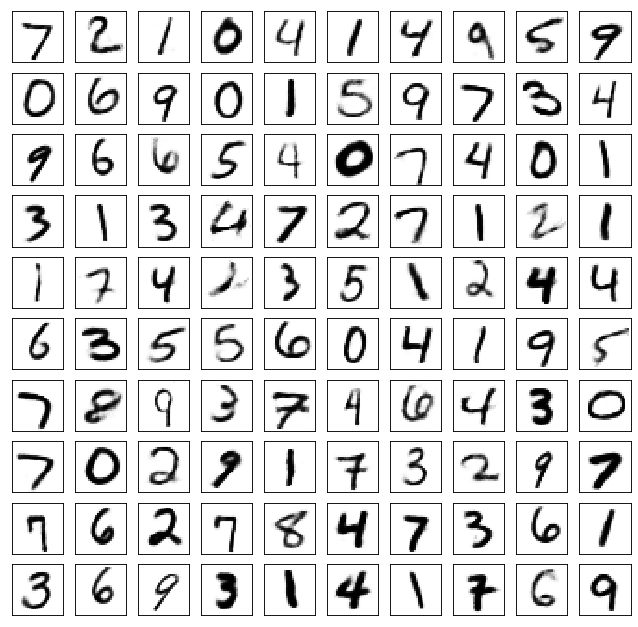

Test losses. E: 0.6905, AE: 0.0476, D: 0.6924
Train Epoch: 410 [0/50000 (0%)]	Losses E: 0.6967, AE: 0.0286, D: 0.6927
Train Epoch: 410 [25000/50000 (50%)]	Losses E: 0.7017, AE: 0.0294, D: 0.6933
Train Epoch: 410 [50000/50000 (100%)]	Losses E: 0.7039, AE: 0.0284, D: 0.6913
	generation


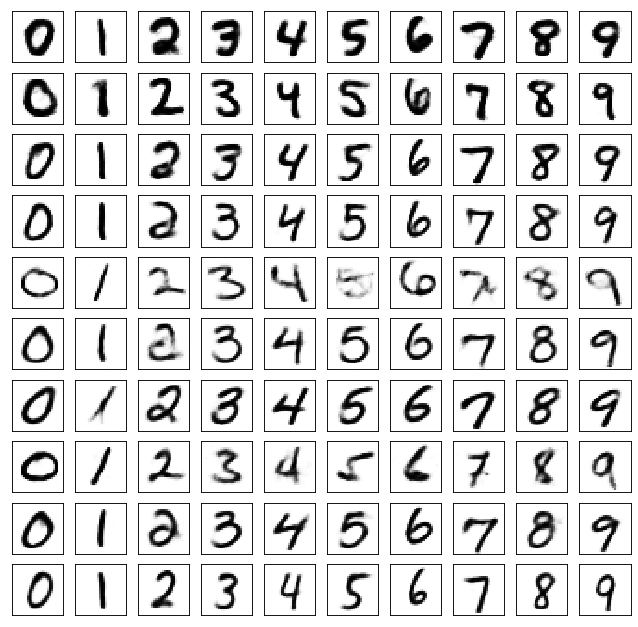

	reconstruction


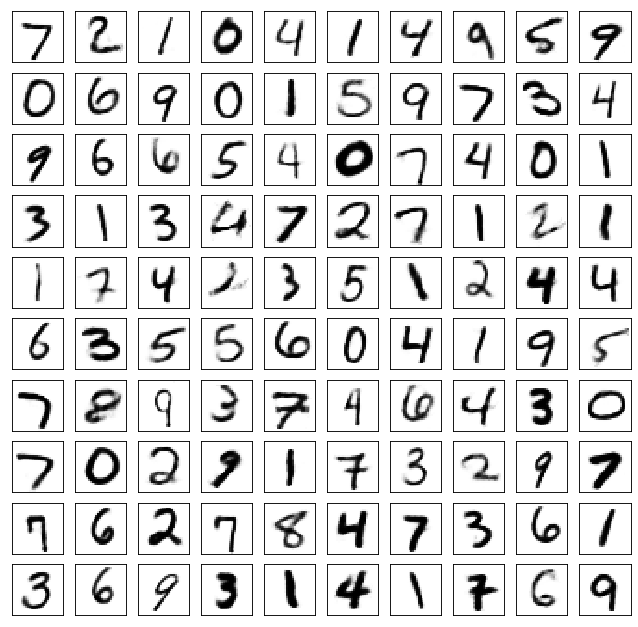

Test losses. E: 0.7022, AE: 0.0480, D: 0.6925
Train Epoch: 415 [0/50000 (0%)]	Losses E: 0.6983, AE: 0.0309, D: 0.6926
Train Epoch: 415 [25000/50000 (50%)]	Losses E: 0.6932, AE: 0.0315, D: 0.6940
Train Epoch: 415 [50000/50000 (100%)]	Losses E: 0.6947, AE: 0.0294, D: 0.6929
	generation


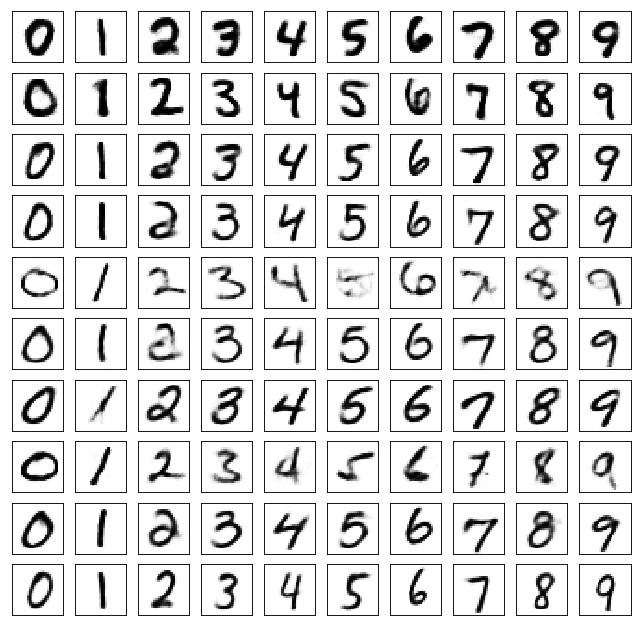

	reconstruction


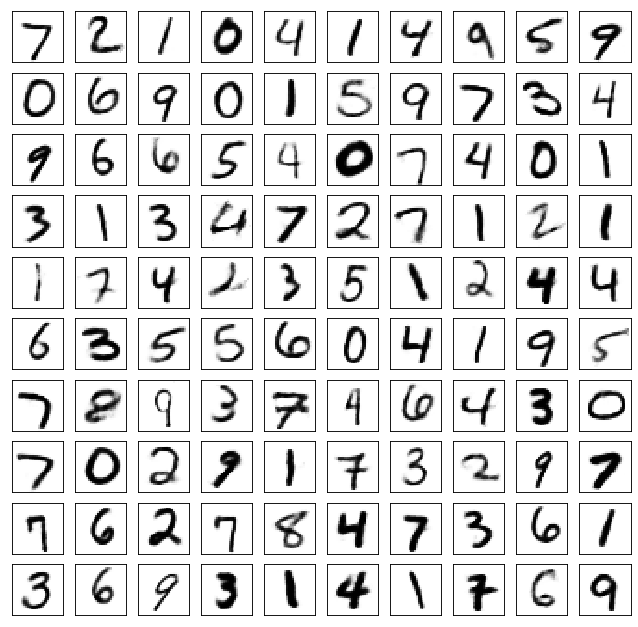

Test losses. E: 0.6917, AE: 0.0482, D: 0.6927
Train Epoch: 420 [0/50000 (0%)]	Losses E: 0.6980, AE: 0.0297, D: 0.6916
Train Epoch: 420 [25000/50000 (50%)]	Losses E: 0.6958, AE: 0.0303, D: 0.6903
Train Epoch: 420 [50000/50000 (100%)]	Losses E: 0.6978, AE: 0.0326, D: 0.6955
	generation


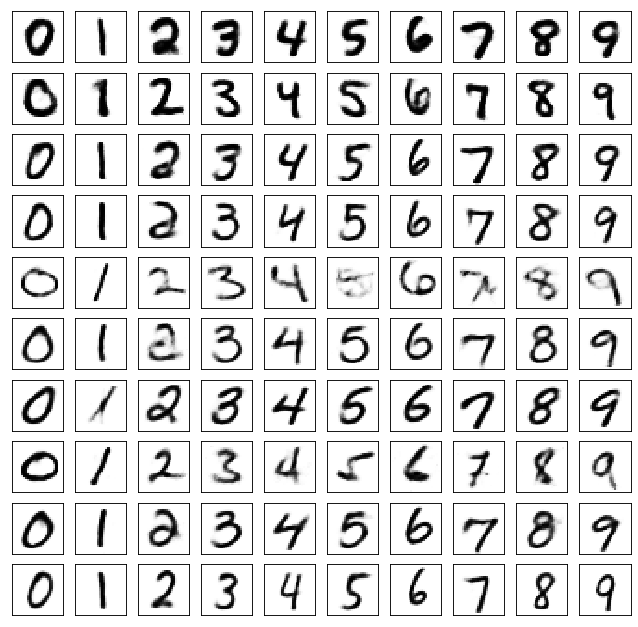

	reconstruction


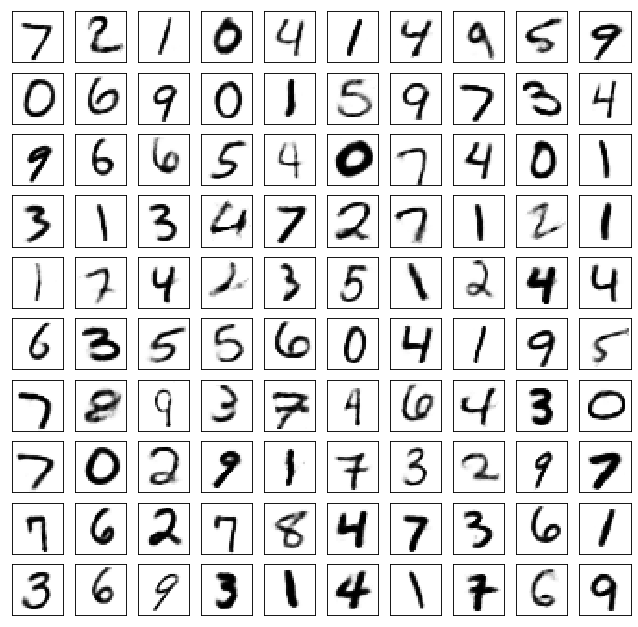

Test losses. E: 0.6982, AE: 0.0484, D: 0.6924
Train Epoch: 425 [0/50000 (0%)]	Losses E: 0.6864, AE: 0.0303, D: 0.6942
Train Epoch: 425 [25000/50000 (50%)]	Losses E: 0.6942, AE: 0.0292, D: 0.6935
Train Epoch: 425 [50000/50000 (100%)]	Losses E: 0.6959, AE: 0.0311, D: 0.6912
	generation


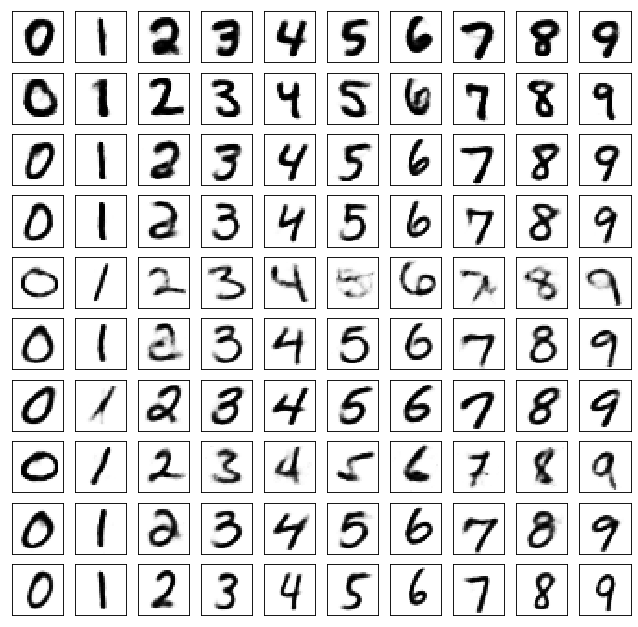

	reconstruction


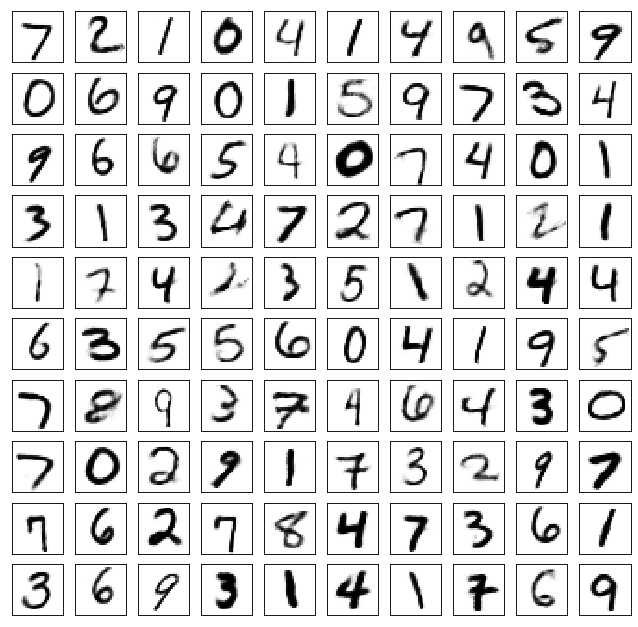

Test losses. E: 0.6959, AE: 0.0488, D: 0.6932
Train Epoch: 430 [0/50000 (0%)]	Losses E: 0.6961, AE: 0.0302, D: 0.6946
Train Epoch: 430 [25000/50000 (50%)]	Losses E: 0.6994, AE: 0.0284, D: 0.6904
Train Epoch: 430 [50000/50000 (100%)]	Losses E: 0.7000, AE: 0.0299, D: 0.6924
	generation


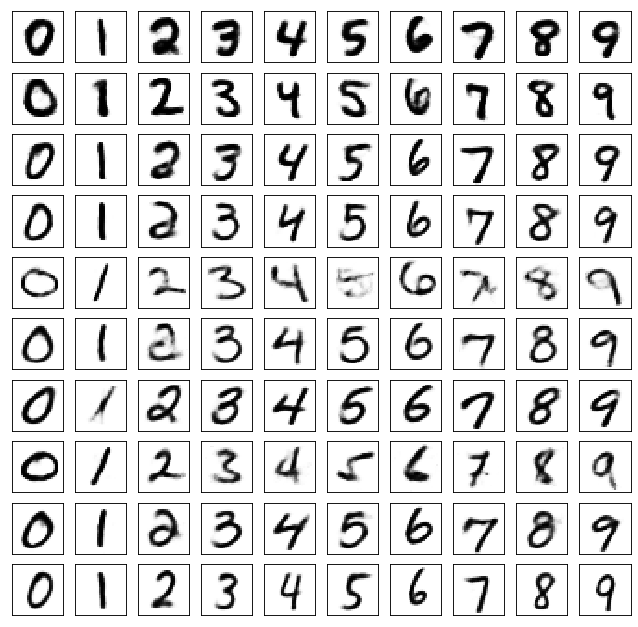

	reconstruction


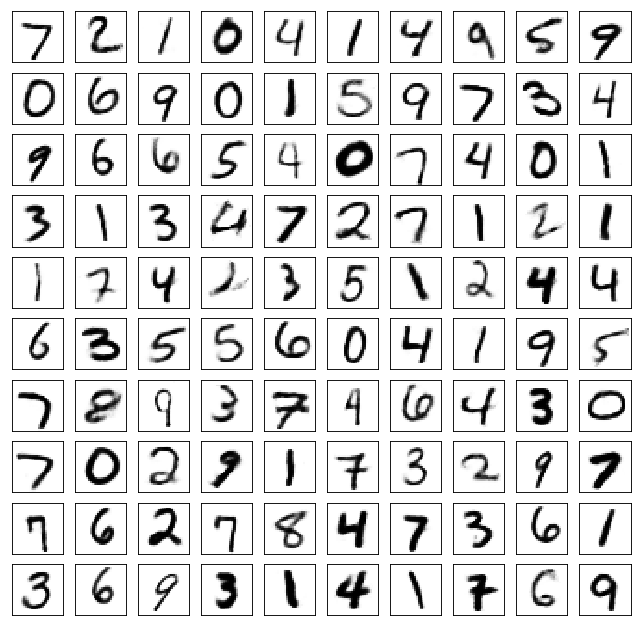

Test losses. E: 0.6992, AE: 0.0480, D: 0.6925
Train Epoch: 435 [0/50000 (0%)]	Losses E: 0.6872, AE: 0.0285, D: 0.6953
Train Epoch: 435 [25000/50000 (50%)]	Losses E: 0.6914, AE: 0.0311, D: 0.6943
Train Epoch: 435 [50000/50000 (100%)]	Losses E: 0.7058, AE: 0.0308, D: 0.6912
	generation


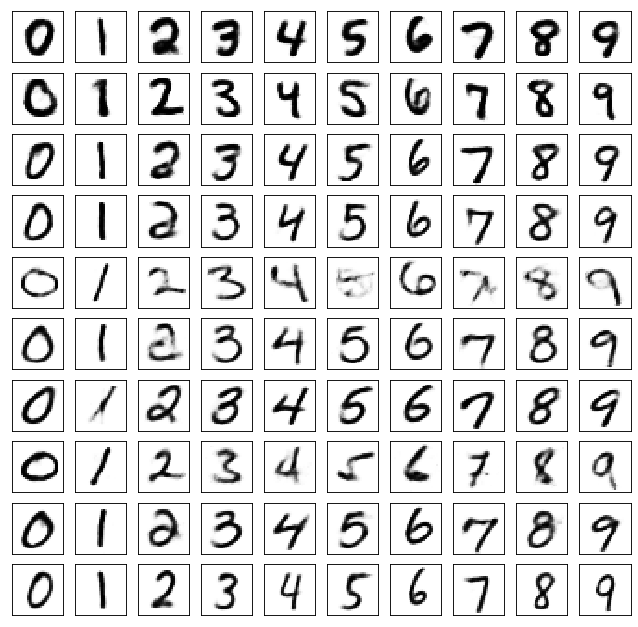

	reconstruction


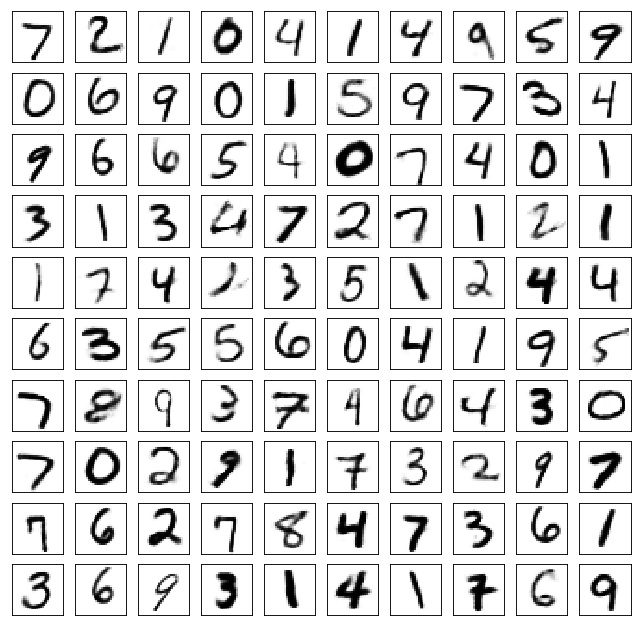

Test losses. E: 0.7031, AE: 0.0480, D: 0.6922
Train Epoch: 440 [0/50000 (0%)]	Losses E: 0.6975, AE: 0.0294, D: 0.6909
Train Epoch: 440 [25000/50000 (50%)]	Losses E: 0.6981, AE: 0.0274, D: 0.6911
Train Epoch: 440 [50000/50000 (100%)]	Losses E: 0.6990, AE: 0.0302, D: 0.6937
	generation


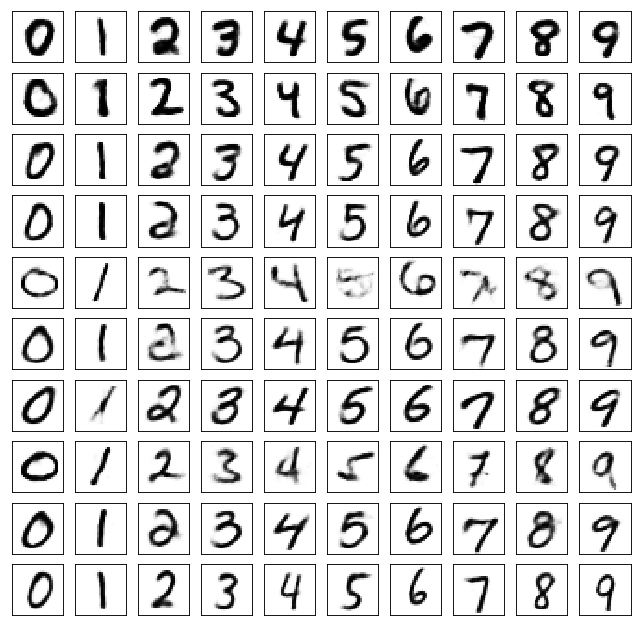

	reconstruction


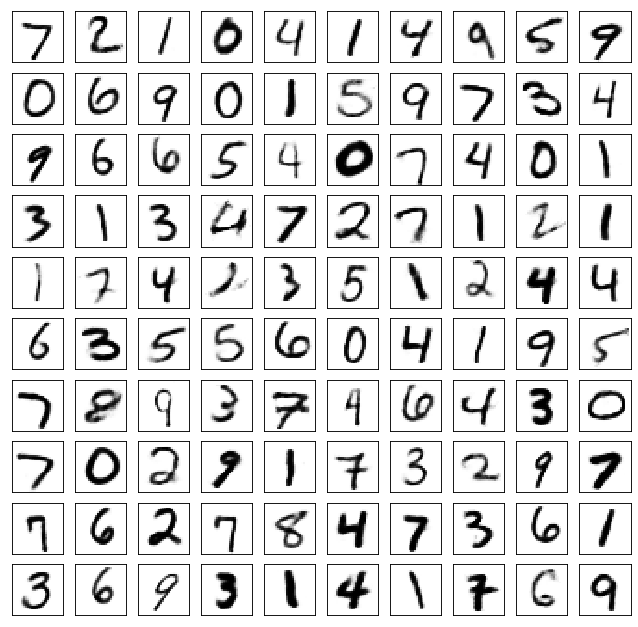

Test losses. E: 0.7023, AE: 0.0482, D: 0.6920
Train Epoch: 445 [0/50000 (0%)]	Losses E: 0.6969, AE: 0.0296, D: 0.6907
Train Epoch: 445 [25000/50000 (50%)]	Losses E: 0.6934, AE: 0.0292, D: 0.6922
Train Epoch: 445 [50000/50000 (100%)]	Losses E: 0.6944, AE: 0.0300, D: 0.6939
	generation


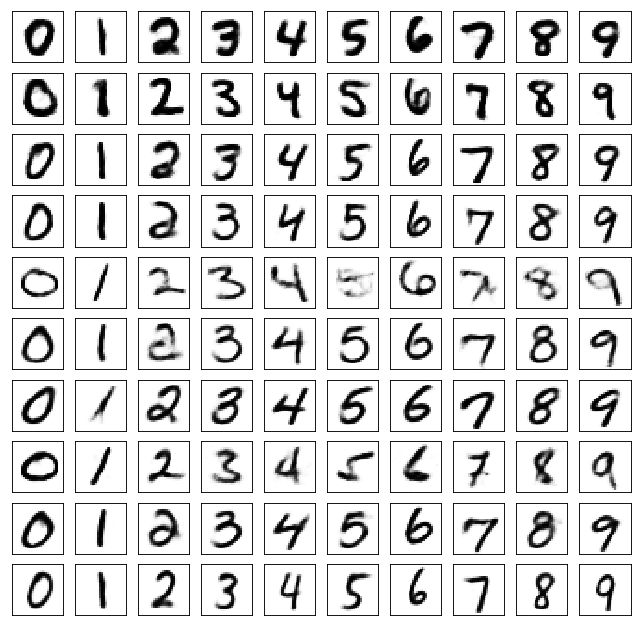

	reconstruction


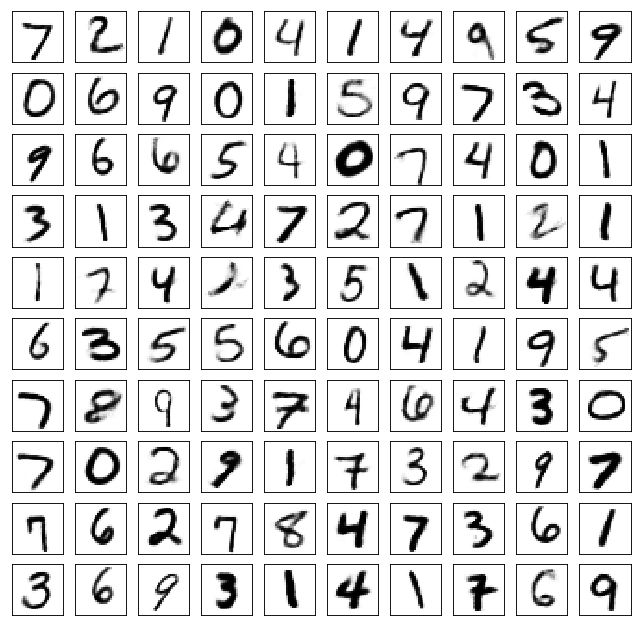

Test losses. E: 0.6962, AE: 0.0482, D: 0.6920
Train Epoch: 450 [0/50000 (0%)]	Losses E: 0.6854, AE: 0.0299, D: 0.6924
Train Epoch: 450 [25000/50000 (50%)]	Losses E: 0.6899, AE: 0.0278, D: 0.6906
Train Epoch: 450 [50000/50000 (100%)]	Losses E: 0.6978, AE: 0.0304, D: 0.6933
	generation


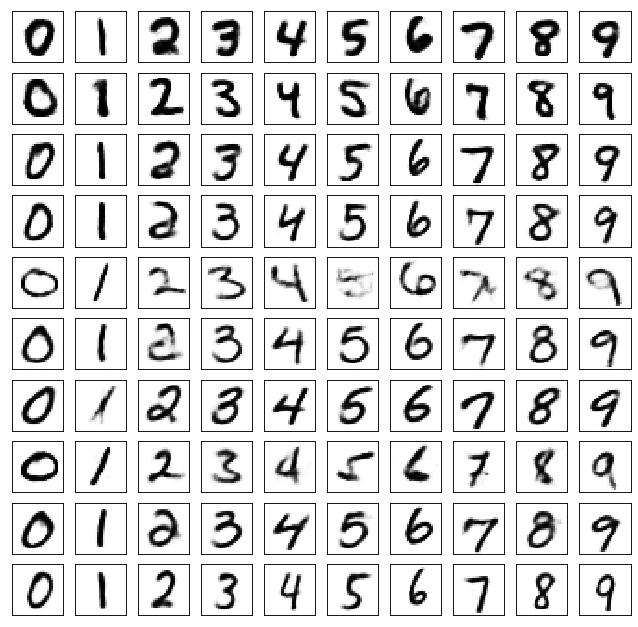

	reconstruction


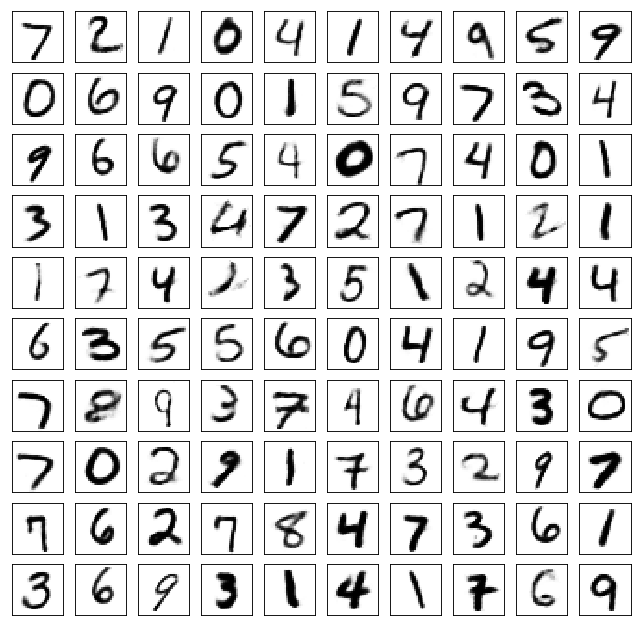

Test losses. E: 0.6989, AE: 0.0482, D: 0.6917
Train Epoch: 455 [0/50000 (0%)]	Losses E: 0.6975, AE: 0.0281, D: 0.6948
Train Epoch: 455 [25000/50000 (50%)]	Losses E: 0.6858, AE: 0.0303, D: 0.6912
Train Epoch: 455 [50000/50000 (100%)]	Losses E: 0.6956, AE: 0.0315, D: 0.6928
	generation


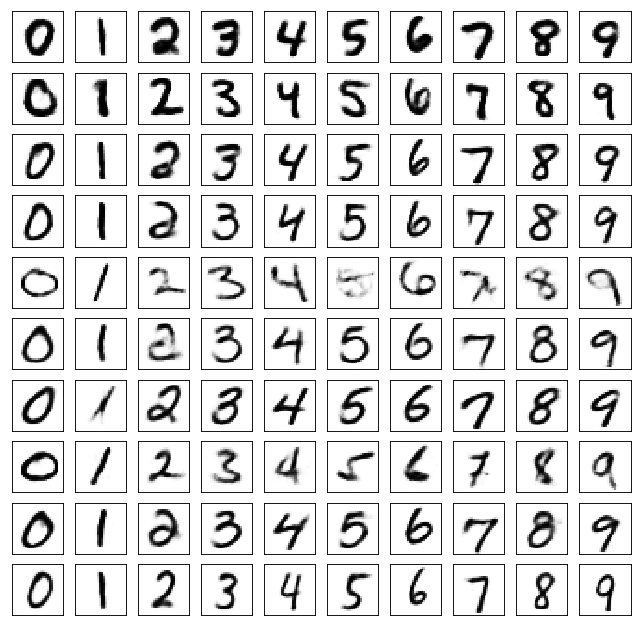

	reconstruction


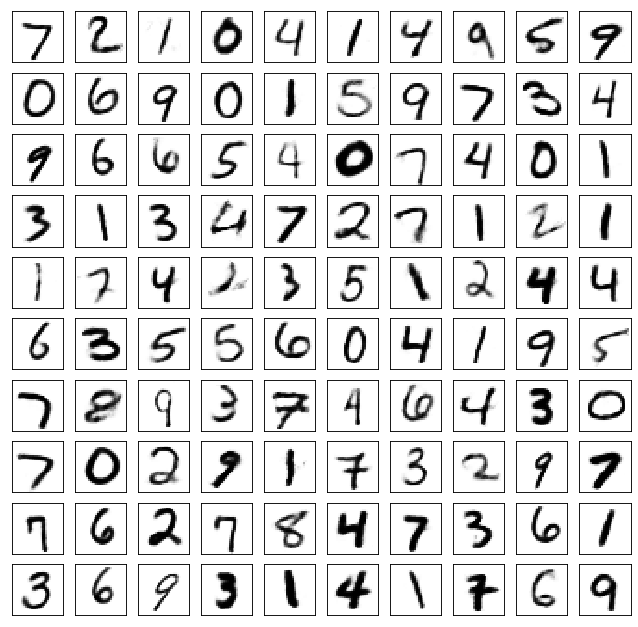

Test losses. E: 0.6967, AE: 0.0491, D: 0.6923
Train Epoch: 460 [0/50000 (0%)]	Losses E: 0.7008, AE: 0.0277, D: 0.6932
Train Epoch: 460 [25000/50000 (50%)]	Losses E: 0.6928, AE: 0.0287, D: 0.6917
Train Epoch: 460 [50000/50000 (100%)]	Losses E: 0.6836, AE: 0.0308, D: 0.6912
	generation


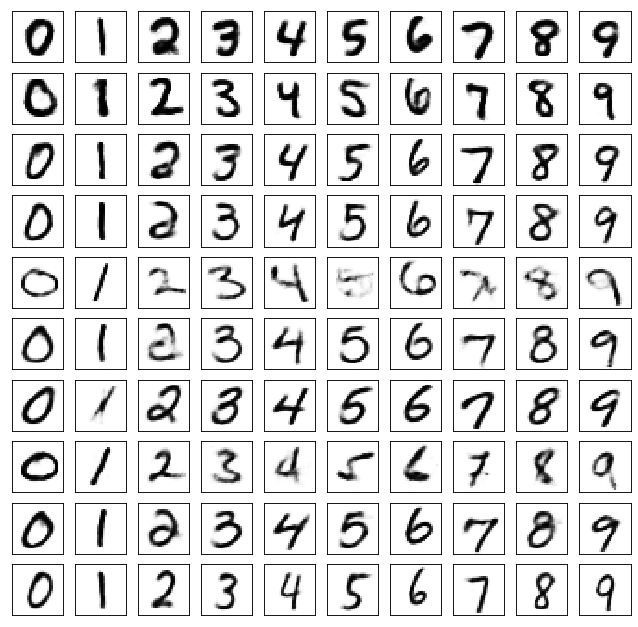

	reconstruction


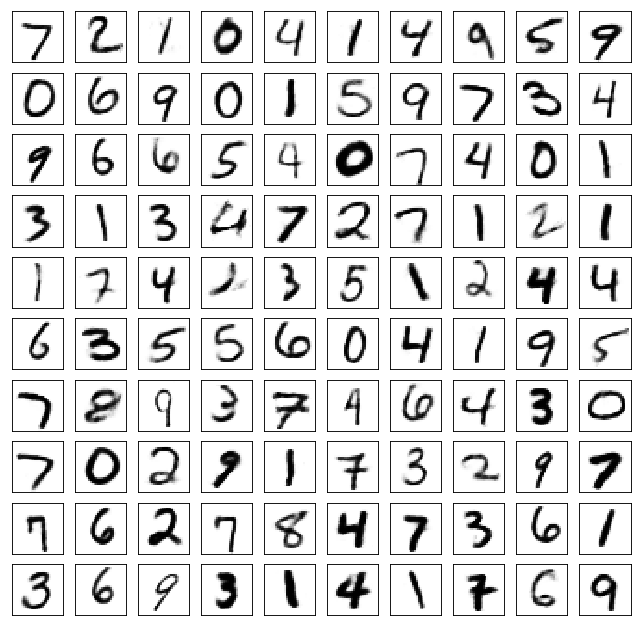

Test losses. E: 0.6848, AE: 0.0488, D: 0.6923
Train Epoch: 465 [0/50000 (0%)]	Losses E: 0.6946, AE: 0.0281, D: 0.6937
Train Epoch: 465 [25000/50000 (50%)]	Losses E: 0.6926, AE: 0.0306, D: 0.6937
Train Epoch: 465 [50000/50000 (100%)]	Losses E: 0.6909, AE: 0.0290, D: 0.6898
	generation


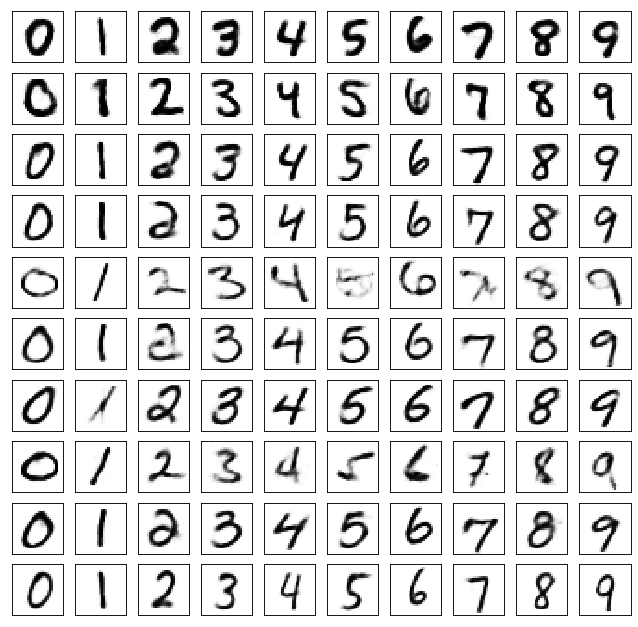

	reconstruction


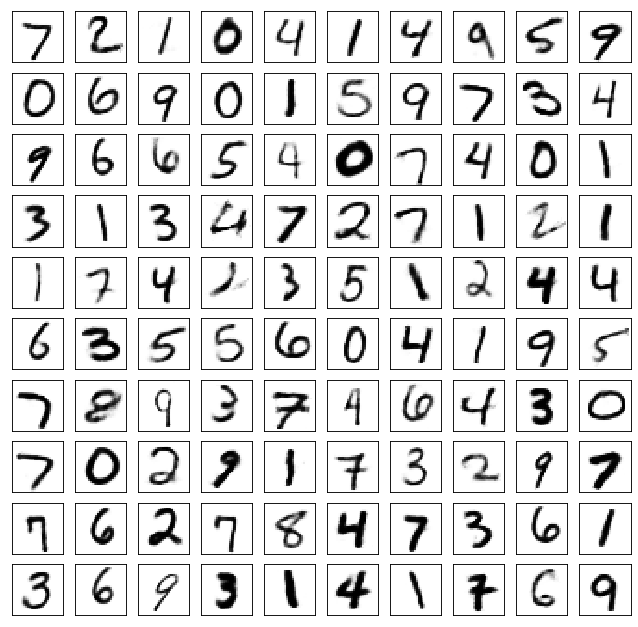

Test losses. E: 0.6882, AE: 0.0483, D: 0.6918
Train Epoch: 470 [0/50000 (0%)]	Losses E: 0.6968, AE: 0.0294, D: 0.6915
Train Epoch: 470 [25000/50000 (50%)]	Losses E: 0.6983, AE: 0.0293, D: 0.6930
Train Epoch: 470 [50000/50000 (100%)]	Losses E: 0.6934, AE: 0.0291, D: 0.6947
	generation


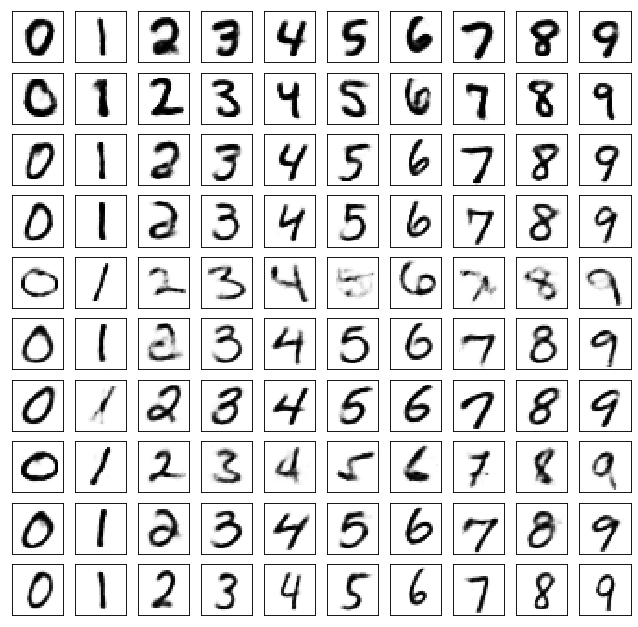

	reconstruction


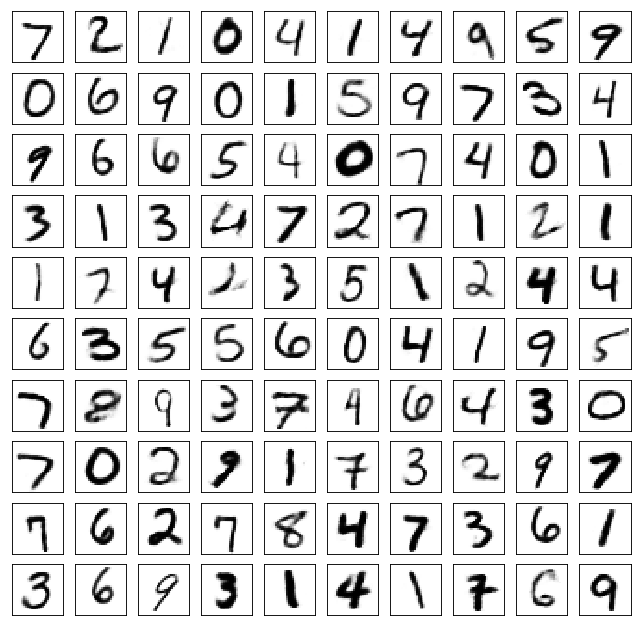

Test losses. E: 0.6959, AE: 0.0487, D: 0.6927
Train Epoch: 475 [0/50000 (0%)]	Losses E: 0.7036, AE: 0.0281, D: 0.6927
Train Epoch: 475 [25000/50000 (50%)]	Losses E: 0.6888, AE: 0.0273, D: 0.6935
Train Epoch: 475 [50000/50000 (100%)]	Losses E: 0.6960, AE: 0.0282, D: 0.6922
	generation


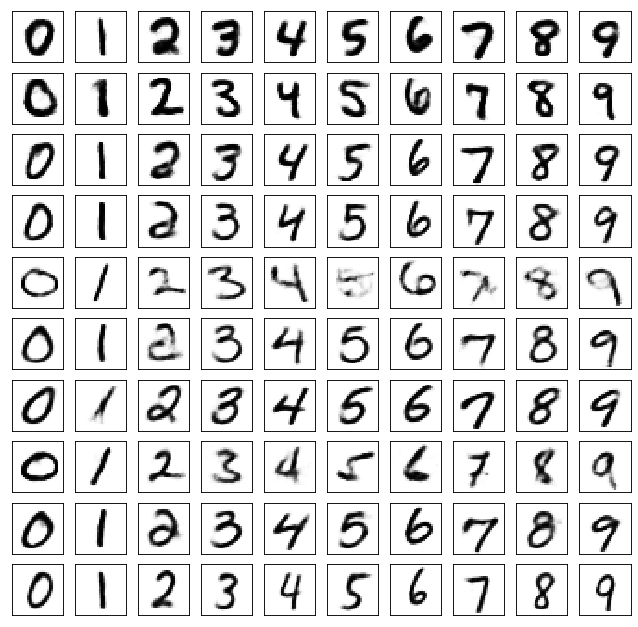

	reconstruction


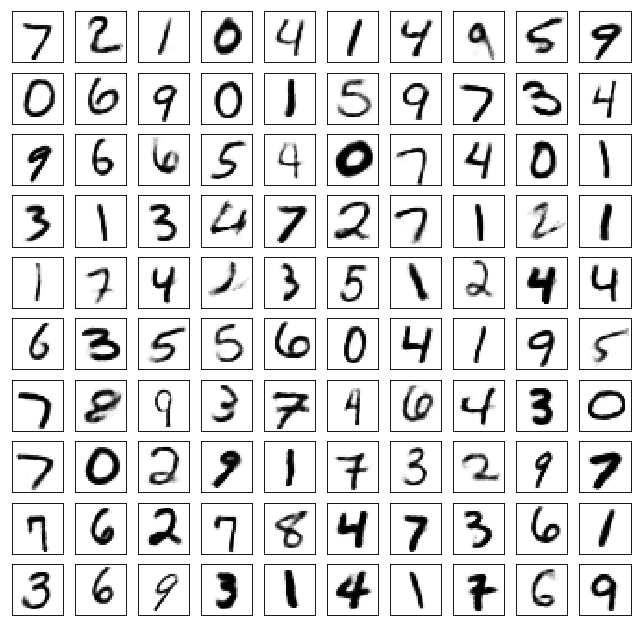

Test losses. E: 0.6942, AE: 0.0481, D: 0.6923
Train Epoch: 480 [0/50000 (0%)]	Losses E: 0.6967, AE: 0.0279, D: 0.6961
Train Epoch: 480 [25000/50000 (50%)]	Losses E: 0.6938, AE: 0.0274, D: 0.6919
Train Epoch: 480 [50000/50000 (100%)]	Losses E: 0.6927, AE: 0.0284, D: 0.6921
	generation


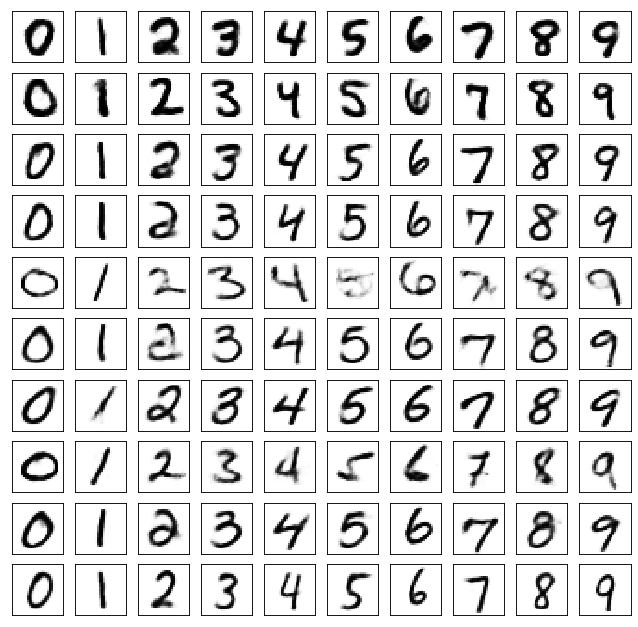

	reconstruction


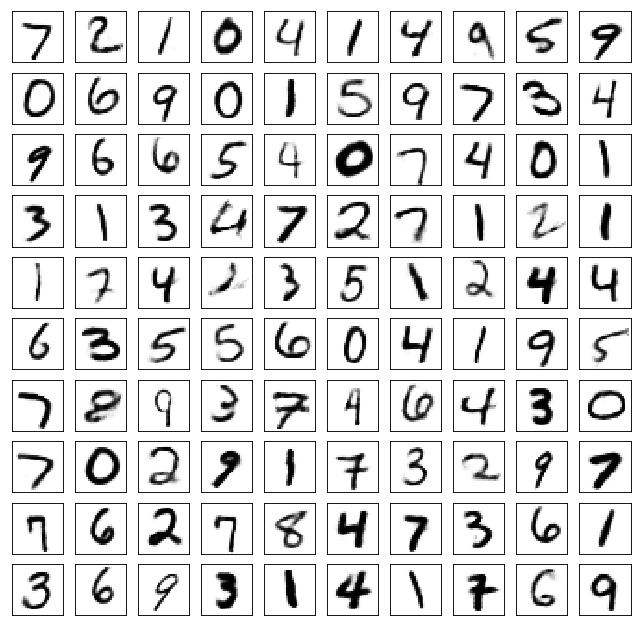

Test losses. E: 0.6937, AE: 0.0485, D: 0.6924
Train Epoch: 485 [0/50000 (0%)]	Losses E: 0.6909, AE: 0.0295, D: 0.6943
Train Epoch: 485 [25000/50000 (50%)]	Losses E: 0.6885, AE: 0.0292, D: 0.6951
Train Epoch: 485 [50000/50000 (100%)]	Losses E: 0.7021, AE: 0.0268, D: 0.6911
	generation


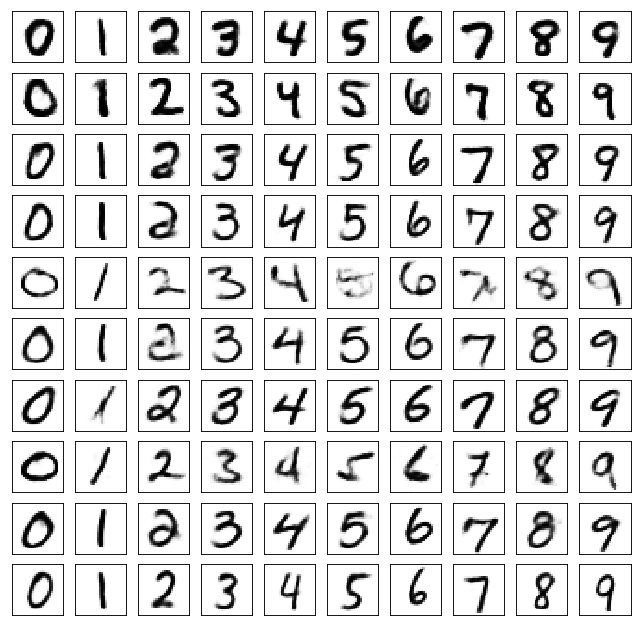

	reconstruction


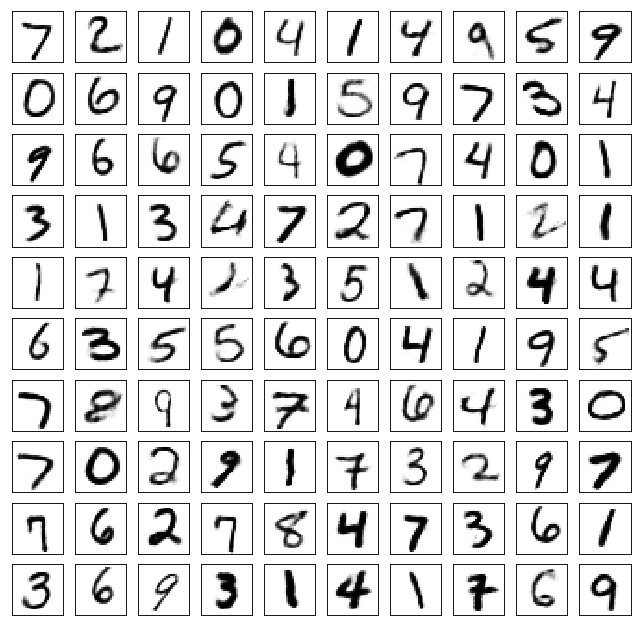

Test losses. E: 0.6983, AE: 0.0483, D: 0.6921
Train Epoch: 490 [0/50000 (0%)]	Losses E: 0.6904, AE: 0.0265, D: 0.6924
Train Epoch: 490 [25000/50000 (50%)]	Losses E: 0.6936, AE: 0.0263, D: 0.6926
Train Epoch: 490 [50000/50000 (100%)]	Losses E: 0.6815, AE: 0.0315, D: 0.6948
	generation


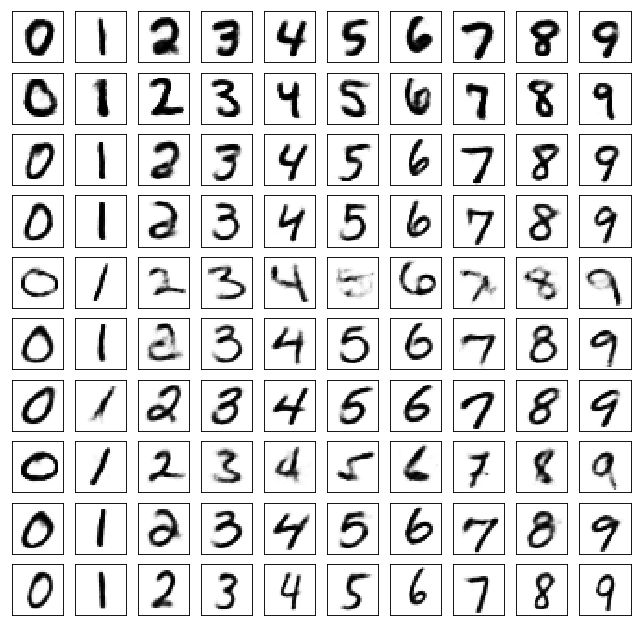

	reconstruction


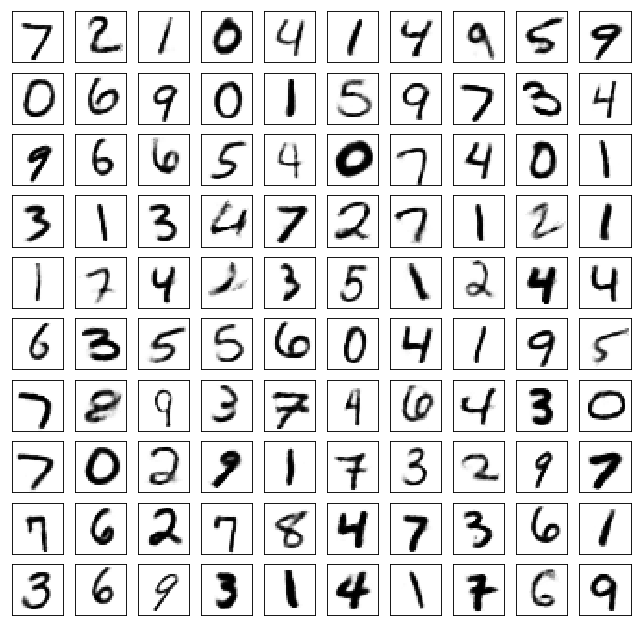

Test losses. E: 0.6845, AE: 0.0489, D: 0.6928
Train Epoch: 495 [0/50000 (0%)]	Losses E: 0.6935, AE: 0.0256, D: 0.6937
Train Epoch: 495 [25000/50000 (50%)]	Losses E: 0.7036, AE: 0.0268, D: 0.6914
Train Epoch: 495 [50000/50000 (100%)]	Losses E: 0.6948, AE: 0.0293, D: 0.6920
	generation


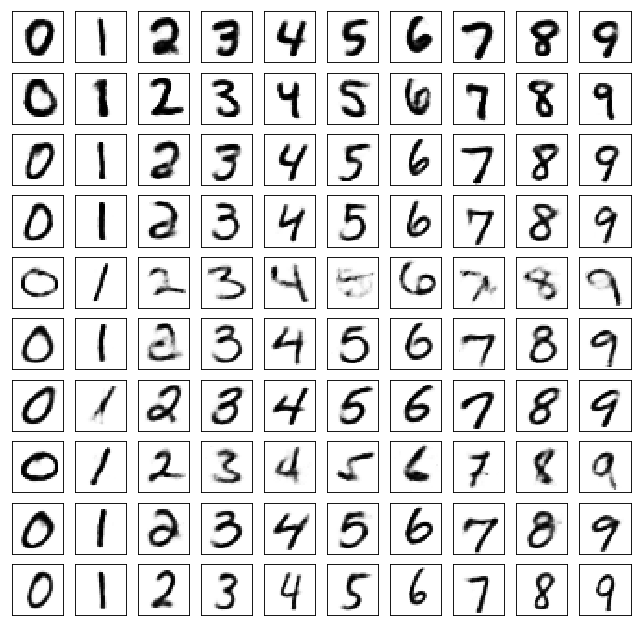

	reconstruction


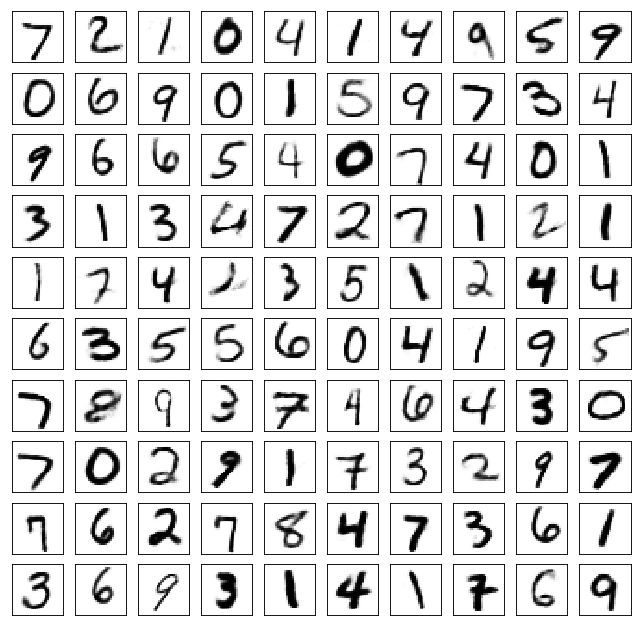

Test losses. E: 0.6945, AE: 0.0486, D: 0.6921
Train Epoch: 500 [0/50000 (0%)]	Losses E: 0.6965, AE: 0.0279, D: 0.6917
Train Epoch: 500 [25000/50000 (50%)]	Losses E: 0.6925, AE: 0.0288, D: 0.6925
Train Epoch: 500 [50000/50000 (100%)]	Losses E: 0.7040, AE: 0.0269, D: 0.6933
	generation


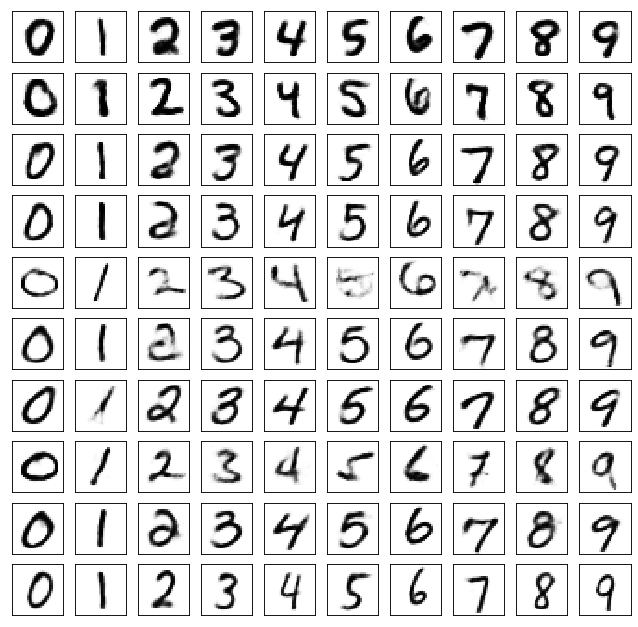

	reconstruction


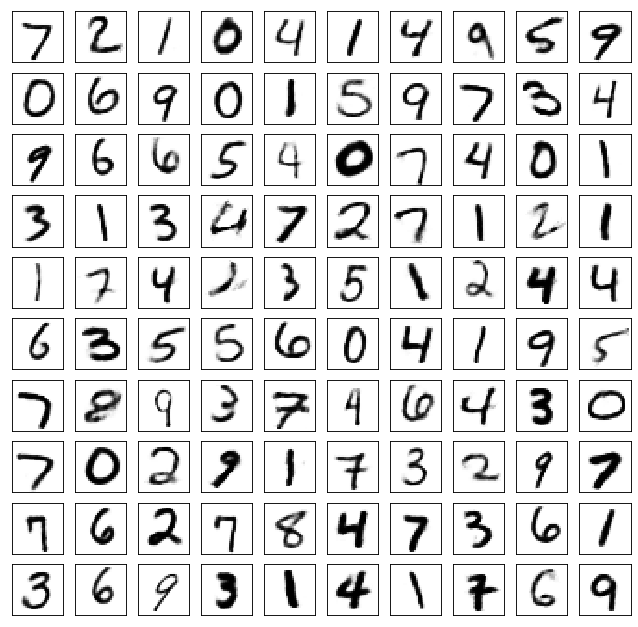

Test losses. E: 0.7026, AE: 0.0482, D: 0.6919
CPU times: user 3h 1min 58s, sys: 11min 1s, total: 3h 13min
Wall time: 3h 13min 24s


In [22]:
%%time

for epoch in range(1, train_epoch + 1):
    coders[variant]["Enc"].train()
    coders[variant]["Dec"].train()
    coders[variant]["Disc"].train()
    train(epoch, 
          coders[variant]["Enc"],
          coders[variant]["Dec"],
          coders[variant]["Disc"], 
          freq, logs[variant]["train"])
    coders[variant]["Enc"].eval()
    coders[variant]["Dec"].eval()
    coders[variant]["Disc"].eval()
    test(coders[variant]["Enc"],
         coders[variant]["Dec"],
         coders[variant]["Disc"], 
         valid_loader, epoch, freq, variant, logs[variant]["test"])

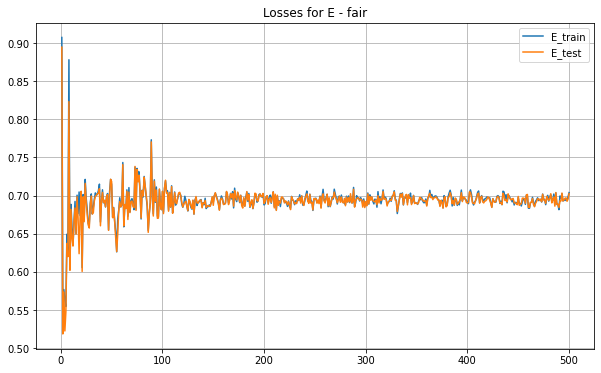

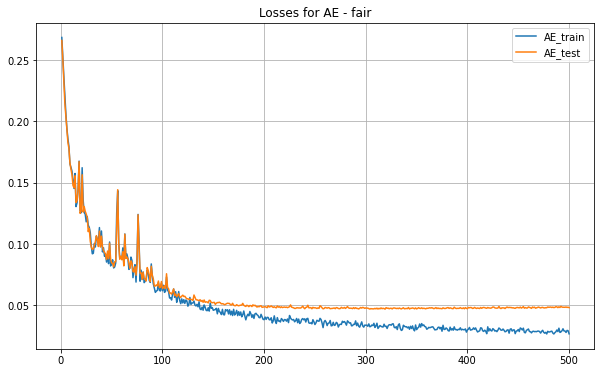

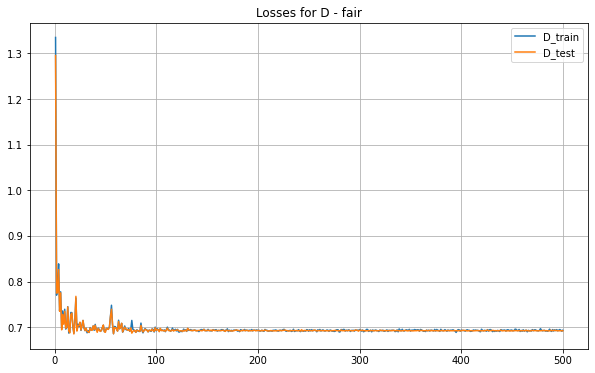

In [23]:
for item in logs[variant]["train"]:
    plt.figure(figsize=(10, 6))
    for mode in logs[variant]:
        plt.plot(range(1, len(logs[variant][mode][item]) + 1), logs[variant][mode][item], 
                 label=f"{item}_{mode}")
    plt.title(f"Losses for {item} - {variant}")
    plt.legend()
    plt.grid()
    plt.show()

## Классификатор

In [24]:
raw_class = FullyConnected([28*28, 1024, 1024, 10], dropout=0.3, 
                            activation_fn=nn.LeakyReLU(0.2), device=device)
unfair_class = FullyConnected([prior_size, 1024, 1024, 10], dropout=0.3, 
                            activation_fn=nn.LeakyReLU(0.2), device=device)
fair_class = FullyConnected([prior_size, 1024, 1024, 10], dropout=0.3, 
                            activation_fn=nn.LeakyReLU(0.2), device=device)
classifiers = {
    'raw': raw_class,
    'unfair': unfair_class, 
    'fair': fair_class
}

data_processors = {
    'raw': None,
    'unfair': coders['unfair']["Enc"], 
    'fair': coders['fair']["Enc"]
}

train_epoch = 10

In [25]:
 def train_class(epoch, model, criterion, data_loader, data_processor=None):
    data_size = len(data_loader.sampler)
    correct = 0
    total = 0
    for batch_idx, (data, target) in enumerate(data_loader):
        target = target.to(device)
        data = data.view(data.shape[0], -1)
        if data_processor:
            data = data_processor(data)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
            
        if batch_idx % 10 == 0:
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\t\t'.format(
                epoch, batch_idx * len(data), data_size, 100. * batch_idx / len(data_loader))
            pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
            correct += pred.eq(target.data.view_as(pred)).cpu().sum().item()
            total += target.size(0)
            correct_pct = 100. * correct / total
            print(line + f"Loss: {loss.item():.6f} Accuracy: {correct_pct:.2f}%")
            
    else:
        batch_idx += 1
        line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\t\t'.format(
            epoch, batch_idx * len(data), data_size, 100. * batch_idx / len(data_loader))
        pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
        correct += pred.eq(target.data.view_as(pred)).cpu().sum().item()
        total += target.size(0)
        correct_pct = 100. * correct / total
        print(line + f"Loss: {loss.item():.6f} Accuracy: {correct_pct:.2f}%")

### Сырые картинки

In [26]:
%%time
variant = 'raw'

criterion = nn.CrossEntropyLoss()
classifier = classifiers[variant]
optimizer = optim.Adam(classifier.parameters(), lr=lr)

print(variant)
for epoch in range(1, train_epoch + 1):
    classifier.train()
    train_class(epoch, classifier, criterion, valid_loader, data_processors[variant])
    print("\n")

raw
Train Epoch: 1 [0/10000 (0%)]		Loss: 2.314936 Accuracy: 4.40%
Train Epoch: 1 [2500/10000 (25%)]		Loss: 2.006730 Accuracy: 25.40%
Train Epoch: 1 [5000/10000 (50%)]		Loss: 1.631642 Accuracy: 36.93%
Train Epoch: 1 [7500/10000 (75%)]		Loss: 1.158898 Accuracy: 45.70%
Train Epoch: 1 [10000/10000 (100%)]		Loss: 0.932142 Accuracy: 51.68%


Train Epoch: 2 [0/10000 (0%)]		Loss: 0.811713 Accuracy: 80.40%
Train Epoch: 2 [2500/10000 (25%)]		Loss: 0.671108 Accuracy: 80.80%
Train Epoch: 2 [5000/10000 (50%)]		Loss: 0.692316 Accuracy: 80.27%
Train Epoch: 2 [7500/10000 (75%)]		Loss: 0.560139 Accuracy: 81.50%
Train Epoch: 2 [10000/10000 (100%)]		Loss: 0.536888 Accuracy: 81.76%


Train Epoch: 3 [0/10000 (0%)]		Loss: 0.620458 Accuracy: 80.80%
Train Epoch: 3 [2500/10000 (25%)]		Loss: 0.500821 Accuracy: 82.40%
Train Epoch: 3 [5000/10000 (50%)]		Loss: 0.531190 Accuracy: 83.47%
Train Epoch: 3 [7500/10000 (75%)]		Loss: 0.463152 Accuracy: 84.90%
Train Epoch: 3 [10000/10000 (100%)]		Loss: 0.423642 Accuracy: 8

### Латентный слой на "нечестном" энкодере

In [ ]:
%%time
variant = 'unfair'

criterion = nn.CrossEntropyLoss()
classifier = classifiers[variant]
optimizer = optim.Adam(classifier.parameters(), lr=lr)

print(variant)
for epoch in range(1, train_epoch + 1):
    classifier.train()
    train_class(epoch, classifier, criterion, valid_loader, data_processors[variant])
    print("\n")

unfair
Train Epoch: 1 [0/10000 (0%)]		Loss: 2.319368 Accuracy: 6.40%
Train Epoch: 1 [2500/10000 (25%)]		Loss: 2.062170 Accuracy: 21.00%
Train Epoch: 1 [5000/10000 (50%)]		Loss: 1.820987 Accuracy: 29.07%
Train Epoch: 1 [7500/10000 (75%)]		Loss: 1.716330 Accuracy: 33.90%
Train Epoch: 1 [10000/10000 (100%)]		Loss: 1.723401 Accuracy: 35.36%


Train Epoch: 2 [0/10000 (0%)]		Loss: 1.675392 Accuracy: 44.40%
Train Epoch: 2 [2500/10000 (25%)]		Loss: 1.618709 Accuracy: 44.20%
Train Epoch: 2 [5000/10000 (50%)]		Loss: 1.611181 Accuracy: 43.73%
Train Epoch: 2 [7500/10000 (75%)]		Loss: 1.549291 Accuracy: 43.50%
Train Epoch: 2 [10000/10000 (100%)]		Loss: 1.551748 Accuracy: 43.92%


Train Epoch: 3 [0/10000 (0%)]		Loss: 1.497858 Accuracy: 48.80%
Train Epoch: 3 [2500/10000 (25%)]		Loss: 1.514261 Accuracy: 48.80%
Train Epoch: 3 [5000/10000 (50%)]		Loss: 1.482549 Accuracy: 48.53%
Train Epoch: 3 [7500/10000 (75%)]		Loss: 1.426360 Accuracy: 49.20%
Train Epoch: 3 [10000/10000 (100%)]		Loss: 1.489065 Accuracy

### Латентный слой на "честном" энкодере

In [ ]:
%%time
variant = 'fair'

criterion = nn.CrossEntropyLoss()
classifier = classifiers[variant]
optimizer = optim.Adam(classifier.parameters(), lr=lr)

print(variant)
for epoch in range(1, train_epoch + 1):
    classifier.train()
    train_class(epoch, classifier, criterion, valid_loader, data_processors[variant])
    print("\n")

fair
Train Epoch: 1 [0/10000 (0%)]		Loss: 2.305734 Accuracy: 10.00%
Train Epoch: 1 [2500/10000 (25%)]		Loss: 2.255087 Accuracy: 14.20%
Train Epoch: 1 [5000/10000 (50%)]		Loss: 2.248592 Accuracy: 14.80%
Train Epoch: 1 [7500/10000 (75%)]		Loss: 2.221392 Accuracy: 15.40%
Train Epoch: 1 [10000/10000 (100%)]		Loss: 2.236721 Accuracy: 15.92%


Train Epoch: 2 [0/10000 (0%)]		Loss: 2.199383 Accuracy: 20.80%
Train Epoch: 2 [2500/10000 (25%)]		Loss: 2.222116 Accuracy: 19.00%
Train Epoch: 2 [5000/10000 (50%)]		Loss: 2.209320 Accuracy: 19.07%
Train Epoch: 2 [7500/10000 (75%)]		Loss: 2.237845 Accuracy: 18.10%
Train Epoch: 2 [10000/10000 (100%)]		Loss: 2.179688 Accuracy: 18.64%


Train Epoch: 3 [0/10000 (0%)]		Loss: 2.232860 Accuracy: 16.00%
Train Epoch: 3 [2500/10000 (25%)]		Loss: 2.264940 Accuracy: 16.40%
Train Epoch: 3 [5000/10000 (50%)]		Loss: 2.232385 Accuracy: 18.13%
Train Epoch: 3 [7500/10000 (75%)]		Loss: 2.190215 Accuracy: 18.60%
Train Epoch: 3 [10000/10000 (100%)]		Loss: 2.186700 Accuracy:

## Выводы и комментарии по обязательной части:
- первый вариант был сделан на 100 эпохах, качество генерации визуально было не очень хорошим (см. другой ноутбук). 
- был сделан вариант на 500 эпох (текущий ноутбук). Больше эпох делать не было смысла - это и так заняло более 6 часов, бесплатный колаб мог бы больше не позволить. **Качество получилось приемлемым**. Результаты (и картинки) выводились каждую 5-ю эпоху - всего 100 выводов на обучении (для облегчения ноутбука).
- после 200 эпохи ошибка AE на тесте уменьшаться практически перестала, на трейне еще немного продолжала снижаться
- результаты обучения классификатора (**accuracy**), энкодеры обучались **500 эпох**:
> - изначальные необработаннные картинки (_**raw**_ - данные) - **92%**
> - латентные данные после "нечестного" энкодера (_**unfair**_- данные) - **55%**
> - латентные данные после "честного" энкодера (_**fair**_- данные) - **21%**
- результаты ожидаемы - на начальных данных аккураси максимально, на "нечестном" энкодере - достаточно большое (информация в латентном слое осталась), на "честном" энкодере - существенно меньше (немного осталось, так как полный рандом - около 10%)
- аналогичные результаты обучения классификатора (**accuracy**), но на энкодерах, которые обучались **100 эпох** (см. другой ноутбук с обучением на 100 эпохах):
> - изначальные необработаннные картинки (_**raw**_ - данные) - **92%**
> - латентные данные после "нечестного" энкодера (_**unfair**_- данные) - **70%**
> - латентные данные после "честного" энкодера (_**fair**_- данные) - **25%**
- сравнивая результаты на 100 и на 500 эпохах видим, что за 500 эпох в "нечестном" латентном слое **часть информации** о метке **ушла** из латентного слоя
- _**технический комментарий:**_ классификатор обучался на валидационных данных, для классификатора дополнительного разбиения на трейн и тест не проводилось, так как задача стояла - увидеть тенденции, для чего выполненной конфигурации классификатора, на мой взгляд, было достаточно



## <center>Необязательная часть:
Сделать перенос стиля с одной цифры на другие с помощью "честного" CAAE

### Схема решения:
- берем картинку цифры, стиль которой будем копировать
- переводим в латентное представление "честным" энкодером
- добавляем нужную метку и восстанавливаем декодером

In [27]:
def plot_template_and_stylized(template, encoder, decoder):
    labels = to_onehot(torch.tensor(list(range(10))), 10).to(device)
    latents = encoder(template).repeat((10, 1))
    decoded_imgs = decoder(latents, labels).reshape(-1, 1, 28, 28)

    print("template")
    plot_mnist(template.unsqueeze(0).cpu().data.numpy(), (1, 1))
    print("stylized numbers")
    plot_mnist(decoded_imgs.cpu().data.numpy(), (1, 10))  



берем "честные" энкодер и декодер

In [28]:
encoder = coders["fair"]["Enc"]
decoder = coders["fair"]["Dec"]

для образцов возьмем несколько цифр из `fixed_data`



template


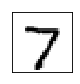

stylized numbers


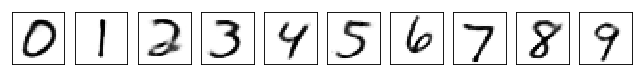

----------------------------------------------------------------------------------------------------
template


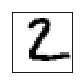

stylized numbers


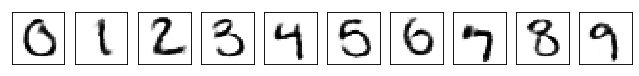

----------------------------------------------------------------------------------------------------
template


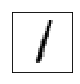

stylized numbers


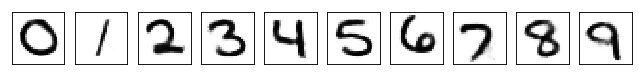

----------------------------------------------------------------------------------------------------
template


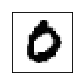

stylized numbers


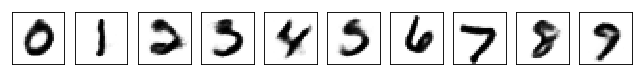

----------------------------------------------------------------------------------------------------
template


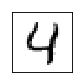

stylized numbers


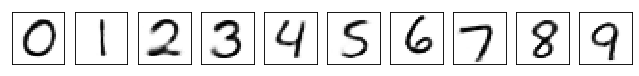

----------------------------------------------------------------------------------------------------
template


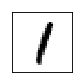

stylized numbers


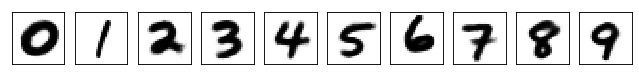

----------------------------------------------------------------------------------------------------
template


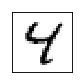

stylized numbers


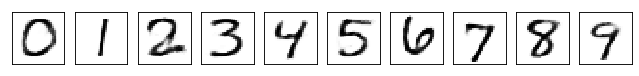

----------------------------------------------------------------------------------------------------
template


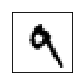

stylized numbers


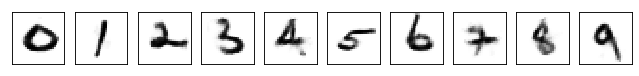

----------------------------------------------------------------------------------------------------
template


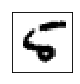

stylized numbers


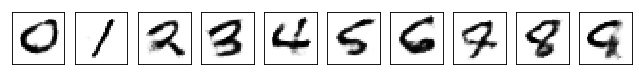

----------------------------------------------------------------------------------------------------
template


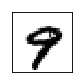

stylized numbers


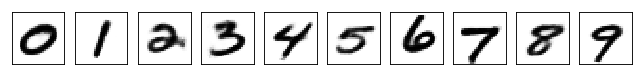

----------------------------------------------------------------------------------------------------


In [31]:
for num in range(10):
    plot_template_and_stylized(fixed_data[num], encoder, decoder)
    print('-' * 100)

### Вывод по необязательной части:
- перенос стиля, на мой взгляд, удался